<a href="https://colab.research.google.com/github/Drecor1798/Proyecto_coderHouse_ciencia_de_datos/blob/main/Poryecto_de_ciencia_de_datos_II_Alexis_Andres_Aguilar_Cornejo.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#Clima de las 100 prinsipales ciudades sugun Forbes

#Agenda

1. preguntas
2. Preparación del entorno
3. Preparación de datos
4. Análisis exploratorio
   *   Análisis de las ciudades más calurosas.
   *   Análisis de las ciudades más frías.
   *   Analisis de las ciudades mas calurosas de las 100 ciudades 100 ciudades más importantes de Forbes
   *   Analisis de las ciudades mas frias de las 100 ciudades 100 ciudades más importantes de Forbes
5. Ciudades con mayor promedio de temperatura
6. Ciudades con menor promedio
7. Agricultura
8. Turismo
9. Insights y Reconmendaciones




#Preguntas
* ¿Cómo varían las diferentes variables de temperatura (máxima, mínima, media, aparente) a lo largo del año en las ciudades más calurosas?
* ¿Cual es el periodo de tiempo (meses) que tienen mayor y menor temperatura de las ciudades con mayor temperatura?
* ¿Qué meses tienen más días con temperaturas agradables (entre 20 y 30 grados) en las ciudades más calurosas?
* ¿Cómo se distribuye la diferencia entre la temperatura media y la sensación térmica (diferencia aparente) en estas ciudades?
* ¿Cómo se distribuye la diferencia entre la temperatura máxima y mínima (amplitud térmica) en estas ciudades?
* ¿Cuál es la probabilidad de lluvia en estas ciudades en los próximos dos años?
* ¿Cuáles son las ciudades con las mejores condiciones agroclimáticas en general, considerando temperatura, precipitación, radiación solar y balance hídrico?
* ¿Cómo varían la temperatura media y la precipitación a lo largo del tiempo en las ciudades con mejor clima para la agricultura?
* ¿Cuáles son las ciudades con el clima más ideal para el turismo, considerando temperatura, precipitación y horas de sol?
* ¿Cómo varían la temperatura media y la precipitación a lo largo del tiempo en las ciudades con mejor clima para el turismo?

#Preparacion del entorno

In [ ]:
!pip install -q kaggle

In [ ]:
! gdown --id 1XL-U81WlWTjmc5ByZVd3l63wARxECvaL

/usr/local/lib/python3.11/dist-packages/gdown/__main__.py:140: FutureWarning: Option `--id` was deprecated in version 4.3.1 and will be removed in 5.0. You don't need to pass it anymore to use a file ID.
  warnings.warn(
Downloading...
From: https://drive.google.com/uc?id=1XL-U81WlWTjmc5ByZVd3l63wARxECvaL
To: /content/kaggle.json
100% 66.0/66.0 [00:00<00:00, 233kB/s]


In [ ]:
!mkdir ~/.kaggle
!cp kaggle.json ~/.kaggle/
!chmod 600 ~/.kaggle/kaggle.json
!kaggle datasets list

ref                                                                  title                                                  size  lastUpdated                 downloadCount  voteCount  usabilityRating  
-------------------------------------------------------------------  -----------------------------------------------  ----------  --------------------------  -------------  ---------  ---------------  
jayaantanaath/student-habits-vs-academic-performance                 Student Habits vs Academic Performance                19512  2025-04-12 10:49:08.663000           9504        164  1.0              
zahidmughal2343/global-cancer-patients-2015-2024                     global_cancer_patients_2015_2024                    1261049  2025-04-14 00:05:23.367000           2359         28  1.0              
shahriarkabir/procurement-kpi-analysis-dataset                       Procurement KPI Analysis Dataset                      16906  2025-04-26 02:15:11.127000            781         21  1.0     

In [ ]:
!kaggle datasets download -d bwandowando/forbes-top-100-cities-weather-data2020-ytd

Dataset URL: https://www.kaggle.com/datasets/bwandowando/forbes-top-100-cities-weather-data2020-ytd
License(s): Attribution 4.0 International (CC BY 4.0)
forbes-top-100-cities-weather-data2020-ytd.zip: Skipping, found more recently modified local copy (use --force to force download)


In [ ]:
import pandas as pd
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
from datetime import datetime
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import classification_report, accuracy_score
from prophet import Prophet

In [ ]:
!unzip /content/forbes-top-100-cities-weather-data2020-ytd.zip
!ls /content/forbes-top-100-cities-weather-data2020-ytd.zip

Archive:  /content/forbes-top-100-cities-weather-data2020-ytd.zip
  inflating: cities.csv              
  inflating: daily_data.csv          
  inflating: daily_units.csv         
  inflating: hourly_data.csv         
  inflating: hourly_units.csv        
/content/forbes-top-100-cities-weather-data2020-ytd.zip


In [ ]:
df1 = pd.read_csv('/content/daily_data.csv')
df1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 192200 entries, 0 to 192199
Data columns (total 22 columns):
 #   Column                       Non-Null Count   Dtype  
---  ------                       --------------   -----  
 0   city_name                    192200 non-null  object 
 1   datetime                     192200 non-null  object 
 2   weather_code                 192000 non-null  float64
 3   temperature_2m_max           192000 non-null  float64
 4   temperature_2m_min           192000 non-null  float64
 5   temperature_2m_mean          191800 non-null  float64
 6   apparent_temperature_max     192000 non-null  float64
 7   apparent_temperature_min     192000 non-null  float64
 8   apparent_temperature_mean    191800 non-null  float64
 9   sunrise                      192200 non-null  object 
 10  sunset                       192200 non-null  object 
 11  daylight_duration            192200 non-null  float64
 12  sunshine_duration            191800 non-null  float64
 13 

In [ ]:
df2 = pd.read_csv('/content/hourly_data.csv')
df2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4612800 entries, 0 to 4612799
Data columns (total 44 columns):
 #   Column                            Dtype  
---  ------                            -----  
 0   city_name                         object 
 1   datetime                          object 
 2   temperature_2m                    float64
 3   relative_humidity_2m              float64
 4   dew_point_2m                      float64
 5   apparent_temperature              float64
 6   precipitation                     float64
 7   rain                              float64
 8   snowfall                          float64
 9   snow_depth                        float64
 10  weather_code                      float64
 11  pressure_msl                      float64
 12  surface_pressure                  float64
 13  cloud_cover                       float64
 14  cloud_cover_low                   float64
 15  cloud_cover_mid                   float64
 16  cloud_cover_high                  fl

In [ ]:
df3 = pd.read_csv('/content/cities.csv')
df3.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100 entries, 0 to 99
Data columns (total 3 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   city_name  100 non-null    object 
 1   latitude   100 non-null    float64
 2   longitude  100 non-null    float64
dtypes: float64(2), object(1)
memory usage: 2.5+ KB


#Preparacion de datos


In [ ]:
paises2 = df1['city_name'].unique()

# Iterar sobre cada país
for city_name in paises2:
    print(f"\n===== {city_name} =====")
    df_grupo = df1[df1['city_name'] == city_name]
    df_pivot = df_grupo.set_index('datetime')[[ 'temperature_2m_max','temperature_2m_min','temperature_2m_mean','apparent_temperature_mean']]
    display(df_pivot)


===== Abu Dhabi =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean
datetime,,,,
2020-01-01,25.4,17.1,21.1,20.7
2020-01-02,23.8,19.1,22.1,23.5
2020-01-03,26.0,18.5,21.9,22.7
2020-01-04,29.0,18.8,23.6,21.5
2020-01-05,26.9,20.5,22.8,21.0
...,...,...,...,...
2025-04-01,32.3,20.4,25.6,26.4
2025-04-02,32.1,19.6,25.0,26.5
2025-04-03,34.7,20.3,25.6,27.5



===== Amsterdam =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean
datetime,,,,
2020-01-01,2.6,-1.2,1.4,-2.2
2020-01-02,7.4,1.4,3.9,-0.3
2020-01-03,9.7,5.5,7.8,3.6
2020-01-04,8.4,5.4,7.0,3.0
2020-01-05,8.2,5.3,6.6,3.5
...,...,...,...,...
2025-04-01,12.8,2.5,8.1,5.0
2025-04-02,15.9,5.6,10.5,7.0
2025-04-03,19.2,8.3,13.1,10.5



===== Athens =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean
datetime,,,,
2020-01-01,11.5,1.3,6.1,2.5
2020-01-02,8.1,4.6,6.0,1.6
2020-01-03,11.0,4.5,7.1,3.3
2020-01-04,14.4,2.4,10.0,7.4
2020-01-05,12.0,4.7,8.8,5.6
...,...,...,...,...
2025-04-01,18.9,10.9,14.2,13.7
2025-04-02,17.3,10.6,14.0,13.6
2025-04-03,17.8,10.4,13.9,13.4



===== Atlanta =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean
datetime,,,,
2020-01-01,11.5,1.8,6.1,1.7
2020-01-02,8.8,5.0,7.6,4.3
2020-01-03,18.1,7.7,14.3,13.6
2020-01-04,15.1,7.3,12.3,9.8
2020-01-05,10.3,-0.2,3.8,-1.2
...,...,...,...,...
2025-04-01,24.6,7.4,15.4,14.0
2025-04-02,28.8,15.6,21.2,20.0
2025-04-03,30.3,18.4,23.5,23.5



===== Auckland =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean
datetime,,,,
2020-01-01,21.4,16.3,18.1,16.9
2020-01-02,21.7,17.2,19.2,17.9
2020-01-03,20.5,16.0,17.7,13.8
2020-01-04,19.4,16.1,17.3,13.0
2020-01-05,20.1,16.7,18.7,15.5
...,...,...,...,...
2025-04-01,21.7,18.9,20.1,19.0
2025-04-02,20.9,18.9,19.6,17.5
2025-04-03,20.5,18.7,19.5,16.8



===== Austin =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean
datetime,,,,
2020-01-01,10.5,1.1,5.2,1.4
2020-01-02,11.6,8.3,9.5,6.6
2020-01-03,16.6,10.1,12.5,11.7
2020-01-04,11.7,4.2,7.3,3.6
2020-01-05,16.1,2.1,7.0,3.5
...,...,...,...,...
2025-04-01,22.0,6.9,13.3,11.0
2025-04-02,27.0,20.2,22.8,21.9
2025-04-03,19.7,15.0,16.4,16.0



===== Bangkok =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean
datetime,,,,
2020-01-01,33.0,23.3,27.6,29.6
2020-01-02,32.7,22.6,27.5,29.8
2020-01-03,33.2,22.5,27.4,30.3
2020-01-04,33.0,21.9,27.5,30.6
2020-01-05,33.1,22.1,27.6,30.1
...,...,...,...,...
2025-04-01,32.6,25.0,28.7,34.8
2025-04-02,34.5,25.4,29.5,34.2
2025-04-03,34.8,25.7,29.7,35.0



===== Barcelona =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean
datetime,,,,
2020-01-01,11.8,2.5,6.7,4.3
2020-01-02,12.8,1.3,6.3,3.6
2020-01-03,12.0,3.5,6.8,3.9
2020-01-04,14.5,3.2,7.5,4.2
2020-01-05,15.2,4.9,8.3,5.2
...,...,...,...,...
2025-04-01,17.7,7.1,12.6,11.5
2025-04-02,14.0,11.6,12.7,11.1
2025-04-03,17.0,11.0,13.7,11.9



===== Beijing =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean
datetime,,,,
2020-01-01,-0.8,-10.7,-5.9,-10.7
2020-01-02,2.3,-8.7,-2.8,-7.6
2020-01-03,5.9,-6.8,-1.2,-5.8
2020-01-04,6.9,-5.5,-0.2,-4.7
2020-01-05,3.0,-3.4,-0.2,-3.6
...,...,...,...,...
2025-04-01,21.0,7.2,14.4,9.0
2025-04-02,19.0,8.0,13.5,9.2
2025-04-03,19.5,7.6,14.4,10.6



===== Berlin =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean
datetime,,,,
2020-01-01,4.0,-1.7,1.6,-2.2
2020-01-02,3.4,-1.8,-0.2,-5.1
2020-01-03,6.5,3.0,4.7,0.3
2020-01-04,6.3,0.3,4.2,-1.1
2020-01-05,5.6,0.2,3.2,-0.6
...,...,...,...,...
2025-04-01,12.3,2.9,6.8,4.0
2025-04-02,11.3,2.8,6.8,3.3
2025-04-03,14.4,3.3,8.4,5.7



===== Bilbao =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean
datetime,,,,
2020-01-01,13.5,2.3,6.9,4.7
2020-01-02,15.4,2.4,7.6,4.6
2020-01-03,8.7,6.0,7.6,5.1
2020-01-04,11.2,7.3,9.4,8.2
2020-01-05,11.4,2.8,7.4,5.8
...,...,...,...,...
2025-04-01,22.8,6.2,13.2,12.3
2025-04-02,18.2,7.5,13.0,11.7
2025-04-03,18.2,12.3,14.7,12.7



===== Birmingham =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean
datetime,,,,
2020-01-01,6.2,3.7,5.3,2.6
2020-01-02,9.5,5.2,7.4,3.0
2020-01-03,9.1,4.0,6.3,2.2
2020-01-04,7.6,3.9,5.4,1.4
2020-01-05,7.9,4.0,5.8,2.0
...,...,...,...,...
2025-04-01,13.5,2.9,8.4,4.7
2025-04-02,15.2,4.0,8.9,5.1
2025-04-03,17.2,5.0,11.0,7.8



===== Bogota =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean
datetime,,,,
2020-01-01,19.0,9.3,13.4,13.5
2020-01-02,17.7,10.4,13.9,14.1
2020-01-03,18.0,10.5,13.3,13.3
2020-01-04,19.8,6.9,12.8,12.3
2020-01-05,19.7,6.4,13.1,11.9
...,...,...,...,...
2025-04-01,18.5,9.9,13.4,13.4
2025-04-02,16.3,9.8,12.6,12.3
2025-04-03,18.1,7.9,12.2,11.8



===== Boston =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean
datetime,,,,
2020-01-01,15.5,4.4,9.4,6.5
2020-01-02,22.4,8.0,13.9,11.7
2020-01-03,25.3,18.0,21.2,21.5
2020-01-04,22.0,15.3,19.2,18.5
2020-01-05,14.1,3.1,8.6,4.2
...,...,...,...,...
2025-04-01,28.8,17.7,21.1,23.0
2025-04-02,30.8,20.1,24.1,26.2
2025-04-03,30.3,20.0,24.2,25.7



===== Brisbane =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean
datetime,,,,
2020-01-01,29.9,21.2,25.0,28.2
2020-01-02,29.9,20.3,24.9,27.9
2020-01-03,30.2,19.1,24.5,27.0
2020-01-04,31.0,19.6,25.0,27.0
2020-01-05,31.4,21.5,25.8,28.2
...,...,...,...,...
2025-04-01,24.8,20.7,22.2,24.5
2025-04-02,23.4,19.2,20.9,23.8
2025-04-03,26.0,19.2,22.5,25.9



===== Brussels =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean
datetime,,,,
2020-01-01,4.5,-1.4,2.0,-1.3
2020-01-02,8.5,2.4,5.3,1.5
2020-01-03,10.0,4.6,8.3,4.3
2020-01-04,7.7,3.0,5.3,1.4
2020-01-05,7.5,2.1,5.1,2.0
...,...,...,...,...
2025-04-01,13.7,3.3,8.5,4.7
2025-04-02,17.1,6.0,11.5,7.4
2025-04-03,20.3,8.8,14.4,11.7



===== Bucharest =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean
datetime,,,,
2020-01-01,7.3,-3.9,1.0,-3.3
2020-01-02,4.5,-4.2,-1.1,-5.1
2020-01-03,7.4,-3.3,0.3,-4.0
2020-01-04,7.1,-4.3,-0.1,-3.9
2020-01-05,4.2,-2.9,0.5,-2.8
...,...,...,...,...
2025-04-01,16.6,8.5,11.9,9.0
2025-04-02,16.3,9.7,12.1,10.3
2025-04-03,15.8,8.1,11.7,10.4



===== Budapest =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean
datetime,,,,
2020-01-01,6.0,-1.3,1.1,-3.1
2020-01-02,5.7,-5.3,-1.1,-4.7
2020-01-03,-0.2,-2.8,-2.0,-5.3
2020-01-04,6.6,-1.8,1.8,-2.3
2020-01-05,4.0,-2.4,1.2,-4.6
...,...,...,...,...
2025-04-01,16.2,8.5,11.5,8.5
2025-04-02,13.2,7.4,10.4,7.6
2025-04-03,17.7,8.7,12.5,9.7



===== Buenos Aires =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean
datetime,,,,
2020-01-01,24.8,19.3,22.0,22.0
2020-01-02,24.2,18.3,21.3,20.9
2020-01-03,25.1,20.5,22.4,22.9
2020-01-04,25.6,20.9,23.2,24.1
2020-01-05,27.2,20.2,24.2,25.3
...,...,...,...,...
2025-04-01,19.3,11.0,15.7,14.3
2025-04-02,22.7,13.9,18.2,18.6
2025-04-03,21.0,13.8,17.4,15.5



===== Busan =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean
datetime,,,,
2020-01-01,5.1,-1.3,0.9,-3.4
2020-01-02,7.5,0.6,3.1,-1.7
2020-01-03,9.0,0.4,3.8,-1.4
2020-01-04,8.1,-1.5,2.6,-2.1
2020-01-05,9.9,1.5,6.0,2.8
...,...,...,...,...
2025-04-01,12.9,5.9,9.5,5.7
2025-04-02,14.4,4.0,9.1,6.1
2025-04-03,14.0,4.6,9.2,6.0



===== Calgary =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean
datetime,,,,
2020-01-01,2.8,-1.8,0.4,-3.8
2020-01-02,-0.1,-7.5,-4.1,-8.5
2020-01-03,0.0,-10.7,-6.8,-11.5
2020-01-04,4.5,-3.9,0.3,-5.0
2020-01-05,0.4,-11.2,-4.8,-10.2
...,...,...,...,...
2025-04-01,7.9,-4.7,1.2,-1.9
2025-04-02,6.7,-3.8,-1.2,-5.2
2025-04-03,-1.8,-5.6,-3.6,-7.6



===== Charlotte =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean
datetime,,,,
2020-01-01,10.7,1.7,5.9,2.2
2020-01-02,9.9,3.9,6.2,2.6
2020-01-03,15.5,6.7,10.4,9.0
2020-01-04,16.7,10.3,12.8,10.7
2020-01-05,10.2,1.5,5.7,1.1
...,...,...,...,...
2025-04-01,21.0,9.3,15.6,14.3
2025-04-02,26.1,12.2,17.3,15.5
2025-04-03,28.5,19.0,22.2,22.7



===== Chicago =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean
datetime,,,,
2020-01-01,5.0,-6.1,-2.0,-7.7
2020-01-02,9.5,2.5,5.1,-1.1
2020-01-03,5.4,0.2,2.8,-0.8
2020-01-04,1.7,-1.4,0.3,-4.5
2020-01-05,7.2,-4.7,-0.6,-6.4
...,...,...,...,...
2025-04-01,4.4,0.6,2.2,-1.7
2025-04-02,20.7,5.2,8.9,4.9
2025-04-03,19.6,9.0,12.2,8.8



===== City of Baltimore =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean
datetime,,,,
2020-01-01,7.9,2.9,5.5,0.2
2020-01-02,8.8,-2.6,2.0,-1.5
2020-01-03,12.7,5.5,9.1,6.6
2020-01-04,13.9,8.1,10.4,9.2
2020-01-05,9.6,1.2,4.9,-0.8
...,...,...,...,...
2025-04-01,18.4,4.7,11.4,8.4
2025-04-02,14.8,3.5,8.7,5.4
2025-04-03,26.3,10.2,16.7,15.5



===== City of London =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean
datetime,,,,
2020-01-01,6.6,2.0,5.0,2.8
2020-01-02,10.1,5.7,8.3,4.7
2020-01-03,10.7,3.3,7.5,3.8
2020-01-04,8.1,1.9,4.3,0.8
2020-01-05,8.5,3.9,5.9,2.8
...,...,...,...,...
2025-04-01,13.6,5.3,9.2,5.6
2025-04-02,15.9,7.2,11.1,7.4
2025-04-03,18.5,8.7,13.3,10.4



===== Cologne =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean
datetime,,,,
2020-01-01,4.5,-0.8,1.0,-3.2
2020-01-02,4.4,-1.2,1.7,-2.1
2020-01-03,9.2,4.3,7.1,3.2
2020-01-04,6.5,3.1,5.2,1.0
2020-01-05,8.1,3.4,5.6,2.6
...,...,...,...,...
2025-04-01,13.6,3.0,8.5,4.8
2025-04-02,18.1,6.1,12.0,8.1
2025-04-03,20.4,9.7,14.5,11.3



===== Copenhagen =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean
datetime,,,,
2020-01-01,5.5,1.4,3.6,-1.2
2020-01-02,3.2,1.2,1.8,-3.6
2020-01-03,6.9,3.5,5.1,-0.4
2020-01-04,5.5,1.9,4.3,-2.2
2020-01-05,6.1,0.0,3.2,-1.5
...,...,...,...,...
2025-04-01,12.3,3.9,7.5,4.2
2025-04-02,13.2,3.2,8.0,5.8
2025-04-03,13.1,5.5,9.1,7.3



===== Dallas =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean
datetime,,,,
2020-01-01,11.5,1.8,6.0,2.1
2020-01-02,8.9,5.6,7.0,4.0
2020-01-03,17.6,7.8,14.4,14.0
2020-01-04,14.3,6.4,11.6,9.3
2020-01-05,10.4,-0.5,3.6,-0.8
...,...,...,...,...
2025-04-01,24.0,6.7,14.6,12.8
2025-04-02,28.3,15.9,20.7,19.4
2025-04-03,29.5,17.8,23.5,23.2



===== Denver =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean
datetime,,,,
2020-01-01,10.6,2.3,6.3,2.4
2020-01-02,9.1,3.2,6.1,2.9
2020-01-03,13.7,6.4,9.4,8.2
2020-01-04,15.4,8.8,11.5,9.6
2020-01-05,9.7,2.5,5.6,0.9
...,...,...,...,...
2025-04-01,19.1,8.8,14.6,13.0
2025-04-02,25.0,11.9,16.4,15.0
2025-04-03,27.5,14.5,20.6,21.0



===== Doha =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean
datetime,,,,
2020-01-01,24.7,16.4,20.2,18.2
2020-01-02,23.1,17.5,20.4,20.1
2020-01-03,24.3,18.8,22.1,22.2
2020-01-04,29.0,19.4,23.9,21.0
2020-01-05,22.5,15.7,19.1,17.2
...,...,...,...,...
2025-04-01,34.7,20.2,27.9,28.0
2025-04-02,36.4,23.7,28.9,28.5
2025-04-03,35.1,23.7,29.4,28.9



===== Dubai =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean
datetime,,,,
2020-01-01,25.0,16.2,21.2,20.3
2020-01-02,24.6,17.2,21.2,21.7
2020-01-03,26.0,16.3,21.1,21.4
2020-01-04,28.5,16.1,22.3,20.5
2020-01-05,27.2,19.4,22.5,21.4
...,...,...,...,...
2025-04-01,32.2,20.1,25.5,25.3
2025-04-02,31.9,19.7,25.2,26.2
2025-04-03,36.4,19.9,27.0,27.6



===== Dublin =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean
datetime,,,,
2020-01-01,8.2,1.6,5.6,3.1
2020-01-02,11.6,8.7,10.4,6.3
2020-01-03,9.5,4.4,6.4,2.2
2020-01-04,9.0,6.2,7.4,3.6
2020-01-05,10.9,8.1,9.3,5.7
...,...,...,...,...
2025-04-01,13.2,8.2,10.5,7.2
2025-04-02,13.0,7.1,10.0,6.6
2025-04-03,13.4,6.9,10.3,7.4



===== Dusseldorf =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean
datetime,,,,
2020-01-01,4.5,-1.3,1.1,-3.2
2020-01-02,3.5,-1.3,1.4,-2.8
2020-01-03,9.1,3.5,6.7,2.8
2020-01-04,6.7,3.0,5.1,1.1
2020-01-05,7.9,3.9,5.4,2.6
...,...,...,...,...
2025-04-01,13.9,3.6,8.8,4.8
2025-04-02,18.8,6.1,12.1,8.1
2025-04-03,21.1,9.7,15.2,12.0



===== Frankfurt =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean
datetime,,,,
2020-01-01,3.9,-4.0,-1.4,-5.0
2020-01-02,1.6,-2.7,-0.2,-3.6
2020-01-03,8.4,1.1,4.9,0.9
2020-01-04,6.6,2.1,5.1,1.2
2020-01-05,7.2,2.5,5.0,2.7
...,...,...,...,...
2025-04-01,12.3,3.7,7.8,3.7
2025-04-02,16.6,5.3,11.2,7.5
2025-04-03,19.4,7.2,12.7,10.1



===== Glasgow =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean
datetime,,,,
2020-01-01,6.9,2.7,5.5,2.3
2020-01-02,10.1,5.9,8.6,4.2
2020-01-03,7.1,4.0,5.8,1.4
2020-01-04,8.9,7.4,7.9,3.8
2020-01-05,10.2,7.9,8.9,4.9
...,...,...,...,...
2025-04-01,16.6,7.5,11.3,8.6
2025-04-02,15.7,3.8,9.4,6.3
2025-04-03,14.1,4.3,8.4,4.6



===== Gothenburg =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean
datetime,,,,
2020-01-01,6.5,4.1,5.7,0.8
2020-01-02,5.8,4.2,5.0,0.2
2020-01-03,7.4,4.7,5.7,-0.3
2020-01-04,5.2,1.0,3.5,-2.5
2020-01-05,5.8,-2.6,2.7,-1.5
...,...,...,...,...
2025-04-01,12.3,1.2,6.1,3.3
2025-04-02,14.7,1.8,8.0,5.3
2025-04-03,13.6,2.9,8.4,5.4



===== Hamburg =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean
datetime,,,,
2020-01-01,4.1,-1.9,1.2,-2.1
2020-01-02,3.8,-2.0,0.1,-4.3
2020-01-03,7.1,3.4,5.2,1.0
2020-01-04,6.5,0.6,4.3,-0.6
2020-01-05,6.0,1.3,4.1,0.5
...,...,...,...,...
2025-04-01,13.7,3.0,7.9,4.9
2025-04-02,14.9,2.8,8.5,5.6
2025-04-03,17.6,3.5,10.2,7.9



===== Hanoi =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean
datetime,,,,
2020-01-01,23.0,18.5,19.9,21.7
2020-01-02,25.4,19.2,21.4,23.3
2020-01-03,25.4,20.0,21.7,23.7
2020-01-04,23.5,19.0,20.8,22.3
2020-01-05,25.6,19.6,21.8,23.5
...,...,...,...,...
2025-04-01,22.3,14.5,18.1,18.3
2025-04-02,25.3,15.2,20.0,20.8
2025-04-03,27.8,16.6,21.6,21.9



===== Helsinki =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean
datetime,,,,
2020-01-01,3.5,0.9,2.4,-3.4
2020-01-02,4.9,2.7,3.8,-2.5
2020-01-03,5.1,2.4,4.3,-4.1
2020-01-04,3.0,0.6,2.1,-4.5
2020-01-05,1.8,-2.2,-0.2,-6.5
...,...,...,...,...
2025-04-01,7.8,3.6,5.3,1.8
2025-04-02,11.8,3.7,7.4,3.3
2025-04-03,8.9,5.0,6.5,1.6



===== Hong Kong =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean
datetime,,,,
2020-01-01,18.5,16.5,17.2,15.7
2020-01-02,19.6,16.2,17.4,17.4
2020-01-03,21.3,16.4,18.1,18.5
2020-01-04,21.9,17.0,18.9,19.1
2020-01-05,21.0,18.1,19.3,18.4
...,...,...,...,...
2025-04-01,22.1,11.4,15.9,15.4
2025-04-02,21.6,15.0,17.6,17.9
2025-04-03,24.2,17.2,19.6,19.5



===== Houston =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean
datetime,,,,
2020-01-01,11.6,-0.7,3.9,-0.9
2020-01-02,10.9,4.7,7.4,3.6
2020-01-03,9.0,7.2,8.3,6.4
2020-01-04,6.1,-0.7,2.7,-2.0
2020-01-05,11.6,-0.7,3.8,-0.7
...,...,...,...,...
2025-04-01,17.4,3.9,9.4,5.4
2025-04-02,23.9,15.7,19.1,16.0
2025-04-03,19.1,10.1,12.7,10.8



===== Istanbul =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean
datetime,,,,
2020-01-01,8.1,3.9,5.6,0.8
2020-01-02,7.5,4.3,5.8,0.7
2020-01-03,8.3,3.3,5.7,2.0
2020-01-04,9.7,1.9,5.7,2.6
2020-01-05,9.3,5.5,7.1,3.4
...,...,...,...,...
2025-04-01,17.6,9.1,12.1,10.1
2025-04-02,13.5,9.1,10.9,8.7
2025-04-03,14.8,9.0,11.5,9.9



===== Krakow =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean
datetime,,,,
2020-01-01,4.2,-1.4,2.0,-2.7
2020-01-02,5.9,-4.4,-0.2,-5.2
2020-01-03,6.6,-2.8,0.6,-4.1
2020-01-04,4.5,1.0,2.9,-2.7
2020-01-05,1.9,-3.5,-0.3,-5.7
...,...,...,...,...
2025-04-01,11.6,6.5,8.6,5.9
2025-04-02,15.6,7.5,10.8,7.7
2025-04-03,16.8,4.9,10.4,8.2



===== Kuwait City =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean
datetime,,,,
2020-01-01,19.2,11.7,14.9,11.2
2020-01-02,18.0,10.9,14.6,12.9
2020-01-03,21.7,15.6,18.5,18.4
2020-01-04,21.2,14.4,17.6,15.9
2020-01-05,18.9,12.1,15.3,12.6
...,...,...,...,...
2025-04-01,29.8,22.1,25.1,24.6
2025-04-02,36.9,22.1,28.1,26.9
2025-04-03,29.5,23.9,26.6,26.3



===== Las Vegas =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean
datetime,,,,
2020-01-01,4.9,-17.8,-7.5,-12.0
2020-01-02,1.1,-6.3,-2.5,-7.1
2020-01-03,0.4,-16.8,-8.8,-13.4
2020-01-04,3.8,-14.8,-5.3,-9.5
2020-01-05,5.4,-8.4,-0.1,-4.6
...,...,...,...,...
2025-04-01,17.6,8.1,12.7,5.5
2025-04-02,14.2,-1.2,5.3,-0.6
2025-04-03,10.3,-2.4,4.7,-0.4



===== Leeds =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean
datetime,,,,
2020-01-01,6.8,4.0,5.1,2.3
2020-01-02,10.0,4.9,7.5,3.8
2020-01-03,9.8,4.6,6.8,2.7
2020-01-04,8.6,5.8,6.9,2.4
2020-01-05,9.3,5.7,7.3,3.6
...,...,...,...,...
2025-04-01,13.6,3.7,8.0,4.9
2025-04-02,13.9,3.5,8.0,4.7
2025-04-03,15.2,4.9,9.1,5.9



===== Lisbon =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean
datetime,,,,
2020-01-01,12.9,7.3,9.4,8.0
2020-01-02,11.8,8.7,10.1,9.0
2020-01-03,15.4,8.3,11.5,10.7
2020-01-04,14.3,8.1,10.9,8.9
2020-01-05,12.7,7.0,9.0,6.5
...,...,...,...,...
2025-04-01,19.4,13.9,15.8,15.9
2025-04-02,15.4,12.5,13.8,11.5
2025-04-03,16.8,9.7,13.1,11.3



===== Liverpool =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean
datetime,,,,
2020-01-01,7.2,5.0,6.2,3.4
2020-01-02,10.5,4.7,7.8,3.9
2020-01-03,9.8,6.4,7.4,2.7
2020-01-04,7.9,5.6,7.0,2.6
2020-01-05,10.5,5.3,7.6,4.5
...,...,...,...,...
2025-04-01,14.2,5.5,9.7,6.0
2025-04-02,15.3,5.1,9.6,5.9
2025-04-03,17.2,6.5,11.2,7.7



===== Los Angeles =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean
datetime,,,,
2020-01-01,19.6,6.8,11.8,9.6
2020-01-02,17.0,7.1,11.3,9.8
2020-01-03,20.6,9.6,14.4,12.6
2020-01-04,19.2,9.7,14.1,12.6
2020-01-05,19.7,7.9,12.6,10.8
...,...,...,...,...
2025-04-01,19.4,9.6,14.0,12.4
2025-04-02,19.9,8.3,13.5,10.5
2025-04-03,20.9,8.7,13.8,11.7



===== Lyon =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean
datetime,,,,
2020-01-01,2.0,-1.1,0.2,-2.3
2020-01-02,5.2,-0.8,2.2,-1.0
2020-01-03,8.3,2.5,5.2,3.0
2020-01-04,8.5,2.5,5.7,2.4
2020-01-05,7.4,0.3,3.7,-0.0
...,...,...,...,...
2025-04-01,13.8,4.7,9.0,5.6
2025-04-02,15.4,3.2,9.4,7.9
2025-04-03,19.1,8.7,13.5,11.6



===== Madrid =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean
datetime,,,,
2020-01-01,10.2,-1.7,3.3,0.6
2020-01-02,8.7,-2.0,2.6,-0.1
2020-01-03,5.2,-0.5,1.4,-1.1
2020-01-04,10.4,0.8,4.6,1.0
2020-01-05,10.9,-0.6,4.0,1.0
...,...,...,...,...
2025-04-01,20.6,7.6,13.7,12.3
2025-04-02,17.8,8.9,13.2,12.0
2025-04-03,10.9,8.6,9.8,8.2



===== Manchester =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean
datetime,,,,
2020-01-01,6.8,4.0,5.4,2.6
2020-01-02,9.9,5.4,7.8,3.9
2020-01-03,9.9,4.6,6.9,3.3
2020-01-04,7.7,5.9,6.6,2.7
2020-01-05,9.7,4.8,7.3,4.1
...,...,...,...,...
2025-04-01,14.6,6.4,9.9,6.7
2025-04-02,14.8,5.3,9.3,5.8
2025-04-03,16.4,6.1,10.6,7.2



===== Melbourne =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean
datetime,,,,
2020-01-01,25.6,12.3,18.8,18.0
2020-01-02,25.6,12.9,18.9,18.3
2020-01-03,35.0,18.6,26.9,25.8
2020-01-04,26.7,13.8,17.3,14.2
2020-01-05,16.6,12.6,14.3,12.2
...,...,...,...,...
2025-04-01,22.7,11.1,16.6,15.6
2025-04-02,24.2,12.4,17.9,17.4
2025-04-03,20.0,10.7,15.4,13.7



===== Mexico City =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean
datetime,,,,
2020-01-01,24.3,6.6,16.1,13.8
2020-01-02,21.5,11.2,15.9,12.4
2020-01-03,23.0,8.1,14.7,11.3
2020-01-04,19.2,6.8,12.1,9.1
2020-01-05,22.6,2.8,11.1,8.3
...,...,...,...,...
2025-04-01,29.7,14.3,22.1,19.7
2025-04-02,29.9,15.4,22.4,19.8
2025-04-03,29.7,14.6,21.9,19.2



===== Miami =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean
datetime,,,,
2020-01-01,24.1,15.2,19.9,20.7
2020-01-02,25.4,19.2,22.3,23.6
2020-01-03,26.5,23.7,24.9,26.6
2020-01-04,27.8,23.9,25.3,27.6
2020-01-05,23.4,13.8,18.2,16.1
...,...,...,...,...
2025-04-01,27.1,20.6,24.0,27.9
2025-04-02,27.5,24.1,25.7,28.7
2025-04-03,28.1,24.3,25.9,27.6



===== Milan =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean
datetime,,,,
2020-01-01,7.5,-2.3,0.9,-2.6
2020-01-02,6.7,-3.1,0.3,-3.2
2020-01-03,7.7,-2.2,1.4,-1.9
2020-01-04,9.0,-2.4,4.2,0.5
2020-01-05,10.7,1.3,5.3,1.8
...,...,...,...,...
2025-04-01,15.7,7.2,11.9,9.0
2025-04-02,15.9,10.0,12.5,10.6
2025-04-03,19.1,6.9,13.2,12.3



===== Minneapolis =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean
datetime,,,,
2020-01-01,11.1,-2.1,2.1,-2.7
2020-01-02,9.4,-0.0,4.1,0.5
2020-01-03,7.5,-1.7,2.3,-1.8
2020-01-04,8.3,-5.3,1.0,-3.9
2020-01-05,9.5,2.9,6.0,1.3
...,...,...,...,...
2025-04-01,23.0,6.8,11.4,7.0
2025-04-02,21.9,8.6,14.6,11.2
2025-04-03,16.4,4.4,10.0,6.2



===== Minsk =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean
datetime,,,,
2020-01-01,0.6,-3.8,-0.8,-6.5
2020-01-02,2.7,-0.1,1.3,-3.6
2020-01-03,3.0,-2.0,-0.2,-5.2
2020-01-04,2.6,0.2,1.0,-4.2
2020-01-05,0.5,-5.7,-1.5,-6.2
...,...,...,...,...
2025-04-01,12.8,7.0,10.0,6.1
2025-04-02,14.3,6.0,9.7,5.3
2025-04-03,17.2,4.4,10.5,8.0



===== Montreal =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean
datetime,,,,
2020-01-01,1.0,-2.1,-0.5,-5.4
2020-01-02,1.7,-3.7,-0.8,-5.1
2020-01-03,4.3,0.3,2.7,-1.1
2020-01-04,2.2,-4.1,-0.6,-4.3
2020-01-05,-1.9,-7.6,-4.3,-9.0
...,...,...,...,...
2025-04-01,8.1,-3.0,0.6,-4.2
2025-04-02,2.3,-7.5,-2.9,-7.5
2025-04-03,18.3,-0.3,6.4,2.3



===== Munich =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean
datetime,,,,
2020-01-01,5.2,-4.6,-0.7,-4.3
2020-01-02,5.4,-4.0,-1.1,-4.6
2020-01-03,8.6,-3.0,3.6,-1.0
2020-01-04,5.4,2.2,3.6,-1.4
2020-01-05,3.5,-1.7,1.5,-2.2
...,...,...,...,...
2025-04-01,8.1,1.7,4.9,1.4
2025-04-02,13.4,4.4,8.5,4.1
2025-04-03,16.3,5.7,10.5,7.5



===== Muscat =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean
datetime,,,,
2020-01-01,25.7,17.7,22.0,21.5
2020-01-02,28.0,17.3,22.7,22.2
2020-01-03,28.2,18.3,23.8,23.1
2020-01-04,28.6,18.1,23.7,23.2
2020-01-05,29.2,20.8,24.4,24.7
...,...,...,...,...
2025-04-01,34.4,22.2,28.7,26.2
2025-04-02,36.2,22.9,30.1,28.2
2025-04-03,38.1,24.4,32.4,29.8



===== Nagoya =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean
datetime,,,,
2020-01-01,8.8,3.0,4.9,1.2
2020-01-02,10.0,3.4,6.5,3.2
2020-01-03,11.4,1.8,6.1,2.7
2020-01-04,11.0,2.2,6.3,1.8
2020-01-05,8.2,-0.9,3.5,-2.0
...,...,...,...,...
2025-04-01,13.4,8.9,10.9,9.3
2025-04-02,19.1,9.1,12.5,10.9
2025-04-03,16.3,7.1,10.9,7.6



===== Naples =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean
datetime,,,,
2020-01-01,13.1,5.6,9.6,6.2
2020-01-02,14.1,8.5,11.1,8.1
2020-01-03,12.5,5.9,9.5,7.7
2020-01-04,12.6,8.5,10.5,9.4
2020-01-05,13.6,6.6,9.7,5.3
...,...,...,...,...
2025-04-01,14.1,9.9,11.9,7.8
2025-04-02,16.8,11.4,14.3,12.6
2025-04-03,16.9,11.4,14.4,13.3



===== Nashville =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean
datetime,,,,
2020-01-01,10.1,2.2,5.8,2.4
2020-01-02,13.2,9.1,10.6,8.7
2020-01-03,15.4,12.0,13.0,12.6
2020-01-04,12.1,3.8,7.8,4.0
2020-01-05,17.0,3.2,8.0,5.0
...,...,...,...,...
2025-04-01,25.3,10.1,16.0,14.1
2025-04-02,25.1,19.6,22.0,22.3
2025-04-03,19.5,15.3,16.3,15.6



===== New Orleans =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean
datetime,,,,
2020-01-01,16.4,7.8,11.6,9.3
2020-01-02,23.6,13.5,18.7,18.0
2020-01-03,21.4,15.4,17.9,18.1
2020-01-04,15.8,13.2,14.3,12.2
2020-01-05,16.1,6.2,11.8,9.2
...,...,...,...,...
2025-04-01,25.9,19.9,22.6,25.2
2025-04-02,27.6,23.1,24.9,26.7
2025-04-03,28.2,23.9,25.6,27.0



===== New York City =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean
datetime,,,,
2020-01-01,4.7,0.4,2.8,-2.5
2020-01-02,8.8,-2.4,1.6,-2.8
2020-01-03,9.2,2.1,5.9,3.1
2020-01-04,9.9,5.8,7.5,5.8
2020-01-05,8.5,1.4,3.8,-2.5
...,...,...,...,...
2025-04-01,17.3,4.3,10.2,7.2
2025-04-02,8.3,0.0,4.7,0.7
2025-04-03,22.1,5.3,12.4,10.6



===== Orlando =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean
datetime,,,,
2020-01-01,18.6,10.9,13.9,12.4
2020-01-02,24.8,11.9,16.6,16.2
2020-01-03,27.4,19.2,22.1,23.3
2020-01-04,26.1,18.8,22.1,23.1
2020-01-05,17.4,8.3,13.0,9.3
...,...,...,...,...
2025-04-01,30.8,18.9,23.4,26.8
2025-04-02,31.3,21.0,24.7,27.2
2025-04-03,31.6,21.5,26.0,27.8



===== Osaka =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean
datetime,,,,
2020-01-01,3.7,-0.3,1.6,-1.6
2020-01-02,6.8,0.5,2.6,-0.5
2020-01-03,6.7,-0.0,2.5,-1.1
2020-01-04,6.4,-2.7,1.3,-3.0
2020-01-05,1.5,-1.9,-0.5,-6.0
...,...,...,...,...
2025-04-01,10.1,3.3,6.2,3.9
2025-04-02,17.5,4.5,8.8,7.0
2025-04-03,13.1,2.5,6.5,2.9



===== Oslo =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean
datetime,,,,
2020-01-01,3.6,0.6,2.3,-1.5
2020-01-02,5.7,1.3,3.2,-0.8
2020-01-03,5.6,-0.3,2.6,-2.0
2020-01-04,2.1,-1.3,0.1,-5.0
2020-01-05,1.5,-2.7,-0.4,-3.9
...,...,...,...,...
2025-04-01,13.4,-0.1,6.9,4.6
2025-04-02,13.6,1.2,7.0,5.0
2025-04-03,15.9,1.6,8.2,5.7



===== Ottawa =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean
datetime,,,,
2020-01-01,1.7,-3.0,-0.4,-5.1
2020-01-02,5.2,-5.4,-0.3,-4.5
2020-01-03,6.0,1.5,3.6,-0.4
2020-01-04,1.4,-2.9,-0.9,-4.4
2020-01-05,-1.5,-8.7,-5.4,-10.2
...,...,...,...,...
2025-04-01,2.5,-5.0,-2.0,-7.0
2025-04-02,0.5,-8.7,-4.5,-9.3
2025-04-03,18.2,-2.3,6.6,2.3



===== Paris =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean
datetime,,,,
2020-01-01,5.8,1.9,3.5,0.7
2020-01-02,9.3,5.2,7.6,5.0
2020-01-03,11.5,7.8,9.7,6.3
2020-01-04,8.7,3.1,6.1,3.1
2020-01-05,8.9,1.9,5.4,3.3
...,...,...,...,...
2025-04-01,14.2,4.9,9.3,5.5
2025-04-02,16.5,6.6,11.5,8.3
2025-04-03,20.1,7.5,13.9,12.1



===== Philadelphia =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean
datetime,,,,
2020-01-01,13.4,1.5,6.4,3.3
2020-01-02,19.5,8.6,12.6,11.0
2020-01-03,18.4,14.2,15.9,16.5
2020-01-04,14.0,7.7,11.0,8.5
2020-01-05,15.7,0.5,6.4,3.4
...,...,...,...,...
2025-04-01,25.1,9.2,16.1,15.6
2025-04-02,28.9,20.6,23.9,24.2
2025-04-03,29.6,22.7,25.4,26.2



===== Portland =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean
datetime,,,,
2020-01-01,9.9,-0.4,4.2,0.1
2020-01-02,9.8,5.5,7.4,3.4
2020-01-03,13.6,9.9,11.2,9.6
2020-01-04,12.3,3.3,6.8,3.4
2020-01-05,10.7,-1.4,3.6,-0.5
...,...,...,...,...
2025-04-01,17.1,3.0,9.0,6.1
2025-04-02,25.8,12.6,18.3,15.4
2025-04-03,23.6,16.4,18.7,18.0



===== Prague =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean
datetime,,,,
2020-01-01,4.9,-2.8,0.7,-2.9
2020-01-02,-0.0,-5.3,-2.7,-6.5
2020-01-03,5.9,-1.5,2.4,-2.5
2020-01-04,5.8,1.9,3.8,-1.4
2020-01-05,4.0,-2.3,0.6,-3.8
...,...,...,...,...
2025-04-01,11.6,3.7,7.5,4.2
2025-04-02,15.2,4.3,9.4,6.8
2025-04-03,17.0,3.4,10.5,8.6



===== Rio de Janeiro =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean
datetime,,,,
2020-01-01,35.4,23.9,29.9,33.5
2020-01-02,32.0,25.9,28.5,32.0
2020-01-03,29.1,23.4,25.7,29.4
2020-01-04,28.1,23.2,25.1,29.3
2020-01-05,28.1,23.9,25.4,29.7
...,...,...,...,...
2025-04-01,33.9,24.2,28.6,33.5
2025-04-02,34.5,24.7,28.9,33.6
2025-04-03,36.3,24.3,29.2,32.8



===== Riyadh =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean
datetime,,,,
2020-01-01,21.1,12.2,16.2,12.4
2020-01-02,23.3,11.0,17.5,13.2
2020-01-03,30.0,14.8,22.6,18.8
2020-01-04,28.5,16.8,22.4,19.7
2020-01-05,16.9,8.9,13.9,12.7
...,...,...,...,...
2025-04-01,36.3,24.1,30.6,27.5
2025-04-02,38.5,26.0,32.7,29.9
2025-04-03,38.4,27.9,33.1,30.0



===== Rome =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean
datetime,,,,
2020-01-01,11.9,-0.4,4.6,1.4
2020-01-02,12.9,0.3,5.5,2.7
2020-01-03,12.3,2.8,5.9,3.4
2020-01-04,12.7,3.3,7.4,5.2
2020-01-05,13.5,1.5,6.6,3.5
...,...,...,...,...
2025-04-01,14.1,8.8,11.0,7.3
2025-04-02,19.3,7.1,13.0,11.9
2025-04-03,20.7,8.8,14.0,13.4



===== Rotterdam =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean
datetime,,,,
2020-01-01,3.5,-0.6,2.0,-1.5
2020-01-02,7.9,2.1,4.5,0.4
2020-01-03,9.7,4.9,8.0,3.8
2020-01-04,8.0,4.7,6.8,2.9
2020-01-05,7.8,4.7,6.0,2.9
...,...,...,...,...
2025-04-01,13.2,3.2,8.2,4.9
2025-04-02,16.0,5.8,10.7,7.1
2025-04-03,18.6,8.8,13.2,10.6



===== San Diego =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean
datetime,,,,
2020-01-01,14.7,12.5,13.3,11.5
2020-01-02,19.0,13.6,15.4,14.5
2020-01-03,19.7,11.7,15.3,12.1
2020-01-04,20.4,7.5,14.3,10.8
2020-01-05,22.3,8.0,14.3,11.1
...,...,...,...,...
2025-04-01,32.2,21.1,25.5,27.7
2025-04-02,35.4,23.9,27.9,29.5
2025-04-03,34.9,22.9,27.7,30.7



===== San Francisco =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean
datetime,,,,
2020-01-01,15.4,8.1,11.2,9.8
2020-01-02,14.0,8.6,11.2,9.8
2020-01-03,14.2,6.8,10.2,8.7
2020-01-04,13.3,8.7,11.1,9.3
2020-01-05,13.9,5.9,10.0,7.5
...,...,...,...,...
2025-04-01,12.7,9.5,11.1,7.1
2025-04-02,14.7,6.8,10.5,7.7
2025-04-03,14.8,7.5,10.7,9.0



===== San Jose =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean
datetime,,,,
2020-01-01,15.2,6.3,10.6,8.4
2020-01-02,14.1,7.4,10.8,9.8
2020-01-03,18.3,3.6,9.8,7.7
2020-01-04,16.6,5.5,10.9,8.9
2020-01-05,13.1,6.6,9.7,7.9
...,...,...,...,...
2025-04-01,14.3,8.1,10.8,8.7
2025-04-02,15.1,6.0,10.2,8.2
2025-04-03,16.8,4.5,10.6,9.0



===== Santiago =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean
datetime,,,,
2020-01-01,29.7,17.6,23.0,21.5
2020-01-02,30.5,14.4,21.4,20.3
2020-01-03,30.4,14.0,21.3,20.7
2020-01-04,30.5,17.3,23.4,23.1
2020-01-05,23.7,15.5,20.0,18.5
...,...,...,...,...
2025-04-01,21.8,11.2,15.3,14.6
2025-04-02,23.2,11.9,16.5,15.5
2025-04-03,26.9,12.7,18.4,17.5



===== Sapporo =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean
datetime,,,,
2020-01-01,-3.9,-5.7,-5.0,-9.7
2020-01-02,-2.6,-5.7,-3.8,-8.5
2020-01-03,0.1,-5.2,-3.4,-9.0
2020-01-04,-3.0,-6.6,-5.3,-10.3
2020-01-05,-2.0,-4.3,-3.5,-9.5
...,...,...,...,...
2025-04-01,6.9,2.1,4.0,-1.0
2025-04-02,6.4,0.9,3.1,-0.2
2025-04-03,4.6,0.2,2.3,-0.5



===== Seattle =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean
datetime,,,,
2020-01-01,11.1,7.1,9.3,5.4
2020-01-02,9.3,5.1,6.5,3.2
2020-01-03,11.6,4.2,8.5,4.6
2020-01-04,14.5,4.7,7.7,2.0
2020-01-05,7.4,5.5,6.0,1.3
...,...,...,...,...
2025-04-01,10.1,5.5,7.3,4.6
2025-04-02,11.2,5.4,7.6,5.0
2025-04-03,12.1,4.9,7.7,5.5



===== Seoul =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean
datetime,,,,
2020-01-01,1.4,-4.7,-1.5,-5.0
2020-01-02,4.1,-5.0,-1.1,-4.9
2020-01-03,4.2,-3.7,-1.1,-5.1
2020-01-04,5.8,-5.1,-1.0,-5.0
2020-01-05,5.3,-3.6,0.5,-3.5
...,...,...,...,...
2025-04-01,15.3,3.1,8.9,6.0
2025-04-02,13.7,1.7,6.7,3.7
2025-04-03,15.6,4.8,9.3,6.8



===== Shanghai =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean
datetime,,,,
2020-01-01,9.7,2.3,6.9,4.2
2020-01-02,12.8,6.8,9.6,8.4
2020-01-03,11.1,8.5,9.5,7.8
2020-01-04,10.3,8.1,9.0,6.7
2020-01-05,13.4,10.2,12.4,9.9
...,...,...,...,...
2025-04-01,14.7,5.9,9.9,7.5
2025-04-02,22.1,7.8,13.5,11.3
2025-04-03,18.8,7.5,12.3,9.6



===== Singapore =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean
datetime,,,,
2020-01-01,29.6,24.4,26.7,29.7
2020-01-02,28.8,24.8,26.6,30.1
2020-01-03,29.2,24.8,26.7,30.0
2020-01-04,29.4,24.6,26.7,29.4
2020-01-05,29.9,23.9,26.8,29.4
...,...,...,...,...
2025-04-01,31.2,23.4,27.0,32.6
2025-04-02,30.8,23.4,26.4,31.2
2025-04-03,30.2,24.2,26.7,32.2



===== Stockholm =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean
datetime,,,,
2020-01-01,5.1,0.7,3.0,-2.0
2020-01-02,6.8,4.7,5.2,-0.1
2020-01-03,8.5,2.1,5.2,-0.4
2020-01-04,3.2,0.1,1.6,-4.6
2020-01-05,4.3,-3.6,-0.3,-5.0
...,...,...,...,...
2025-04-01,12.6,0.9,6.6,3.7
2025-04-02,17.7,3.3,9.9,7.2
2025-04-03,18.6,5.4,10.6,7.1



===== Sydney =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean
datetime,,,,
2020-01-01,23.9,20.2,21.9,22.3
2020-01-02,25.2,20.8,22.5,24.2
2020-01-03,33.9,19.9,24.3,26.3
2020-01-04,41.8,20.5,28.7,28.0
2020-01-05,24.4,19.2,21.5,20.6
...,...,...,...,...
2025-04-01,21.2,14.3,17.6,16.3
2025-04-02,21.6,13.5,17.3,17.7
2025-04-03,24.7,14.8,19.0,19.3



===== São Paulo =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean
datetime,,,,
2020-01-01,31.1,20.3,25.1,27.6
2020-01-02,28.0,19.8,22.3,24.8
2020-01-03,23.8,19.4,21.3,22.6
2020-01-04,24.8,17.7,20.3,22.3
2020-01-05,24.0,17.0,20.2,22.3
...,...,...,...,...
2025-04-01,28.4,19.3,23.0,26.4
2025-04-02,30.2,20.0,23.8,26.7
2025-04-03,27.9,20.3,23.1,26.1



===== Taipei =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean
datetime,,,,
2020-01-01,17.3,15.0,16.0,14.3
2020-01-02,22.0,15.3,17.8,17.2
2020-01-03,22.2,14.0,17.6,17.1
2020-01-04,22.8,16.4,18.9,18.0
2020-01-05,23.3,14.4,18.3,18.2
...,...,...,...,...
2025-04-01,14.7,12.5,13.3,12.9
2025-04-02,18.4,14.2,15.6,13.4
2025-04-03,21.9,15.2,18.2,16.1



===== Tel Aviv =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean
datetime,,,,
2020-01-01,16.5,10.1,13.1,11.7
2020-01-02,16.8,10.6,12.9,11.3
2020-01-03,15.2,11.6,13.0,9.3
2020-01-04,14.2,10.5,12.5,9.6
2020-01-05,15.4,12.0,13.7,10.9
...,...,...,...,...
2025-04-01,31.0,18.6,24.1,22.2
2025-04-02,23.5,16.4,20.1,19.6
2025-04-03,23.8,13.6,18.8,17.7



===== Tokyo =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean
datetime,,,,
2020-01-01,8.1,-0.1,3.9,0.0
2020-01-02,11.4,-1.3,4.6,0.9
2020-01-03,10.2,2.6,5.4,1.2
2020-01-04,10.8,1.0,5.2,0.7
2020-01-05,9.2,2.0,4.5,-1.2
...,...,...,...,...
2025-04-01,8.0,3.0,5.7,1.7
2025-04-02,12.5,7.4,9.9,7.8
2025-04-03,9.6,4.1,7.2,5.2



===== Toronto =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean
datetime,,,,
2020-01-01,0.9,-2.1,-0.8,-6.8
2020-01-02,6.9,-3.6,2.4,-2.9
2020-01-03,7.9,2.9,4.8,1.3
2020-01-04,2.5,-0.3,0.9,-3.0
2020-01-05,1.8,-2.9,-0.3,-4.8
...,...,...,...,...
2025-04-01,2.9,-3.0,0.3,-4.3
2025-04-02,2.9,-1.2,-0.3,-6.3
2025-04-03,18.9,2.1,11.0,7.4



===== Valencia =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean
datetime,,,,
2020-01-01,14.1,3.9,8.4,6.6
2020-01-02,13.8,4.8,8.4,6.3
2020-01-03,13.6,2.2,8.0,5.9
2020-01-04,15.4,5.1,9.2,6.7
2020-01-05,17.6,4.8,9.8,7.3
...,...,...,...,...
2025-04-01,20.8,10.1,15.4,13.8
2025-04-02,17.6,13.3,15.1,13.8
2025-04-03,17.1,13.6,15.2,12.9



===== Vancouver =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean
datetime,,,,
2020-01-01,9.3,7.5,8.3,5.4
2020-01-02,7.6,2.6,4.5,0.3
2020-01-03,9.6,2.0,6.1,2.1
2020-01-04,11.3,3.0,6.7,2.5
2020-01-05,5.9,4.3,5.0,0.9
...,...,...,...,...
2025-04-01,11.4,5.1,7.6,5.7
2025-04-02,11.2,5.5,7.5,5.4
2025-04-03,10.8,3.2,6.7,4.6



===== Vienna =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean
datetime,,,,
2020-01-01,5.4,-3.4,1.3,-2.9
2020-01-02,2.1,-4.5,-2.0,-5.4
2020-01-03,7.3,-4.1,-1.0,-4.9
2020-01-04,5.9,3.1,4.8,-1.1
2020-01-05,3.7,-1.6,1.1,-4.7
...,...,...,...,...
2025-04-01,11.1,3.4,7.2,3.5
2025-04-02,13.3,5.1,9.5,6.5
2025-04-03,17.3,6.1,11.5,8.6



===== Warsaw =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean
datetime,,,,
2020-01-01,2.7,-1.2,0.9,-3.7
2020-01-02,4.0,-1.6,0.5,-4.3
2020-01-03,3.6,-1.6,1.3,-3.5
2020-01-04,4.9,1.3,3.3,-2.3
2020-01-05,2.6,-3.5,-0.1,-5.2
...,...,...,...,...
2025-04-01,14.1,5.5,9.5,6.4
2025-04-02,16.6,6.0,10.8,7.2
2025-04-03,18.1,5.6,11.8,9.6



===== Washington =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean
datetime,,,,
2020-01-01,12.5,3.6,7.7,3.4
2020-01-02,9.4,6.2,7.7,5.1
2020-01-03,21.6,8.1,16.1,15.6
2020-01-04,16.3,10.5,13.9,12.5
2020-01-05,11.7,1.7,5.8,1.2
...,...,...,...,...
2025-04-01,24.7,10.7,17.1,17.2
2025-04-02,27.5,14.8,19.3,19.5
2025-04-03,29.1,19.0,22.8,24.2



===== Zurich =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean
datetime,,,,
2020-01-01,1.5,-3.9,-1.5,-4.5
2020-01-02,3.3,-2.9,-0.2,-2.9
2020-01-03,7.6,-1.2,3.0,-0.1
2020-01-04,5.5,-1.1,3.8,0.9
2020-01-05,5.2,-2.5,1.2,-1.7
...,...,...,...,...
2025-04-01,10.1,3.4,6.6,1.7
2025-04-02,16.2,2.9,9.3,6.6
2025-04-03,18.4,4.0,10.5,9.0


In [79]:
import pandas as pd

# --- Asegurar que datetime es tipo fecha
df1['datetime'] = pd.to_datetime(df1['datetime'])

# --- Crear variables adicionales
df1['año'] = df1['datetime'].dt.year
df1['mes'] = df1['datetime'].dt.month
df1['dia'] = df1['datetime'].dt.day
df1['dia_semana'] = df1['datetime'].dt.day_name()
df1['semana'] = df1['datetime'].dt.isocalendar().week



# --- Crear variables de temperatura adicionales
df1['amplitud_termica'] = df1['temperature_2m_max'] - df1['temperature_2m_min']
df1['diferencia_aparente'] = df1['apparent_temperature_mean'] - df1['temperature_2m_mean']

# --- Mostrar datos por ciudad
ciudades = df1['city_name'].unique()

for city in ciudades:
    print(f"\n===== {city} =====")

    df_ciudades = df1[df1['city_name'] == city]

    # Asegurarse de que esté ordenado por fecha
    df_pivot = df_ciudades.set_index('datetime').sort_index()[[
        'temperature_2m_max',
        'temperature_2m_min',
        'temperature_2m_mean',
        'apparent_temperature_mean',
        'amplitud_termica',
        'diferencia_aparente',
        'año',
        'mes',
        'dia',
        'dia_semana',
        'semana'
    ]]

    # Mostrar las primeras filas
    display(df_pivot.head())




===== Abu Dhabi =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean,amplitud_termica,diferencia_aparente,año,mes,dia,dia_semana,semana
datetime,,,,,,,,,,,
2020-01-01,25.4,17.1,21.1,20.7,8.3,-0.4,2020,1,1,Wednesday,1
2020-01-02,23.8,19.1,22.1,23.5,4.7,1.4,2020,1,2,Thursday,1
2020-01-03,26.0,18.5,21.9,22.7,7.5,0.8,2020,1,3,Friday,1
2020-01-04,29.0,18.8,23.6,21.5,10.2,-2.1,2020,1,4,Saturday,1
2020-01-05,26.9,20.5,22.8,21.0,6.4,-1.8,2020,1,5,Sunday,1



===== Amsterdam =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean,amplitud_termica,diferencia_aparente,año,mes,dia,dia_semana,semana
datetime,,,,,,,,,,,
2020-01-01,2.6,-1.2,1.4,-2.2,3.8,-3.6,2020,1,1,Wednesday,1
2020-01-02,7.4,1.4,3.9,-0.3,6.0,-4.2,2020,1,2,Thursday,1
2020-01-03,9.7,5.5,7.8,3.6,4.2,-4.2,2020,1,3,Friday,1
2020-01-04,8.4,5.4,7.0,3.0,3.0,-4.0,2020,1,4,Saturday,1
2020-01-05,8.2,5.3,6.6,3.5,2.9,-3.1,2020,1,5,Sunday,1



===== Athens =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean,amplitud_termica,diferencia_aparente,año,mes,dia,dia_semana,semana
datetime,,,,,,,,,,,
2020-01-01,11.5,1.3,6.1,2.5,10.2,-3.6,2020,1,1,Wednesday,1
2020-01-02,8.1,4.6,6.0,1.6,3.5,-4.4,2020,1,2,Thursday,1
2020-01-03,11.0,4.5,7.1,3.3,6.5,-3.8,2020,1,3,Friday,1
2020-01-04,14.4,2.4,10.0,7.4,12.0,-2.6,2020,1,4,Saturday,1
2020-01-05,12.0,4.7,8.8,5.6,7.3,-3.2,2020,1,5,Sunday,1



===== Atlanta =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean,amplitud_termica,diferencia_aparente,año,mes,dia,dia_semana,semana
datetime,,,,,,,,,,,
2020-01-01,11.5,1.8,6.1,1.7,9.7,-4.4,2020,1,1,Wednesday,1
2020-01-02,8.8,5.0,7.6,4.3,3.8,-3.3,2020,1,2,Thursday,1
2020-01-03,18.1,7.7,14.3,13.6,10.4,-0.7,2020,1,3,Friday,1
2020-01-04,15.1,7.3,12.3,9.8,7.8,-2.5,2020,1,4,Saturday,1
2020-01-05,10.3,-0.2,3.8,-1.2,10.5,-5.0,2020,1,5,Sunday,1



===== Auckland =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean,amplitud_termica,diferencia_aparente,año,mes,dia,dia_semana,semana
datetime,,,,,,,,,,,
2020-01-01,21.4,16.3,18.1,16.9,5.1,-1.2,2020,1,1,Wednesday,1
2020-01-02,21.7,17.2,19.2,17.9,4.5,-1.3,2020,1,2,Thursday,1
2020-01-03,20.5,16.0,17.7,13.8,4.5,-3.9,2020,1,3,Friday,1
2020-01-04,19.4,16.1,17.3,13.0,3.3,-4.3,2020,1,4,Saturday,1
2020-01-05,20.1,16.7,18.7,15.5,3.4,-3.2,2020,1,5,Sunday,1



===== Austin =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean,amplitud_termica,diferencia_aparente,año,mes,dia,dia_semana,semana
datetime,,,,,,,,,,,
2020-01-01,10.5,1.1,5.2,1.4,9.4,-3.8,2020,1,1,Wednesday,1
2020-01-02,11.6,8.3,9.5,6.6,3.3,-2.9,2020,1,2,Thursday,1
2020-01-03,16.6,10.1,12.5,11.7,6.5,-0.8,2020,1,3,Friday,1
2020-01-04,11.7,4.2,7.3,3.6,7.5,-3.7,2020,1,4,Saturday,1
2020-01-05,16.1,2.1,7.0,3.5,14.0,-3.5,2020,1,5,Sunday,1



===== Bangkok =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean,amplitud_termica,diferencia_aparente,año,mes,dia,dia_semana,semana
datetime,,,,,,,,,,,
2020-01-01,33.0,23.3,27.6,29.6,9.7,2.0,2020,1,1,Wednesday,1
2020-01-02,32.7,22.6,27.5,29.8,10.1,2.3,2020,1,2,Thursday,1
2020-01-03,33.2,22.5,27.4,30.3,10.7,2.9,2020,1,3,Friday,1
2020-01-04,33.0,21.9,27.5,30.6,11.1,3.1,2020,1,4,Saturday,1
2020-01-05,33.1,22.1,27.6,30.1,11.0,2.5,2020,1,5,Sunday,1



===== Barcelona =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean,amplitud_termica,diferencia_aparente,año,mes,dia,dia_semana,semana
datetime,,,,,,,,,,,
2020-01-01,11.8,2.5,6.7,4.3,9.3,-2.4,2020,1,1,Wednesday,1
2020-01-02,12.8,1.3,6.3,3.6,11.5,-2.7,2020,1,2,Thursday,1
2020-01-03,12.0,3.5,6.8,3.9,8.5,-2.9,2020,1,3,Friday,1
2020-01-04,14.5,3.2,7.5,4.2,11.3,-3.3,2020,1,4,Saturday,1
2020-01-05,15.2,4.9,8.3,5.2,10.3,-3.1,2020,1,5,Sunday,1



===== Beijing =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean,amplitud_termica,diferencia_aparente,año,mes,dia,dia_semana,semana
datetime,,,,,,,,,,,
2020-01-01,-0.8,-10.7,-5.9,-10.7,9.9,-4.8,2020,1,1,Wednesday,1
2020-01-02,2.3,-8.7,-2.8,-7.6,11.0,-4.8,2020,1,2,Thursday,1
2020-01-03,5.9,-6.8,-1.2,-5.8,12.7,-4.6,2020,1,3,Friday,1
2020-01-04,6.9,-5.5,-0.2,-4.7,12.4,-4.5,2020,1,4,Saturday,1
2020-01-05,3.0,-3.4,-0.2,-3.6,6.4,-3.4,2020,1,5,Sunday,1



===== Berlin =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean,amplitud_termica,diferencia_aparente,año,mes,dia,dia_semana,semana
datetime,,,,,,,,,,,
2020-01-01,4.0,-1.7,1.6,-2.2,5.7,-3.8,2020,1,1,Wednesday,1
2020-01-02,3.4,-1.8,-0.2,-5.1,5.2,-4.9,2020,1,2,Thursday,1
2020-01-03,6.5,3.0,4.7,0.3,3.5,-4.4,2020,1,3,Friday,1
2020-01-04,6.3,0.3,4.2,-1.1,6.0,-5.3,2020,1,4,Saturday,1
2020-01-05,5.6,0.2,3.2,-0.6,5.4,-3.8,2020,1,5,Sunday,1



===== Bilbao =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean,amplitud_termica,diferencia_aparente,año,mes,dia,dia_semana,semana
datetime,,,,,,,,,,,
2020-01-01,13.5,2.3,6.9,4.7,11.2,-2.2,2020,1,1,Wednesday,1
2020-01-02,15.4,2.4,7.6,4.6,13.0,-3.0,2020,1,2,Thursday,1
2020-01-03,8.7,6.0,7.6,5.1,2.7,-2.5,2020,1,3,Friday,1
2020-01-04,11.2,7.3,9.4,8.2,3.9,-1.2,2020,1,4,Saturday,1
2020-01-05,11.4,2.8,7.4,5.8,8.6,-1.6,2020,1,5,Sunday,1



===== Birmingham =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean,amplitud_termica,diferencia_aparente,año,mes,dia,dia_semana,semana
datetime,,,,,,,,,,,
2020-01-01,6.2,3.7,5.3,2.6,2.5,-2.7,2020,1,1,Wednesday,1
2020-01-02,9.5,5.2,7.4,3.0,4.3,-4.4,2020,1,2,Thursday,1
2020-01-03,9.1,4.0,6.3,2.2,5.1,-4.1,2020,1,3,Friday,1
2020-01-04,7.6,3.9,5.4,1.4,3.7,-4.0,2020,1,4,Saturday,1
2020-01-05,7.9,4.0,5.8,2.0,3.9,-3.8,2020,1,5,Sunday,1



===== Bogota =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean,amplitud_termica,diferencia_aparente,año,mes,dia,dia_semana,semana
datetime,,,,,,,,,,,
2020-01-01,19.0,9.3,13.4,13.5,9.7,0.1,2020,1,1,Wednesday,1
2020-01-02,17.7,10.4,13.9,14.1,7.3,0.2,2020,1,2,Thursday,1
2020-01-03,18.0,10.5,13.3,13.3,7.5,0.0,2020,1,3,Friday,1
2020-01-04,19.8,6.9,12.8,12.3,12.9,-0.5,2020,1,4,Saturday,1
2020-01-05,19.7,6.4,13.1,11.9,13.3,-1.2,2020,1,5,Sunday,1



===== Boston =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean,amplitud_termica,diferencia_aparente,año,mes,dia,dia_semana,semana
datetime,,,,,,,,,,,
2020-01-01,15.5,4.4,9.4,6.5,11.1,-2.9,2020,1,1,Wednesday,1
2020-01-02,22.4,8.0,13.9,11.7,14.4,-2.2,2020,1,2,Thursday,1
2020-01-03,25.3,18.0,21.2,21.5,7.3,0.3,2020,1,3,Friday,1
2020-01-04,22.0,15.3,19.2,18.5,6.7,-0.7,2020,1,4,Saturday,1
2020-01-05,14.1,3.1,8.6,4.2,11.0,-4.4,2020,1,5,Sunday,1



===== Brisbane =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean,amplitud_termica,diferencia_aparente,año,mes,dia,dia_semana,semana
datetime,,,,,,,,,,,
2020-01-01,29.9,21.2,25.0,28.2,8.7,3.2,2020,1,1,Wednesday,1
2020-01-02,29.9,20.3,24.9,27.9,9.6,3.0,2020,1,2,Thursday,1
2020-01-03,30.2,19.1,24.5,27.0,11.1,2.5,2020,1,3,Friday,1
2020-01-04,31.0,19.6,25.0,27.0,11.4,2.0,2020,1,4,Saturday,1
2020-01-05,31.4,21.5,25.8,28.2,9.9,2.4,2020,1,5,Sunday,1



===== Brussels =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean,amplitud_termica,diferencia_aparente,año,mes,dia,dia_semana,semana
datetime,,,,,,,,,,,
2020-01-01,4.5,-1.4,2.0,-1.3,5.9,-3.3,2020,1,1,Wednesday,1
2020-01-02,8.5,2.4,5.3,1.5,6.1,-3.8,2020,1,2,Thursday,1
2020-01-03,10.0,4.6,8.3,4.3,5.4,-4.0,2020,1,3,Friday,1
2020-01-04,7.7,3.0,5.3,1.4,4.7,-3.9,2020,1,4,Saturday,1
2020-01-05,7.5,2.1,5.1,2.0,5.4,-3.1,2020,1,5,Sunday,1



===== Bucharest =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean,amplitud_termica,diferencia_aparente,año,mes,dia,dia_semana,semana
datetime,,,,,,,,,,,
2020-01-01,7.3,-3.9,1.0,-3.3,11.2,-4.3,2020,1,1,Wednesday,1
2020-01-02,4.5,-4.2,-1.1,-5.1,8.7,-4.0,2020,1,2,Thursday,1
2020-01-03,7.4,-3.3,0.3,-4.0,10.7,-4.3,2020,1,3,Friday,1
2020-01-04,7.1,-4.3,-0.1,-3.9,11.4,-3.8,2020,1,4,Saturday,1
2020-01-05,4.2,-2.9,0.5,-2.8,7.1,-3.3,2020,1,5,Sunday,1



===== Budapest =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean,amplitud_termica,diferencia_aparente,año,mes,dia,dia_semana,semana
datetime,,,,,,,,,,,
2020-01-01,6.0,-1.3,1.1,-3.1,7.3,-4.2,2020,1,1,Wednesday,1
2020-01-02,5.7,-5.3,-1.1,-4.7,11.0,-3.6,2020,1,2,Thursday,1
2020-01-03,-0.2,-2.8,-2.0,-5.3,2.6,-3.3,2020,1,3,Friday,1
2020-01-04,6.6,-1.8,1.8,-2.3,8.4,-4.1,2020,1,4,Saturday,1
2020-01-05,4.0,-2.4,1.2,-4.6,6.4,-5.8,2020,1,5,Sunday,1



===== Buenos Aires =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean,amplitud_termica,diferencia_aparente,año,mes,dia,dia_semana,semana
datetime,,,,,,,,,,,
2020-01-01,24.8,19.3,22.0,22.0,5.5,0.0,2020,1,1,Wednesday,1
2020-01-02,24.2,18.3,21.3,20.9,5.9,-0.4,2020,1,2,Thursday,1
2020-01-03,25.1,20.5,22.4,22.9,4.6,0.5,2020,1,3,Friday,1
2020-01-04,25.6,20.9,23.2,24.1,4.7,0.9,2020,1,4,Saturday,1
2020-01-05,27.2,20.2,24.2,25.3,7.0,1.1,2020,1,5,Sunday,1



===== Busan =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean,amplitud_termica,diferencia_aparente,año,mes,dia,dia_semana,semana
datetime,,,,,,,,,,,
2020-01-01,5.1,-1.3,0.9,-3.4,6.4,-4.3,2020,1,1,Wednesday,1
2020-01-02,7.5,0.6,3.1,-1.7,6.9,-4.8,2020,1,2,Thursday,1
2020-01-03,9.0,0.4,3.8,-1.4,8.6,-5.2,2020,1,3,Friday,1
2020-01-04,8.1,-1.5,2.6,-2.1,9.6,-4.7,2020,1,4,Saturday,1
2020-01-05,9.9,1.5,6.0,2.8,8.4,-3.2,2020,1,5,Sunday,1



===== Calgary =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean,amplitud_termica,diferencia_aparente,año,mes,dia,dia_semana,semana
datetime,,,,,,,,,,,
2020-01-01,2.8,-1.8,0.4,-3.8,4.6,-4.2,2020,1,1,Wednesday,1
2020-01-02,-0.1,-7.5,-4.1,-8.5,7.4,-4.4,2020,1,2,Thursday,1
2020-01-03,0.0,-10.7,-6.8,-11.5,10.7,-4.7,2020,1,3,Friday,1
2020-01-04,4.5,-3.9,0.3,-5.0,8.4,-5.3,2020,1,4,Saturday,1
2020-01-05,0.4,-11.2,-4.8,-10.2,11.6,-5.4,2020,1,5,Sunday,1



===== Charlotte =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean,amplitud_termica,diferencia_aparente,año,mes,dia,dia_semana,semana
datetime,,,,,,,,,,,
2020-01-01,10.7,1.7,5.9,2.2,9.0,-3.7,2020,1,1,Wednesday,1
2020-01-02,9.9,3.9,6.2,2.6,6.0,-3.6,2020,1,2,Thursday,1
2020-01-03,15.5,6.7,10.4,9.0,8.8,-1.4,2020,1,3,Friday,1
2020-01-04,16.7,10.3,12.8,10.7,6.4,-2.1,2020,1,4,Saturday,1
2020-01-05,10.2,1.5,5.7,1.1,8.7,-4.6,2020,1,5,Sunday,1



===== Chicago =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean,amplitud_termica,diferencia_aparente,año,mes,dia,dia_semana,semana
datetime,,,,,,,,,,,
2020-01-01,5.0,-6.1,-2.0,-7.7,11.1,-5.7,2020,1,1,Wednesday,1
2020-01-02,9.5,2.5,5.1,-1.1,7.0,-6.2,2020,1,2,Thursday,1
2020-01-03,5.4,0.2,2.8,-0.8,5.2,-3.6,2020,1,3,Friday,1
2020-01-04,1.7,-1.4,0.3,-4.5,3.1,-4.8,2020,1,4,Saturday,1
2020-01-05,7.2,-4.7,-0.6,-6.4,11.9,-5.8,2020,1,5,Sunday,1



===== City of Baltimore =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean,amplitud_termica,diferencia_aparente,año,mes,dia,dia_semana,semana
datetime,,,,,,,,,,,
2020-01-01,7.9,2.9,5.5,0.2,5.0,-5.3,2020,1,1,Wednesday,1
2020-01-02,8.8,-2.6,2.0,-1.5,11.4,-3.5,2020,1,2,Thursday,1
2020-01-03,12.7,5.5,9.1,6.6,7.2,-2.5,2020,1,3,Friday,1
2020-01-04,13.9,8.1,10.4,9.2,5.8,-1.2,2020,1,4,Saturday,1
2020-01-05,9.6,1.2,4.9,-0.8,8.4,-5.7,2020,1,5,Sunday,1



===== City of London =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean,amplitud_termica,diferencia_aparente,año,mes,dia,dia_semana,semana
datetime,,,,,,,,,,,
2020-01-01,6.6,2.0,5.0,2.8,4.6,-2.2,2020,1,1,Wednesday,1
2020-01-02,10.1,5.7,8.3,4.7,4.4,-3.6,2020,1,2,Thursday,1
2020-01-03,10.7,3.3,7.5,3.8,7.4,-3.7,2020,1,3,Friday,1
2020-01-04,8.1,1.9,4.3,0.8,6.2,-3.5,2020,1,4,Saturday,1
2020-01-05,8.5,3.9,5.9,2.8,4.6,-3.1,2020,1,5,Sunday,1



===== Cologne =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean,amplitud_termica,diferencia_aparente,año,mes,dia,dia_semana,semana
datetime,,,,,,,,,,,
2020-01-01,4.5,-0.8,1.0,-3.2,5.3,-4.2,2020,1,1,Wednesday,1
2020-01-02,4.4,-1.2,1.7,-2.1,5.6,-3.8,2020,1,2,Thursday,1
2020-01-03,9.2,4.3,7.1,3.2,4.9,-3.9,2020,1,3,Friday,1
2020-01-04,6.5,3.1,5.2,1.0,3.4,-4.2,2020,1,4,Saturday,1
2020-01-05,8.1,3.4,5.6,2.6,4.7,-3.0,2020,1,5,Sunday,1



===== Copenhagen =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean,amplitud_termica,diferencia_aparente,año,mes,dia,dia_semana,semana
datetime,,,,,,,,,,,
2020-01-01,5.5,1.4,3.6,-1.2,4.1,-4.8,2020,1,1,Wednesday,1
2020-01-02,3.2,1.2,1.8,-3.6,2.0,-5.4,2020,1,2,Thursday,1
2020-01-03,6.9,3.5,5.1,-0.4,3.4,-5.5,2020,1,3,Friday,1
2020-01-04,5.5,1.9,4.3,-2.2,3.6,-6.5,2020,1,4,Saturday,1
2020-01-05,6.1,0.0,3.2,-1.5,6.1,-4.7,2020,1,5,Sunday,1



===== Dallas =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean,amplitud_termica,diferencia_aparente,año,mes,dia,dia_semana,semana
datetime,,,,,,,,,,,
2020-01-01,11.5,1.8,6.0,2.1,9.7,-3.9,2020,1,1,Wednesday,1
2020-01-02,8.9,5.6,7.0,4.0,3.3,-3.0,2020,1,2,Thursday,1
2020-01-03,17.6,7.8,14.4,14.0,9.8,-0.4,2020,1,3,Friday,1
2020-01-04,14.3,6.4,11.6,9.3,7.9,-2.3,2020,1,4,Saturday,1
2020-01-05,10.4,-0.5,3.6,-0.8,10.9,-4.4,2020,1,5,Sunday,1



===== Denver =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean,amplitud_termica,diferencia_aparente,año,mes,dia,dia_semana,semana
datetime,,,,,,,,,,,
2020-01-01,10.6,2.3,6.3,2.4,8.3,-3.9,2020,1,1,Wednesday,1
2020-01-02,9.1,3.2,6.1,2.9,5.9,-3.2,2020,1,2,Thursday,1
2020-01-03,13.7,6.4,9.4,8.2,7.3,-1.2,2020,1,3,Friday,1
2020-01-04,15.4,8.8,11.5,9.6,6.6,-1.9,2020,1,4,Saturday,1
2020-01-05,9.7,2.5,5.6,0.9,7.2,-4.7,2020,1,5,Sunday,1



===== Doha =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean,amplitud_termica,diferencia_aparente,año,mes,dia,dia_semana,semana
datetime,,,,,,,,,,,
2020-01-01,24.7,16.4,20.2,18.2,8.3,-2.0,2020,1,1,Wednesday,1
2020-01-02,23.1,17.5,20.4,20.1,5.6,-0.3,2020,1,2,Thursday,1
2020-01-03,24.3,18.8,22.1,22.2,5.5,0.1,2020,1,3,Friday,1
2020-01-04,29.0,19.4,23.9,21.0,9.6,-2.9,2020,1,4,Saturday,1
2020-01-05,22.5,15.7,19.1,17.2,6.8,-1.9,2020,1,5,Sunday,1



===== Dubai =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean,amplitud_termica,diferencia_aparente,año,mes,dia,dia_semana,semana
datetime,,,,,,,,,,,
2020-01-01,25.0,16.2,21.2,20.3,8.8,-0.9,2020,1,1,Wednesday,1
2020-01-02,24.6,17.2,21.2,21.7,7.4,0.5,2020,1,2,Thursday,1
2020-01-03,26.0,16.3,21.1,21.4,9.7,0.3,2020,1,3,Friday,1
2020-01-04,28.5,16.1,22.3,20.5,12.4,-1.8,2020,1,4,Saturday,1
2020-01-05,27.2,19.4,22.5,21.4,7.8,-1.1,2020,1,5,Sunday,1



===== Dublin =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean,amplitud_termica,diferencia_aparente,año,mes,dia,dia_semana,semana
datetime,,,,,,,,,,,
2020-01-01,8.2,1.6,5.6,3.1,6.6,-2.5,2020,1,1,Wednesday,1
2020-01-02,11.6,8.7,10.4,6.3,2.9,-4.1,2020,1,2,Thursday,1
2020-01-03,9.5,4.4,6.4,2.2,5.1,-4.2,2020,1,3,Friday,1
2020-01-04,9.0,6.2,7.4,3.6,2.8,-3.8,2020,1,4,Saturday,1
2020-01-05,10.9,8.1,9.3,5.7,2.8,-3.6,2020,1,5,Sunday,1



===== Dusseldorf =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean,amplitud_termica,diferencia_aparente,año,mes,dia,dia_semana,semana
datetime,,,,,,,,,,,
2020-01-01,4.5,-1.3,1.1,-3.2,5.8,-4.3,2020,1,1,Wednesday,1
2020-01-02,3.5,-1.3,1.4,-2.8,4.8,-4.2,2020,1,2,Thursday,1
2020-01-03,9.1,3.5,6.7,2.8,5.6,-3.9,2020,1,3,Friday,1
2020-01-04,6.7,3.0,5.1,1.1,3.7,-4.0,2020,1,4,Saturday,1
2020-01-05,7.9,3.9,5.4,2.6,4.0,-2.8,2020,1,5,Sunday,1



===== Frankfurt =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean,amplitud_termica,diferencia_aparente,año,mes,dia,dia_semana,semana
datetime,,,,,,,,,,,
2020-01-01,3.9,-4.0,-1.4,-5.0,7.9,-3.6,2020,1,1,Wednesday,1
2020-01-02,1.6,-2.7,-0.2,-3.6,4.3,-3.4,2020,1,2,Thursday,1
2020-01-03,8.4,1.1,4.9,0.9,7.3,-4.0,2020,1,3,Friday,1
2020-01-04,6.6,2.1,5.1,1.2,4.5,-3.9,2020,1,4,Saturday,1
2020-01-05,7.2,2.5,5.0,2.7,4.7,-2.3,2020,1,5,Sunday,1



===== Glasgow =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean,amplitud_termica,diferencia_aparente,año,mes,dia,dia_semana,semana
datetime,,,,,,,,,,,
2020-01-01,6.9,2.7,5.5,2.3,4.2,-3.2,2020,1,1,Wednesday,1
2020-01-02,10.1,5.9,8.6,4.2,4.2,-4.4,2020,1,2,Thursday,1
2020-01-03,7.1,4.0,5.8,1.4,3.1,-4.4,2020,1,3,Friday,1
2020-01-04,8.9,7.4,7.9,3.8,1.5,-4.1,2020,1,4,Saturday,1
2020-01-05,10.2,7.9,8.9,4.9,2.3,-4.0,2020,1,5,Sunday,1



===== Gothenburg =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean,amplitud_termica,diferencia_aparente,año,mes,dia,dia_semana,semana
datetime,,,,,,,,,,,
2020-01-01,6.5,4.1,5.7,0.8,2.4,-4.9,2020,1,1,Wednesday,1
2020-01-02,5.8,4.2,5.0,0.2,1.6,-4.8,2020,1,2,Thursday,1
2020-01-03,7.4,4.7,5.7,-0.3,2.7,-6.0,2020,1,3,Friday,1
2020-01-04,5.2,1.0,3.5,-2.5,4.2,-6.0,2020,1,4,Saturday,1
2020-01-05,5.8,-2.6,2.7,-1.5,8.4,-4.2,2020,1,5,Sunday,1



===== Hamburg =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean,amplitud_termica,diferencia_aparente,año,mes,dia,dia_semana,semana
datetime,,,,,,,,,,,
2020-01-01,4.1,-1.9,1.2,-2.1,6.0,-3.3,2020,1,1,Wednesday,1
2020-01-02,3.8,-2.0,0.1,-4.3,5.8,-4.4,2020,1,2,Thursday,1
2020-01-03,7.1,3.4,5.2,1.0,3.7,-4.2,2020,1,3,Friday,1
2020-01-04,6.5,0.6,4.3,-0.6,5.9,-4.9,2020,1,4,Saturday,1
2020-01-05,6.0,1.3,4.1,0.5,4.7,-3.6,2020,1,5,Sunday,1



===== Hanoi =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean,amplitud_termica,diferencia_aparente,año,mes,dia,dia_semana,semana
datetime,,,,,,,,,,,
2020-01-01,23.0,18.5,19.9,21.7,4.5,1.8,2020,1,1,Wednesday,1
2020-01-02,25.4,19.2,21.4,23.3,6.2,1.9,2020,1,2,Thursday,1
2020-01-03,25.4,20.0,21.7,23.7,5.4,2.0,2020,1,3,Friday,1
2020-01-04,23.5,19.0,20.8,22.3,4.5,1.5,2020,1,4,Saturday,1
2020-01-05,25.6,19.6,21.8,23.5,6.0,1.7,2020,1,5,Sunday,1



===== Helsinki =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean,amplitud_termica,diferencia_aparente,año,mes,dia,dia_semana,semana
datetime,,,,,,,,,,,
2020-01-01,3.5,0.9,2.4,-3.4,2.6,-5.8,2020,1,1,Wednesday,1
2020-01-02,4.9,2.7,3.8,-2.5,2.2,-6.3,2020,1,2,Thursday,1
2020-01-03,5.1,2.4,4.3,-4.1,2.7,-8.4,2020,1,3,Friday,1
2020-01-04,3.0,0.6,2.1,-4.5,2.4,-6.6,2020,1,4,Saturday,1
2020-01-05,1.8,-2.2,-0.2,-6.5,4.0,-6.3,2020,1,5,Sunday,1



===== Hong Kong =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean,amplitud_termica,diferencia_aparente,año,mes,dia,dia_semana,semana
datetime,,,,,,,,,,,
2020-01-01,18.5,16.5,17.2,15.7,2.0,-1.5,2020,1,1,Wednesday,1
2020-01-02,19.6,16.2,17.4,17.4,3.4,0.0,2020,1,2,Thursday,1
2020-01-03,21.3,16.4,18.1,18.5,4.9,0.4,2020,1,3,Friday,1
2020-01-04,21.9,17.0,18.9,19.1,4.9,0.2,2020,1,4,Saturday,1
2020-01-05,21.0,18.1,19.3,18.4,2.9,-0.9,2020,1,5,Sunday,1



===== Houston =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean,amplitud_termica,diferencia_aparente,año,mes,dia,dia_semana,semana
datetime,,,,,,,,,,,
2020-01-01,11.6,-0.7,3.9,-0.9,12.3,-4.8,2020,1,1,Wednesday,1
2020-01-02,10.9,4.7,7.4,3.6,6.2,-3.8,2020,1,2,Thursday,1
2020-01-03,9.0,7.2,8.3,6.4,1.8,-1.9,2020,1,3,Friday,1
2020-01-04,6.1,-0.7,2.7,-2.0,6.8,-4.7,2020,1,4,Saturday,1
2020-01-05,11.6,-0.7,3.8,-0.7,12.3,-4.5,2020,1,5,Sunday,1



===== Istanbul =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean,amplitud_termica,diferencia_aparente,año,mes,dia,dia_semana,semana
datetime,,,,,,,,,,,
2020-01-01,8.1,3.9,5.6,0.8,4.2,-4.8,2020,1,1,Wednesday,1
2020-01-02,7.5,4.3,5.8,0.7,3.2,-5.1,2020,1,2,Thursday,1
2020-01-03,8.3,3.3,5.7,2.0,5.0,-3.7,2020,1,3,Friday,1
2020-01-04,9.7,1.9,5.7,2.6,7.8,-3.1,2020,1,4,Saturday,1
2020-01-05,9.3,5.5,7.1,3.4,3.8,-3.7,2020,1,5,Sunday,1



===== Krakow =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean,amplitud_termica,diferencia_aparente,año,mes,dia,dia_semana,semana
datetime,,,,,,,,,,,
2020-01-01,4.2,-1.4,2.0,-2.7,5.6,-4.7,2020,1,1,Wednesday,1
2020-01-02,5.9,-4.4,-0.2,-5.2,10.3,-5.0,2020,1,2,Thursday,1
2020-01-03,6.6,-2.8,0.6,-4.1,9.4,-4.7,2020,1,3,Friday,1
2020-01-04,4.5,1.0,2.9,-2.7,3.5,-5.6,2020,1,4,Saturday,1
2020-01-05,1.9,-3.5,-0.3,-5.7,5.4,-5.4,2020,1,5,Sunday,1



===== Kuwait City =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean,amplitud_termica,diferencia_aparente,año,mes,dia,dia_semana,semana
datetime,,,,,,,,,,,
2020-01-01,19.2,11.7,14.9,11.2,7.5,-3.7,2020,1,1,Wednesday,1
2020-01-02,18.0,10.9,14.6,12.9,7.1,-1.7,2020,1,2,Thursday,1
2020-01-03,21.7,15.6,18.5,18.4,6.1,-0.1,2020,1,3,Friday,1
2020-01-04,21.2,14.4,17.6,15.9,6.8,-1.7,2020,1,4,Saturday,1
2020-01-05,18.9,12.1,15.3,12.6,6.8,-2.7,2020,1,5,Sunday,1



===== Las Vegas =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean,amplitud_termica,diferencia_aparente,año,mes,dia,dia_semana,semana
datetime,,,,,,,,,,,
2020-01-01,4.9,-17.8,-7.5,-12.0,22.7,-4.5,2020,1,1,Wednesday,1
2020-01-02,1.1,-6.3,-2.5,-7.1,7.4,-4.6,2020,1,2,Thursday,1
2020-01-03,0.4,-16.8,-8.8,-13.4,17.2,-4.6,2020,1,3,Friday,1
2020-01-04,3.8,-14.8,-5.3,-9.5,18.6,-4.2,2020,1,4,Saturday,1
2020-01-05,5.4,-8.4,-0.1,-4.6,13.8,-4.5,2020,1,5,Sunday,1



===== Leeds =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean,amplitud_termica,diferencia_aparente,año,mes,dia,dia_semana,semana
datetime,,,,,,,,,,,
2020-01-01,6.8,4.0,5.1,2.3,2.8,-2.8,2020,1,1,Wednesday,1
2020-01-02,10.0,4.9,7.5,3.8,5.1,-3.7,2020,1,2,Thursday,1
2020-01-03,9.8,4.6,6.8,2.7,5.2,-4.1,2020,1,3,Friday,1
2020-01-04,8.6,5.8,6.9,2.4,2.8,-4.5,2020,1,4,Saturday,1
2020-01-05,9.3,5.7,7.3,3.6,3.6,-3.7,2020,1,5,Sunday,1



===== Lisbon =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean,amplitud_termica,diferencia_aparente,año,mes,dia,dia_semana,semana
datetime,,,,,,,,,,,
2020-01-01,12.9,7.3,9.4,8.0,5.6,-1.4,2020,1,1,Wednesday,1
2020-01-02,11.8,8.7,10.1,9.0,3.1,-1.1,2020,1,2,Thursday,1
2020-01-03,15.4,8.3,11.5,10.7,7.1,-0.8,2020,1,3,Friday,1
2020-01-04,14.3,8.1,10.9,8.9,6.2,-2.0,2020,1,4,Saturday,1
2020-01-05,12.7,7.0,9.0,6.5,5.7,-2.5,2020,1,5,Sunday,1



===== Liverpool =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean,amplitud_termica,diferencia_aparente,año,mes,dia,dia_semana,semana
datetime,,,,,,,,,,,
2020-01-01,7.2,5.0,6.2,3.4,2.2,-2.8,2020,1,1,Wednesday,1
2020-01-02,10.5,4.7,7.8,3.9,5.8,-3.9,2020,1,2,Thursday,1
2020-01-03,9.8,6.4,7.4,2.7,3.4,-4.7,2020,1,3,Friday,1
2020-01-04,7.9,5.6,7.0,2.6,2.3,-4.4,2020,1,4,Saturday,1
2020-01-05,10.5,5.3,7.6,4.5,5.2,-3.1,2020,1,5,Sunday,1



===== Los Angeles =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean,amplitud_termica,diferencia_aparente,año,mes,dia,dia_semana,semana
datetime,,,,,,,,,,,
2020-01-01,19.6,6.8,11.8,9.6,12.8,-2.2,2020,1,1,Wednesday,1
2020-01-02,17.0,7.1,11.3,9.8,9.9,-1.5,2020,1,2,Thursday,1
2020-01-03,20.6,9.6,14.4,12.6,11.0,-1.8,2020,1,3,Friday,1
2020-01-04,19.2,9.7,14.1,12.6,9.5,-1.5,2020,1,4,Saturday,1
2020-01-05,19.7,7.9,12.6,10.8,11.8,-1.8,2020,1,5,Sunday,1



===== Lyon =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean,amplitud_termica,diferencia_aparente,año,mes,dia,dia_semana,semana
datetime,,,,,,,,,,,
2020-01-01,2.0,-1.1,0.2,-2.3,3.1,-2.5,2020,1,1,Wednesday,1
2020-01-02,5.2,-0.8,2.2,-1.0,6.0,-3.2,2020,1,2,Thursday,1
2020-01-03,8.3,2.5,5.2,3.0,5.8,-2.2,2020,1,3,Friday,1
2020-01-04,8.5,2.5,5.7,2.4,6.0,-3.3,2020,1,4,Saturday,1
2020-01-05,7.4,0.3,3.7,-0.0,7.1,-3.7,2020,1,5,Sunday,1



===== Madrid =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean,amplitud_termica,diferencia_aparente,año,mes,dia,dia_semana,semana
datetime,,,,,,,,,,,
2020-01-01,10.2,-1.7,3.3,0.6,11.9,-2.7,2020,1,1,Wednesday,1
2020-01-02,8.7,-2.0,2.6,-0.1,10.7,-2.7,2020,1,2,Thursday,1
2020-01-03,5.2,-0.5,1.4,-1.1,5.7,-2.5,2020,1,3,Friday,1
2020-01-04,10.4,0.8,4.6,1.0,9.6,-3.6,2020,1,4,Saturday,1
2020-01-05,10.9,-0.6,4.0,1.0,11.5,-3.0,2020,1,5,Sunday,1



===== Manchester =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean,amplitud_termica,diferencia_aparente,año,mes,dia,dia_semana,semana
datetime,,,,,,,,,,,
2020-01-01,6.8,4.0,5.4,2.6,2.8,-2.8,2020,1,1,Wednesday,1
2020-01-02,9.9,5.4,7.8,3.9,4.5,-3.9,2020,1,2,Thursday,1
2020-01-03,9.9,4.6,6.9,3.3,5.3,-3.6,2020,1,3,Friday,1
2020-01-04,7.7,5.9,6.6,2.7,1.8,-3.9,2020,1,4,Saturday,1
2020-01-05,9.7,4.8,7.3,4.1,4.9,-3.2,2020,1,5,Sunday,1



===== Melbourne =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean,amplitud_termica,diferencia_aparente,año,mes,dia,dia_semana,semana
datetime,,,,,,,,,,,
2020-01-01,25.6,12.3,18.8,18.0,13.3,-0.8,2020,1,1,Wednesday,1
2020-01-02,25.6,12.9,18.9,18.3,12.7,-0.6,2020,1,2,Thursday,1
2020-01-03,35.0,18.6,26.9,25.8,16.4,-1.1,2020,1,3,Friday,1
2020-01-04,26.7,13.8,17.3,14.2,12.9,-3.1,2020,1,4,Saturday,1
2020-01-05,16.6,12.6,14.3,12.2,4.0,-2.1,2020,1,5,Sunday,1



===== Mexico City =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean,amplitud_termica,diferencia_aparente,año,mes,dia,dia_semana,semana
datetime,,,,,,,,,,,
2020-01-01,24.3,6.6,16.1,13.8,17.7,-2.3,2020,1,1,Wednesday,1
2020-01-02,21.5,11.2,15.9,12.4,10.3,-3.5,2020,1,2,Thursday,1
2020-01-03,23.0,8.1,14.7,11.3,14.9,-3.4,2020,1,3,Friday,1
2020-01-04,19.2,6.8,12.1,9.1,12.4,-3.0,2020,1,4,Saturday,1
2020-01-05,22.6,2.8,11.1,8.3,19.8,-2.8,2020,1,5,Sunday,1



===== Miami =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean,amplitud_termica,diferencia_aparente,año,mes,dia,dia_semana,semana
datetime,,,,,,,,,,,
2020-01-01,24.1,15.2,19.9,20.7,8.9,0.8,2020,1,1,Wednesday,1
2020-01-02,25.4,19.2,22.3,23.6,6.2,1.3,2020,1,2,Thursday,1
2020-01-03,26.5,23.7,24.9,26.6,2.8,1.7,2020,1,3,Friday,1
2020-01-04,27.8,23.9,25.3,27.6,3.9,2.3,2020,1,4,Saturday,1
2020-01-05,23.4,13.8,18.2,16.1,9.6,-2.1,2020,1,5,Sunday,1



===== Milan =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean,amplitud_termica,diferencia_aparente,año,mes,dia,dia_semana,semana
datetime,,,,,,,,,,,
2020-01-01,7.5,-2.3,0.9,-2.6,9.8,-3.5,2020,1,1,Wednesday,1
2020-01-02,6.7,-3.1,0.3,-3.2,9.8,-3.5,2020,1,2,Thursday,1
2020-01-03,7.7,-2.2,1.4,-1.9,9.9,-3.3,2020,1,3,Friday,1
2020-01-04,9.0,-2.4,4.2,0.5,11.4,-3.7,2020,1,4,Saturday,1
2020-01-05,10.7,1.3,5.3,1.8,9.4,-3.5,2020,1,5,Sunday,1



===== Minneapolis =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean,amplitud_termica,diferencia_aparente,año,mes,dia,dia_semana,semana
datetime,,,,,,,,,,,
2020-01-01,11.1,-2.1,2.1,-2.7,13.2,-4.8,2020,1,1,Wednesday,1
2020-01-02,9.4,-0.0,4.1,0.5,9.4,-3.6,2020,1,2,Thursday,1
2020-01-03,7.5,-1.7,2.3,-1.8,9.2,-4.1,2020,1,3,Friday,1
2020-01-04,8.3,-5.3,1.0,-3.9,13.6,-4.9,2020,1,4,Saturday,1
2020-01-05,9.5,2.9,6.0,1.3,6.6,-4.7,2020,1,5,Sunday,1



===== Minsk =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean,amplitud_termica,diferencia_aparente,año,mes,dia,dia_semana,semana
datetime,,,,,,,,,,,
2020-01-01,0.6,-3.8,-0.8,-6.5,4.4,-5.7,2020,1,1,Wednesday,1
2020-01-02,2.7,-0.1,1.3,-3.6,2.8,-4.9,2020,1,2,Thursday,1
2020-01-03,3.0,-2.0,-0.2,-5.2,5.0,-5.0,2020,1,3,Friday,1
2020-01-04,2.6,0.2,1.0,-4.2,2.4,-5.2,2020,1,4,Saturday,1
2020-01-05,0.5,-5.7,-1.5,-6.2,6.2,-4.7,2020,1,5,Sunday,1



===== Montreal =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean,amplitud_termica,diferencia_aparente,año,mes,dia,dia_semana,semana
datetime,,,,,,,,,,,
2020-01-01,1.0,-2.1,-0.5,-5.4,3.1,-4.9,2020,1,1,Wednesday,1
2020-01-02,1.7,-3.7,-0.8,-5.1,5.4,-4.3,2020,1,2,Thursday,1
2020-01-03,4.3,0.3,2.7,-1.1,4.0,-3.8,2020,1,3,Friday,1
2020-01-04,2.2,-4.1,-0.6,-4.3,6.3,-3.7,2020,1,4,Saturday,1
2020-01-05,-1.9,-7.6,-4.3,-9.0,5.7,-4.7,2020,1,5,Sunday,1



===== Munich =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean,amplitud_termica,diferencia_aparente,año,mes,dia,dia_semana,semana
datetime,,,,,,,,,,,
2020-01-01,5.2,-4.6,-0.7,-4.3,9.8,-3.6,2020,1,1,Wednesday,1
2020-01-02,5.4,-4.0,-1.1,-4.6,9.4,-3.5,2020,1,2,Thursday,1
2020-01-03,8.6,-3.0,3.6,-1.0,11.6,-4.6,2020,1,3,Friday,1
2020-01-04,5.4,2.2,3.6,-1.4,3.2,-5.0,2020,1,4,Saturday,1
2020-01-05,3.5,-1.7,1.5,-2.2,5.2,-3.7,2020,1,5,Sunday,1



===== Muscat =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean,amplitud_termica,diferencia_aparente,año,mes,dia,dia_semana,semana
datetime,,,,,,,,,,,
2020-01-01,25.7,17.7,22.0,21.5,8.0,-0.5,2020,1,1,Wednesday,1
2020-01-02,28.0,17.3,22.7,22.2,10.7,-0.5,2020,1,2,Thursday,1
2020-01-03,28.2,18.3,23.8,23.1,9.9,-0.7,2020,1,3,Friday,1
2020-01-04,28.6,18.1,23.7,23.2,10.5,-0.5,2020,1,4,Saturday,1
2020-01-05,29.2,20.8,24.4,24.7,8.4,0.3,2020,1,5,Sunday,1



===== Nagoya =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean,amplitud_termica,diferencia_aparente,año,mes,dia,dia_semana,semana
datetime,,,,,,,,,,,
2020-01-01,8.8,3.0,4.9,1.2,5.8,-3.7,2020,1,1,Wednesday,1
2020-01-02,10.0,3.4,6.5,3.2,6.6,-3.3,2020,1,2,Thursday,1
2020-01-03,11.4,1.8,6.1,2.7,9.6,-3.4,2020,1,3,Friday,1
2020-01-04,11.0,2.2,6.3,1.8,8.8,-4.5,2020,1,4,Saturday,1
2020-01-05,8.2,-0.9,3.5,-2.0,9.1,-5.5,2020,1,5,Sunday,1



===== Naples =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean,amplitud_termica,diferencia_aparente,año,mes,dia,dia_semana,semana
datetime,,,,,,,,,,,
2020-01-01,13.1,5.6,9.6,6.2,7.5,-3.4,2020,1,1,Wednesday,1
2020-01-02,14.1,8.5,11.1,8.1,5.6,-3.0,2020,1,2,Thursday,1
2020-01-03,12.5,5.9,9.5,7.7,6.6,-1.8,2020,1,3,Friday,1
2020-01-04,12.6,8.5,10.5,9.4,4.1,-1.1,2020,1,4,Saturday,1
2020-01-05,13.6,6.6,9.7,5.3,7.0,-4.4,2020,1,5,Sunday,1



===== Nashville =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean,amplitud_termica,diferencia_aparente,año,mes,dia,dia_semana,semana
datetime,,,,,,,,,,,
2020-01-01,10.1,2.2,5.8,2.4,7.9,-3.4,2020,1,1,Wednesday,1
2020-01-02,13.2,9.1,10.6,8.7,4.1,-1.9,2020,1,2,Thursday,1
2020-01-03,15.4,12.0,13.0,12.6,3.4,-0.4,2020,1,3,Friday,1
2020-01-04,12.1,3.8,7.8,4.0,8.3,-3.8,2020,1,4,Saturday,1
2020-01-05,17.0,3.2,8.0,5.0,13.8,-3.0,2020,1,5,Sunday,1



===== New Orleans =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean,amplitud_termica,diferencia_aparente,año,mes,dia,dia_semana,semana
datetime,,,,,,,,,,,
2020-01-01,16.4,7.8,11.6,9.3,8.6,-2.3,2020,1,1,Wednesday,1
2020-01-02,23.6,13.5,18.7,18.0,10.1,-0.7,2020,1,2,Thursday,1
2020-01-03,21.4,15.4,17.9,18.1,6.0,0.2,2020,1,3,Friday,1
2020-01-04,15.8,13.2,14.3,12.2,2.6,-2.1,2020,1,4,Saturday,1
2020-01-05,16.1,6.2,11.8,9.2,9.9,-2.6,2020,1,5,Sunday,1



===== New York City =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean,amplitud_termica,diferencia_aparente,año,mes,dia,dia_semana,semana
datetime,,,,,,,,,,,
2020-01-01,4.7,0.4,2.8,-2.5,4.3,-5.3,2020,1,1,Wednesday,1
2020-01-02,8.8,-2.4,1.6,-2.8,11.2,-4.4,2020,1,2,Thursday,1
2020-01-03,9.2,2.1,5.9,3.1,7.1,-2.8,2020,1,3,Friday,1
2020-01-04,9.9,5.8,7.5,5.8,4.1,-1.7,2020,1,4,Saturday,1
2020-01-05,8.5,1.4,3.8,-2.5,7.1,-6.3,2020,1,5,Sunday,1



===== Orlando =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean,amplitud_termica,diferencia_aparente,año,mes,dia,dia_semana,semana
datetime,,,,,,,,,,,
2020-01-01,18.6,10.9,13.9,12.4,7.7,-1.5,2020,1,1,Wednesday,1
2020-01-02,24.8,11.9,16.6,16.2,12.9,-0.4,2020,1,2,Thursday,1
2020-01-03,27.4,19.2,22.1,23.3,8.2,1.2,2020,1,3,Friday,1
2020-01-04,26.1,18.8,22.1,23.1,7.3,1.0,2020,1,4,Saturday,1
2020-01-05,17.4,8.3,13.0,9.3,9.1,-3.7,2020,1,5,Sunday,1



===== Osaka =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean,amplitud_termica,diferencia_aparente,año,mes,dia,dia_semana,semana
datetime,,,,,,,,,,,
2020-01-01,3.7,-0.3,1.6,-1.6,4.0,-3.2,2020,1,1,Wednesday,1
2020-01-02,6.8,0.5,2.6,-0.5,6.3,-3.1,2020,1,2,Thursday,1
2020-01-03,6.7,-0.0,2.5,-1.1,6.7,-3.6,2020,1,3,Friday,1
2020-01-04,6.4,-2.7,1.3,-3.0,9.1,-4.3,2020,1,4,Saturday,1
2020-01-05,1.5,-1.9,-0.5,-6.0,3.4,-5.5,2020,1,5,Sunday,1



===== Oslo =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean,amplitud_termica,diferencia_aparente,año,mes,dia,dia_semana,semana
datetime,,,,,,,,,,,
2020-01-01,3.6,0.6,2.3,-1.5,3.0,-3.8,2020,1,1,Wednesday,1
2020-01-02,5.7,1.3,3.2,-0.8,4.4,-4.0,2020,1,2,Thursday,1
2020-01-03,5.6,-0.3,2.6,-2.0,5.9,-4.6,2020,1,3,Friday,1
2020-01-04,2.1,-1.3,0.1,-5.0,3.4,-5.1,2020,1,4,Saturday,1
2020-01-05,1.5,-2.7,-0.4,-3.9,4.2,-3.5,2020,1,5,Sunday,1



===== Ottawa =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean,amplitud_termica,diferencia_aparente,año,mes,dia,dia_semana,semana
datetime,,,,,,,,,,,
2020-01-01,1.7,-3.0,-0.4,-5.1,4.7,-4.7,2020,1,1,Wednesday,1
2020-01-02,5.2,-5.4,-0.3,-4.5,10.6,-4.2,2020,1,2,Thursday,1
2020-01-03,6.0,1.5,3.6,-0.4,4.5,-4.0,2020,1,3,Friday,1
2020-01-04,1.4,-2.9,-0.9,-4.4,4.3,-3.5,2020,1,4,Saturday,1
2020-01-05,-1.5,-8.7,-5.4,-10.2,7.2,-4.8,2020,1,5,Sunday,1



===== Paris =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean,amplitud_termica,diferencia_aparente,año,mes,dia,dia_semana,semana
datetime,,,,,,,,,,,
2020-01-01,5.8,1.9,3.5,0.7,3.9,-2.8,2020,1,1,Wednesday,1
2020-01-02,9.3,5.2,7.6,5.0,4.1,-2.6,2020,1,2,Thursday,1
2020-01-03,11.5,7.8,9.7,6.3,3.7,-3.4,2020,1,3,Friday,1
2020-01-04,8.7,3.1,6.1,3.1,5.6,-3.0,2020,1,4,Saturday,1
2020-01-05,8.9,1.9,5.4,3.3,7.0,-2.1,2020,1,5,Sunday,1



===== Philadelphia =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean,amplitud_termica,diferencia_aparente,año,mes,dia,dia_semana,semana
datetime,,,,,,,,,,,
2020-01-01,13.4,1.5,6.4,3.3,11.9,-3.1,2020,1,1,Wednesday,1
2020-01-02,19.5,8.6,12.6,11.0,10.9,-1.6,2020,1,2,Thursday,1
2020-01-03,18.4,14.2,15.9,16.5,4.2,0.6,2020,1,3,Friday,1
2020-01-04,14.0,7.7,11.0,8.5,6.3,-2.5,2020,1,4,Saturday,1
2020-01-05,15.7,0.5,6.4,3.4,15.2,-3.0,2020,1,5,Sunday,1



===== Portland =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean,amplitud_termica,diferencia_aparente,año,mes,dia,dia_semana,semana
datetime,,,,,,,,,,,
2020-01-01,9.9,-0.4,4.2,0.1,10.3,-4.1,2020,1,1,Wednesday,1
2020-01-02,9.8,5.5,7.4,3.4,4.3,-4.0,2020,1,2,Thursday,1
2020-01-03,13.6,9.9,11.2,9.6,3.7,-1.6,2020,1,3,Friday,1
2020-01-04,12.3,3.3,6.8,3.4,9.0,-3.4,2020,1,4,Saturday,1
2020-01-05,10.7,-1.4,3.6,-0.5,12.1,-4.1,2020,1,5,Sunday,1



===== Prague =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean,amplitud_termica,diferencia_aparente,año,mes,dia,dia_semana,semana
datetime,,,,,,,,,,,
2020-01-01,4.9,-2.8,0.7,-2.9,7.7,-3.6,2020,1,1,Wednesday,1
2020-01-02,-0.0,-5.3,-2.7,-6.5,5.3,-3.8,2020,1,2,Thursday,1
2020-01-03,5.9,-1.5,2.4,-2.5,7.4,-4.9,2020,1,3,Friday,1
2020-01-04,5.8,1.9,3.8,-1.4,3.9,-5.2,2020,1,4,Saturday,1
2020-01-05,4.0,-2.3,0.6,-3.8,6.3,-4.4,2020,1,5,Sunday,1



===== Rio de Janeiro =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean,amplitud_termica,diferencia_aparente,año,mes,dia,dia_semana,semana
datetime,,,,,,,,,,,
2020-01-01,35.4,23.9,29.9,33.5,11.5,3.6,2020,1,1,Wednesday,1
2020-01-02,32.0,25.9,28.5,32.0,6.1,3.5,2020,1,2,Thursday,1
2020-01-03,29.1,23.4,25.7,29.4,5.7,3.7,2020,1,3,Friday,1
2020-01-04,28.1,23.2,25.1,29.3,4.9,4.2,2020,1,4,Saturday,1
2020-01-05,28.1,23.9,25.4,29.7,4.2,4.3,2020,1,5,Sunday,1



===== Riyadh =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean,amplitud_termica,diferencia_aparente,año,mes,dia,dia_semana,semana
datetime,,,,,,,,,,,
2020-01-01,21.1,12.2,16.2,12.4,8.9,-3.8,2020,1,1,Wednesday,1
2020-01-02,23.3,11.0,17.5,13.2,12.3,-4.3,2020,1,2,Thursday,1
2020-01-03,30.0,14.8,22.6,18.8,15.2,-3.8,2020,1,3,Friday,1
2020-01-04,28.5,16.8,22.4,19.7,11.7,-2.7,2020,1,4,Saturday,1
2020-01-05,16.9,8.9,13.9,12.7,8.0,-1.2,2020,1,5,Sunday,1



===== Rome =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean,amplitud_termica,diferencia_aparente,año,mes,dia,dia_semana,semana
datetime,,,,,,,,,,,
2020-01-01,11.9,-0.4,4.6,1.4,12.3,-3.2,2020,1,1,Wednesday,1
2020-01-02,12.9,0.3,5.5,2.7,12.6,-2.8,2020,1,2,Thursday,1
2020-01-03,12.3,2.8,5.9,3.4,9.5,-2.5,2020,1,3,Friday,1
2020-01-04,12.7,3.3,7.4,5.2,9.4,-2.2,2020,1,4,Saturday,1
2020-01-05,13.5,1.5,6.6,3.5,12.0,-3.1,2020,1,5,Sunday,1



===== Rotterdam =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean,amplitud_termica,diferencia_aparente,año,mes,dia,dia_semana,semana
datetime,,,,,,,,,,,
2020-01-01,3.5,-0.6,2.0,-1.5,4.1,-3.5,2020,1,1,Wednesday,1
2020-01-02,7.9,2.1,4.5,0.4,5.8,-4.1,2020,1,2,Thursday,1
2020-01-03,9.7,4.9,8.0,3.8,4.8,-4.2,2020,1,3,Friday,1
2020-01-04,8.0,4.7,6.8,2.9,3.3,-3.9,2020,1,4,Saturday,1
2020-01-05,7.8,4.7,6.0,2.9,3.1,-3.1,2020,1,5,Sunday,1



===== San Diego =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean,amplitud_termica,diferencia_aparente,año,mes,dia,dia_semana,semana
datetime,,,,,,,,,,,
2020-01-01,14.7,12.5,13.3,11.5,2.2,-1.8,2020,1,1,Wednesday,1
2020-01-02,19.0,13.6,15.4,14.5,5.4,-0.9,2020,1,2,Thursday,1
2020-01-03,19.7,11.7,15.3,12.1,8.0,-3.2,2020,1,3,Friday,1
2020-01-04,20.4,7.5,14.3,10.8,12.9,-3.5,2020,1,4,Saturday,1
2020-01-05,22.3,8.0,14.3,11.1,14.3,-3.2,2020,1,5,Sunday,1



===== San Francisco =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean,amplitud_termica,diferencia_aparente,año,mes,dia,dia_semana,semana
datetime,,,,,,,,,,,
2020-01-01,15.4,8.1,11.2,9.8,7.3,-1.4,2020,1,1,Wednesday,1
2020-01-02,14.0,8.6,11.2,9.8,5.4,-1.4,2020,1,2,Thursday,1
2020-01-03,14.2,6.8,10.2,8.7,7.4,-1.5,2020,1,3,Friday,1
2020-01-04,13.3,8.7,11.1,9.3,4.6,-1.8,2020,1,4,Saturday,1
2020-01-05,13.9,5.9,10.0,7.5,8.0,-2.5,2020,1,5,Sunday,1



===== San Jose =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean,amplitud_termica,diferencia_aparente,año,mes,dia,dia_semana,semana
datetime,,,,,,,,,,,
2020-01-01,15.2,6.3,10.6,8.4,8.9,-2.2,2020,1,1,Wednesday,1
2020-01-02,14.1,7.4,10.8,9.8,6.7,-1.0,2020,1,2,Thursday,1
2020-01-03,18.3,3.6,9.8,7.7,14.7,-2.1,2020,1,3,Friday,1
2020-01-04,16.6,5.5,10.9,8.9,11.1,-2.0,2020,1,4,Saturday,1
2020-01-05,13.1,6.6,9.7,7.9,6.5,-1.8,2020,1,5,Sunday,1



===== Santiago =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean,amplitud_termica,diferencia_aparente,año,mes,dia,dia_semana,semana
datetime,,,,,,,,,,,
2020-01-01,29.7,17.6,23.0,21.5,12.1,-1.5,2020,1,1,Wednesday,1
2020-01-02,30.5,14.4,21.4,20.3,16.1,-1.1,2020,1,2,Thursday,1
2020-01-03,30.4,14.0,21.3,20.7,16.4,-0.6,2020,1,3,Friday,1
2020-01-04,30.5,17.3,23.4,23.1,13.2,-0.3,2020,1,4,Saturday,1
2020-01-05,23.7,15.5,20.0,18.5,8.2,-1.5,2020,1,5,Sunday,1



===== Sapporo =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean,amplitud_termica,diferencia_aparente,año,mes,dia,dia_semana,semana
datetime,,,,,,,,,,,
2020-01-01,-3.9,-5.7,-5.0,-9.7,1.8,-4.7,2020,1,1,Wednesday,1
2020-01-02,-2.6,-5.7,-3.8,-8.5,3.1,-4.7,2020,1,2,Thursday,1
2020-01-03,0.1,-5.2,-3.4,-9.0,5.3,-5.6,2020,1,3,Friday,1
2020-01-04,-3.0,-6.6,-5.3,-10.3,3.6,-5.0,2020,1,4,Saturday,1
2020-01-05,-2.0,-4.3,-3.5,-9.5,2.3,-6.0,2020,1,5,Sunday,1



===== Seattle =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean,amplitud_termica,diferencia_aparente,año,mes,dia,dia_semana,semana
datetime,,,,,,,,,,,
2020-01-01,11.1,7.1,9.3,5.4,4.0,-3.9,2020,1,1,Wednesday,1
2020-01-02,9.3,5.1,6.5,3.2,4.2,-3.3,2020,1,2,Thursday,1
2020-01-03,11.6,4.2,8.5,4.6,7.4,-3.9,2020,1,3,Friday,1
2020-01-04,14.5,4.7,7.7,2.0,9.8,-5.7,2020,1,4,Saturday,1
2020-01-05,7.4,5.5,6.0,1.3,1.9,-4.7,2020,1,5,Sunday,1



===== Seoul =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean,amplitud_termica,diferencia_aparente,año,mes,dia,dia_semana,semana
datetime,,,,,,,,,,,
2020-01-01,1.4,-4.7,-1.5,-5.0,6.1,-3.5,2020,1,1,Wednesday,1
2020-01-02,4.1,-5.0,-1.1,-4.9,9.1,-3.8,2020,1,2,Thursday,1
2020-01-03,4.2,-3.7,-1.1,-5.1,7.9,-4.0,2020,1,3,Friday,1
2020-01-04,5.8,-5.1,-1.0,-5.0,10.9,-4.0,2020,1,4,Saturday,1
2020-01-05,5.3,-3.6,0.5,-3.5,8.9,-4.0,2020,1,5,Sunday,1



===== Shanghai =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean,amplitud_termica,diferencia_aparente,año,mes,dia,dia_semana,semana
datetime,,,,,,,,,,,
2020-01-01,9.7,2.3,6.9,4.2,7.4,-2.7,2020,1,1,Wednesday,1
2020-01-02,12.8,6.8,9.6,8.4,6.0,-1.2,2020,1,2,Thursday,1
2020-01-03,11.1,8.5,9.5,7.8,2.6,-1.7,2020,1,3,Friday,1
2020-01-04,10.3,8.1,9.0,6.7,2.2,-2.3,2020,1,4,Saturday,1
2020-01-05,13.4,10.2,12.4,9.9,3.2,-2.5,2020,1,5,Sunday,1



===== Singapore =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean,amplitud_termica,diferencia_aparente,año,mes,dia,dia_semana,semana
datetime,,,,,,,,,,,
2020-01-01,29.6,24.4,26.7,29.7,5.2,3.0,2020,1,1,Wednesday,1
2020-01-02,28.8,24.8,26.6,30.1,4.0,3.5,2020,1,2,Thursday,1
2020-01-03,29.2,24.8,26.7,30.0,4.4,3.3,2020,1,3,Friday,1
2020-01-04,29.4,24.6,26.7,29.4,4.8,2.7,2020,1,4,Saturday,1
2020-01-05,29.9,23.9,26.8,29.4,6.0,2.6,2020,1,5,Sunday,1



===== Stockholm =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean,amplitud_termica,diferencia_aparente,año,mes,dia,dia_semana,semana
datetime,,,,,,,,,,,
2020-01-01,5.1,0.7,3.0,-2.0,4.4,-5.0,2020,1,1,Wednesday,1
2020-01-02,6.8,4.7,5.2,-0.1,2.1,-5.3,2020,1,2,Thursday,1
2020-01-03,8.5,2.1,5.2,-0.4,6.4,-5.6,2020,1,3,Friday,1
2020-01-04,3.2,0.1,1.6,-4.6,3.1,-6.2,2020,1,4,Saturday,1
2020-01-05,4.3,-3.6,-0.3,-5.0,7.9,-4.7,2020,1,5,Sunday,1



===== Sydney =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean,amplitud_termica,diferencia_aparente,año,mes,dia,dia_semana,semana
datetime,,,,,,,,,,,
2020-01-01,23.9,20.2,21.9,22.3,3.7,0.4,2020,1,1,Wednesday,1
2020-01-02,25.2,20.8,22.5,24.2,4.4,1.7,2020,1,2,Thursday,1
2020-01-03,33.9,19.9,24.3,26.3,14.0,2.0,2020,1,3,Friday,1
2020-01-04,41.8,20.5,28.7,28.0,21.3,-0.7,2020,1,4,Saturday,1
2020-01-05,24.4,19.2,21.5,20.6,5.2,-0.9,2020,1,5,Sunday,1



===== São Paulo =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean,amplitud_termica,diferencia_aparente,año,mes,dia,dia_semana,semana
datetime,,,,,,,,,,,
2020-01-01,31.1,20.3,25.1,27.6,10.8,2.5,2020,1,1,Wednesday,1
2020-01-02,28.0,19.8,22.3,24.8,8.2,2.5,2020,1,2,Thursday,1
2020-01-03,23.8,19.4,21.3,22.6,4.4,1.3,2020,1,3,Friday,1
2020-01-04,24.8,17.7,20.3,22.3,7.1,2.0,2020,1,4,Saturday,1
2020-01-05,24.0,17.0,20.2,22.3,7.0,2.1,2020,1,5,Sunday,1



===== Taipei =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean,amplitud_termica,diferencia_aparente,año,mes,dia,dia_semana,semana
datetime,,,,,,,,,,,
2020-01-01,17.3,15.0,16.0,14.3,2.3,-1.7,2020,1,1,Wednesday,1
2020-01-02,22.0,15.3,17.8,17.2,6.7,-0.6,2020,1,2,Thursday,1
2020-01-03,22.2,14.0,17.6,17.1,8.2,-0.5,2020,1,3,Friday,1
2020-01-04,22.8,16.4,18.9,18.0,6.4,-0.9,2020,1,4,Saturday,1
2020-01-05,23.3,14.4,18.3,18.2,8.9,-0.1,2020,1,5,Sunday,1



===== Tel Aviv =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean,amplitud_termica,diferencia_aparente,año,mes,dia,dia_semana,semana
datetime,,,,,,,,,,,
2020-01-01,16.5,10.1,13.1,11.7,6.4,-1.4,2020,1,1,Wednesday,1
2020-01-02,16.8,10.6,12.9,11.3,6.2,-1.6,2020,1,2,Thursday,1
2020-01-03,15.2,11.6,13.0,9.3,3.6,-3.7,2020,1,3,Friday,1
2020-01-04,14.2,10.5,12.5,9.6,3.7,-2.9,2020,1,4,Saturday,1
2020-01-05,15.4,12.0,13.7,10.9,3.4,-2.8,2020,1,5,Sunday,1



===== Tokyo =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean,amplitud_termica,diferencia_aparente,año,mes,dia,dia_semana,semana
datetime,,,,,,,,,,,
2020-01-01,8.1,-0.1,3.9,0.0,8.2,-3.9,2020,1,1,Wednesday,1
2020-01-02,11.4,-1.3,4.6,0.9,12.7,-3.7,2020,1,2,Thursday,1
2020-01-03,10.2,2.6,5.4,1.2,7.6,-4.2,2020,1,3,Friday,1
2020-01-04,10.8,1.0,5.2,0.7,9.8,-4.5,2020,1,4,Saturday,1
2020-01-05,9.2,2.0,4.5,-1.2,7.2,-5.7,2020,1,5,Sunday,1



===== Toronto =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean,amplitud_termica,diferencia_aparente,año,mes,dia,dia_semana,semana
datetime,,,,,,,,,,,
2020-01-01,0.9,-2.1,-0.8,-6.8,3.0,-6.0,2020,1,1,Wednesday,1
2020-01-02,6.9,-3.6,2.4,-2.9,10.5,-5.3,2020,1,2,Thursday,1
2020-01-03,7.9,2.9,4.8,1.3,5.0,-3.5,2020,1,3,Friday,1
2020-01-04,2.5,-0.3,0.9,-3.0,2.8,-3.9,2020,1,4,Saturday,1
2020-01-05,1.8,-2.9,-0.3,-4.8,4.7,-4.5,2020,1,5,Sunday,1



===== Valencia =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean,amplitud_termica,diferencia_aparente,año,mes,dia,dia_semana,semana
datetime,,,,,,,,,,,
2020-01-01,14.1,3.9,8.4,6.6,10.2,-1.8,2020,1,1,Wednesday,1
2020-01-02,13.8,4.8,8.4,6.3,9.0,-2.1,2020,1,2,Thursday,1
2020-01-03,13.6,2.2,8.0,5.9,11.4,-2.1,2020,1,3,Friday,1
2020-01-04,15.4,5.1,9.2,6.7,10.3,-2.5,2020,1,4,Saturday,1
2020-01-05,17.6,4.8,9.8,7.3,12.8,-2.5,2020,1,5,Sunday,1



===== Vancouver =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean,amplitud_termica,diferencia_aparente,año,mes,dia,dia_semana,semana
datetime,,,,,,,,,,,
2020-01-01,9.3,7.5,8.3,5.4,1.8,-2.9,2020,1,1,Wednesday,1
2020-01-02,7.6,2.6,4.5,0.3,5.0,-4.2,2020,1,2,Thursday,1
2020-01-03,9.6,2.0,6.1,2.1,7.6,-4.0,2020,1,3,Friday,1
2020-01-04,11.3,3.0,6.7,2.5,8.3,-4.2,2020,1,4,Saturday,1
2020-01-05,5.9,4.3,5.0,0.9,1.6,-4.1,2020,1,5,Sunday,1



===== Vienna =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean,amplitud_termica,diferencia_aparente,año,mes,dia,dia_semana,semana
datetime,,,,,,,,,,,
2020-01-01,5.4,-3.4,1.3,-2.9,8.8,-4.2,2020,1,1,Wednesday,1
2020-01-02,2.1,-4.5,-2.0,-5.4,6.6,-3.4,2020,1,2,Thursday,1
2020-01-03,7.3,-4.1,-1.0,-4.9,11.4,-3.9,2020,1,3,Friday,1
2020-01-04,5.9,3.1,4.8,-1.1,2.8,-5.9,2020,1,4,Saturday,1
2020-01-05,3.7,-1.6,1.1,-4.7,5.3,-5.8,2020,1,5,Sunday,1



===== Warsaw =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean,amplitud_termica,diferencia_aparente,año,mes,dia,dia_semana,semana
datetime,,,,,,,,,,,
2020-01-01,2.7,-1.2,0.9,-3.7,3.9,-4.6,2020,1,1,Wednesday,1
2020-01-02,4.0,-1.6,0.5,-4.3,5.6,-4.8,2020,1,2,Thursday,1
2020-01-03,3.6,-1.6,1.3,-3.5,5.2,-4.8,2020,1,3,Friday,1
2020-01-04,4.9,1.3,3.3,-2.3,3.6,-5.6,2020,1,4,Saturday,1
2020-01-05,2.6,-3.5,-0.1,-5.2,6.1,-5.1,2020,1,5,Sunday,1



===== Washington =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean,amplitud_termica,diferencia_aparente,año,mes,dia,dia_semana,semana
datetime,,,,,,,,,,,
2020-01-01,12.5,3.6,7.7,3.4,8.9,-4.3,2020,1,1,Wednesday,1
2020-01-02,9.4,6.2,7.7,5.1,3.2,-2.6,2020,1,2,Thursday,1
2020-01-03,21.6,8.1,16.1,15.6,13.5,-0.5,2020,1,3,Friday,1
2020-01-04,16.3,10.5,13.9,12.5,5.8,-1.4,2020,1,4,Saturday,1
2020-01-05,11.7,1.7,5.8,1.2,10.0,-4.6,2020,1,5,Sunday,1



===== Zurich =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean,amplitud_termica,diferencia_aparente,año,mes,dia,dia_semana,semana
datetime,,,,,,,,,,,
2020-01-01,1.5,-3.9,-1.5,-4.5,5.4,-3.0,2020,1,1,Wednesday,1
2020-01-02,3.3,-2.9,-0.2,-2.9,6.2,-2.7,2020,1,2,Thursday,1
2020-01-03,7.6,-1.2,3.0,-0.1,8.8,-3.1,2020,1,3,Friday,1
2020-01-04,5.5,-1.1,3.8,0.9,6.6,-2.9,2020,1,4,Saturday,1
2020-01-05,5.2,-2.5,1.2,-1.7,7.7,-2.9,2020,1,5,Sunday,1


#Análisis exploratorio

##Análisis de las ciudades más calurosas.

In [ ]:
# Asegurar que datetime es tipo fecha
df1['datetime'] = pd.to_datetime(df1['datetime'])

# Agrupar por ciudad y calcular el promedio de temperatura máxima
promedio_por_ciudad_calor = df1.groupby('city_name')['temperature_2m_max'].mean()

# Obtener las 10 ciudades con mayor promedio
top_10_promedios_max = promedio_por_ciudad_calor.sort_values(ascending=False).head(10)

# Mostrar resultados
print("Top 10 ciudades con mayor promedio de temperatura máxima:")
print(top_10_promedios_max)




Top 10 ciudades con mayor promedio de temperatura máxima:
city_name
Riyadh            32.849531
Dubai             32.724740
Muscat            32.707396
Doha              32.638125
Bangkok           32.509479
Abu Dhabi         31.978125
Kuwait City       31.923854
Singapore         29.443177
San Diego         28.922813
Rio de Janeiro    28.586562
Name: temperature_2m_max, dtype: float64


##Análisis de las ciudades más frías.

In [ ]:
# Asegurar que datetime es tipo fecha
df1['datetime'] = pd.to_datetime(df1['datetime'])

# Agrupar por ciudad y calcular el promedio de temperatura máxima
promedio_por_ciudad_frio = df1.groupby('city_name')['temperature_2m_min'].mean()

# Obtener las 10 ciudades con mayor promedio
top_10_promedios_min = promedio_por_ciudad_frio.sort_values(ascending=True).head(10)

# Mostrar resultados
print("Top 10 ciudades con mayor promedio de temperatura minimas:")
print(top_10_promedios_min)


Top 10 ciudades con mayor promedio de temperatura minimas:
city_name
Calgary     -0.836250
Ottawa       3.048542
Las Vegas    3.262760
Oslo         3.484792
Montreal     3.583802
Stockholm    3.800156
Minsk        3.807812
Sapporo      3.997135
Helsinki     4.691719
Toronto      5.012396
Name: temperature_2m_min, dtype: float64


##Analisis de las ciudades mas calurosas de las 100 ciudades 100 ciudades más importantes de Forbes


In [ ]:
df1['datetime'] = pd.to_datetime(df1['datetime'])

# Promedios por mes
# Use a list instead of a tuple to select multiple columns
df_mes = df1.groupby(['año', 'mes'])[['temperature_2m_min', 'temperature_2m_max']].mean().reset_index()

# Estimar estación por rangos
def determinar_estacion(row):
    tmin = row['temperature_2m_min']
    tmax = row['temperature_2m_max']
    if tmax >= 27:
        return 'Verano'
    elif tmin < 10:
        return 'Invierno'
    elif 10 <= tmin < 18 and tmax < 27:
        return 'Primavera'
    else:
        return 'Otoño'

df_mes['estacion_aproximada'] = df_mes.apply(determinar_estacion, axis=1)

In [ ]:

paises_deseados = top_10_promedios_max.index
df_filtrado = df1[df1['city_name'].isin(paises_deseados)]

# --- Mostrar datos por ciudad (solo dentro de los países filtrados)
ciudades = df_filtrado['city_name'].unique()

for city in ciudades:
    print(f"\n===== {city} =====")

    df_ciudad = df_filtrado[df_filtrado['city_name'] == city]

    # Asegurarse de que esté ordenado por fecha
    df_pivot_calor = df_ciudad.set_index('datetime').sort_index()[[
        'temperature_2m_max',
        'temperature_2m_min',
        'temperature_2m_mean',
        'apparent_temperature_max',
        'apparent_temperature_min',
        'amplitud_termica',
        'diferencia_aparente',
        'año',
        'mes',
        'dia',
        'dia_semana',
        'semana'
    ]]

    # Mostrar las primeras filas
    display(df_pivot_calor.head())


===== Abu Dhabi =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_max,apparent_temperature_min,amplitud_termica,diferencia_aparente,año,mes,dia,dia_semana,semana
datetime,,,,,,,,,,,,
2020-01-01,25.4,17.1,21.1,22.7,17.2,8.3,-0.4,2020,1,1,Wednesday,1
2020-01-02,23.8,19.1,22.1,24.6,20.4,4.7,1.4,2020,1,2,Thursday,1
2020-01-03,26.0,18.5,21.9,27.4,18.6,7.5,0.8,2020,1,3,Friday,1
2020-01-04,29.0,18.8,23.6,26.5,17.3,10.2,-2.1,2020,1,4,Saturday,1
2020-01-05,26.9,20.5,22.8,25.6,18.3,6.4,-1.8,2020,1,5,Sunday,1



===== Bangkok =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_max,apparent_temperature_min,amplitud_termica,diferencia_aparente,año,mes,dia,dia_semana,semana
datetime,,,,,,,,,,,,
2020-01-01,33.0,23.3,27.6,34.2,25.6,9.7,2.0,2020,1,1,Wednesday,1
2020-01-02,32.7,22.6,27.5,35.0,24.8,10.1,2.3,2020,1,2,Thursday,1
2020-01-03,33.2,22.5,27.4,35.8,25.1,10.7,2.9,2020,1,3,Friday,1
2020-01-04,33.0,21.9,27.5,36.4,25.2,11.1,3.1,2020,1,4,Saturday,1
2020-01-05,33.1,22.1,27.6,35.7,25.2,11.0,2.5,2020,1,5,Sunday,1



===== Doha =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_max,apparent_temperature_min,amplitud_termica,diferencia_aparente,año,mes,dia,dia_semana,semana
datetime,,,,,,,,,,,,
2020-01-01,24.7,16.4,20.2,22.2,12.9,8.3,-2.0,2020,1,1,Wednesday,1
2020-01-02,23.1,17.5,20.4,21.9,16.3,5.6,-0.3,2020,1,2,Thursday,1
2020-01-03,24.3,18.8,22.1,24.6,20.1,5.5,0.1,2020,1,3,Friday,1
2020-01-04,29.0,19.4,23.9,24.9,17.2,9.6,-2.9,2020,1,4,Saturday,1
2020-01-05,22.5,15.7,19.1,20.6,14.2,6.8,-1.9,2020,1,5,Sunday,1



===== Dubai =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_max,apparent_temperature_min,amplitud_termica,diferencia_aparente,año,mes,dia,dia_semana,semana
datetime,,,,,,,,,,,,
2020-01-01,25.0,16.2,21.2,22.1,15.4,8.8,-0.9,2020,1,1,Wednesday,1
2020-01-02,24.6,17.2,21.2,24.6,17.4,7.4,0.5,2020,1,2,Thursday,1
2020-01-03,26.0,16.3,21.1,25.6,16.2,9.7,0.3,2020,1,3,Friday,1
2020-01-04,28.5,16.1,22.3,25.5,13.8,12.4,-1.8,2020,1,4,Saturday,1
2020-01-05,27.2,19.4,22.5,24.8,16.6,7.8,-1.1,2020,1,5,Sunday,1



===== Kuwait City =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_max,apparent_temperature_min,amplitud_termica,diferencia_aparente,año,mes,dia,dia_semana,semana
datetime,,,,,,,,,,,,
2020-01-01,19.2,11.7,14.9,14.4,7.9,7.5,-3.7,2020,1,1,Wednesday,1
2020-01-02,18.0,10.9,14.6,15.1,9.1,7.1,-1.7,2020,1,2,Thursday,1
2020-01-03,21.7,15.6,18.5,21.0,14.2,6.1,-0.1,2020,1,3,Friday,1
2020-01-04,21.2,14.4,17.6,20.1,11.4,6.8,-1.7,2020,1,4,Saturday,1
2020-01-05,18.9,12.1,15.3,15.9,9.7,6.8,-2.7,2020,1,5,Sunday,1



===== Muscat =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_max,apparent_temperature_min,amplitud_termica,diferencia_aparente,año,mes,dia,dia_semana,semana
datetime,,,,,,,,,,,,
2020-01-01,25.7,17.7,22.0,25.6,16.1,8.0,-0.5,2020,1,1,Wednesday,1
2020-01-02,28.0,17.3,22.7,26.6,16.3,10.7,-0.5,2020,1,2,Thursday,1
2020-01-03,28.2,18.3,23.8,27.9,16.6,9.9,-0.7,2020,1,3,Friday,1
2020-01-04,28.6,18.1,23.7,27.8,17.2,10.5,-0.5,2020,1,4,Saturday,1
2020-01-05,29.2,20.8,24.4,29.9,20.2,8.4,0.3,2020,1,5,Sunday,1



===== Rio de Janeiro =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_max,apparent_temperature_min,amplitud_termica,diferencia_aparente,año,mes,dia,dia_semana,semana
datetime,,,,,,,,,,,,
2020-01-01,35.4,23.9,29.9,41.1,27.8,11.5,3.6,2020,1,1,Wednesday,1
2020-01-02,32.0,25.9,28.5,34.9,30.1,6.1,3.5,2020,1,2,Thursday,1
2020-01-03,29.1,23.4,25.7,33.2,27.6,5.7,3.7,2020,1,3,Friday,1
2020-01-04,28.1,23.2,25.1,31.8,27.9,4.9,4.2,2020,1,4,Saturday,1
2020-01-05,28.1,23.9,25.4,32.8,28.7,4.2,4.3,2020,1,5,Sunday,1



===== Riyadh =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_max,apparent_temperature_min,amplitud_termica,diferencia_aparente,año,mes,dia,dia_semana,semana
datetime,,,,,,,,,,,,
2020-01-01,21.1,12.2,16.2,17.3,8.8,8.9,-3.8,2020,1,1,Wednesday,1
2020-01-02,23.3,11.0,17.5,18.1,7.0,12.3,-4.3,2020,1,2,Thursday,1
2020-01-03,30.0,14.8,22.6,25.4,11.5,15.2,-3.8,2020,1,3,Friday,1
2020-01-04,28.5,16.8,22.4,25.9,14.0,11.7,-2.7,2020,1,4,Saturday,1
2020-01-05,16.9,8.9,13.9,16.2,5.8,8.0,-1.2,2020,1,5,Sunday,1



===== San Diego =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_max,apparent_temperature_min,amplitud_termica,diferencia_aparente,año,mes,dia,dia_semana,semana
datetime,,,,,,,,,,,,
2020-01-01,14.7,12.5,13.3,15.6,9.3,2.2,-1.8,2020,1,1,Wednesday,1
2020-01-02,19.0,13.6,15.4,18.1,12.4,5.4,-0.9,2020,1,2,Thursday,1
2020-01-03,19.7,11.7,15.3,14.2,10.0,8.0,-3.2,2020,1,3,Friday,1
2020-01-04,20.4,7.5,14.3,18.6,4.3,12.9,-3.5,2020,1,4,Saturday,1
2020-01-05,22.3,8.0,14.3,19.0,4.8,14.3,-3.2,2020,1,5,Sunday,1



===== Singapore =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_max,apparent_temperature_min,amplitud_termica,diferencia_aparente,año,mes,dia,dia_semana,semana
datetime,,,,,,,,,,,,
2020-01-01,29.6,24.4,26.7,31.9,28.0,5.2,3.0,2020,1,1,Wednesday,1
2020-01-02,28.8,24.8,26.6,32.9,28.5,4.0,3.5,2020,1,2,Thursday,1
2020-01-03,29.2,24.8,26.7,33.6,28.1,4.4,3.3,2020,1,3,Friday,1
2020-01-04,29.4,24.6,26.7,31.5,28.0,4.8,2.7,2020,1,4,Saturday,1
2020-01-05,29.9,23.9,26.8,32.8,26.7,6.0,2.6,2020,1,5,Sunday,1


##Analisis de las ciudades mas frias de las 100 ciudades 100 ciudades más importantes de Forbes

In [88]:

paises_deseados_frios = top_10_promedios_min.index
df_filtrado_frio = df1[df1['city_name'].isin(paises_deseados_frios)]

# --- Mostrar datos por ciudad (solo dentro de los países filtrados)
ciudades_frio = df_filtrado_frio['city_name'].unique()

for city in ciudades_frio:
    print(f"\n===== {city} =====")

    df_ciudad_fria = df_filtrado_frio[df_filtrado_frio['city_name'] == city]

    # Asegurarse de que esté ordenado por fecha
    df_pivot_frio = df_ciudad_fria.set_index('datetime').sort_index()[[
        'temperature_2m_max',
        'temperature_2m_min',
        'temperature_2m_mean',
        'apparent_temperature_mean',
        'amplitud_termica',
        'diferencia_aparente',
        'año',
        'mes',
        'dia',
        'dia_semana',
        'semana'
    ]]

    # Mostrar las primeras filas
    display(df_pivot_frio.head())


===== Calgary =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean,amplitud_termica,diferencia_aparente,año,mes,dia,dia_semana,semana
datetime,,,,,,,,,,,
2020-01-01,2.8,-1.8,0.4,-3.8,4.6,-4.2,2020,1,1,Wednesday,1
2020-01-02,-0.1,-7.5,-4.1,-8.5,7.4,-4.4,2020,1,2,Thursday,1
2020-01-03,0.0,-10.7,-6.8,-11.5,10.7,-4.7,2020,1,3,Friday,1
2020-01-04,4.5,-3.9,0.3,-5.0,8.4,-5.3,2020,1,4,Saturday,1
2020-01-05,0.4,-11.2,-4.8,-10.2,11.6,-5.4,2020,1,5,Sunday,1



===== Helsinki =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean,amplitud_termica,diferencia_aparente,año,mes,dia,dia_semana,semana
datetime,,,,,,,,,,,
2020-01-01,3.5,0.9,2.4,-3.4,2.6,-5.8,2020,1,1,Wednesday,1
2020-01-02,4.9,2.7,3.8,-2.5,2.2,-6.3,2020,1,2,Thursday,1
2020-01-03,5.1,2.4,4.3,-4.1,2.7,-8.4,2020,1,3,Friday,1
2020-01-04,3.0,0.6,2.1,-4.5,2.4,-6.6,2020,1,4,Saturday,1
2020-01-05,1.8,-2.2,-0.2,-6.5,4.0,-6.3,2020,1,5,Sunday,1



===== Las Vegas =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean,amplitud_termica,diferencia_aparente,año,mes,dia,dia_semana,semana
datetime,,,,,,,,,,,
2020-01-01,4.9,-17.8,-7.5,-12.0,22.7,-4.5,2020,1,1,Wednesday,1
2020-01-02,1.1,-6.3,-2.5,-7.1,7.4,-4.6,2020,1,2,Thursday,1
2020-01-03,0.4,-16.8,-8.8,-13.4,17.2,-4.6,2020,1,3,Friday,1
2020-01-04,3.8,-14.8,-5.3,-9.5,18.6,-4.2,2020,1,4,Saturday,1
2020-01-05,5.4,-8.4,-0.1,-4.6,13.8,-4.5,2020,1,5,Sunday,1



===== Minsk =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean,amplitud_termica,diferencia_aparente,año,mes,dia,dia_semana,semana
datetime,,,,,,,,,,,
2020-01-01,0.6,-3.8,-0.8,-6.5,4.4,-5.7,2020,1,1,Wednesday,1
2020-01-02,2.7,-0.1,1.3,-3.6,2.8,-4.9,2020,1,2,Thursday,1
2020-01-03,3.0,-2.0,-0.2,-5.2,5.0,-5.0,2020,1,3,Friday,1
2020-01-04,2.6,0.2,1.0,-4.2,2.4,-5.2,2020,1,4,Saturday,1
2020-01-05,0.5,-5.7,-1.5,-6.2,6.2,-4.7,2020,1,5,Sunday,1



===== Montreal =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean,amplitud_termica,diferencia_aparente,año,mes,dia,dia_semana,semana
datetime,,,,,,,,,,,
2020-01-01,1.0,-2.1,-0.5,-5.4,3.1,-4.9,2020,1,1,Wednesday,1
2020-01-02,1.7,-3.7,-0.8,-5.1,5.4,-4.3,2020,1,2,Thursday,1
2020-01-03,4.3,0.3,2.7,-1.1,4.0,-3.8,2020,1,3,Friday,1
2020-01-04,2.2,-4.1,-0.6,-4.3,6.3,-3.7,2020,1,4,Saturday,1
2020-01-05,-1.9,-7.6,-4.3,-9.0,5.7,-4.7,2020,1,5,Sunday,1



===== Oslo =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean,amplitud_termica,diferencia_aparente,año,mes,dia,dia_semana,semana
datetime,,,,,,,,,,,
2020-01-01,3.6,0.6,2.3,-1.5,3.0,-3.8,2020,1,1,Wednesday,1
2020-01-02,5.7,1.3,3.2,-0.8,4.4,-4.0,2020,1,2,Thursday,1
2020-01-03,5.6,-0.3,2.6,-2.0,5.9,-4.6,2020,1,3,Friday,1
2020-01-04,2.1,-1.3,0.1,-5.0,3.4,-5.1,2020,1,4,Saturday,1
2020-01-05,1.5,-2.7,-0.4,-3.9,4.2,-3.5,2020,1,5,Sunday,1



===== Ottawa =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean,amplitud_termica,diferencia_aparente,año,mes,dia,dia_semana,semana
datetime,,,,,,,,,,,
2020-01-01,1.7,-3.0,-0.4,-5.1,4.7,-4.7,2020,1,1,Wednesday,1
2020-01-02,5.2,-5.4,-0.3,-4.5,10.6,-4.2,2020,1,2,Thursday,1
2020-01-03,6.0,1.5,3.6,-0.4,4.5,-4.0,2020,1,3,Friday,1
2020-01-04,1.4,-2.9,-0.9,-4.4,4.3,-3.5,2020,1,4,Saturday,1
2020-01-05,-1.5,-8.7,-5.4,-10.2,7.2,-4.8,2020,1,5,Sunday,1



===== Sapporo =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean,amplitud_termica,diferencia_aparente,año,mes,dia,dia_semana,semana
datetime,,,,,,,,,,,
2020-01-01,-3.9,-5.7,-5.0,-9.7,1.8,-4.7,2020,1,1,Wednesday,1
2020-01-02,-2.6,-5.7,-3.8,-8.5,3.1,-4.7,2020,1,2,Thursday,1
2020-01-03,0.1,-5.2,-3.4,-9.0,5.3,-5.6,2020,1,3,Friday,1
2020-01-04,-3.0,-6.6,-5.3,-10.3,3.6,-5.0,2020,1,4,Saturday,1
2020-01-05,-2.0,-4.3,-3.5,-9.5,2.3,-6.0,2020,1,5,Sunday,1



===== Stockholm =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean,amplitud_termica,diferencia_aparente,año,mes,dia,dia_semana,semana
datetime,,,,,,,,,,,
2020-01-01,5.1,0.7,3.0,-2.0,4.4,-5.0,2020,1,1,Wednesday,1
2020-01-02,6.8,4.7,5.2,-0.1,2.1,-5.3,2020,1,2,Thursday,1
2020-01-03,8.5,2.1,5.2,-0.4,6.4,-5.6,2020,1,3,Friday,1
2020-01-04,3.2,0.1,1.6,-4.6,3.1,-6.2,2020,1,4,Saturday,1
2020-01-05,4.3,-3.6,-0.3,-5.0,7.9,-4.7,2020,1,5,Sunday,1



===== Toronto =====


,temperature_2m_max,temperature_2m_min,temperature_2m_mean,apparent_temperature_mean,amplitud_termica,diferencia_aparente,año,mes,dia,dia_semana,semana
datetime,,,,,,,,,,,
2020-01-01,0.9,-2.1,-0.8,-6.8,3.0,-6.0,2020,1,1,Wednesday,1
2020-01-02,6.9,-3.6,2.4,-2.9,10.5,-5.3,2020,1,2,Thursday,1
2020-01-03,7.9,2.9,4.8,1.3,5.0,-3.5,2020,1,3,Friday,1
2020-01-04,2.5,-0.3,0.9,-3.0,2.8,-3.9,2020,1,4,Saturday,1
2020-01-05,1.8,-2.9,-0.3,-4.8,4.7,-4.5,2020,1,5,Sunday,1


#Ciudades con mayor promedio de temperatura

##¿Cómo varían las diferentes variables de temperatura (máxima, mínima, media, aparente) a lo largo del año en las ciudades más calurosas?


In [89]:
import plotly.graph_objects as go
from plotly.subplots import make_subplots

# Filtrar por año
df_filtrado = df_filtrado[df_filtrado['año'].between(2020, 2025)]

# Obtener ciudades del dataframe filtrado
ciudades = df_filtrado['city_name'].unique()

# Iterar sobre cada ciudad
for city in ciudades:
    print(f"\n===== {city} =====")

    # Filtrar datos para la ciudad
    df_ciudad = df_filtrado[df_filtrado['city_name'] == city]

    # Agrupar por año y calcular promedios
    promedio_anual_calor = df_ciudad.groupby('año')['temperature_2m_max'].mean()
    promedio_total_calor = promedio_anual_calor.mean()

    promedio_anual_frio = df_ciudad.groupby('año')['temperature_2m_min'].mean()
    promedio_total_frio = promedio_anual_frio.mean()

    promedio_anual_medio = df_ciudad.groupby('año')['temperature_2m_mean'].mean()
    promedio_total_medio = promedio_anual_medio.mean()

    promedio_anual_aparente = df_ciudad.groupby('año')['apparent_temperature_mean'].mean()
    promedio_total_aparente = promedio_anual_aparente.mean()

    promedio_anual_amplitud = df_ciudad.groupby('año')['amplitud_termica'].mean()
    promedio_total_amplitud = promedio_anual_amplitud.mean()

    # Crear gráfico de barras
    fig_subplots = make_subplots(
        rows=2, cols=3,
        subplot_titles=[
            "Promedio de calor por año",
            "Promedio de frío por año",
            "Promedio de temperatura media por año",
            "Temperatura aparente por año",
            "Amplitud térmica por año"
        ]
    )

    fig_subplots.add_trace(go.Bar(x=promedio_anual_calor.index, y=promedio_anual_calor, name="Temp. Máxima"), row=1, col=1)
    fig_subplots.add_trace(go.Bar(x=promedio_anual_frio.index, y=promedio_anual_frio, name="Temp. Mínima"), row=1, col=2)
    fig_subplots.add_trace(go.Bar(x=promedio_anual_medio.index, y=promedio_anual_medio, name="Temp. Media"), row=1, col=3)
    fig_subplots.add_trace(go.Bar(x=promedio_anual_aparente.index, y=promedio_anual_aparente, name="Temp. Aparente"), row=2, col=1)
    fig_subplots.add_trace(go.Bar(x=promedio_anual_amplitud.index, y=promedio_anual_amplitud, name="Amplitud Térmica"), row=2, col=2)

    fig_subplots.update_layout(height=700, width=1900, title_text=f"Promedios de temperatura en {city} (2020-2025)")
    fig_subplots.show()

    # Mostrar promedios en consola
    print(f"Promedio de temperatura máxima (2020–2025): {promedio_total_calor:.2f} °C")
    print(f"Promedio de temperatura mínima (2020–2025): {promedio_total_frio:.2f} °C")
    print(f"Promedio de temperatura media (2020–2025): {promedio_total_medio:.2f} °C")
    print(f"Promedio de temperatura aparente (2020–2025): {promedio_total_aparente:.2f} °C")
    print(f"Promedio de amplitud térmica (2020–2025): {promedio_total_amplitud:.2f} °C")




===== Abu Dhabi =====


Promedio de temperatura máxima (2020–2025): 31.18 °C
Promedio de temperatura mínima (2020–2025): 23.61 °C
Promedio de temperatura media (2020–2025): 27.14 °C
Promedio de temperatura aparente (2020–2025): 28.89 °C
Promedio de amplitud térmica (2020–2025): 7.57 °C

===== Bangkok =====


Promedio de temperatura máxima (2020–2025): 32.66 °C
Promedio de temperatura mínima (2020–2025): 23.94 °C
Promedio de temperatura media (2020–2025): 27.94 °C
Promedio de temperatura aparente (2020–2025): 32.13 °C
Promedio de amplitud térmica (2020–2025): 8.72 °C

===== Doha =====


Promedio de temperatura máxima (2020–2025): 31.63 °C
Promedio de temperatura mínima (2020–2025): 22.09 °C
Promedio de temperatura media (2020–2025): 26.70 °C
Promedio de temperatura aparente (2020–2025): 27.15 °C
Promedio de amplitud térmica (2020–2025): 9.53 °C

===== Dubai =====


Promedio de temperatura máxima (2020–2025): 31.94 °C
Promedio de temperatura mínima (2020–2025): 22.28 °C
Promedio de temperatura media (2020–2025): 27.03 °C
Promedio de temperatura aparente (2020–2025): 28.35 °C
Promedio de amplitud térmica (2020–2025): 9.66 °C

===== Kuwait City =====


Promedio de temperatura máxima (2020–2025): 30.56 °C
Promedio de temperatura mínima (2020–2025): 20.90 °C
Promedio de temperatura media (2020–2025): 25.63 °C
Promedio de temperatura aparente (2020–2025): 23.72 °C
Promedio de amplitud térmica (2020–2025): 9.66 °C

===== Muscat =====


Promedio de temperatura máxima (2020–2025): 32.07 °C
Promedio de temperatura mínima (2020–2025): 23.83 °C
Promedio de temperatura media (2020–2025): 28.23 °C
Promedio de temperatura aparente (2020–2025): 29.47 °C
Promedio de amplitud térmica (2020–2025): 8.24 °C

===== Rio de Janeiro =====


Promedio de temperatura máxima (2020–2025): 29.15 °C
Promedio de temperatura mínima (2020–2025): 21.00 °C
Promedio de temperatura media (2020–2025): 24.62 °C
Promedio de temperatura aparente (2020–2025): 27.45 °C
Promedio de amplitud térmica (2020–2025): 8.15 °C

===== Riyadh =====


Promedio de temperatura máxima (2020–2025): 31.65 °C
Promedio de temperatura mínima (2020–2025): 19.24 °C
Promedio de temperatura media (2020–2025): 25.70 °C
Promedio de temperatura aparente (2020–2025): 22.53 °C
Promedio de amplitud térmica (2020–2025): 12.41 °C

===== San Diego =====


Promedio de temperatura máxima (2020–2025): 28.37 °C
Promedio de temperatura mínima (2020–2025): 17.64 °C
Promedio de temperatura media (2020–2025): 22.10 °C
Promedio de temperatura aparente (2020–2025): 22.53 °C
Promedio de amplitud térmica (2020–2025): 10.73 °C

===== Singapore =====


Promedio de temperatura máxima (2020–2025): 29.49 °C
Promedio de temperatura mínima (2020–2025): 25.01 °C
Promedio de temperatura media (2020–2025): 27.09 °C
Promedio de temperatura aparente (2020–2025): 31.60 °C
Promedio de amplitud térmica (2020–2025): 4.48 °C


##¿Cual es el periodo de tiempo (meses) que tienen mayor y menor temperatura de las ciudades con mayor temperatura?


===== Abu Dhabi =====


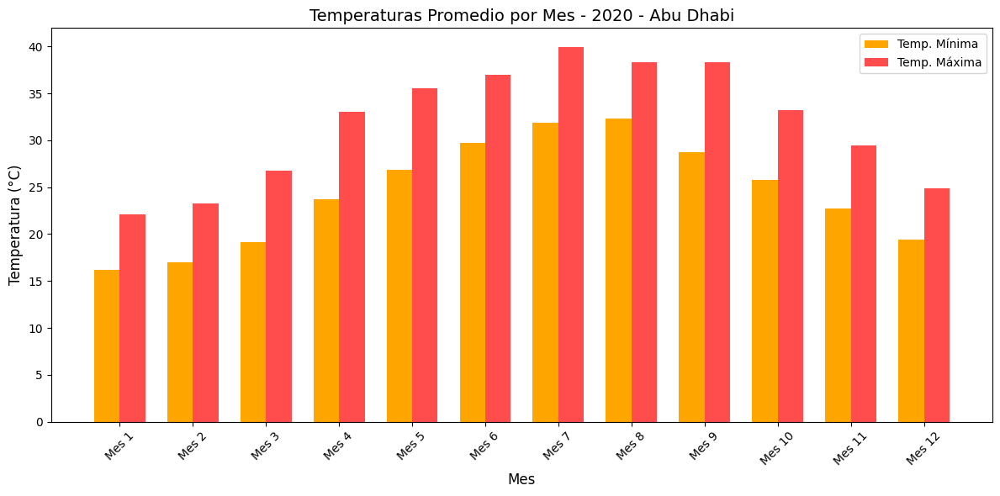


Top 3 meses más calurosos (Temp. máxima promedio más alta):
  Mes 7: 39.96 °C
  Mes 9: 38.36 °C
  Mes 8: 38.28 °C

Top 3 meses más fríos (Temp. mínima promedio más baja):
  Mes 1: 16.15 °C
  Mes 2: 16.98 °C
  Mes 3: 19.19 °C


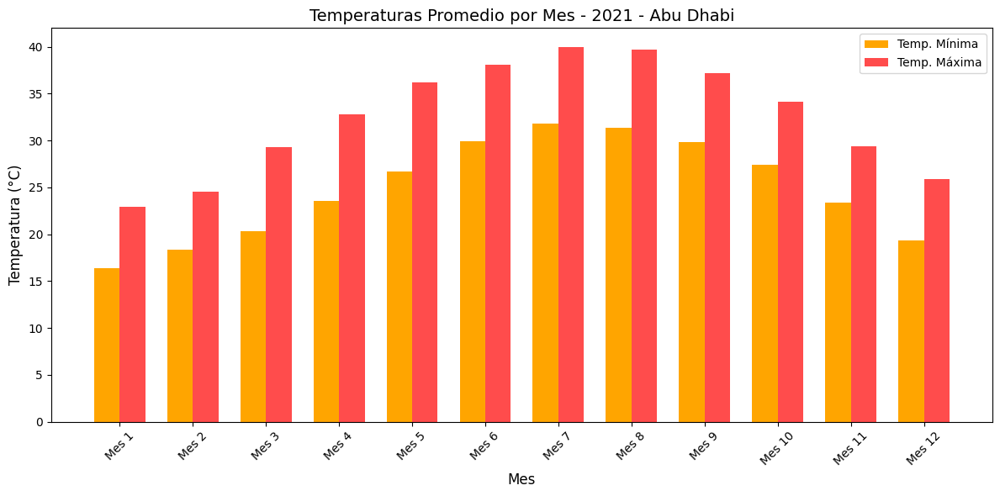


Top 3 meses más calurosos (Temp. máxima promedio más alta):
  Mes 7: 40.01 °C
  Mes 8: 39.69 °C
  Mes 6: 38.13 °C

Top 3 meses más fríos (Temp. mínima promedio más baja):
  Mes 1: 16.36 °C
  Mes 2: 18.40 °C
  Mes 12: 19.30 °C


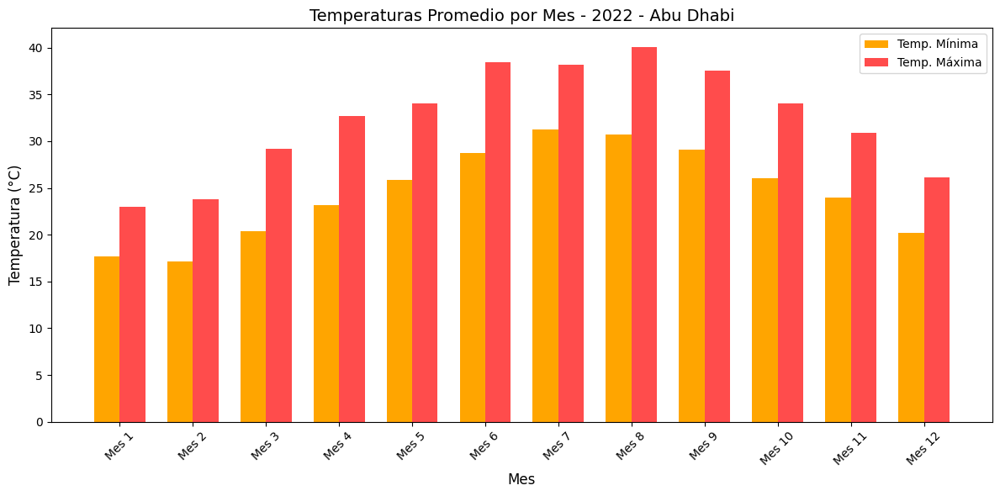


Top 3 meses más calurosos (Temp. máxima promedio más alta):
  Mes 8: 40.10 °C
  Mes 6: 38.43 °C
  Mes 7: 38.21 °C

Top 3 meses más fríos (Temp. mínima promedio más baja):
  Mes 2: 17.16 °C
  Mes 1: 17.71 °C
  Mes 12: 20.17 °C


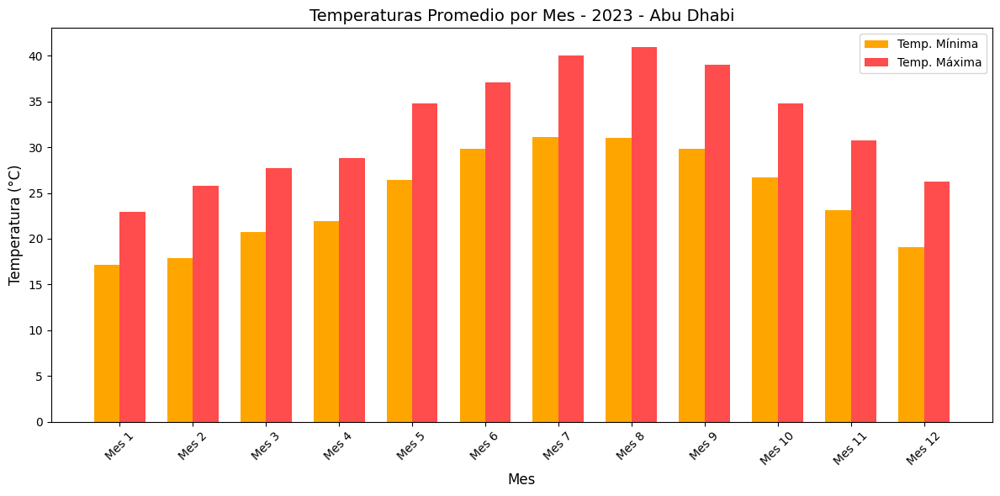


Top 3 meses más calurosos (Temp. máxima promedio más alta):
  Mes 8: 40.98 °C
  Mes 7: 40.03 °C
  Mes 9: 39.02 °C

Top 3 meses más fríos (Temp. mínima promedio más baja):
  Mes 1: 17.18 °C
  Mes 2: 17.88 °C
  Mes 12: 19.04 °C


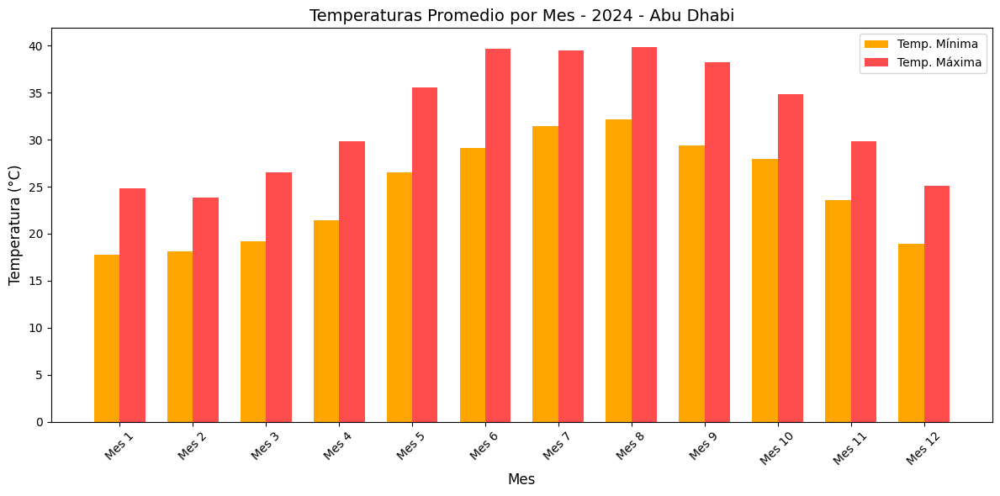


Top 3 meses más calurosos (Temp. máxima promedio más alta):
  Mes 8: 39.88 °C
  Mes 6: 39.63 °C
  Mes 7: 39.48 °C

Top 3 meses más fríos (Temp. mínima promedio más baja):
  Mes 1: 17.75 °C
  Mes 2: 18.09 °C
  Mes 12: 18.89 °C


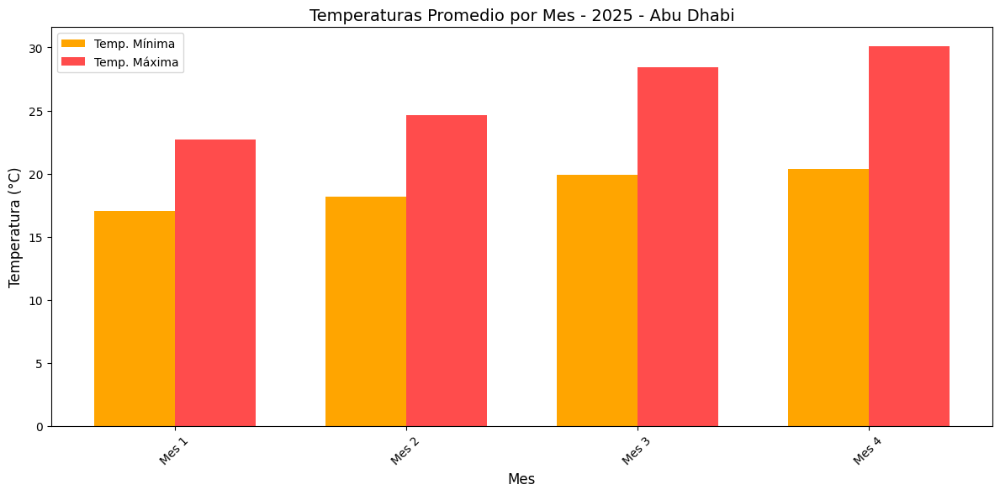


Top 3 meses más calurosos (Temp. máxima promedio más alta):
  Mes 4: 30.10 °C
  Mes 3: 28.45 °C
  Mes 2: 24.64 °C

Top 3 meses más fríos (Temp. mínima promedio más baja):
  Mes 1: 17.02 °C
  Mes 2: 18.20 °C
  Mes 3: 19.90 °C

===== Bangkok =====


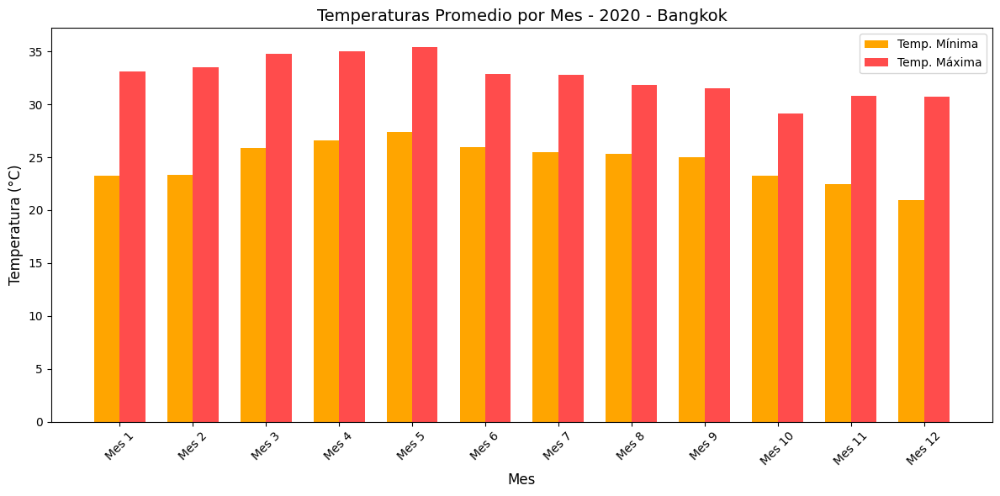


Top 3 meses más calurosos (Temp. máxima promedio más alta):
  Mes 5: 35.44 °C
  Mes 4: 35.03 °C
  Mes 3: 34.81 °C

Top 3 meses más fríos (Temp. mínima promedio más baja):
  Mes 12: 20.97 °C
  Mes 11: 22.46 °C
  Mes 1: 23.28 °C


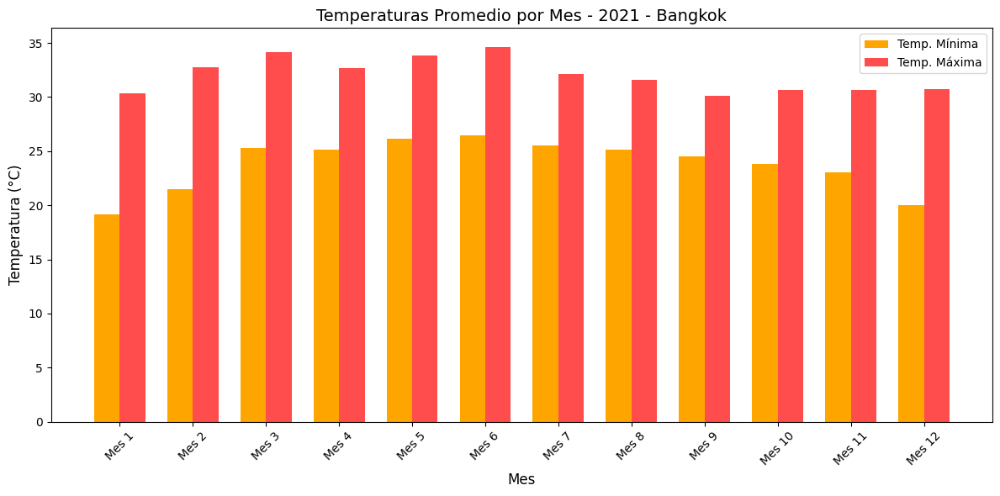


Top 3 meses más calurosos (Temp. máxima promedio más alta):
  Mes 6: 34.64 °C
  Mes 3: 34.14 °C
  Mes 5: 33.80 °C

Top 3 meses más fríos (Temp. mínima promedio más baja):
  Mes 1: 19.12 °C
  Mes 12: 20.01 °C
  Mes 2: 21.46 °C


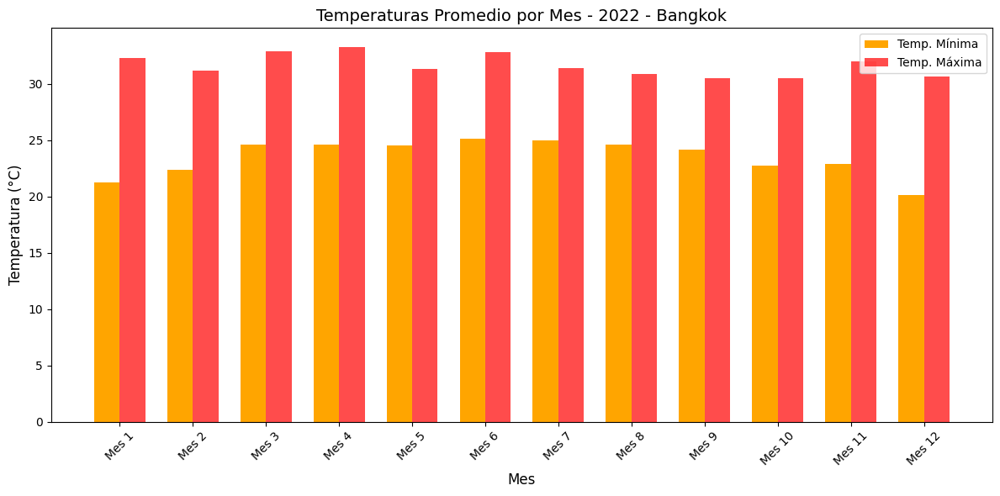


Top 3 meses más calurosos (Temp. máxima promedio más alta):
  Mes 4: 33.29 °C
  Mes 3: 32.91 °C
  Mes 6: 32.81 °C

Top 3 meses más fríos (Temp. mínima promedio más baja):
  Mes 12: 20.10 °C
  Mes 1: 21.26 °C
  Mes 2: 22.33 °C


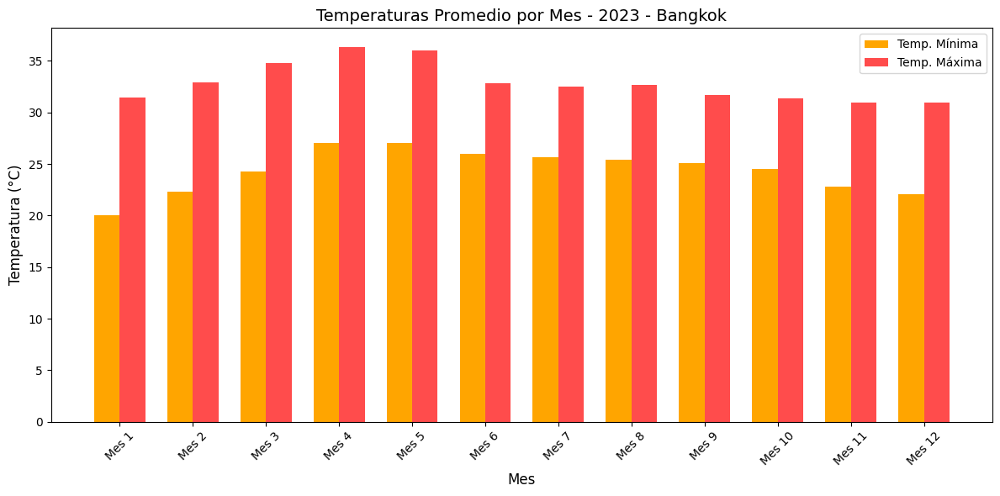


Top 3 meses más calurosos (Temp. máxima promedio más alta):
  Mes 4: 36.37 °C
  Mes 5: 36.01 °C
  Mes 3: 34.83 °C

Top 3 meses más fríos (Temp. mínima promedio más baja):
  Mes 1: 20.00 °C
  Mes 12: 22.09 °C
  Mes 2: 22.29 °C


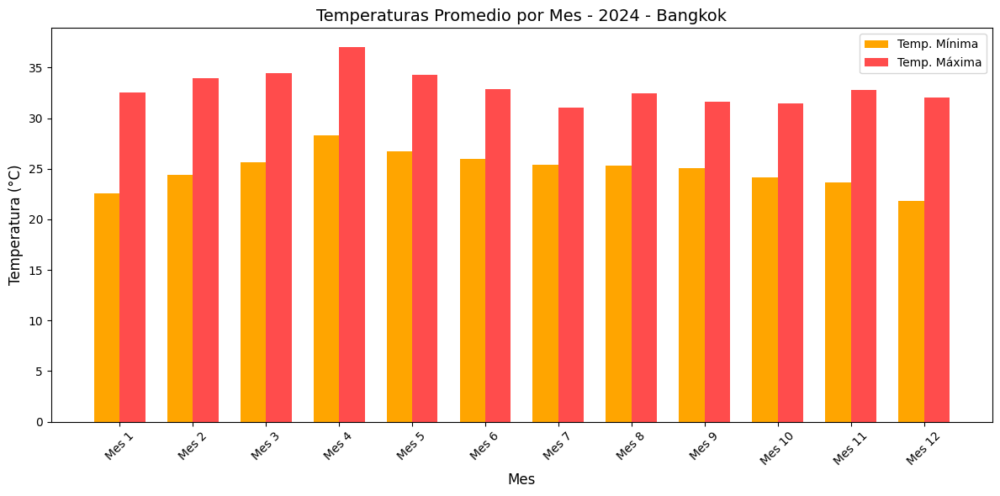


Top 3 meses más calurosos (Temp. máxima promedio más alta):
  Mes 4: 37.06 °C
  Mes 3: 34.47 °C
  Mes 5: 34.31 °C

Top 3 meses más fríos (Temp. mínima promedio más baja):
  Mes 12: 21.82 °C
  Mes 1: 22.58 °C
  Mes 11: 23.63 °C


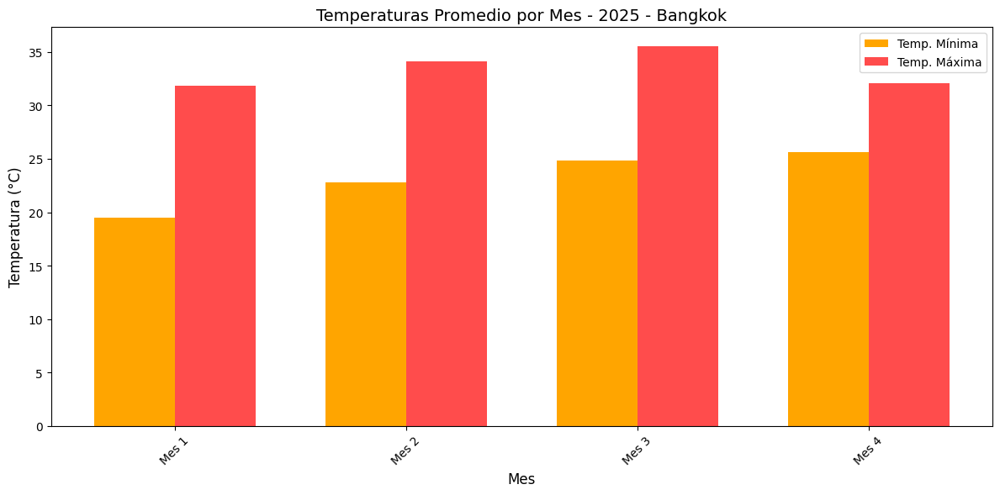


Top 3 meses más calurosos (Temp. máxima promedio más alta):
  Mes 3: 35.53 °C
  Mes 2: 34.11 °C
  Mes 4: 32.10 °C

Top 3 meses más fríos (Temp. mínima promedio más baja):
  Mes 1: 19.53 °C
  Mes 2: 22.76 °C
  Mes 3: 24.85 °C

===== Doha =====


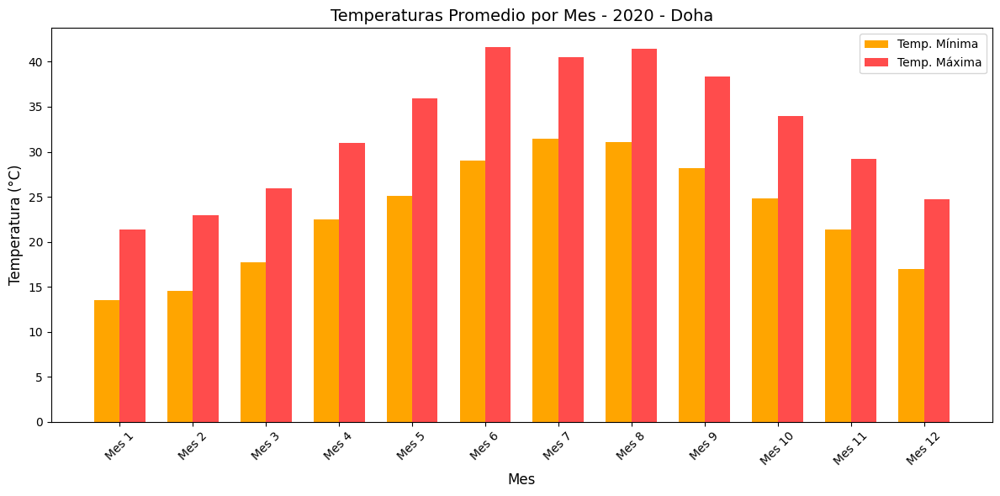


Top 3 meses más calurosos (Temp. máxima promedio más alta):
  Mes 6: 41.67 °C
  Mes 8: 41.43 °C
  Mes 7: 40.55 °C

Top 3 meses más fríos (Temp. mínima promedio más baja):
  Mes 1: 13.52 °C
  Mes 2: 14.52 °C
  Mes 12: 16.95 °C


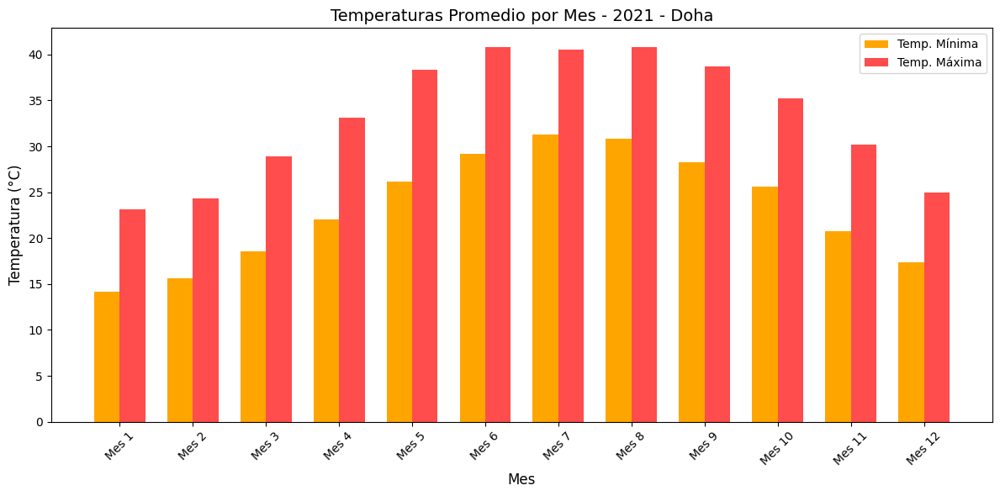


Top 3 meses más calurosos (Temp. máxima promedio más alta):
  Mes 6: 40.84 °C
  Mes 8: 40.76 °C
  Mes 7: 40.49 °C

Top 3 meses más fríos (Temp. mínima promedio más baja):
  Mes 1: 14.17 °C
  Mes 2: 15.61 °C
  Mes 12: 17.35 °C


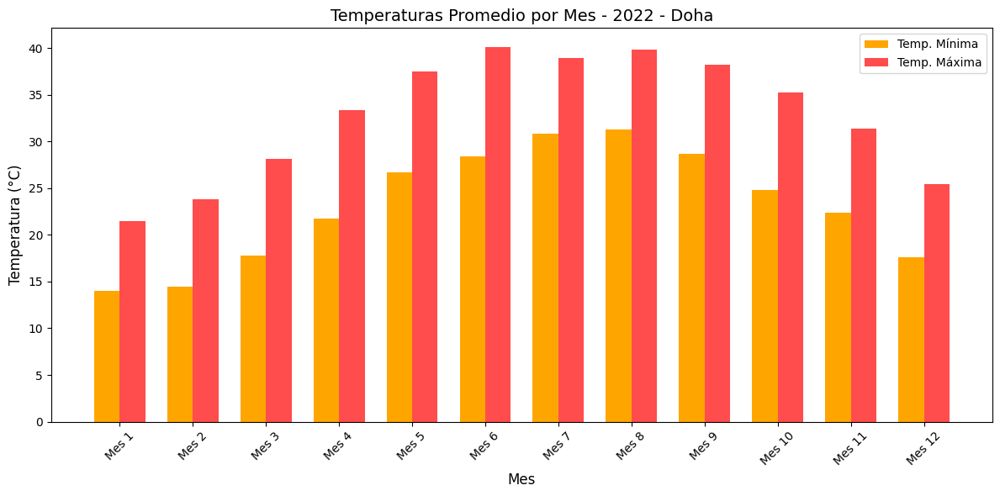


Top 3 meses más calurosos (Temp. máxima promedio más alta):
  Mes 6: 40.12 °C
  Mes 8: 39.85 °C
  Mes 7: 38.92 °C

Top 3 meses más fríos (Temp. mínima promedio más baja):
  Mes 1: 13.98 °C
  Mes 2: 14.49 °C
  Mes 12: 17.63 °C


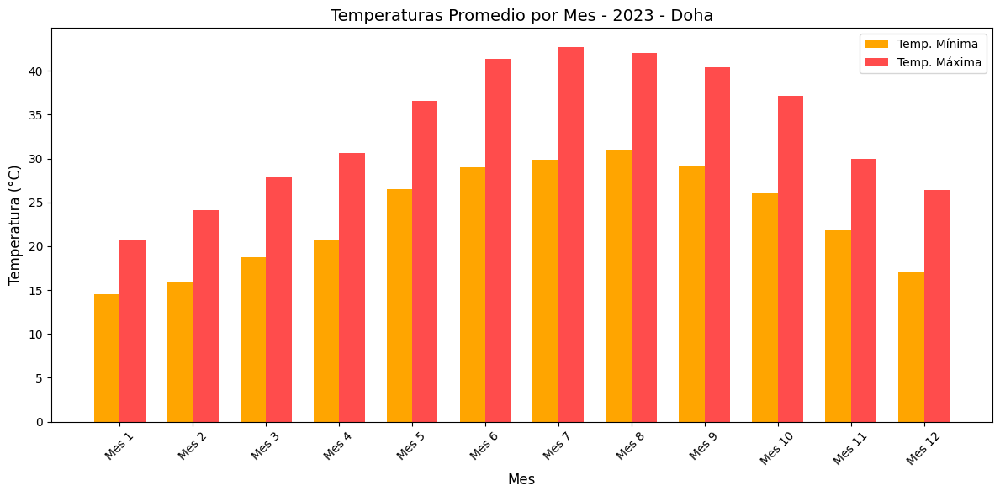


Top 3 meses más calurosos (Temp. máxima promedio más alta):
  Mes 7: 42.75 °C
  Mes 8: 42.01 °C
  Mes 6: 41.33 °C

Top 3 meses más fríos (Temp. mínima promedio más baja):
  Mes 1: 14.53 °C
  Mes 2: 15.84 °C
  Mes 12: 17.14 °C


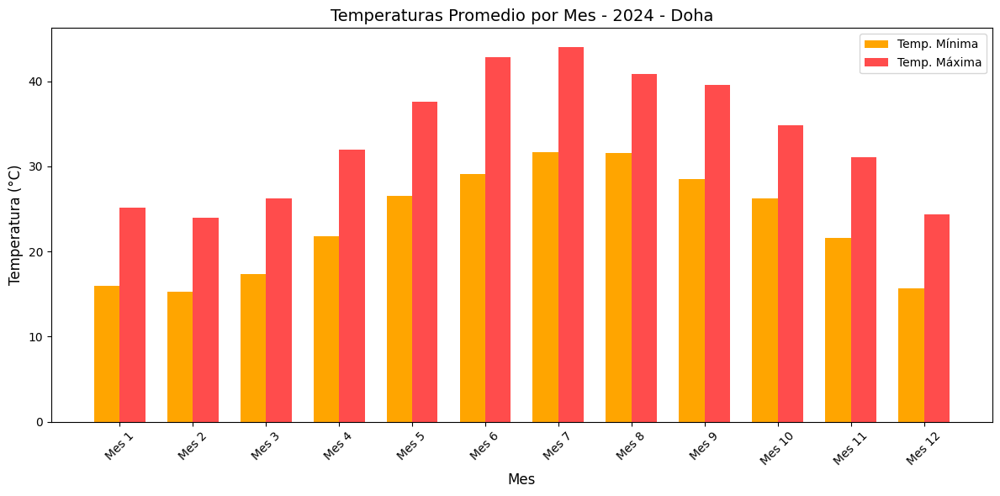


Top 3 meses más calurosos (Temp. máxima promedio más alta):
  Mes 7: 44.06 °C
  Mes 6: 42.85 °C
  Mes 8: 40.84 °C

Top 3 meses más fríos (Temp. mínima promedio más baja):
  Mes 2: 15.30 °C
  Mes 12: 15.70 °C
  Mes 1: 15.95 °C


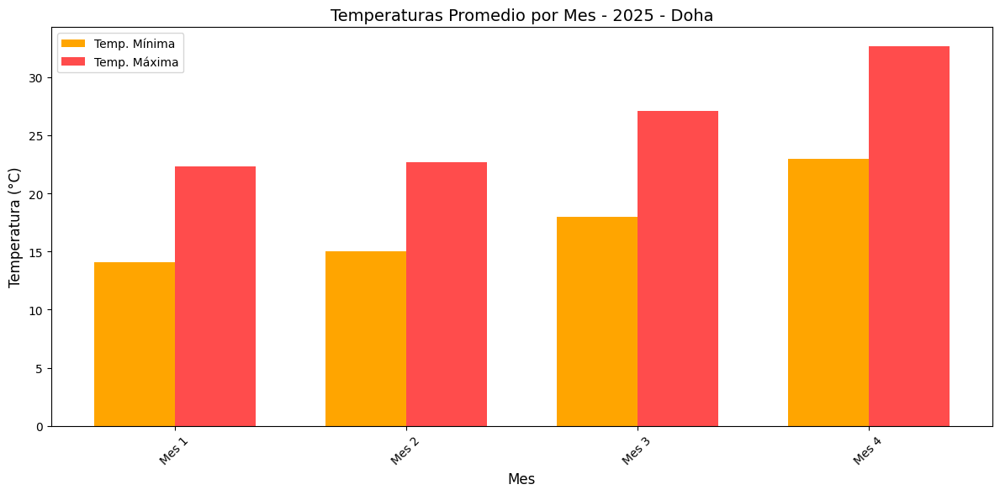


Top 3 meses más calurosos (Temp. máxima promedio más alta):
  Mes 4: 32.65 °C
  Mes 3: 27.12 °C
  Mes 2: 22.71 °C

Top 3 meses más fríos (Temp. mínima promedio más baja):
  Mes 1: 14.06 °C
  Mes 2: 15.00 °C
  Mes 3: 17.99 °C

===== Dubai =====


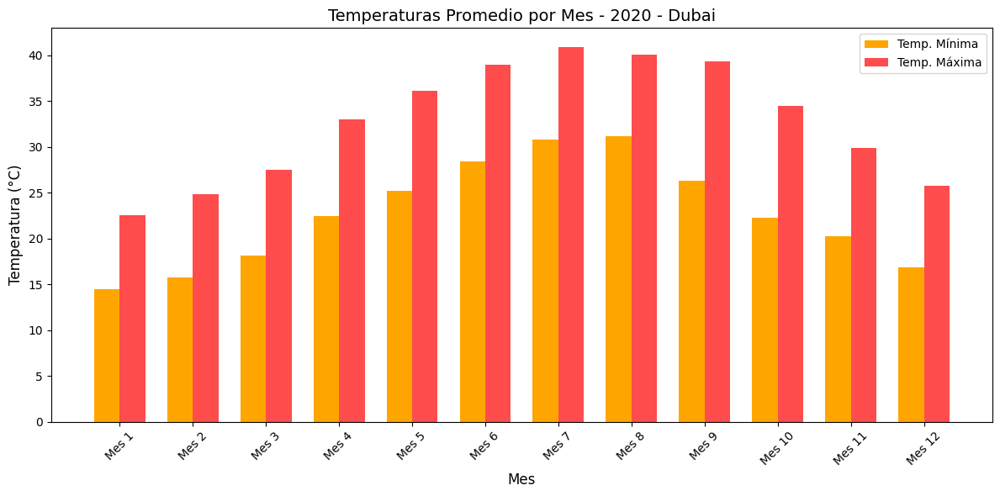


Top 3 meses más calurosos (Temp. máxima promedio más alta):
  Mes 7: 40.93 °C
  Mes 8: 40.05 °C
  Mes 9: 39.35 °C

Top 3 meses más fríos (Temp. mínima promedio más baja):
  Mes 1: 14.48 °C
  Mes 2: 15.77 °C
  Mes 12: 16.85 °C


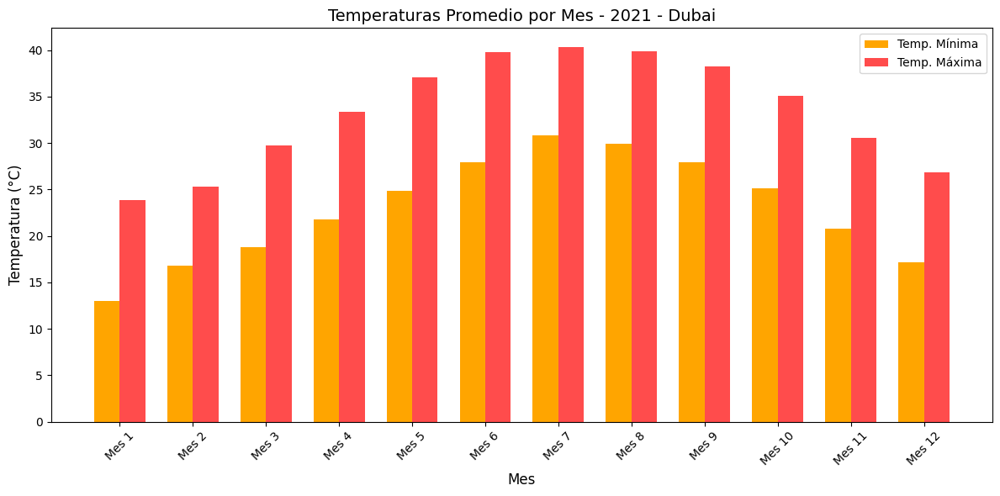


Top 3 meses más calurosos (Temp. máxima promedio más alta):
  Mes 7: 40.36 °C
  Mes 8: 39.89 °C
  Mes 6: 39.76 °C

Top 3 meses más fríos (Temp. mínima promedio más baja):
  Mes 1: 13.05 °C
  Mes 2: 16.81 °C
  Mes 12: 17.13 °C


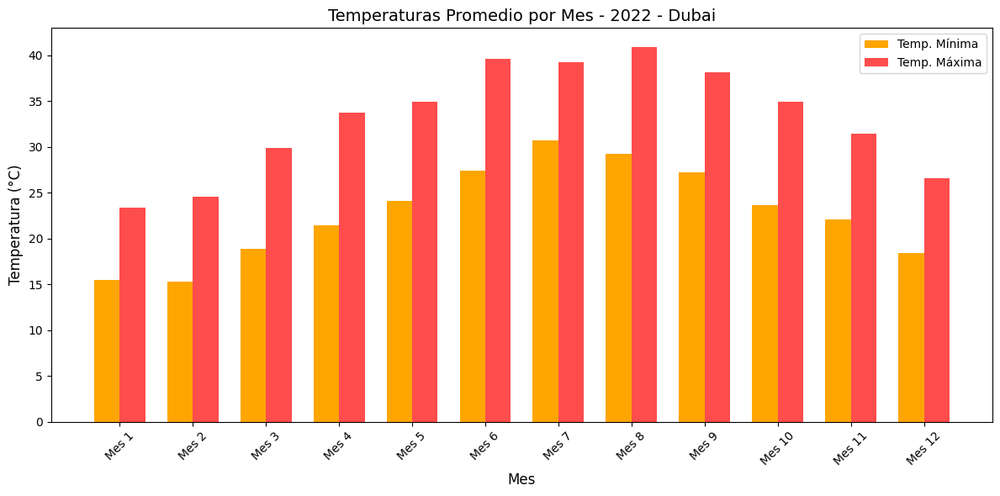


Top 3 meses más calurosos (Temp. máxima promedio más alta):
  Mes 8: 40.91 °C
  Mes 6: 39.58 °C
  Mes 7: 39.19 °C

Top 3 meses más fríos (Temp. mínima promedio más baja):
  Mes 2: 15.24 °C
  Mes 1: 15.45 °C
  Mes 12: 18.37 °C


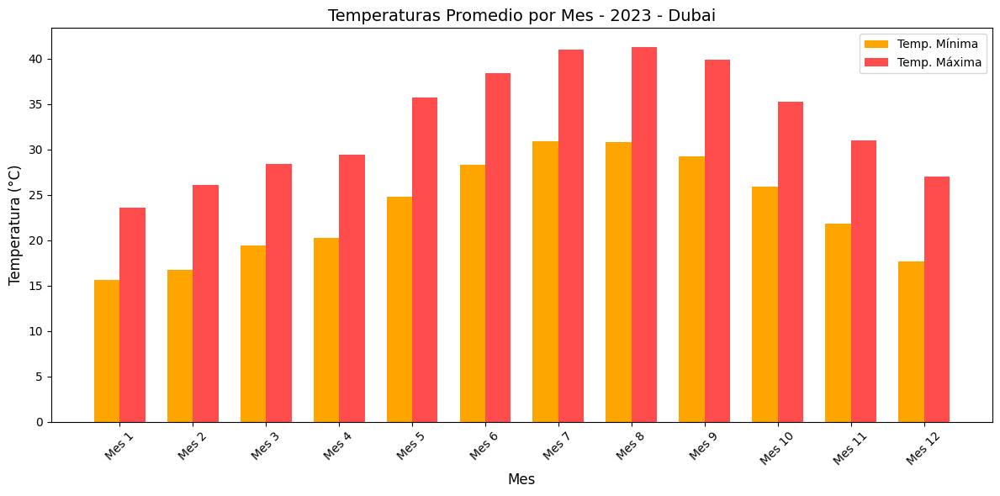


Top 3 meses más calurosos (Temp. máxima promedio más alta):
  Mes 8: 41.30 °C
  Mes 7: 41.03 °C
  Mes 9: 39.88 °C

Top 3 meses más fríos (Temp. mínima promedio más baja):
  Mes 1: 15.58 °C
  Mes 2: 16.71 °C
  Mes 12: 17.66 °C


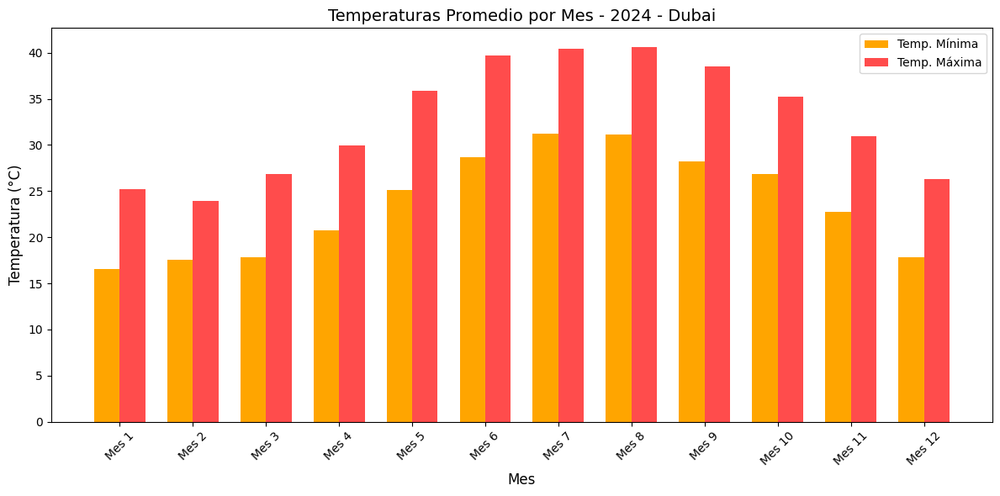


Top 3 meses más calurosos (Temp. máxima promedio más alta):
  Mes 8: 40.64 °C
  Mes 7: 40.47 °C
  Mes 6: 39.68 °C

Top 3 meses más fríos (Temp. mínima promedio más baja):
  Mes 1: 16.57 °C
  Mes 2: 17.59 °C
  Mes 3: 17.80 °C


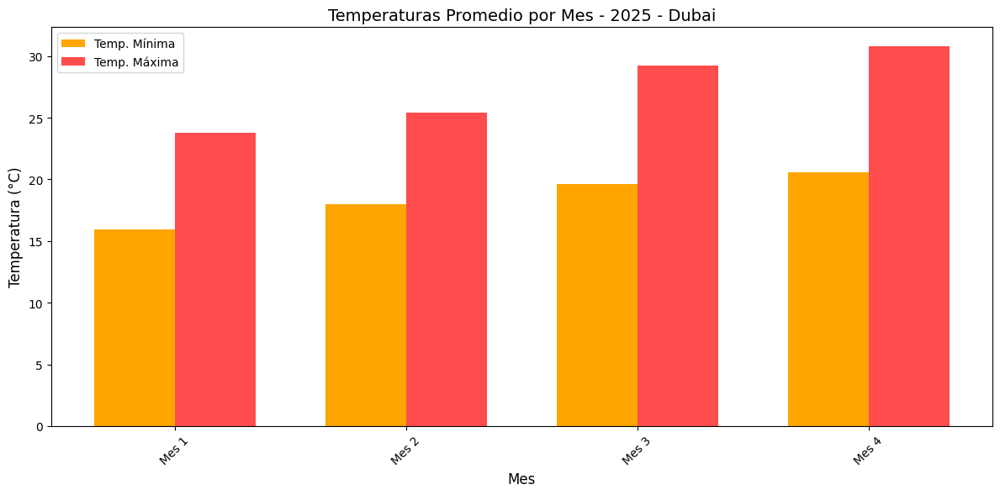


Top 3 meses más calurosos (Temp. máxima promedio más alta):
  Mes 4: 30.80 °C
  Mes 3: 29.25 °C
  Mes 2: 25.41 °C

Top 3 meses más fríos (Temp. mínima promedio más baja):
  Mes 1: 15.95 °C
  Mes 2: 17.96 °C
  Mes 3: 19.63 °C

===== Kuwait City =====


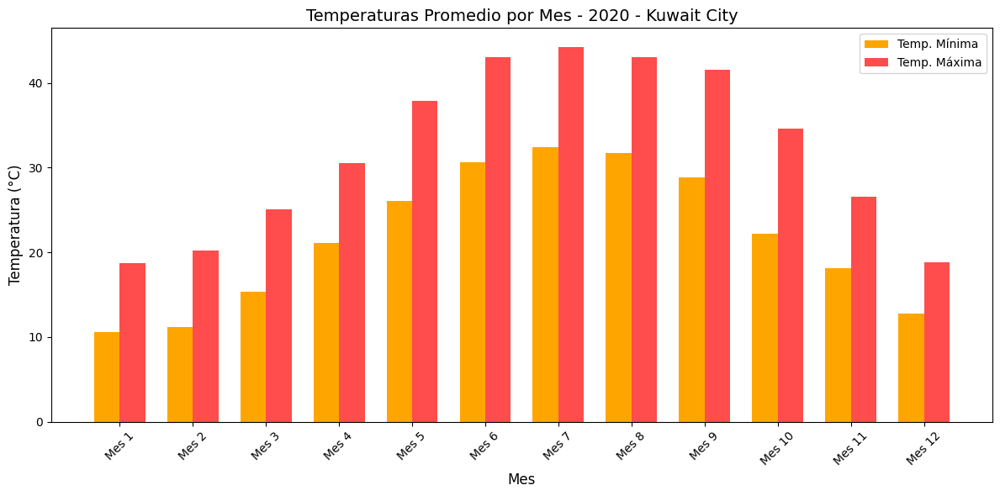


Top 3 meses más calurosos (Temp. máxima promedio más alta):
  Mes 7: 44.26 °C
  Mes 8: 43.07 °C
  Mes 6: 42.99 °C

Top 3 meses más fríos (Temp. mínima promedio más baja):
  Mes 1: 10.54 °C
  Mes 2: 11.21 °C
  Mes 12: 12.72 °C


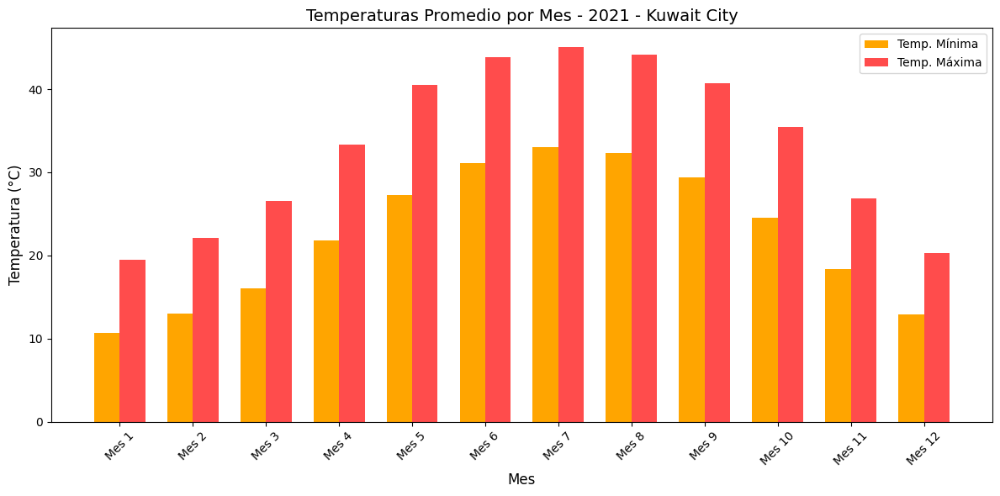


Top 3 meses más calurosos (Temp. máxima promedio más alta):
  Mes 7: 45.09 °C
  Mes 8: 44.18 °C
  Mes 6: 43.86 °C

Top 3 meses más fríos (Temp. mínima promedio más baja):
  Mes 1: 10.65 °C
  Mes 12: 12.92 °C
  Mes 2: 12.98 °C


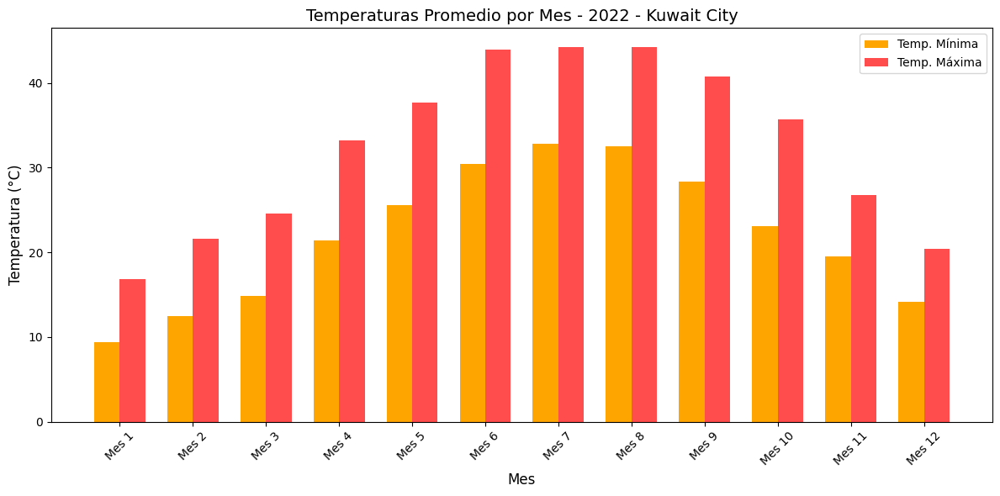


Top 3 meses más calurosos (Temp. máxima promedio más alta):
  Mes 8: 44.28 °C
  Mes 7: 44.23 °C
  Mes 6: 43.92 °C

Top 3 meses más fríos (Temp. mínima promedio más baja):
  Mes 1: 9.37 °C
  Mes 2: 12.45 °C
  Mes 12: 14.20 °C


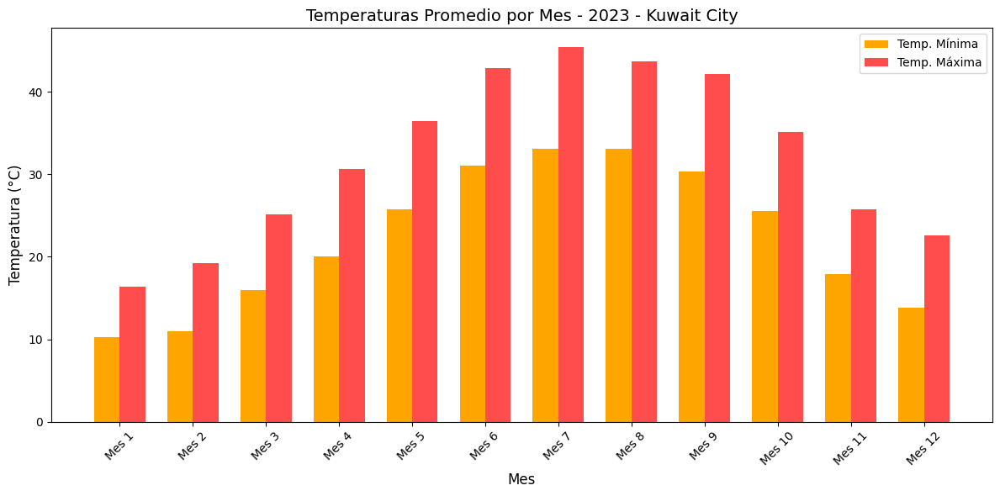


Top 3 meses más calurosos (Temp. máxima promedio más alta):
  Mes 7: 45.45 °C
  Mes 8: 43.66 °C
  Mes 6: 42.87 °C

Top 3 meses más fríos (Temp. mínima promedio más baja):
  Mes 1: 10.26 °C
  Mes 2: 10.98 °C
  Mes 12: 13.83 °C


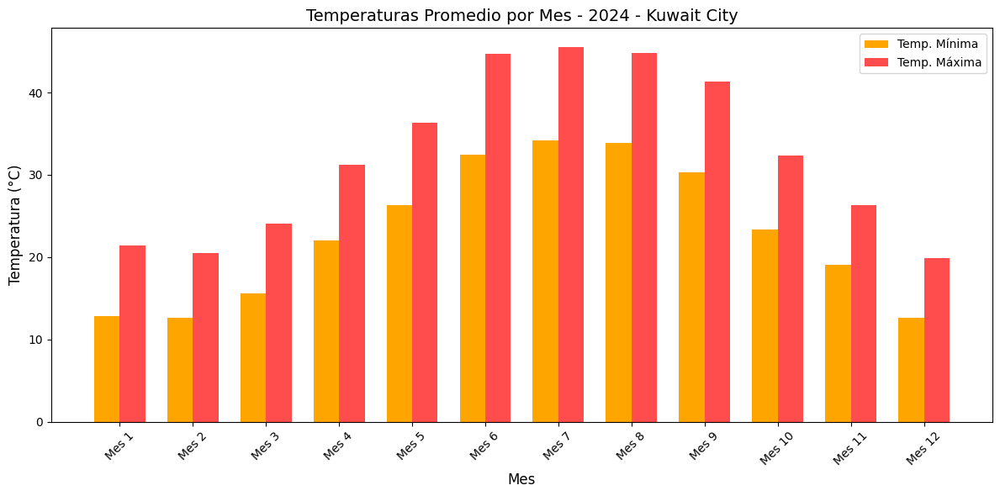


Top 3 meses más calurosos (Temp. máxima promedio más alta):
  Mes 7: 45.55 °C
  Mes 8: 44.76 °C
  Mes 6: 44.70 °C

Top 3 meses más fríos (Temp. mínima promedio más baja):
  Mes 12: 12.59 °C
  Mes 2: 12.66 °C
  Mes 1: 12.85 °C


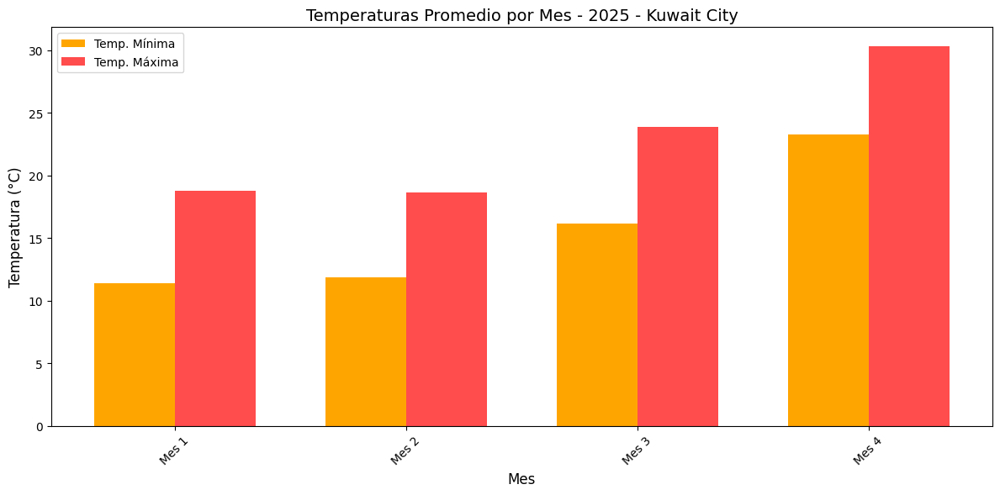


Top 3 meses más calurosos (Temp. máxima promedio más alta):
  Mes 4: 30.32 °C
  Mes 3: 23.89 °C
  Mes 1: 18.81 °C

Top 3 meses más fríos (Temp. mínima promedio más baja):
  Mes 1: 11.37 °C
  Mes 2: 11.89 °C
  Mes 3: 16.16 °C

===== Muscat =====


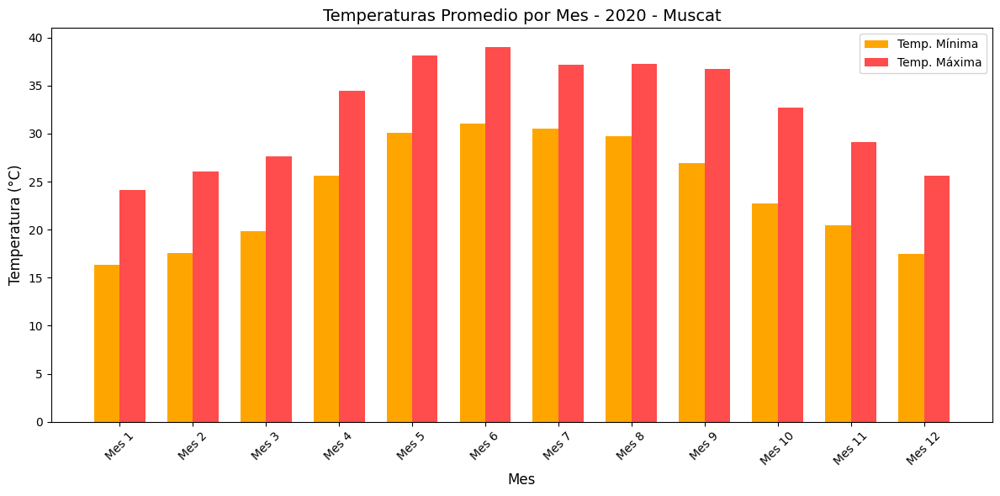


Top 3 meses más calurosos (Temp. máxima promedio más alta):
  Mes 6: 39.04 °C
  Mes 5: 38.15 °C
  Mes 8: 37.25 °C

Top 3 meses más fríos (Temp. mínima promedio más baja):
  Mes 1: 16.29 °C
  Mes 12: 17.45 °C
  Mes 2: 17.60 °C


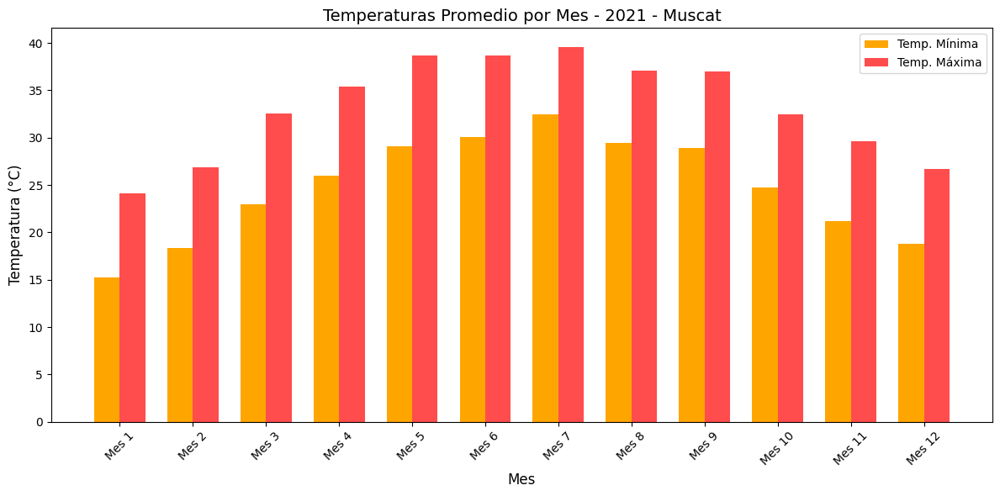


Top 3 meses más calurosos (Temp. máxima promedio más alta):
  Mes 7: 39.60 °C
  Mes 5: 38.70 °C
  Mes 6: 38.69 °C

Top 3 meses más fríos (Temp. mínima promedio más baja):
  Mes 1: 15.22 °C
  Mes 2: 18.35 °C
  Mes 12: 18.78 °C


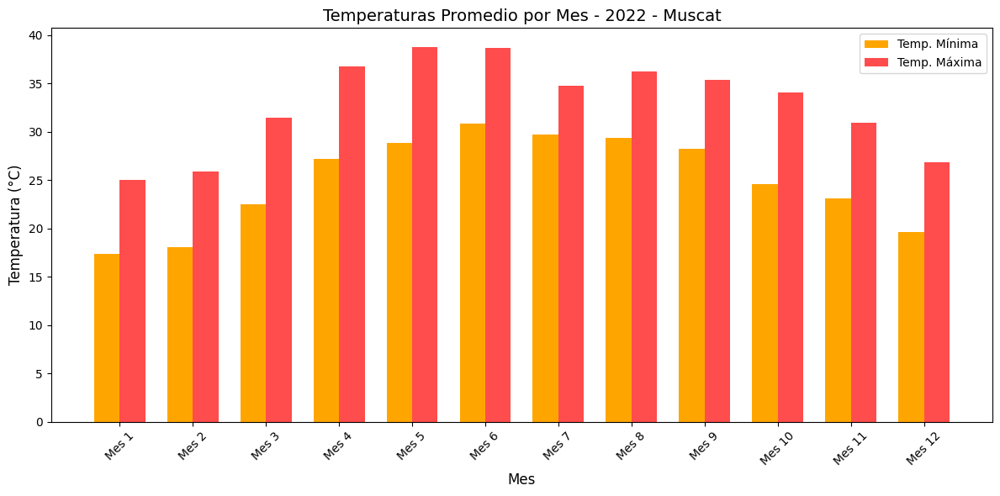


Top 3 meses más calurosos (Temp. máxima promedio más alta):
  Mes 5: 38.79 °C
  Mes 6: 38.66 °C
  Mes 4: 36.74 °C

Top 3 meses más fríos (Temp. mínima promedio más baja):
  Mes 1: 17.39 °C
  Mes 2: 18.06 °C
  Mes 12: 19.65 °C


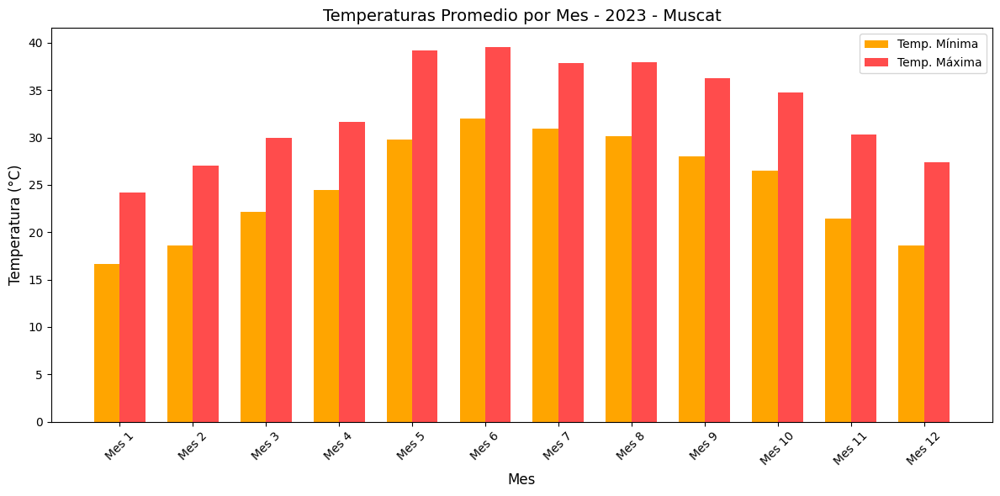


Top 3 meses más calurosos (Temp. máxima promedio más alta):
  Mes 6: 39.57 °C
  Mes 5: 39.17 °C
  Mes 8: 37.95 °C

Top 3 meses más fríos (Temp. mínima promedio más baja):
  Mes 1: 16.63 °C
  Mes 2: 18.60 °C
  Mes 12: 18.64 °C


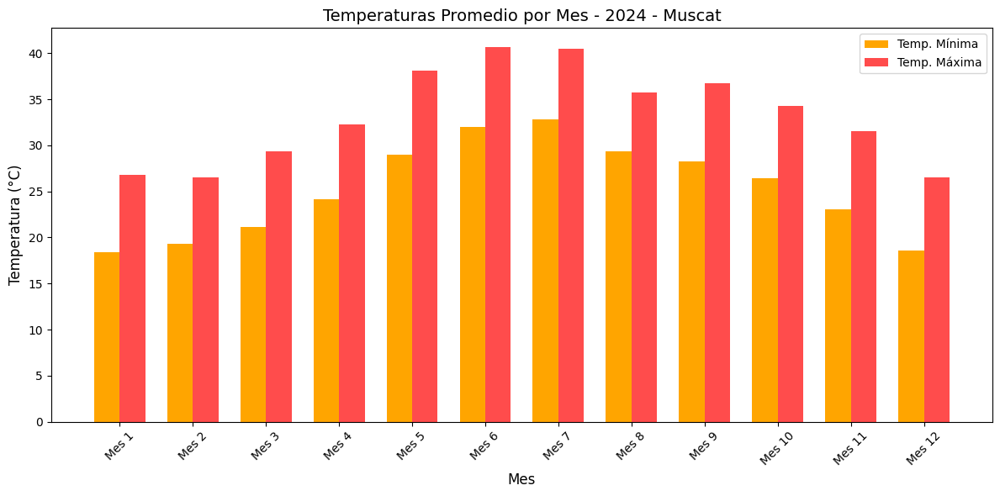


Top 3 meses más calurosos (Temp. máxima promedio más alta):
  Mes 6: 40.70 °C
  Mes 7: 40.46 °C
  Mes 5: 38.14 °C

Top 3 meses más fríos (Temp. mínima promedio más baja):
  Mes 1: 18.42 °C
  Mes 12: 18.54 °C
  Mes 2: 19.32 °C


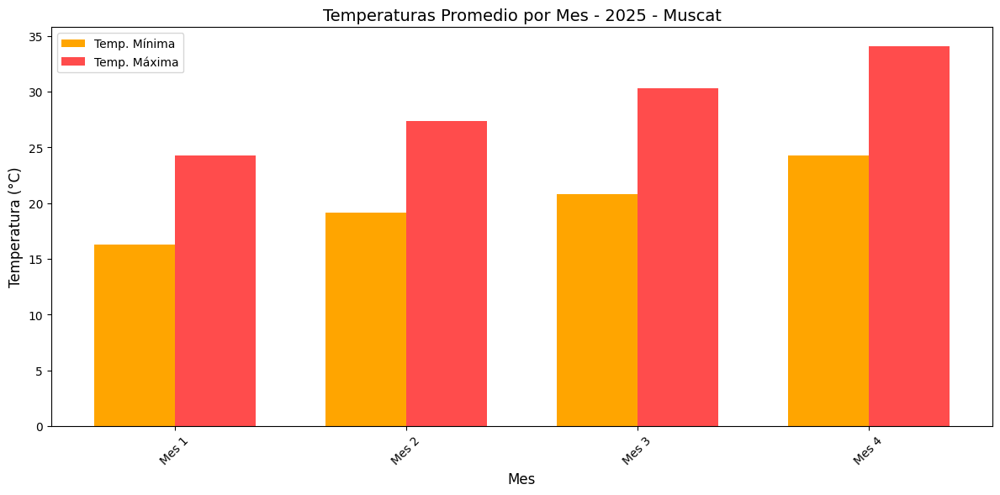


Top 3 meses más calurosos (Temp. máxima promedio más alta):
  Mes 4: 34.08 °C
  Mes 3: 30.29 °C
  Mes 2: 27.32 °C

Top 3 meses más fríos (Temp. mínima promedio más baja):
  Mes 1: 16.28 °C
  Mes 2: 19.13 °C
  Mes 3: 20.77 °C

===== Rio de Janeiro =====


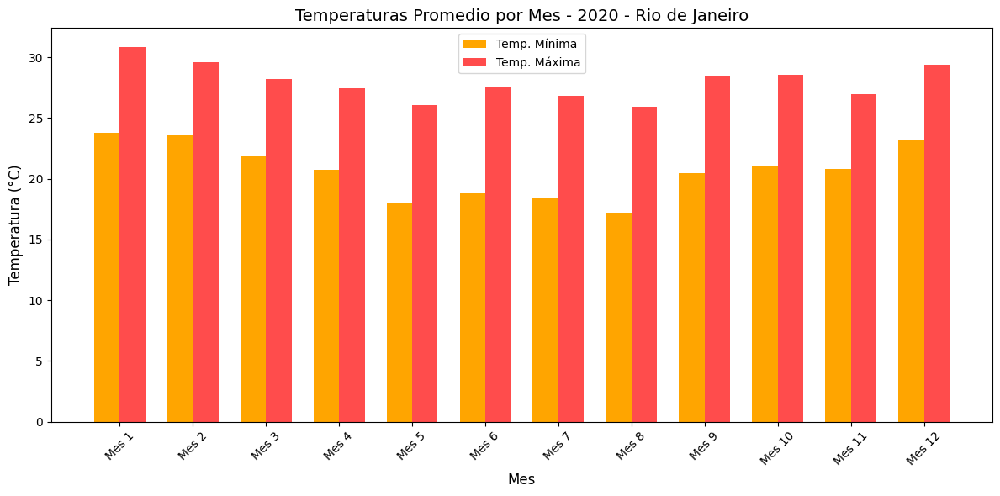


Top 3 meses más calurosos (Temp. máxima promedio más alta):
  Mes 1: 30.86 °C
  Mes 2: 29.62 °C
  Mes 12: 29.42 °C

Top 3 meses más fríos (Temp. mínima promedio más baja):
  Mes 8: 17.23 °C
  Mes 5: 18.03 °C
  Mes 7: 18.37 °C


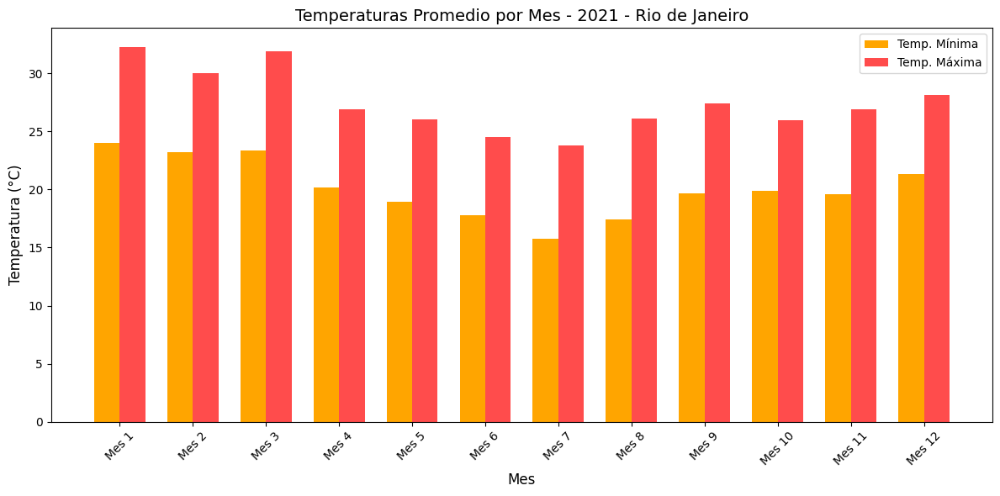


Top 3 meses más calurosos (Temp. máxima promedio más alta):
  Mes 1: 32.30 °C
  Mes 3: 31.88 °C
  Mes 2: 30.01 °C

Top 3 meses más fríos (Temp. mínima promedio más baja):
  Mes 7: 15.79 °C
  Mes 8: 17.44 °C
  Mes 6: 17.82 °C


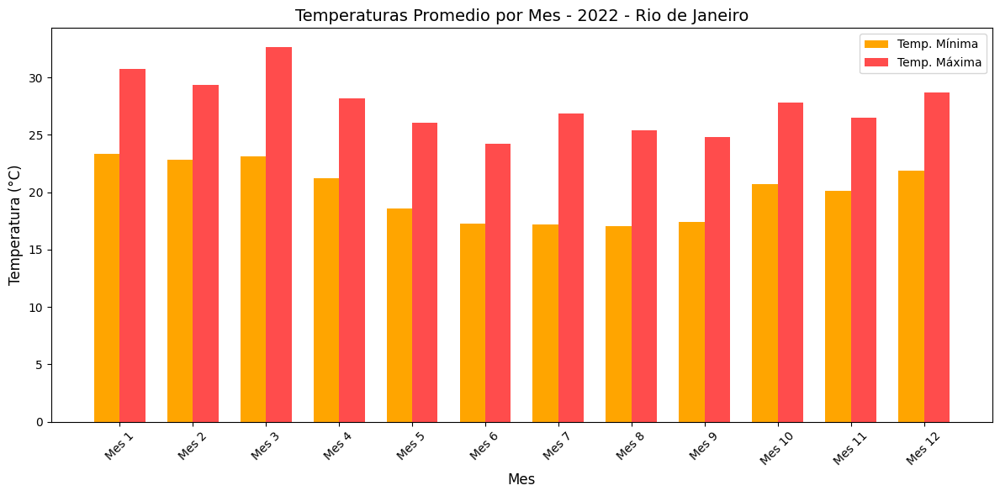


Top 3 meses más calurosos (Temp. máxima promedio más alta):
  Mes 3: 32.67 °C
  Mes 1: 30.75 °C
  Mes 2: 29.33 °C

Top 3 meses más fríos (Temp. mínima promedio más baja):
  Mes 8: 17.07 °C
  Mes 7: 17.19 °C
  Mes 6: 17.23 °C


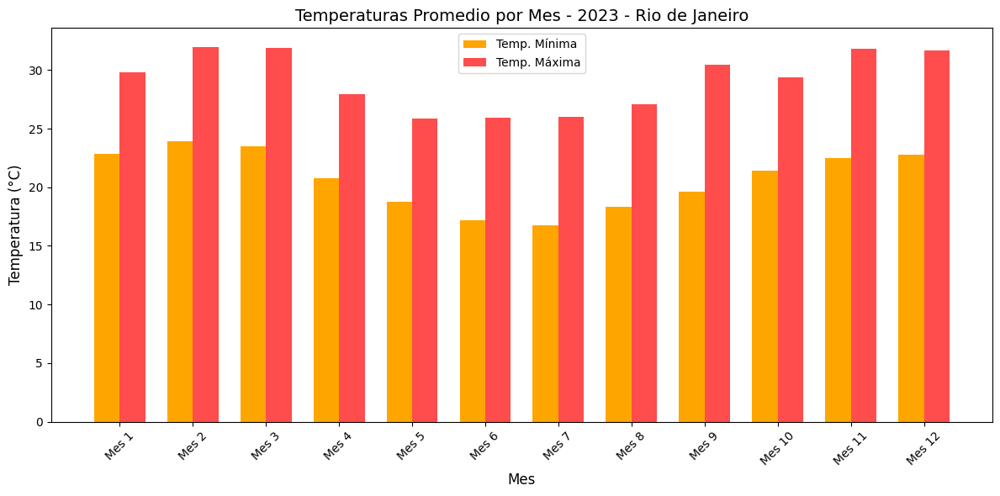


Top 3 meses más calurosos (Temp. máxima promedio más alta):
  Mes 2: 31.98 °C
  Mes 3: 31.89 °C
  Mes 11: 31.79 °C

Top 3 meses más fríos (Temp. mínima promedio más baja):
  Mes 7: 16.76 °C
  Mes 6: 17.22 °C
  Mes 8: 18.35 °C


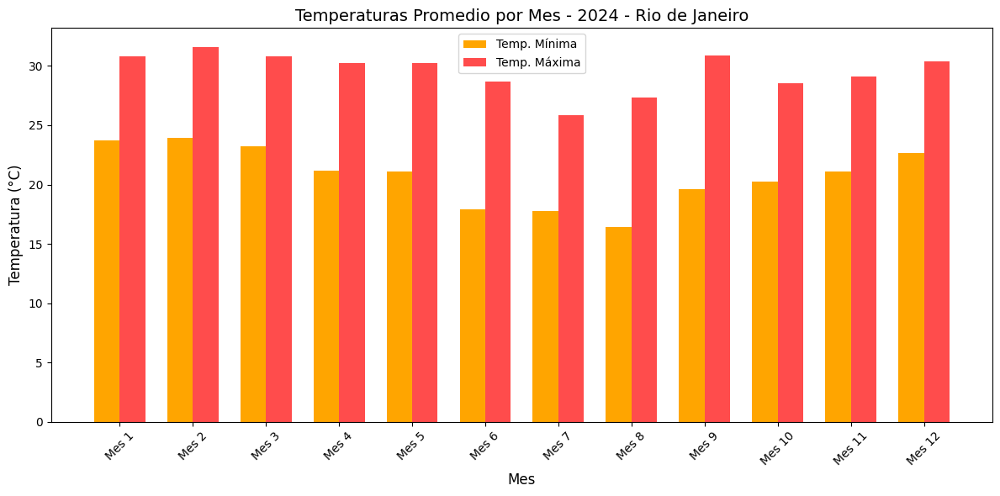


Top 3 meses más calurosos (Temp. máxima promedio más alta):
  Mes 2: 31.62 °C
  Mes 9: 30.90 °C
  Mes 1: 30.81 °C

Top 3 meses más fríos (Temp. mínima promedio más baja):
  Mes 8: 16.43 °C
  Mes 7: 17.78 °C
  Mes 6: 17.91 °C


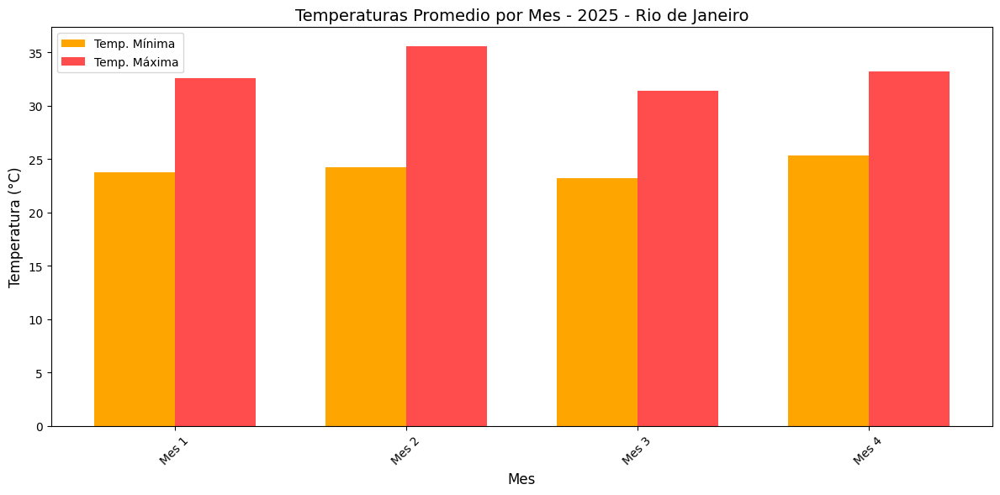


Top 3 meses más calurosos (Temp. máxima promedio más alta):
  Mes 2: 35.58 °C
  Mes 4: 33.23 °C
  Mes 1: 32.60 °C

Top 3 meses más fríos (Temp. mínima promedio más baja):
  Mes 3: 23.18 °C
  Mes 1: 23.77 °C
  Mes 2: 24.23 °C

===== Riyadh =====


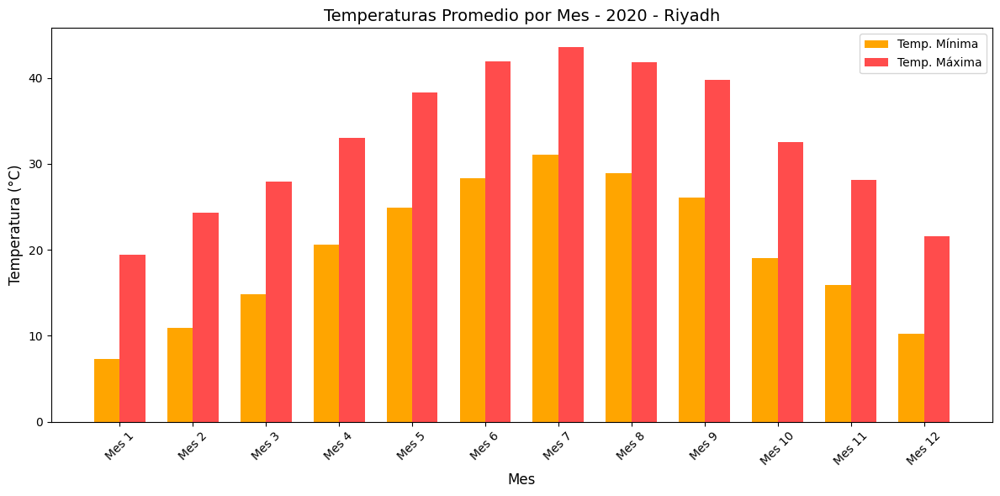


Top 3 meses más calurosos (Temp. máxima promedio más alta):
  Mes 7: 43.62 °C
  Mes 6: 41.94 °C
  Mes 8: 41.85 °C

Top 3 meses más fríos (Temp. mínima promedio más baja):
  Mes 1: 7.34 °C
  Mes 12: 10.28 °C
  Mes 2: 10.88 °C


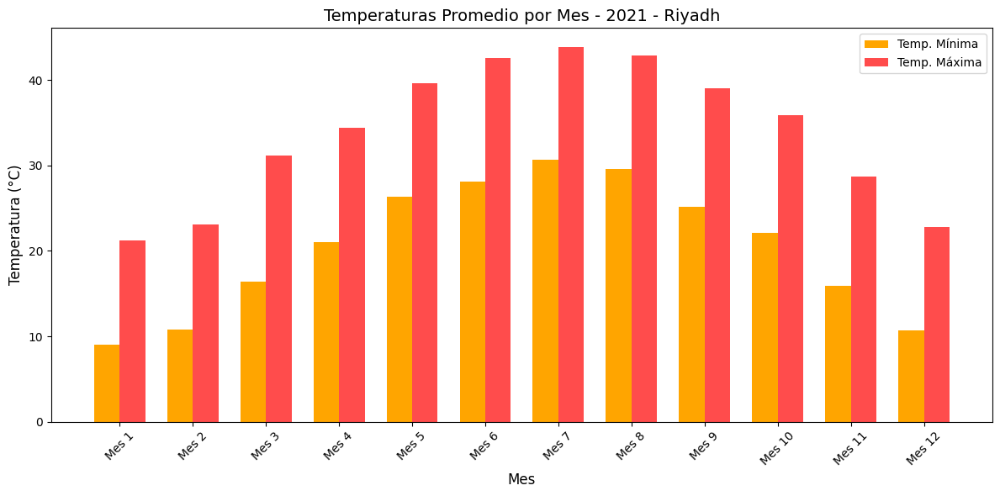


Top 3 meses más calurosos (Temp. máxima promedio más alta):
  Mes 7: 43.89 °C
  Mes 8: 42.84 °C
  Mes 6: 42.53 °C

Top 3 meses más fríos (Temp. mínima promedio más baja):
  Mes 1: 8.98 °C
  Mes 12: 10.74 °C
  Mes 2: 10.81 °C


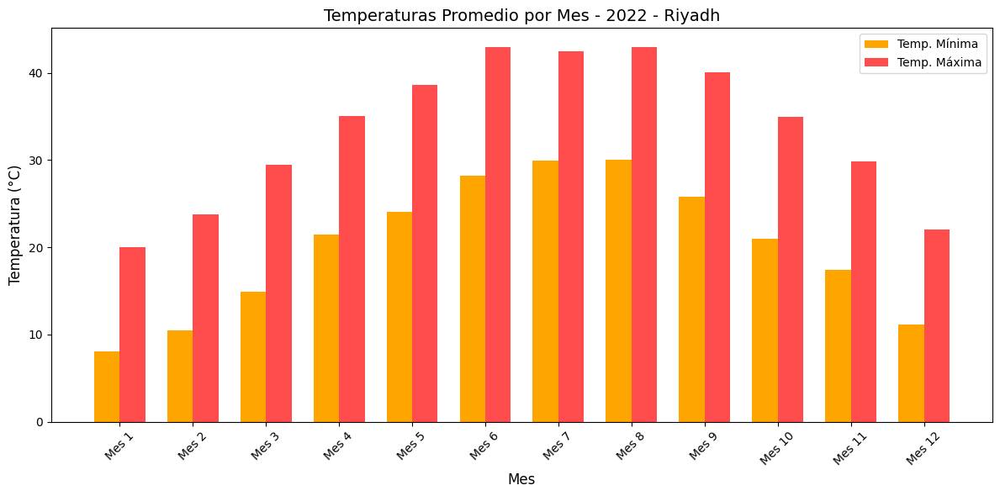


Top 3 meses más calurosos (Temp. máxima promedio más alta):
  Mes 8: 42.98 °C
  Mes 6: 42.95 °C
  Mes 7: 42.48 °C

Top 3 meses más fríos (Temp. mínima promedio más baja):
  Mes 1: 8.04 °C
  Mes 2: 10.42 °C
  Mes 12: 11.18 °C


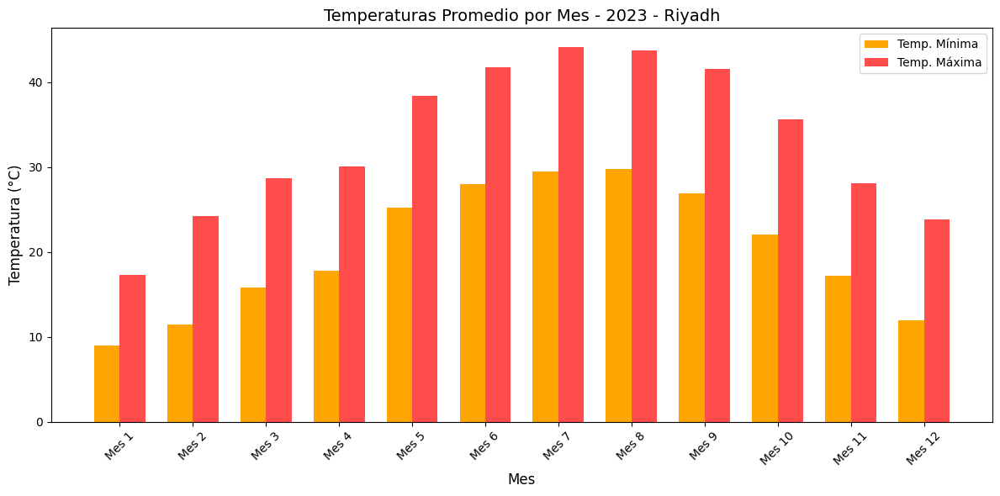


Top 3 meses más calurosos (Temp. máxima promedio más alta):
  Mes 7: 44.20 °C
  Mes 8: 43.81 °C
  Mes 6: 41.74 °C

Top 3 meses más fríos (Temp. mínima promedio más baja):
  Mes 1: 8.99 °C
  Mes 2: 11.50 °C
  Mes 12: 12.00 °C


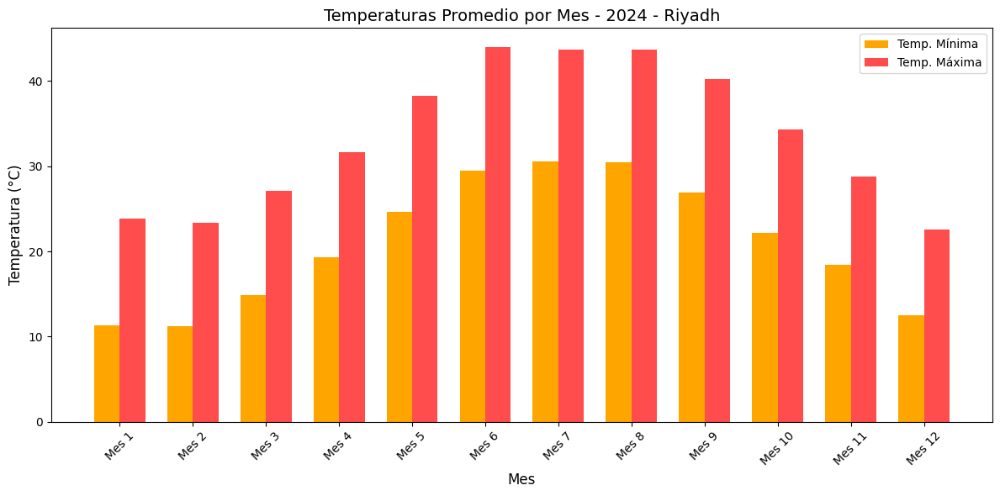


Top 3 meses más calurosos (Temp. máxima promedio más alta):
  Mes 6: 44.02 °C
  Mes 7: 43.71 °C
  Mes 8: 43.67 °C

Top 3 meses más fríos (Temp. mínima promedio más baja):
  Mes 2: 11.27 °C
  Mes 1: 11.30 °C
  Mes 12: 12.48 °C


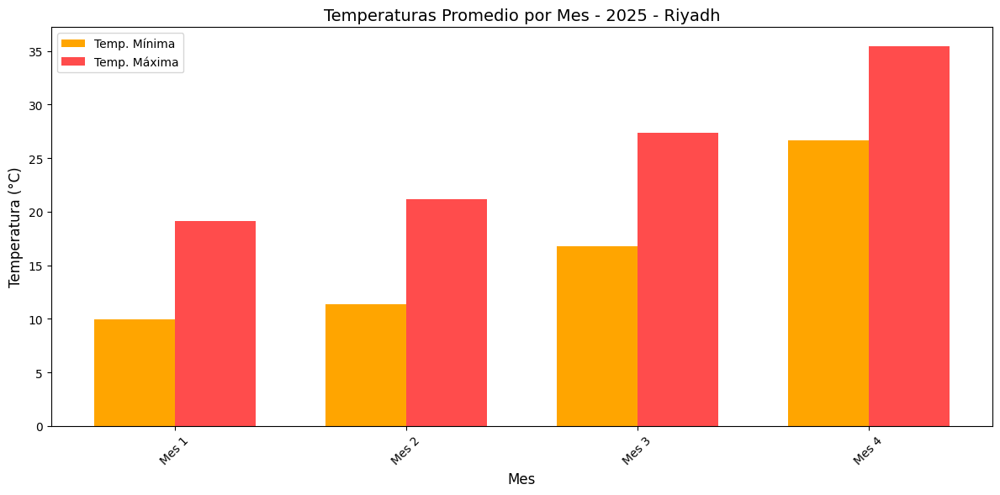


Top 3 meses más calurosos (Temp. máxima promedio más alta):
  Mes 4: 35.45 °C
  Mes 3: 27.35 °C
  Mes 2: 21.16 °C

Top 3 meses más fríos (Temp. mínima promedio más baja):
  Mes 1: 9.93 °C
  Mes 2: 11.36 °C
  Mes 3: 16.77 °C

===== San Diego =====


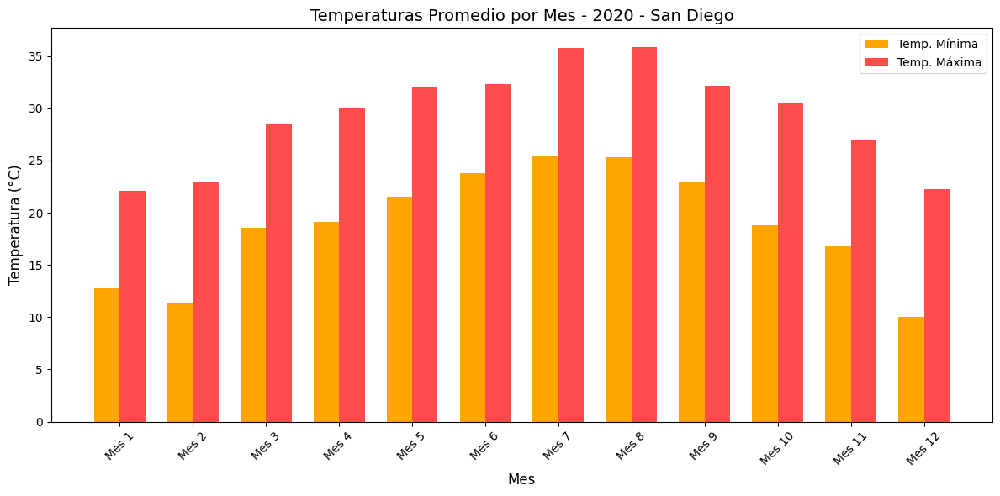


Top 3 meses más calurosos (Temp. máxima promedio más alta):
  Mes 8: 35.88 °C
  Mes 7: 35.80 °C
  Mes 6: 32.33 °C

Top 3 meses más fríos (Temp. mínima promedio más baja):
  Mes 12: 9.99 °C
  Mes 2: 11.32 °C
  Mes 1: 12.84 °C


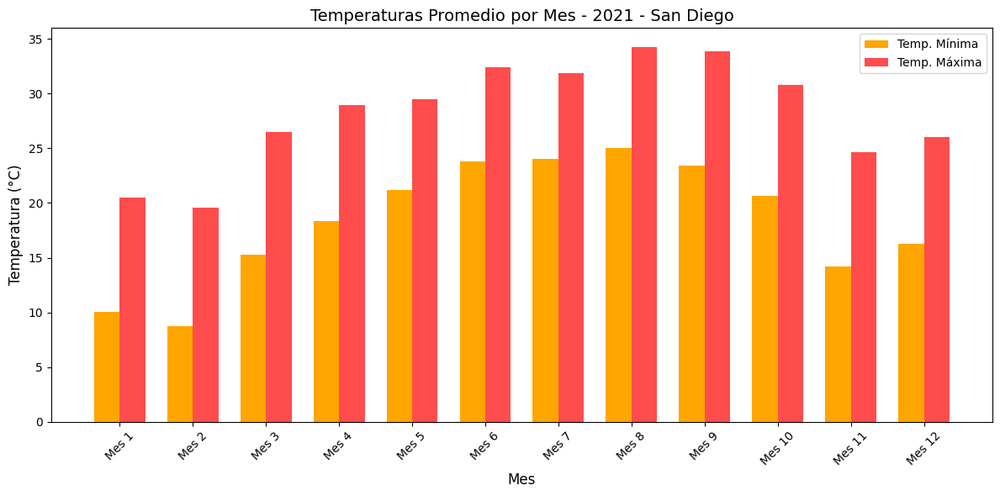


Top 3 meses más calurosos (Temp. máxima promedio más alta):
  Mes 8: 34.29 °C
  Mes 9: 33.91 °C
  Mes 6: 32.40 °C

Top 3 meses más fríos (Temp. mínima promedio más baja):
  Mes 2: 8.72 °C
  Mes 1: 10.05 °C
  Mes 11: 14.23 °C


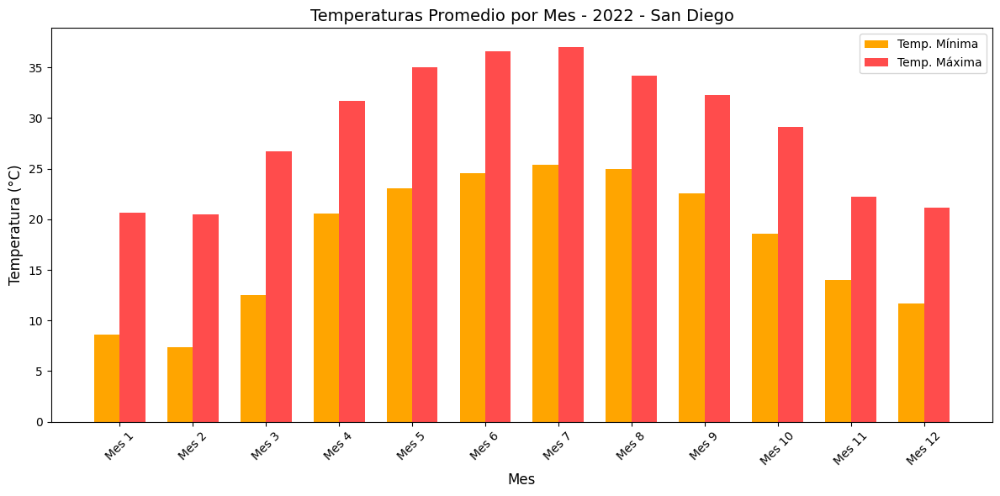


Top 3 meses más calurosos (Temp. máxima promedio más alta):
  Mes 7: 37.04 °C
  Mes 6: 36.61 °C
  Mes 5: 35.00 °C

Top 3 meses más fríos (Temp. mínima promedio más baja):
  Mes 2: 7.36 °C
  Mes 1: 8.62 °C
  Mes 12: 11.70 °C


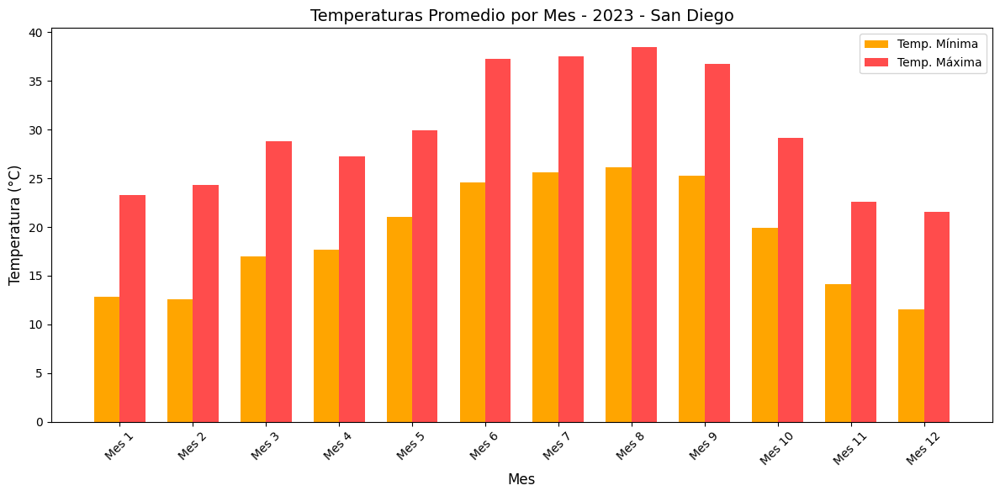


Top 3 meses más calurosos (Temp. máxima promedio más alta):
  Mes 8: 38.52 °C
  Mes 7: 37.51 °C
  Mes 6: 37.31 °C

Top 3 meses más fríos (Temp. mínima promedio más baja):
  Mes 12: 11.56 °C
  Mes 2: 12.54 °C
  Mes 1: 12.86 °C


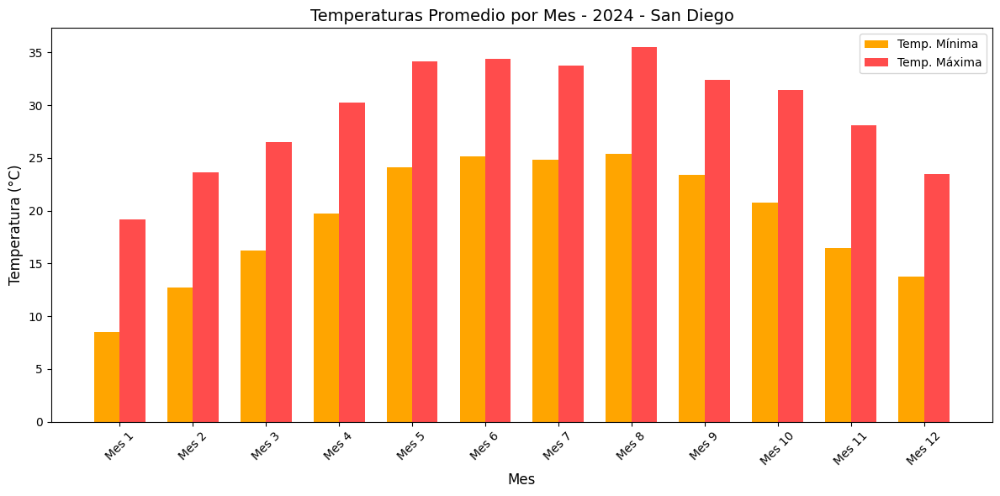


Top 3 meses más calurosos (Temp. máxima promedio más alta):
  Mes 8: 35.55 °C
  Mes 6: 34.43 °C
  Mes 5: 34.16 °C

Top 3 meses más fríos (Temp. mínima promedio más baja):
  Mes 1: 8.48 °C
  Mes 2: 12.76 °C
  Mes 12: 13.76 °C


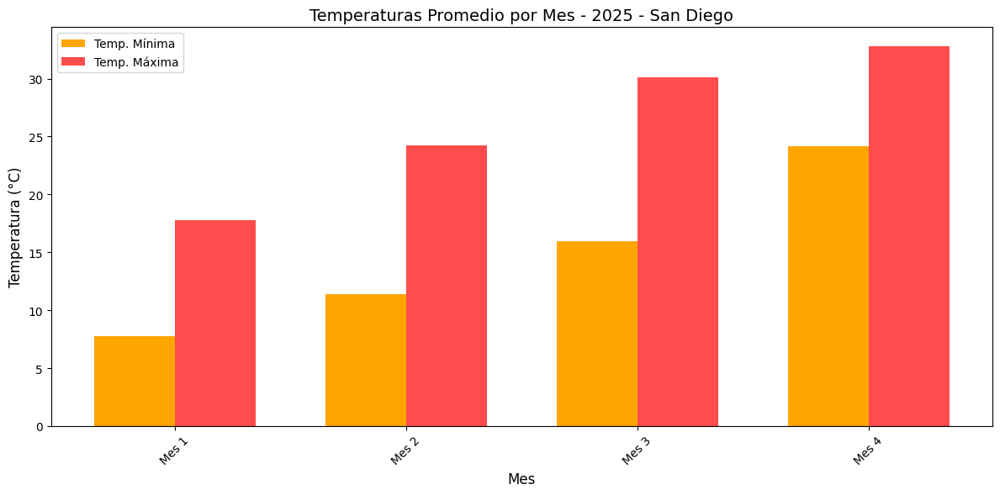


Top 3 meses más calurosos (Temp. máxima promedio más alta):
  Mes 4: 32.80 °C
  Mes 3: 30.11 °C
  Mes 2: 24.25 °C

Top 3 meses más fríos (Temp. mínima promedio más baja):
  Mes 1: 7.79 °C
  Mes 2: 11.41 °C
  Mes 3: 15.98 °C

===== Singapore =====


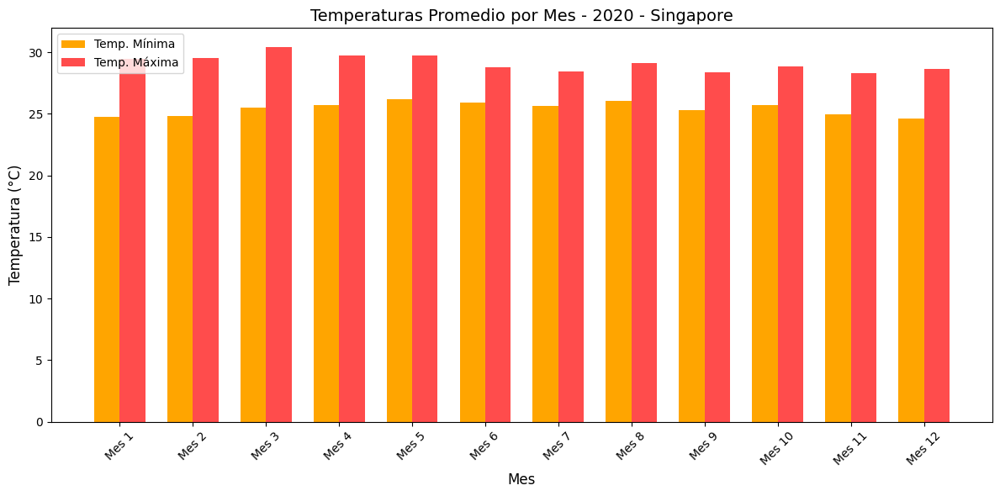


Top 3 meses más calurosos (Temp. máxima promedio más alta):
  Mes 3: 30.44 °C
  Mes 5: 29.76 °C
  Mes 4: 29.72 °C

Top 3 meses más fríos (Temp. mínima promedio más baja):
  Mes 12: 24.62 °C
  Mes 1: 24.72 °C
  Mes 2: 24.80 °C


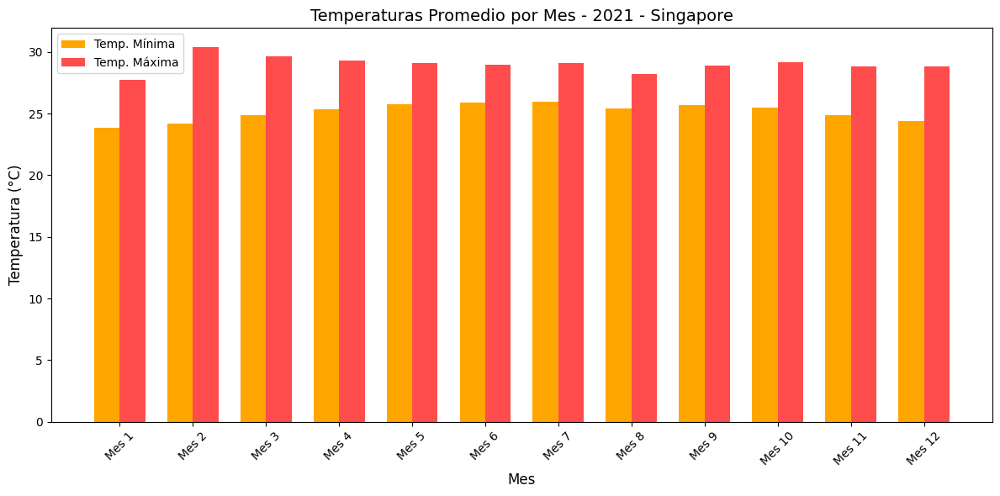


Top 3 meses más calurosos (Temp. máxima promedio más alta):
  Mes 2: 30.43 °C
  Mes 3: 29.65 °C
  Mes 4: 29.32 °C

Top 3 meses más fríos (Temp. mínima promedio más baja):
  Mes 1: 23.88 °C
  Mes 2: 24.17 °C
  Mes 12: 24.41 °C


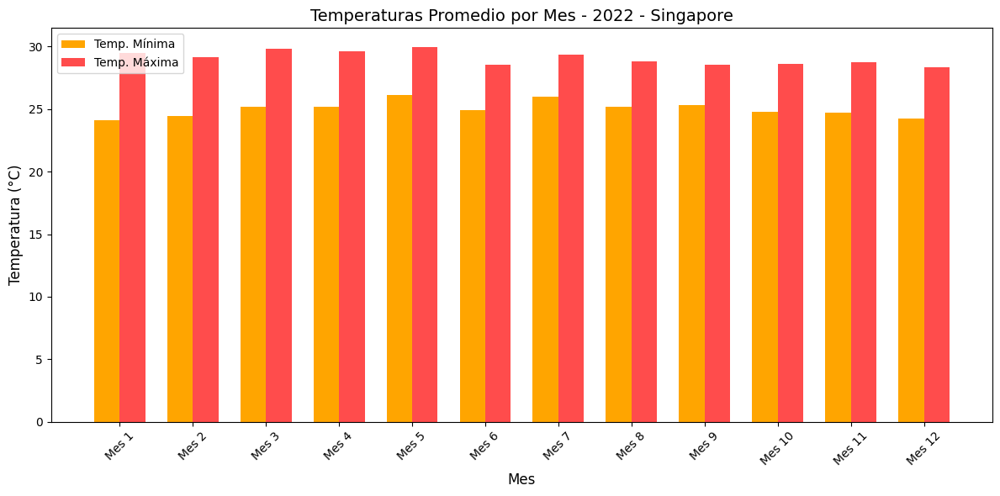


Top 3 meses más calurosos (Temp. máxima promedio más alta):
  Mes 5: 29.99 °C
  Mes 3: 29.83 °C
  Mes 4: 29.62 °C

Top 3 meses más fríos (Temp. mínima promedio más baja):
  Mes 1: 24.12 °C
  Mes 12: 24.23 °C
  Mes 2: 24.44 °C


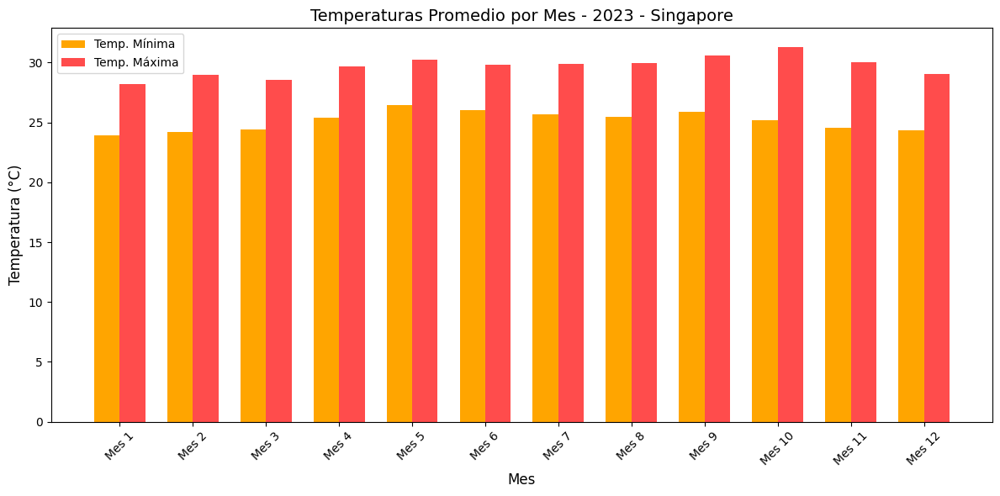


Top 3 meses más calurosos (Temp. máxima promedio más alta):
  Mes 10: 31.32 °C
  Mes 9: 30.60 °C
  Mes 5: 30.24 °C

Top 3 meses más fríos (Temp. mínima promedio más baja):
  Mes 1: 23.89 °C
  Mes 2: 24.17 °C
  Mes 12: 24.35 °C


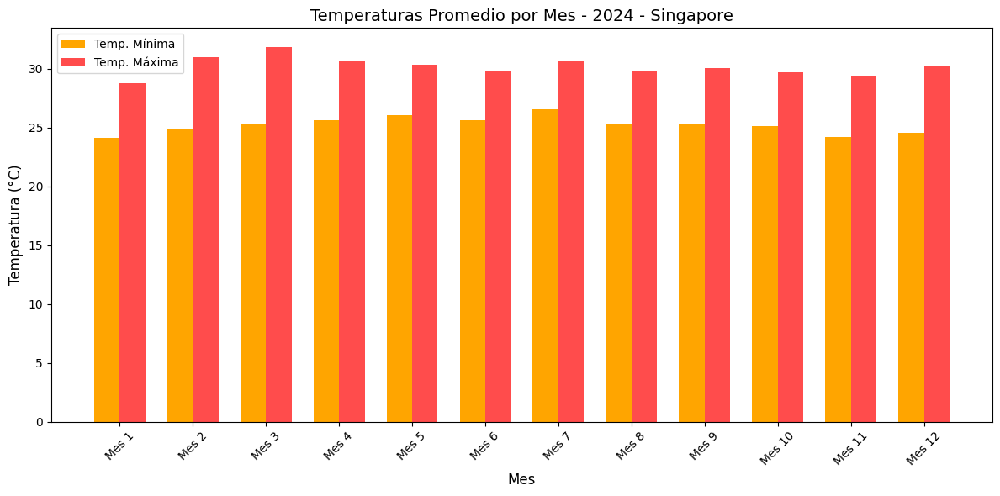


Top 3 meses más calurosos (Temp. máxima promedio más alta):
  Mes 3: 31.87 °C
  Mes 2: 30.95 °C
  Mes 4: 30.71 °C

Top 3 meses más fríos (Temp. mínima promedio más baja):
  Mes 1: 24.11 °C
  Mes 11: 24.21 °C
  Mes 12: 24.52 °C


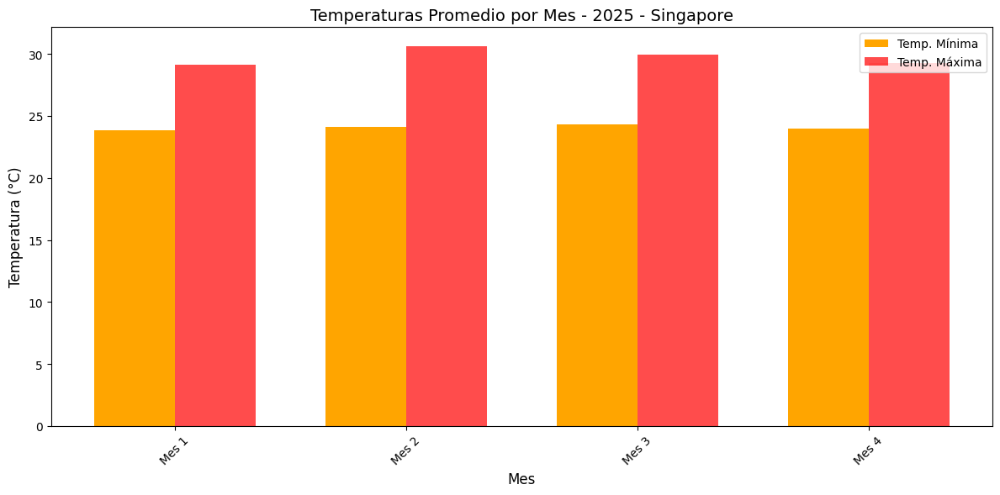


Top 3 meses más calurosos (Temp. máxima promedio más alta):
  Mes 2: 30.63 °C
  Mes 3: 29.92 °C
  Mes 4: 29.30 °C

Top 3 meses más fríos (Temp. mínima promedio más baja):
  Mes 1: 23.85 °C
  Mes 4: 24.00 °C
  Mes 2: 24.14 °C


In [90]:
for city in ciudades:
    print(f"\n===== {city} =====")

    # Filtrar datos para la ciudad
    df_ciudad = df_filtrado[df_filtrado['city_name'] == city]

    for año in df_ciudad['año'].unique():
        df_año = df_ciudad[df_ciudad['año'] == año]

        # Agrupar por mes y calcular promedios
        promedio_min = df_año.groupby('mes')['temperature_2m_min'].mean()
        promedio_max = df_año.groupby('mes')['temperature_2m_max'].mean()

        # Crear gráfico de barras combinado
        x = promedio_min.index
        width = 0.35  # ancho de las barras

        plt.figure(figsize=(12, 6))
        plt.bar(x - 0.175, promedio_min.values, width=width, color='orange', label='Temp. Mínima')
        plt.bar(x + 0.175, promedio_max.values, width=width, color='red', alpha=0.7, label='Temp. Máxima')

        plt.title(f'Temperaturas Promedio por Mes - {año} - {city}', fontsize=14)
        plt.xlabel('Mes', fontsize=12)
        plt.ylabel('Temperatura (°C)', fontsize=12)
        plt.legend()
        plt.xticks(ticks=x, labels=[f'Mes {m}' for m in x], rotation=45)
        plt.tight_layout()
        plt.show()

        # Detectar los 3 meses más cálidos y más fríos
        meses_maximos = promedio_max.sort_values(ascending=False).head(3)
        meses_minimos = promedio_min.sort_values(ascending=True).head(3)

        print(f"\nTop 3 meses más calurosos (Temp. máxima promedio más alta):")
        for mes, temp in meses_maximos.items():
            print(f"  Mes {mes}: {temp:.2f} °C")

        print(f"\nTop 3 meses más fríos (Temp. mínima promedio más baja):")
        for mes, temp in meses_minimos.items():
            print(f"  Mes {mes}: {temp:.2f} °C")


##¿Qué meses tienen más días con temperaturas agradables (entre 20 y 30 grados) en las ciudades más calurosas?

Un equipo internacional de investigadores de diversas universidades entre las que se encuentran el Instituto Tecnológico de Massachusetts (MIT por sus siglas en inglés); la Universidad de San Diego, en California; o la Universidad de de British Columbia, en Canadá, se ha atrevido a determinar cuál es la temperatura ideal, aquella con la que nos sentimos más felices. El equipo pudo comprobar que hay más expresiones positivas durante el día si los termómetros no bajan de los 20 grados centígrados pero tampoco suben de los 30. Cuanto más se alejan de estas franjas, las palabras son más negativas, sostienen. Una medida perfecta, señalan, serían los 25 grados.

###Periodos calidos


===== Abu Dhabi =====


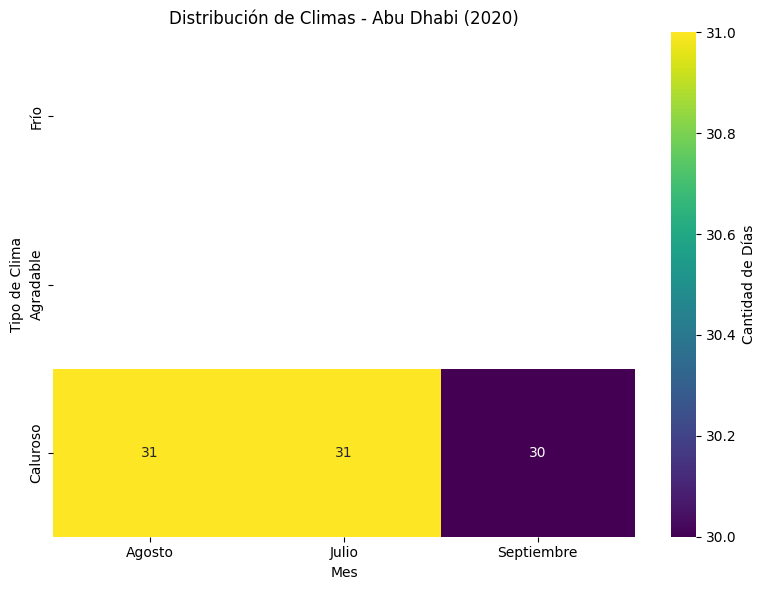

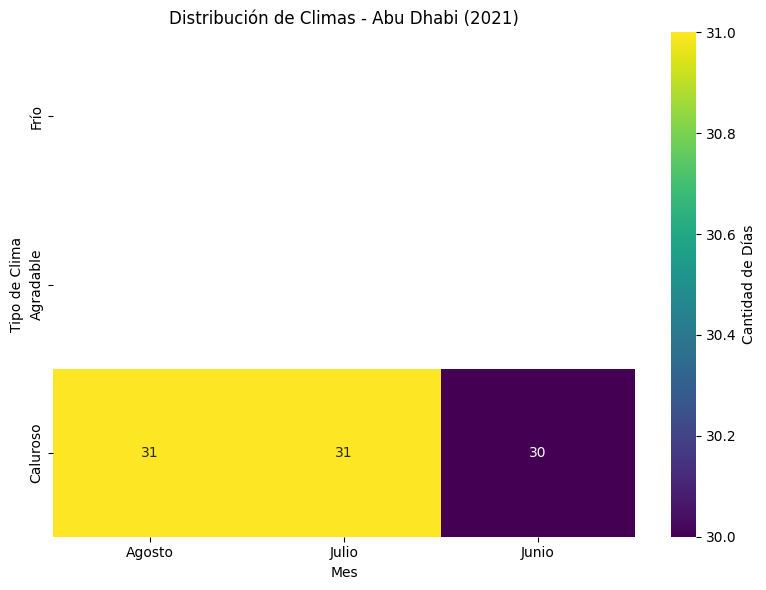

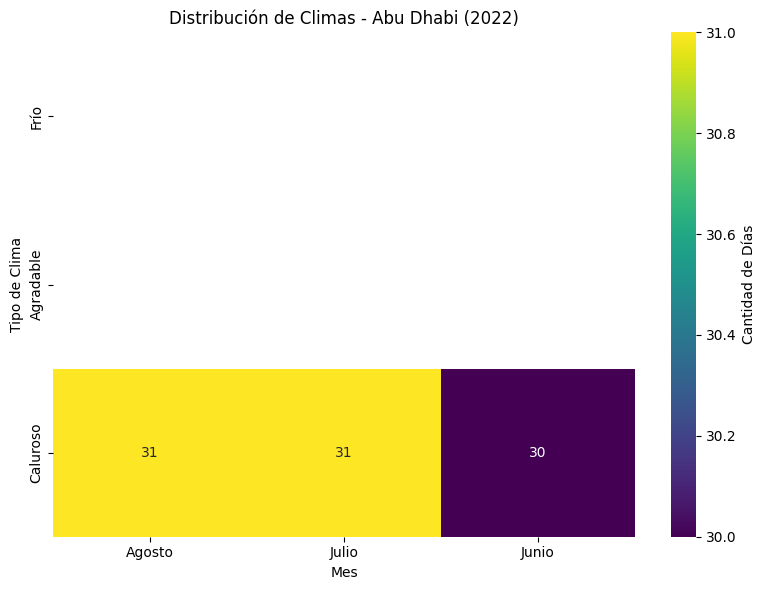

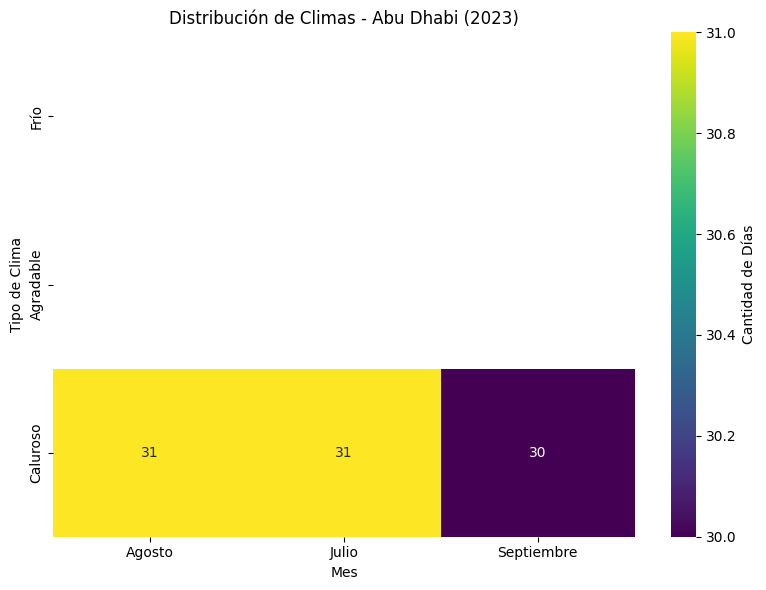

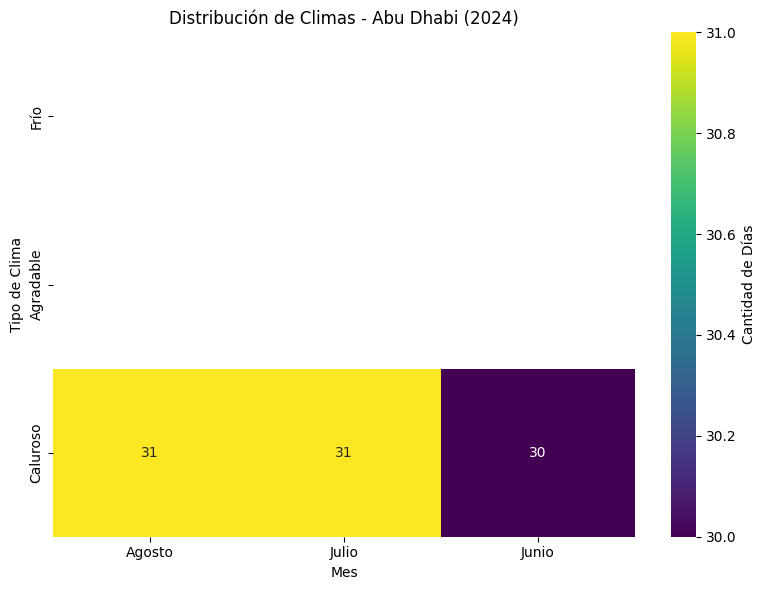

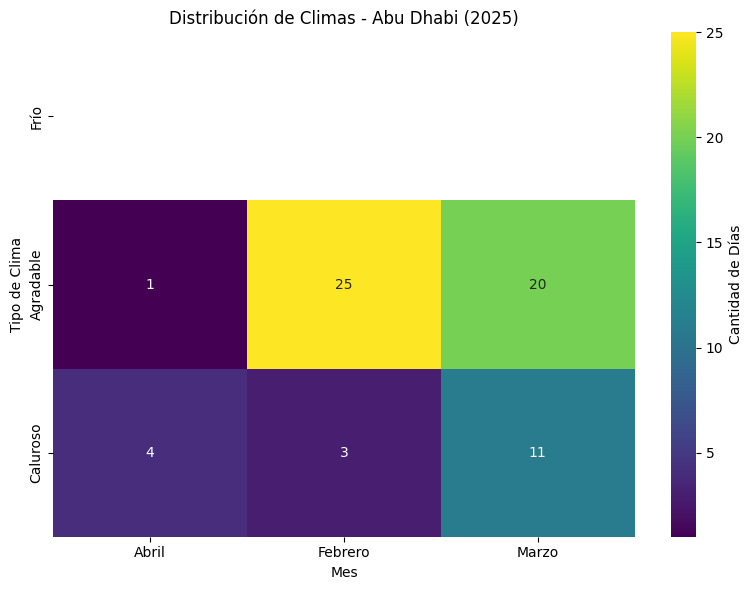


===== Bangkok =====


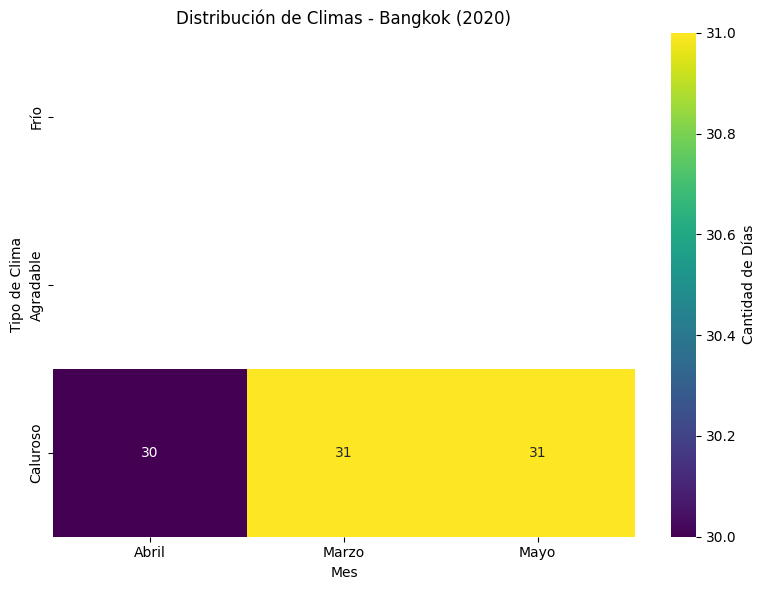

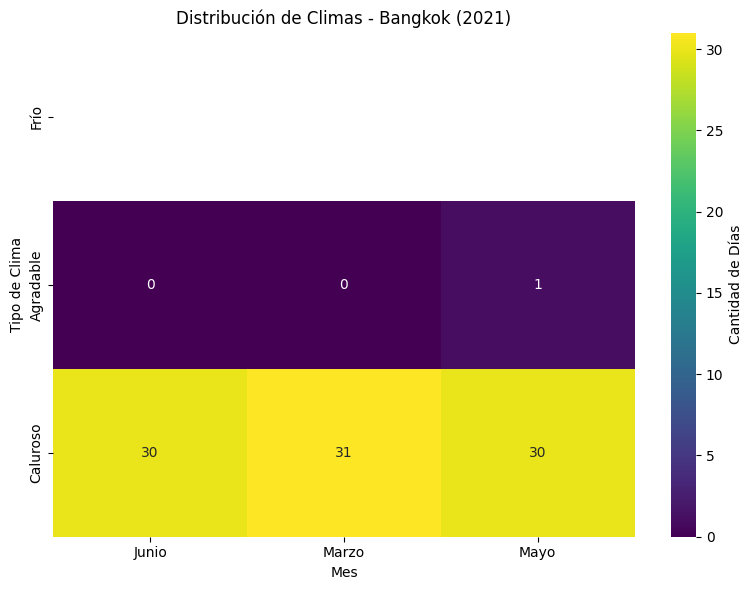

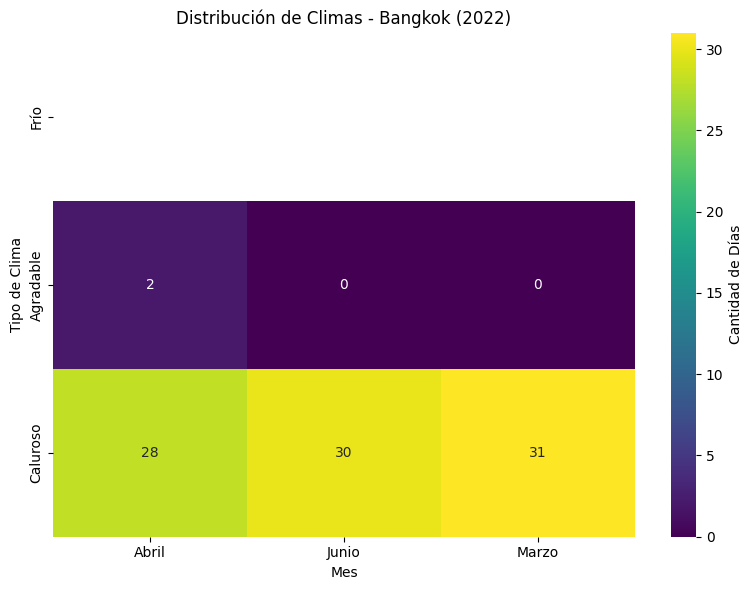

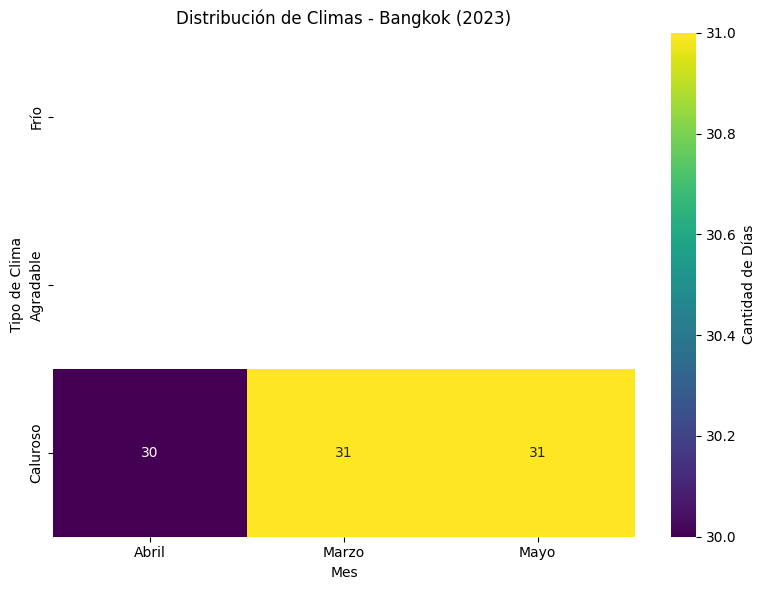

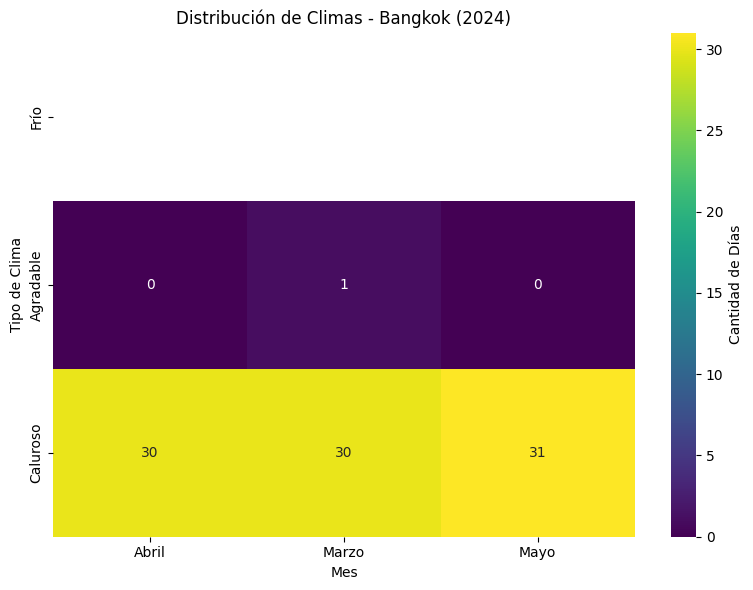

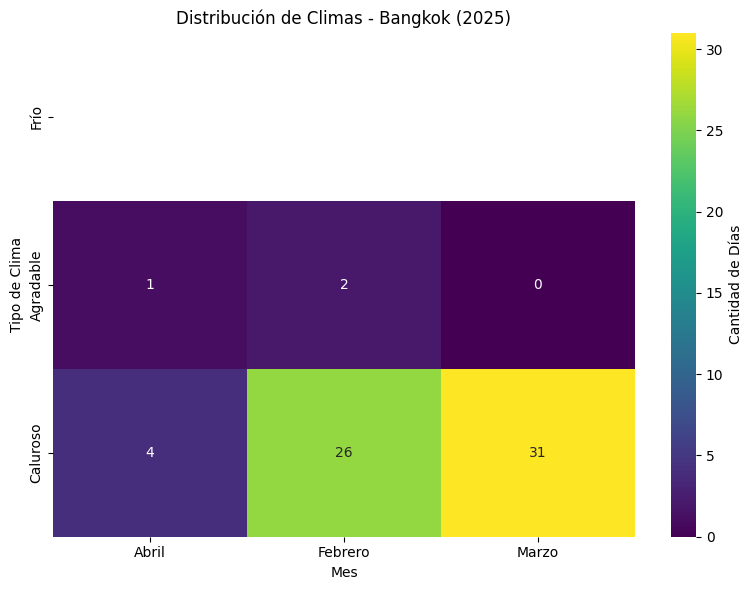


===== Doha =====


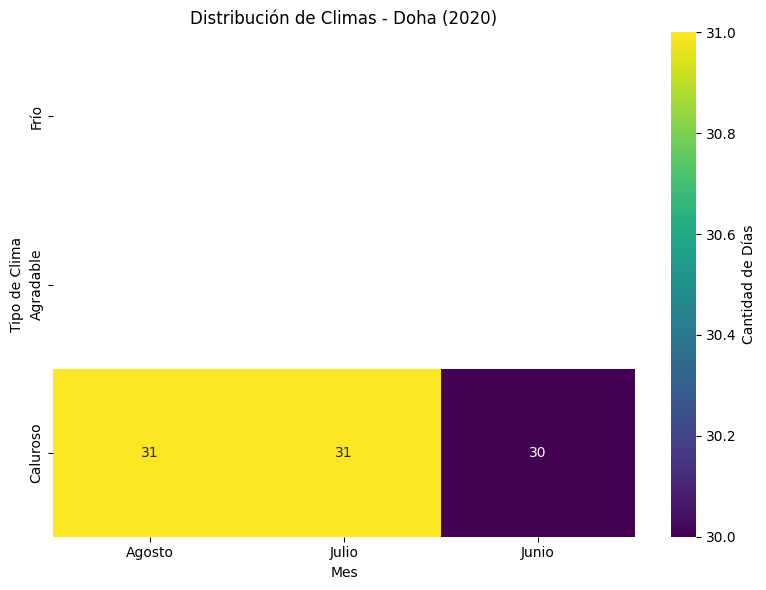

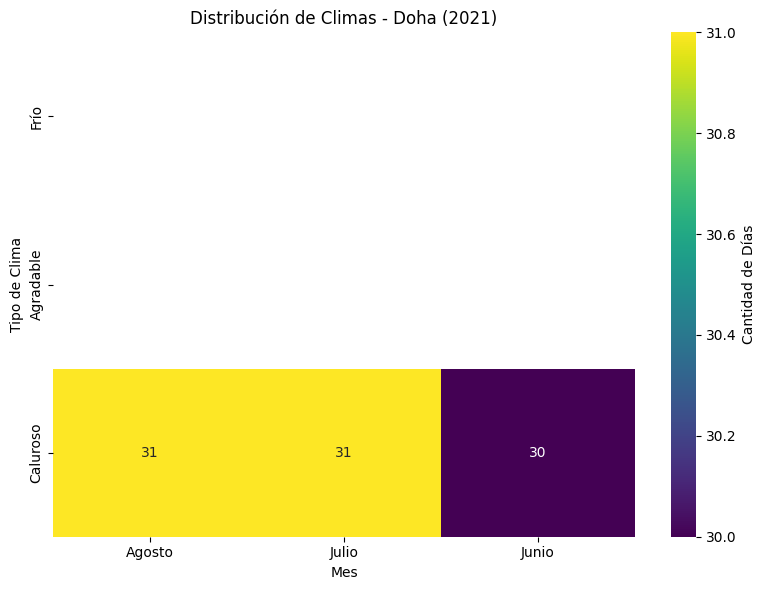

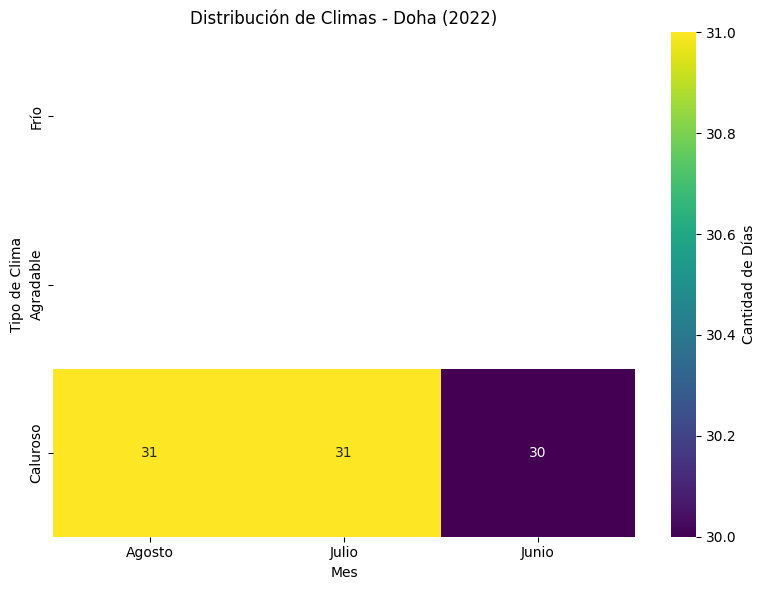

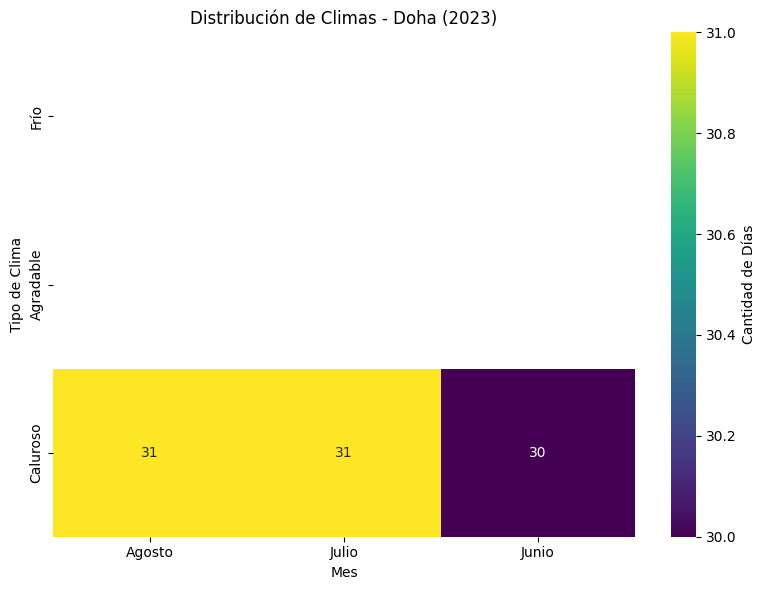

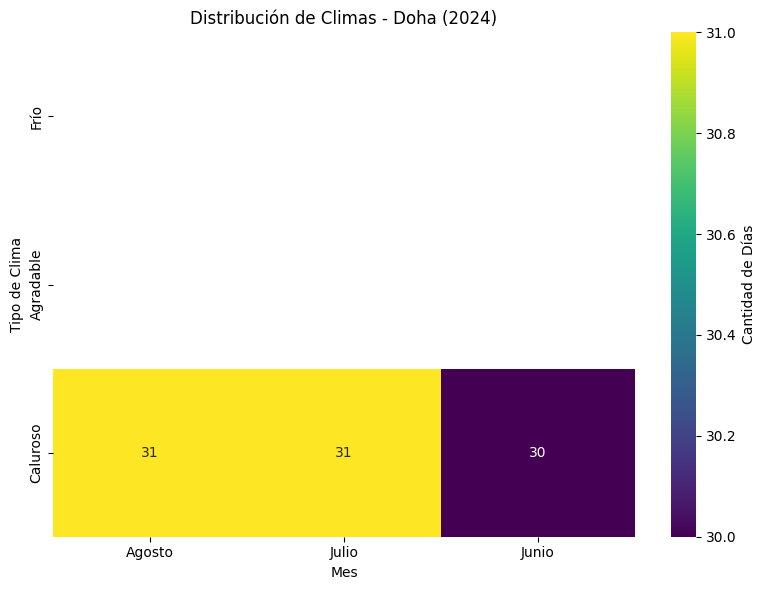

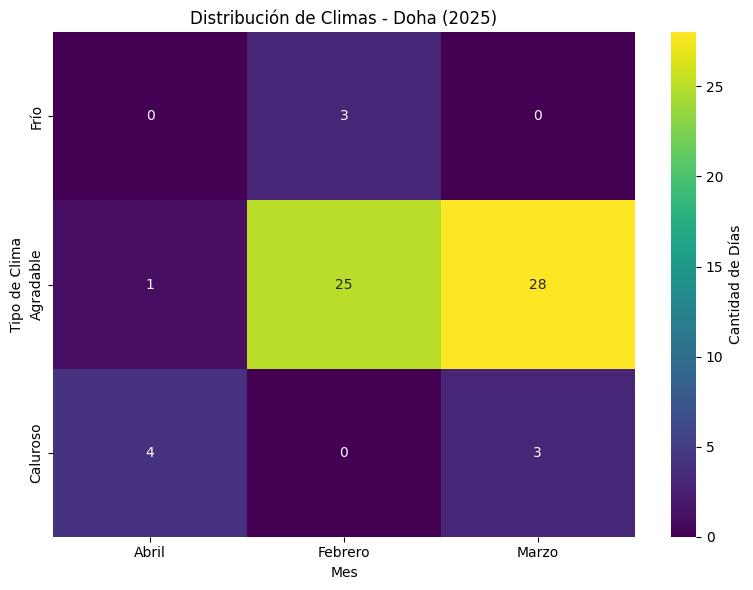


===== Dubai =====


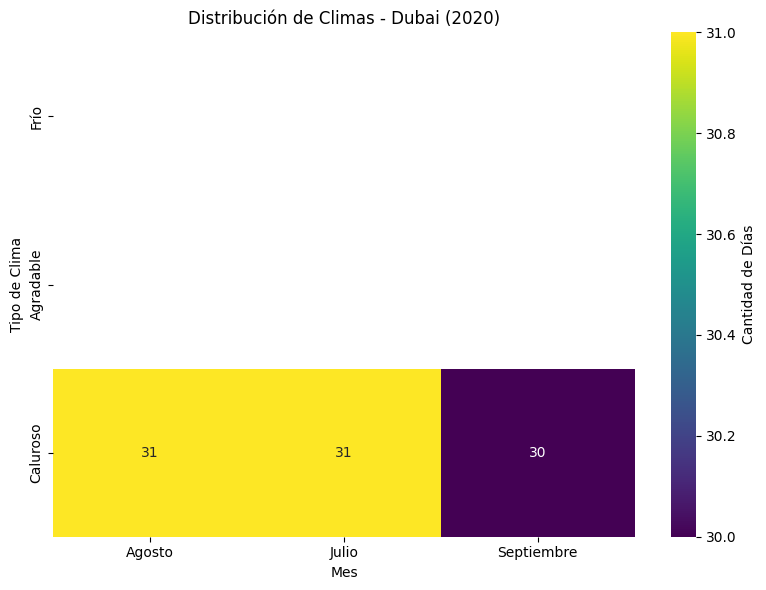

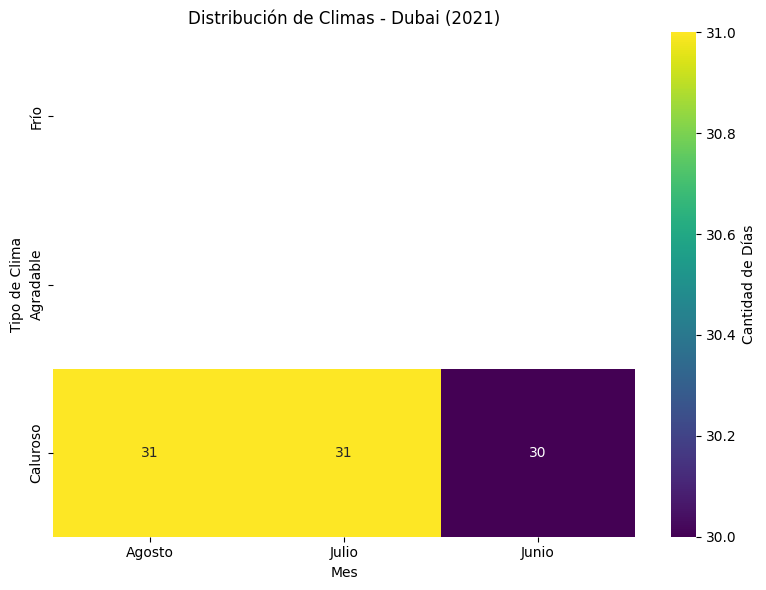

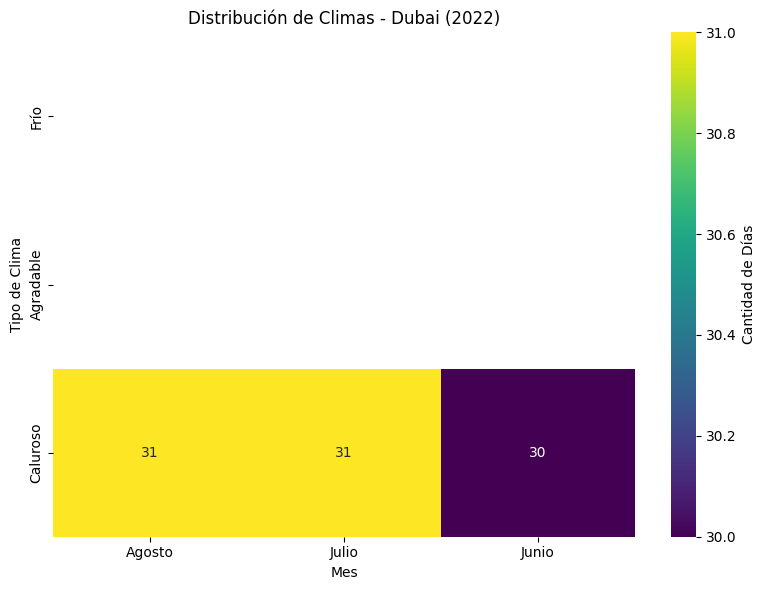

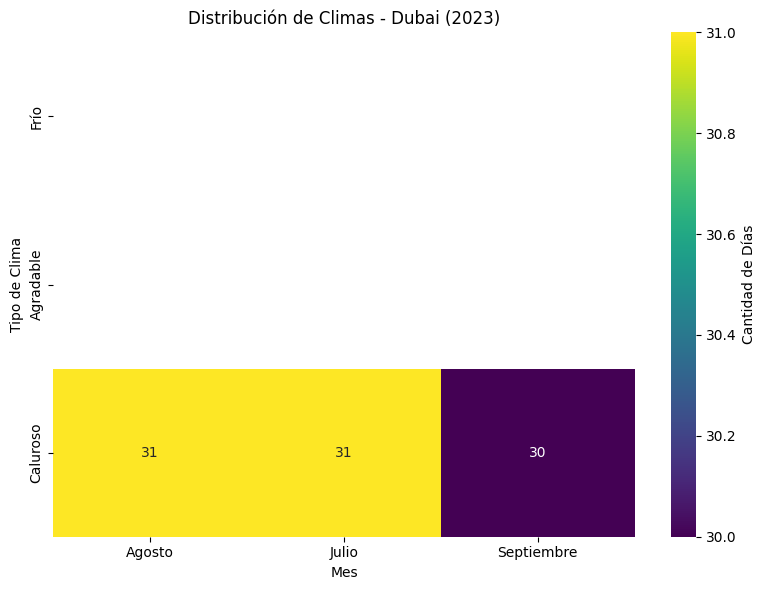

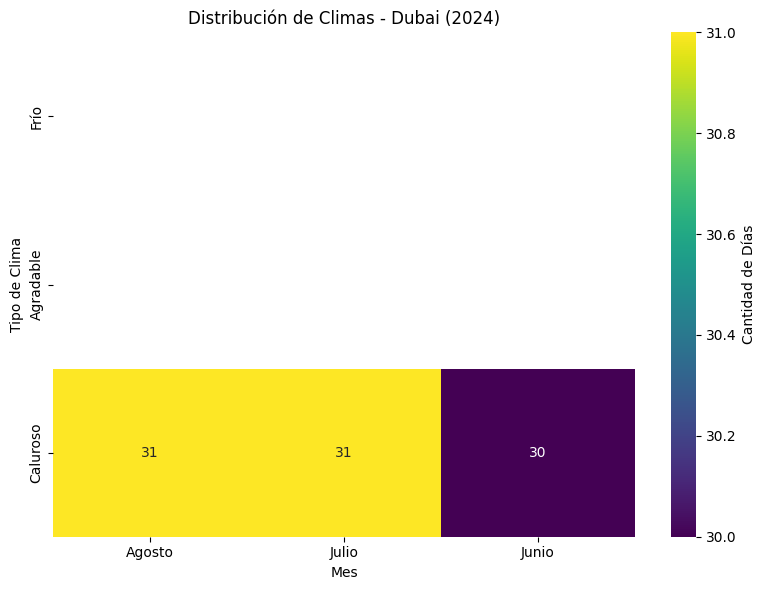

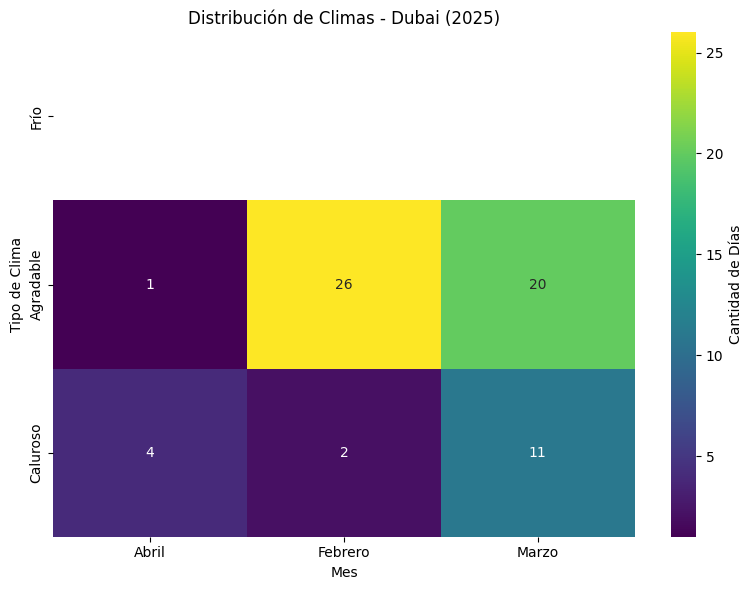


===== Kuwait City =====


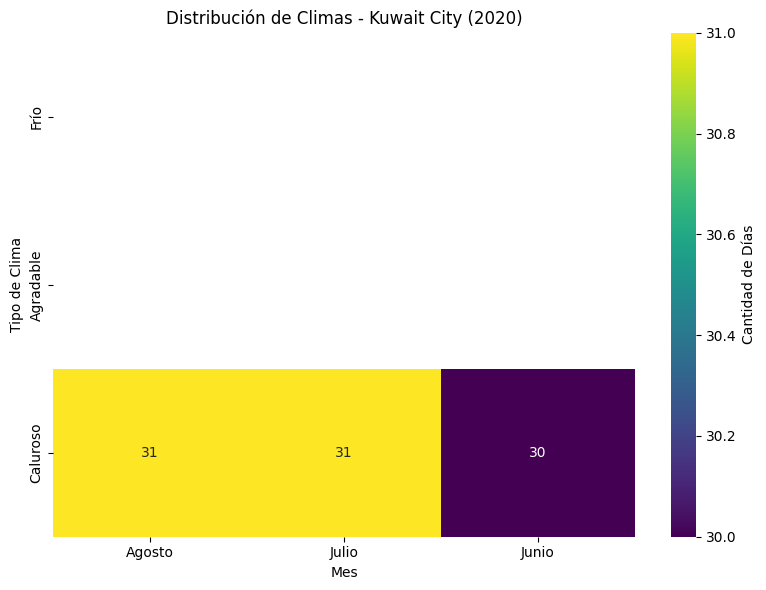

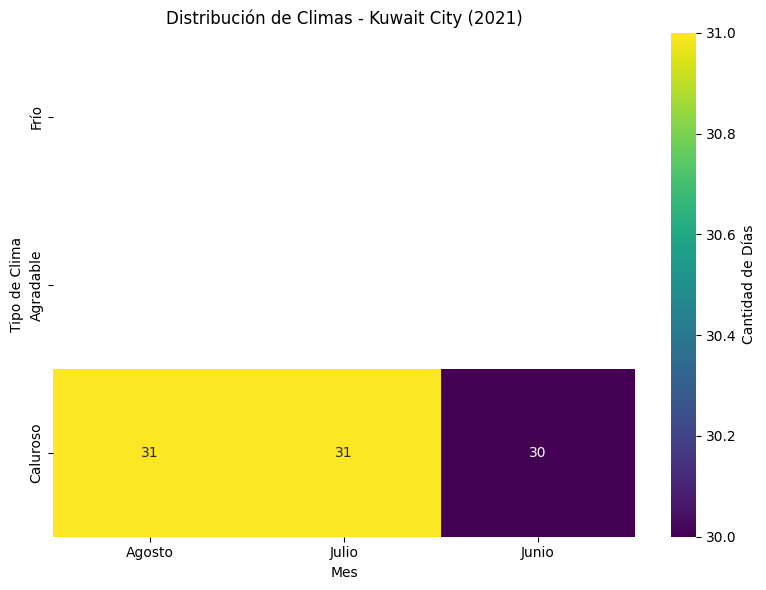

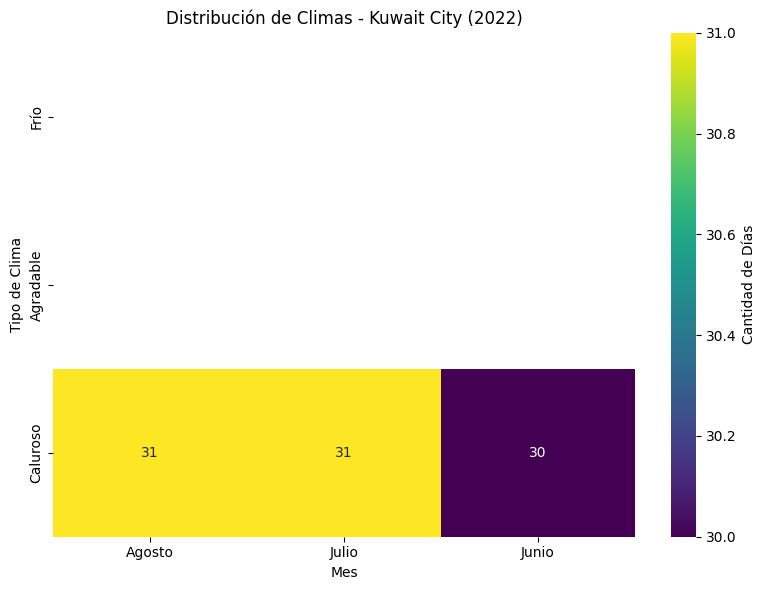

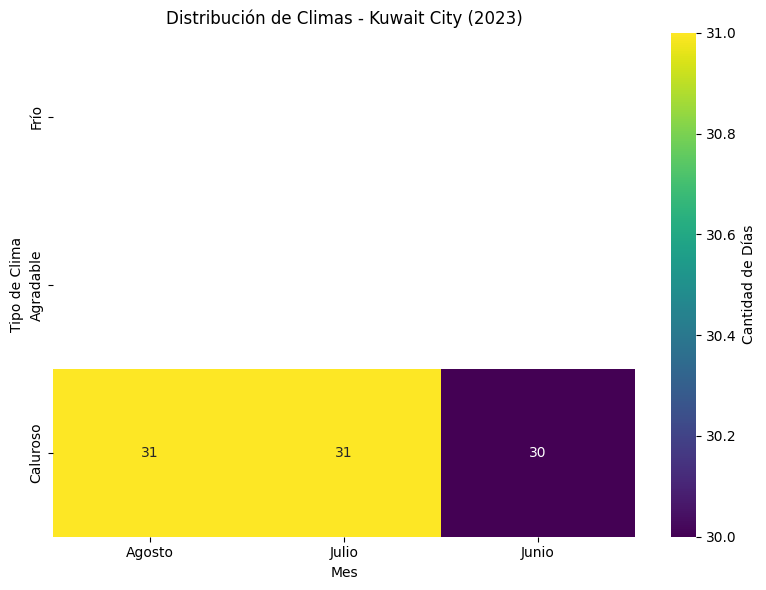

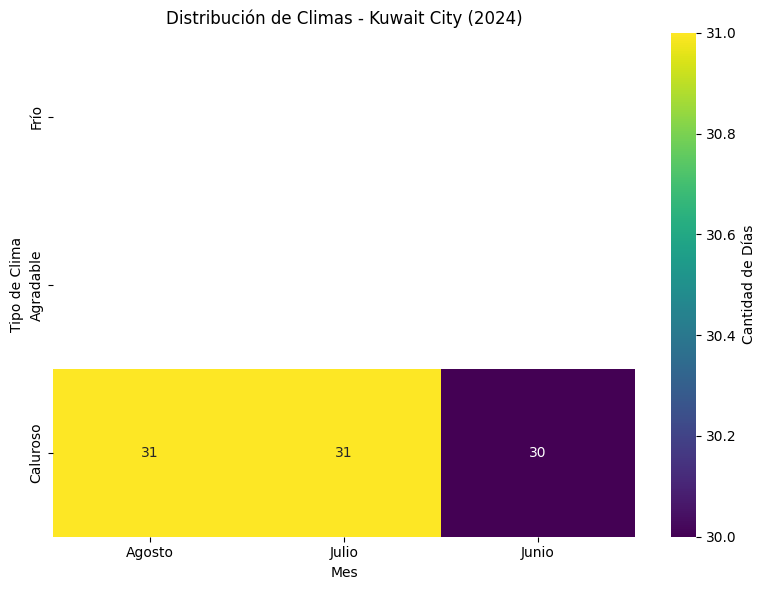

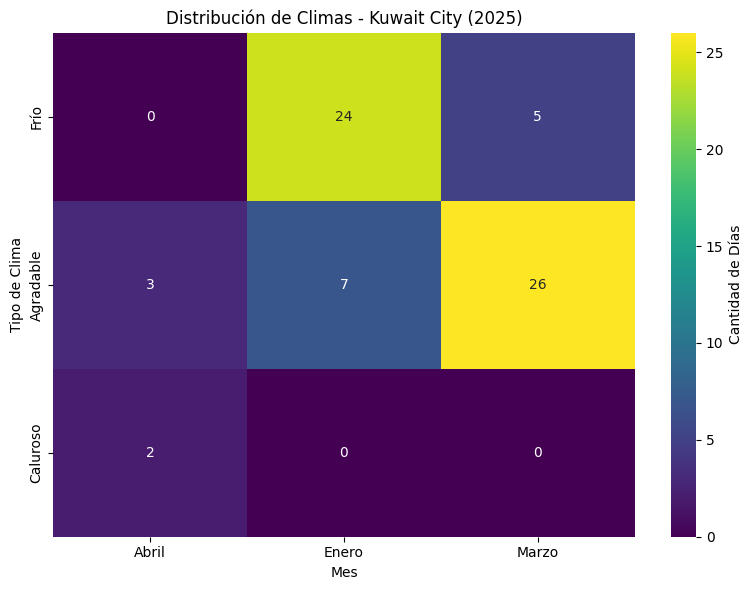


===== Muscat =====


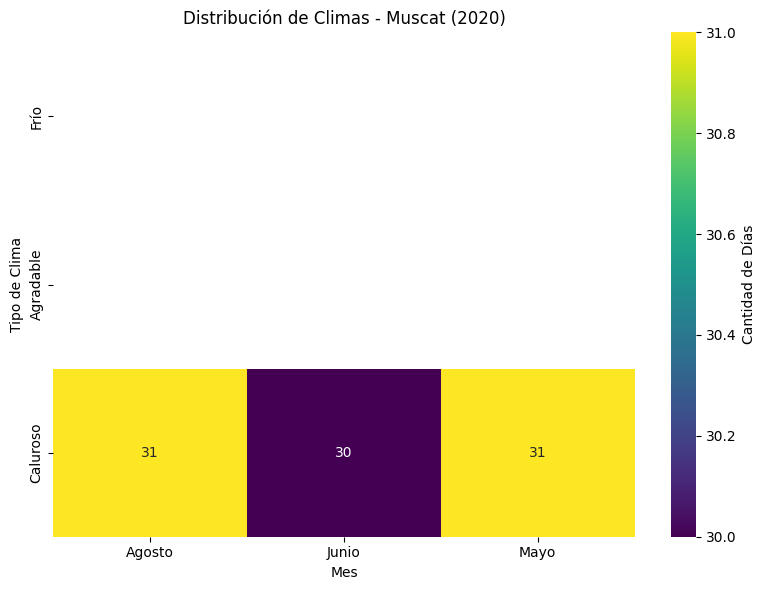

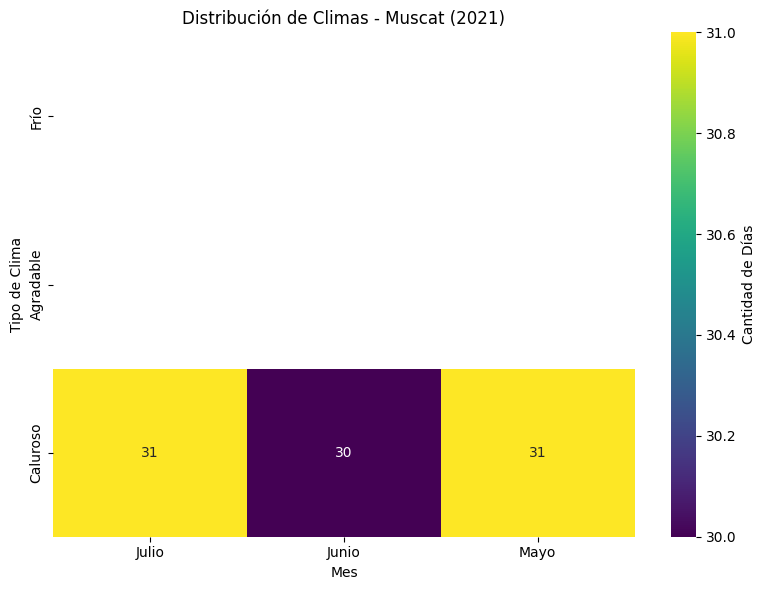

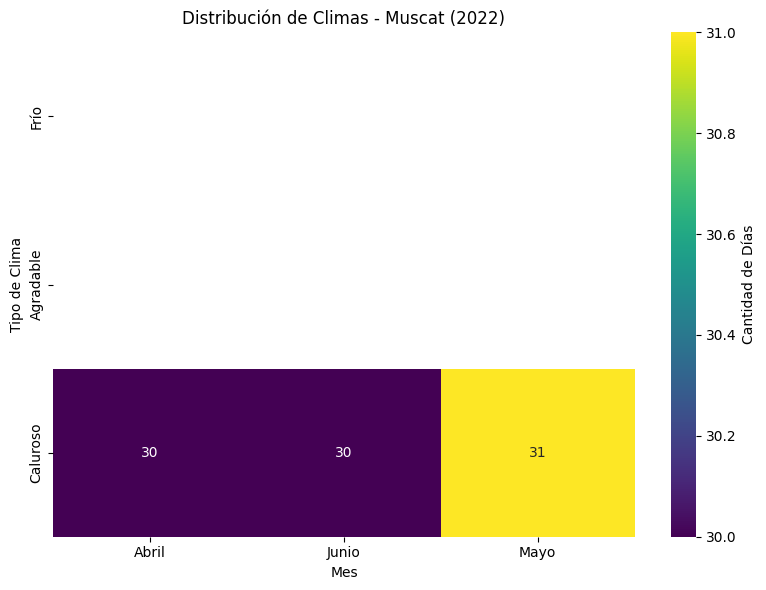

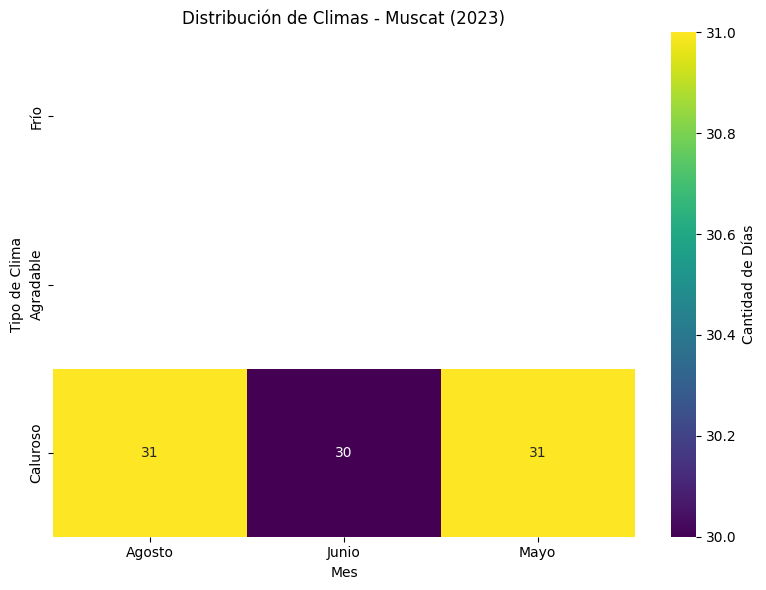

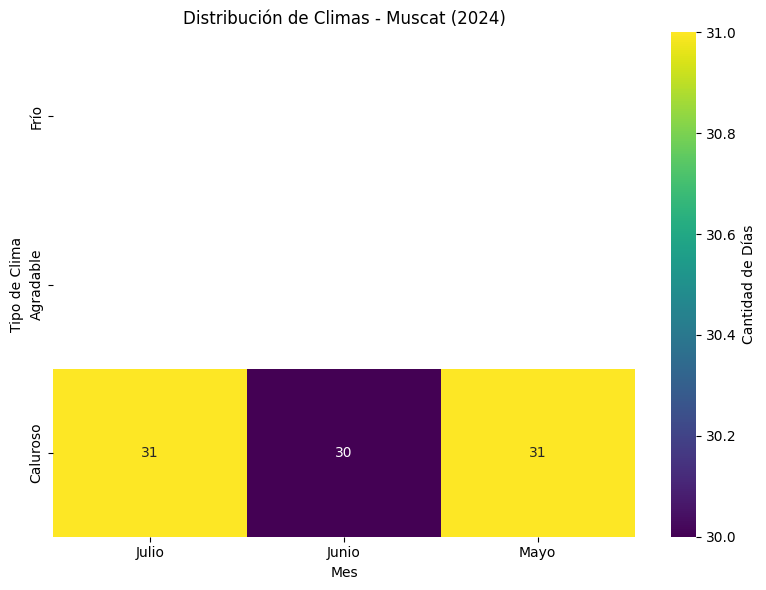

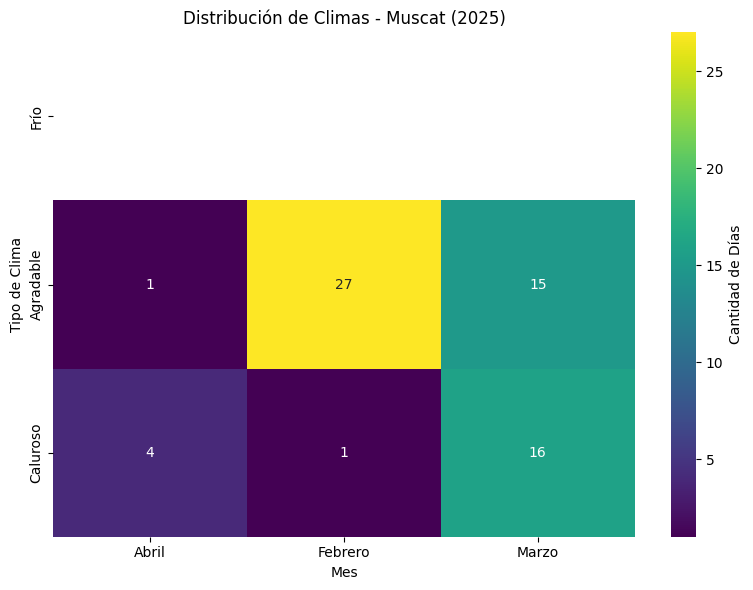


===== Rio de Janeiro =====


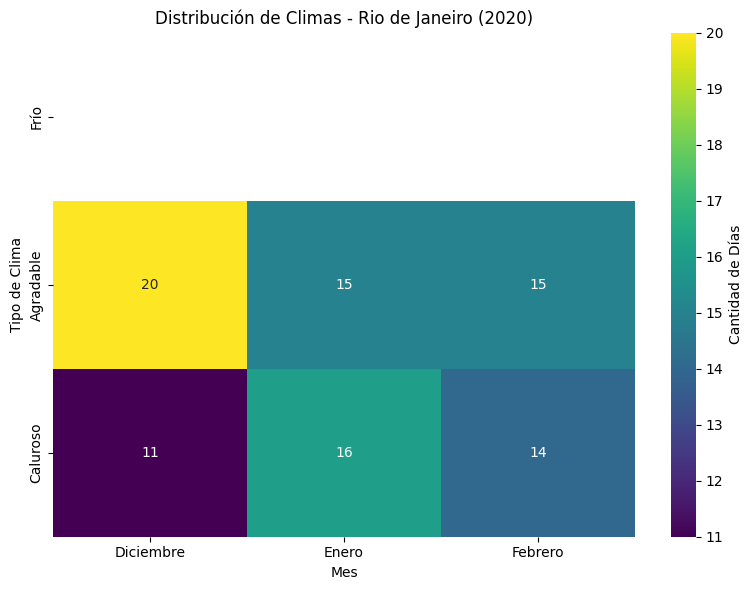

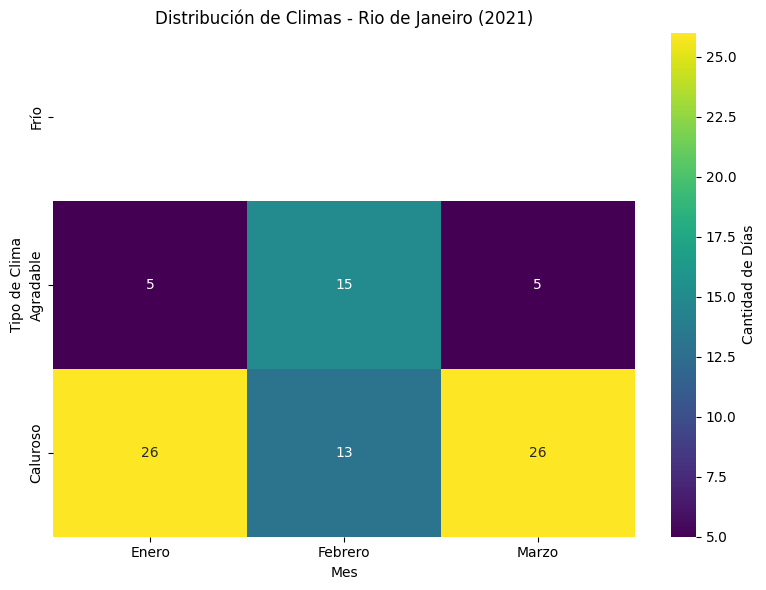

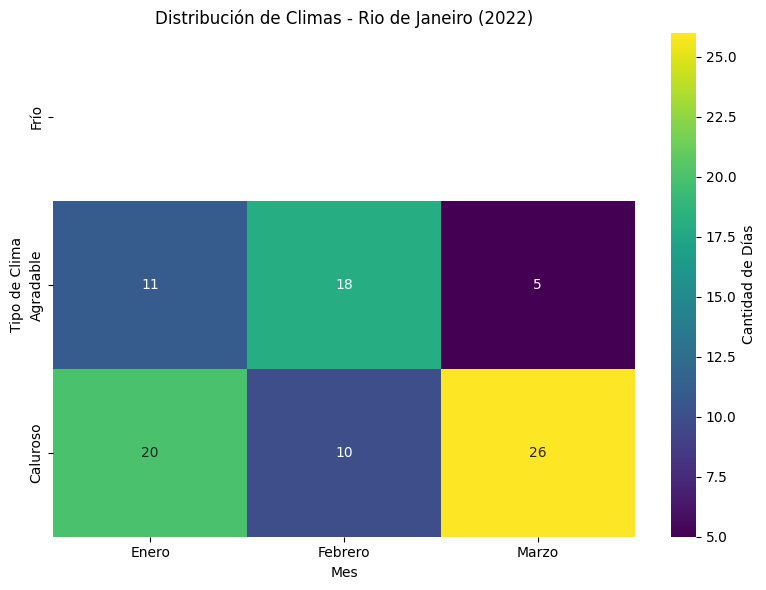

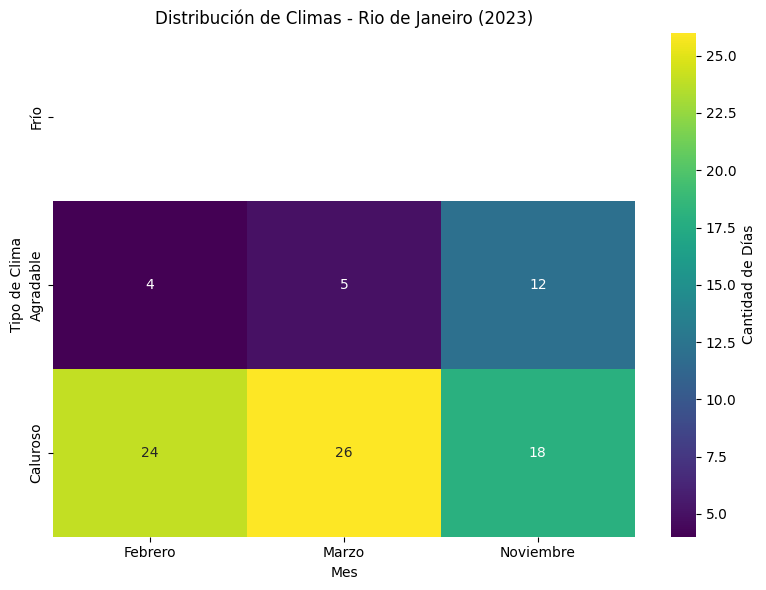

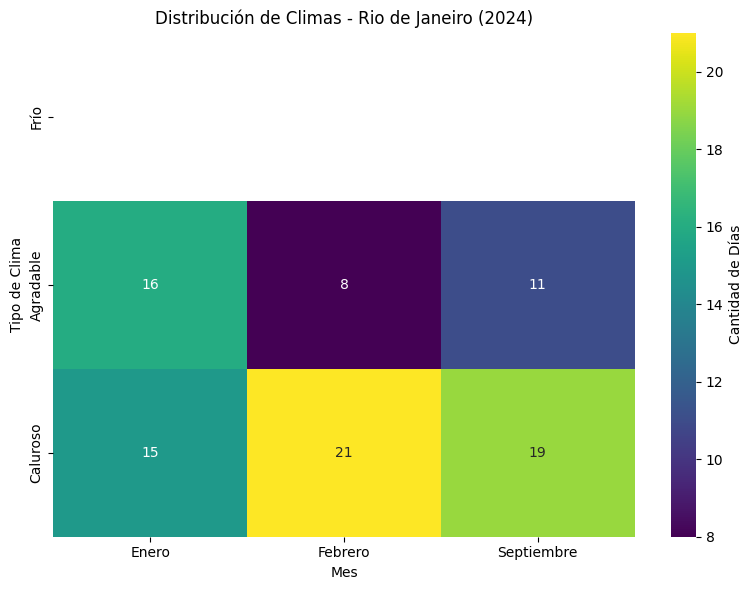

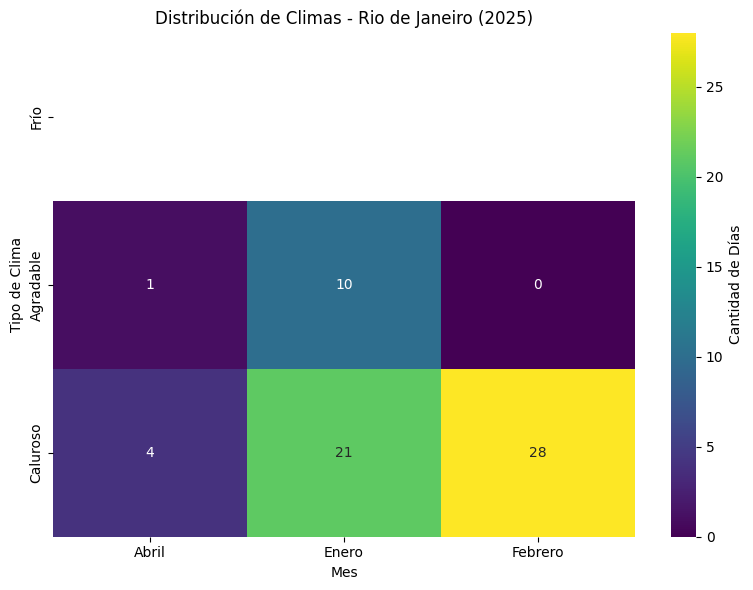


===== Riyadh =====


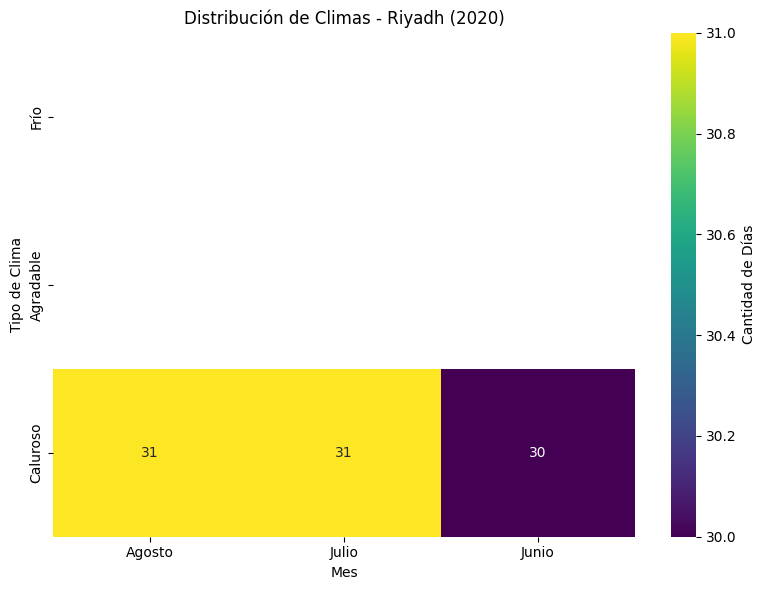

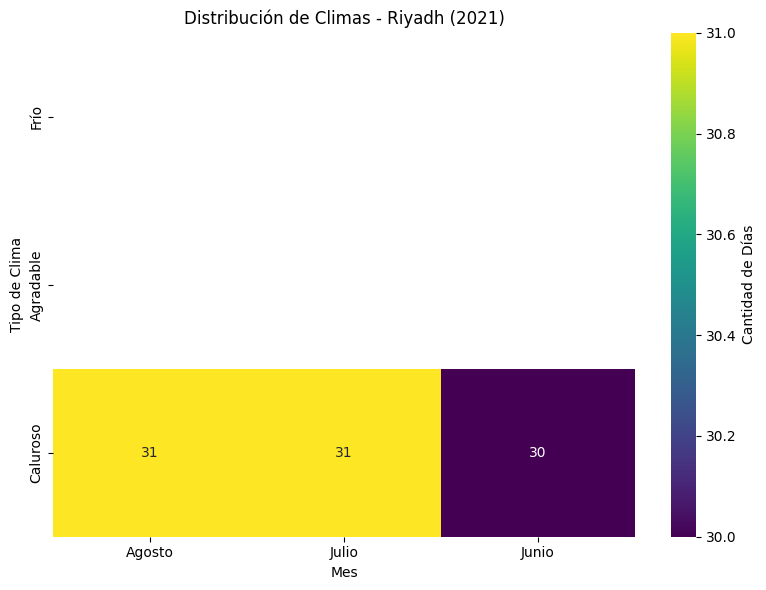

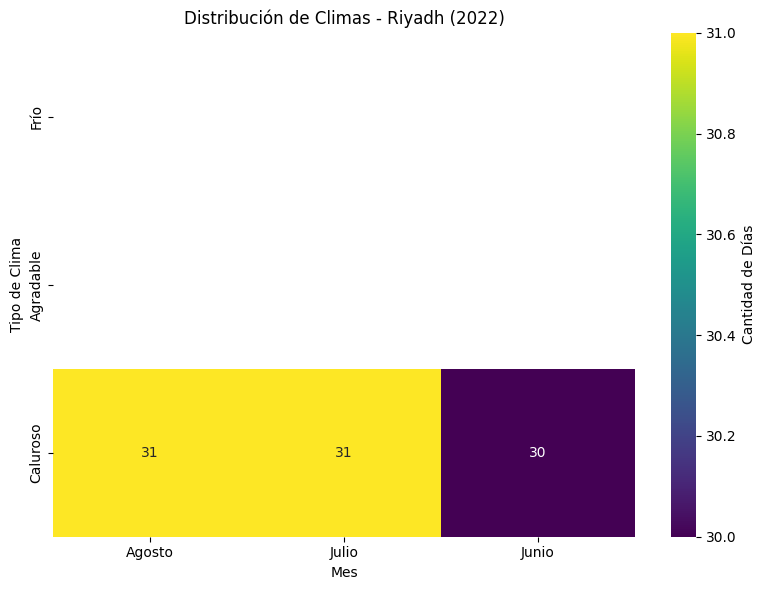

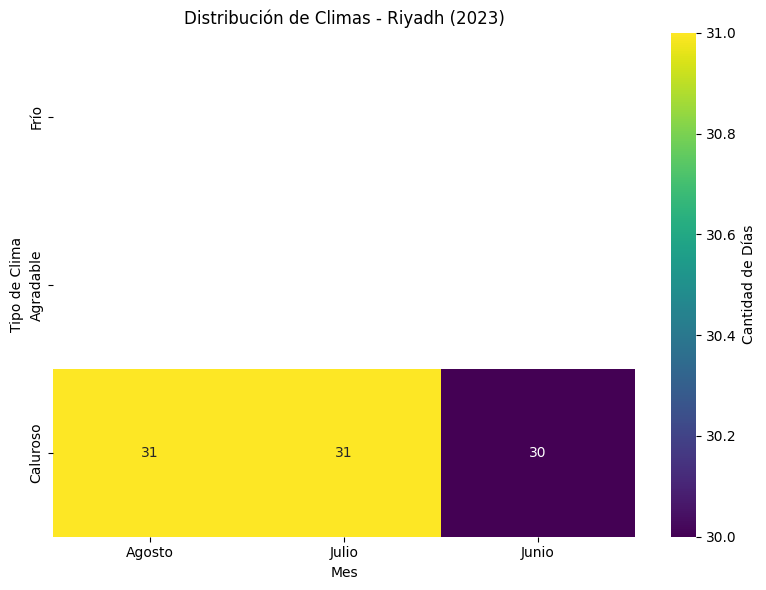

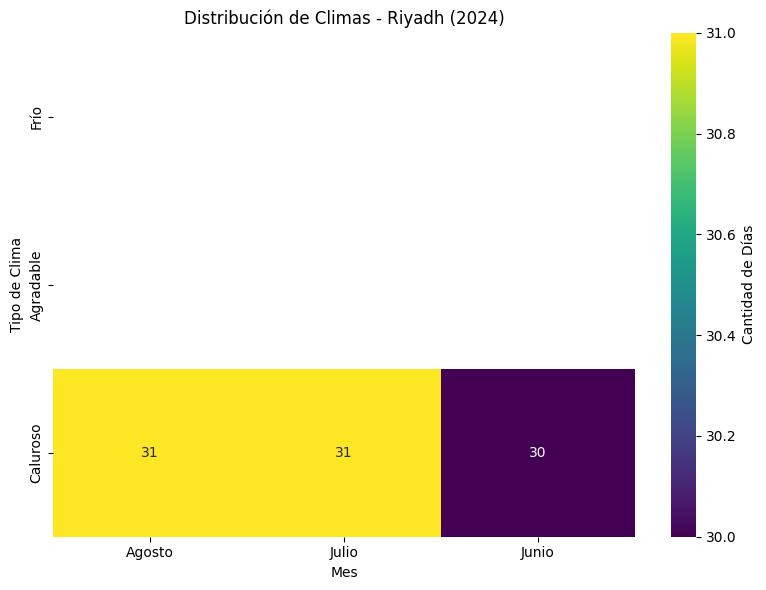

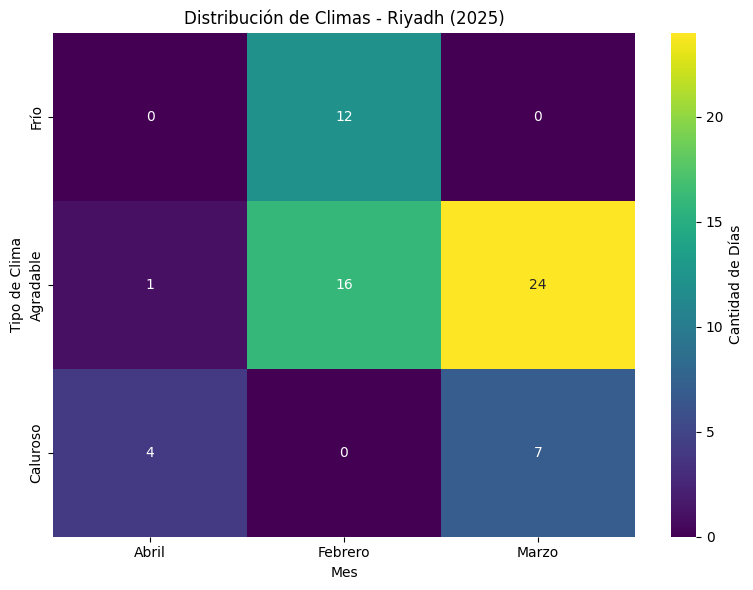


===== San Diego =====


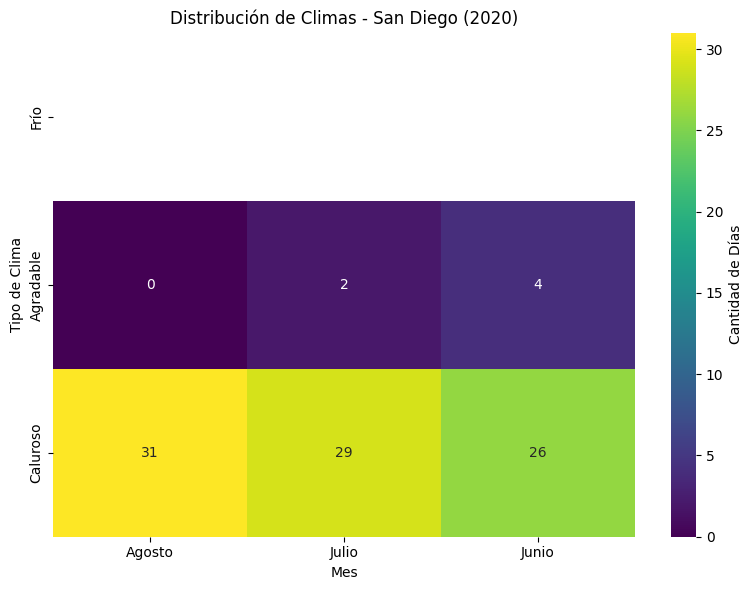

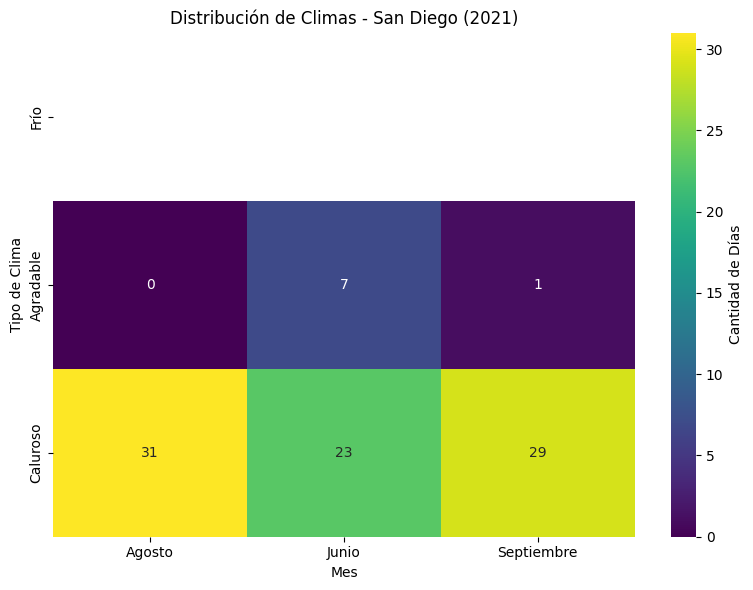

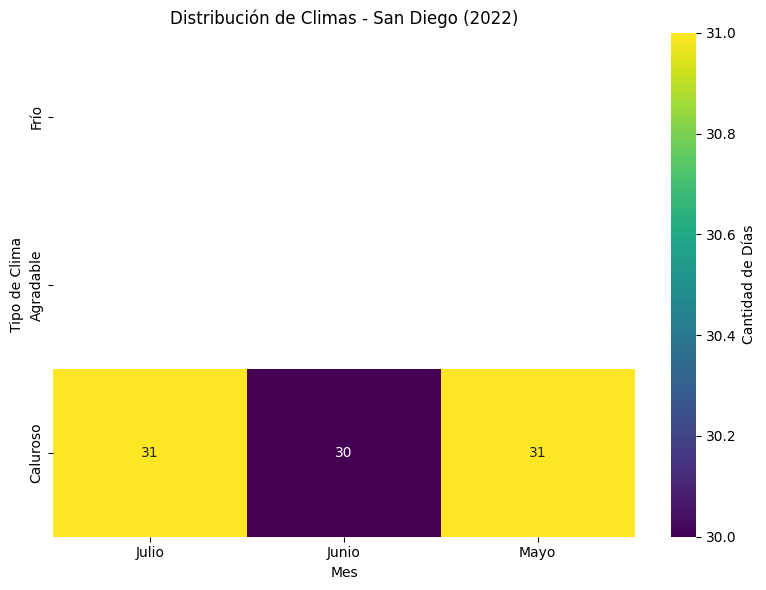

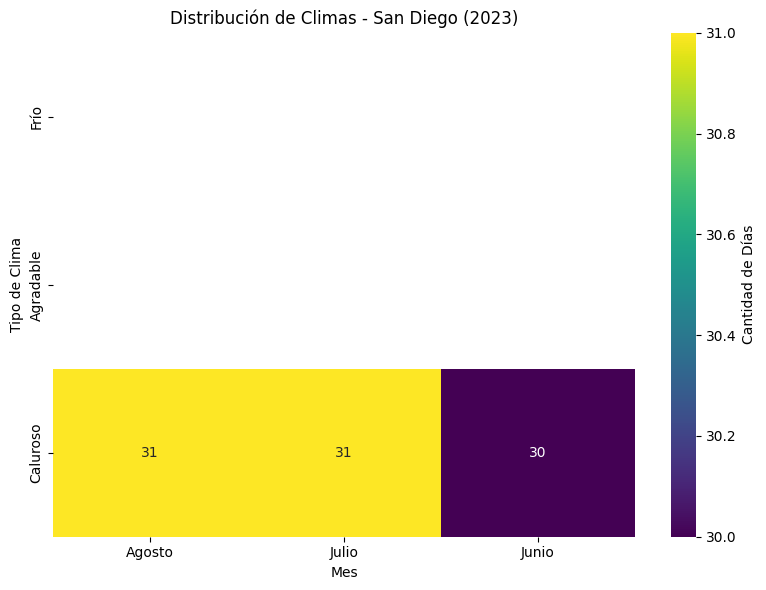

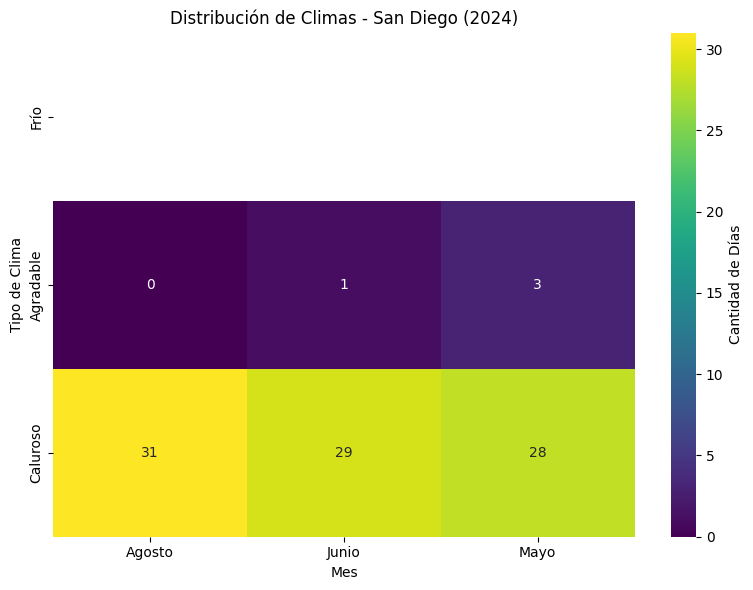

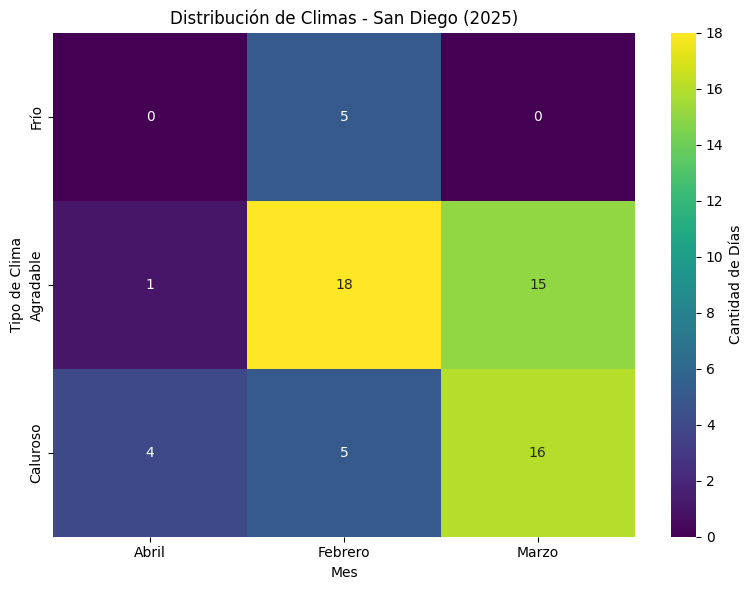


===== Singapore =====


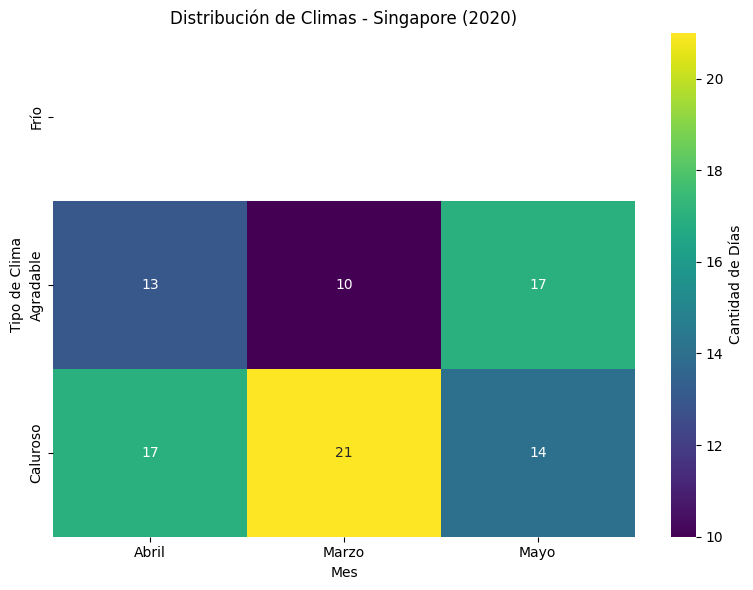

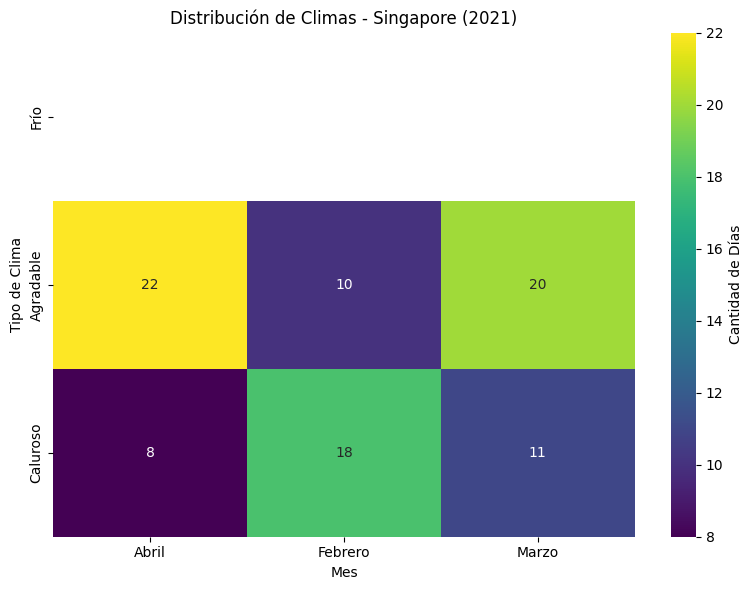

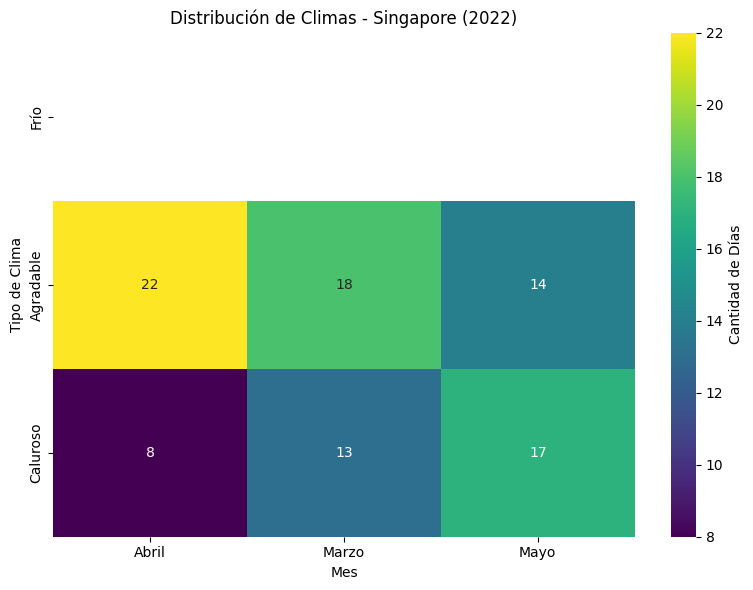

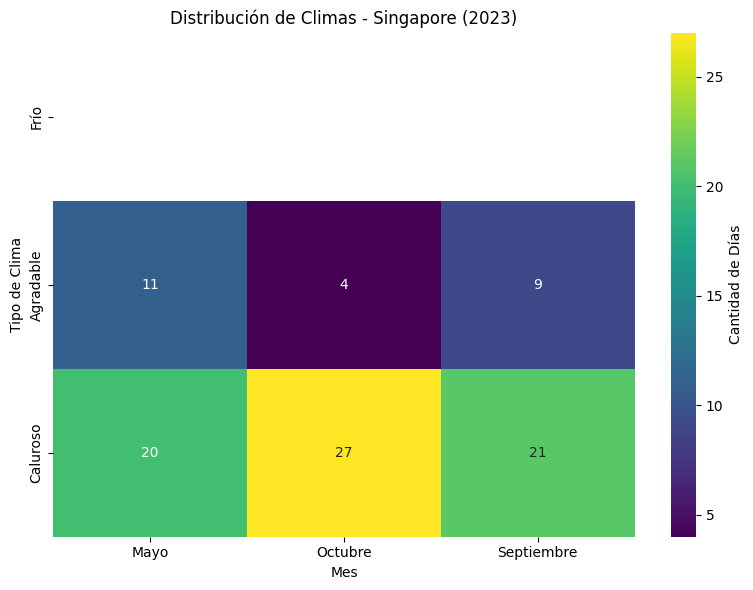

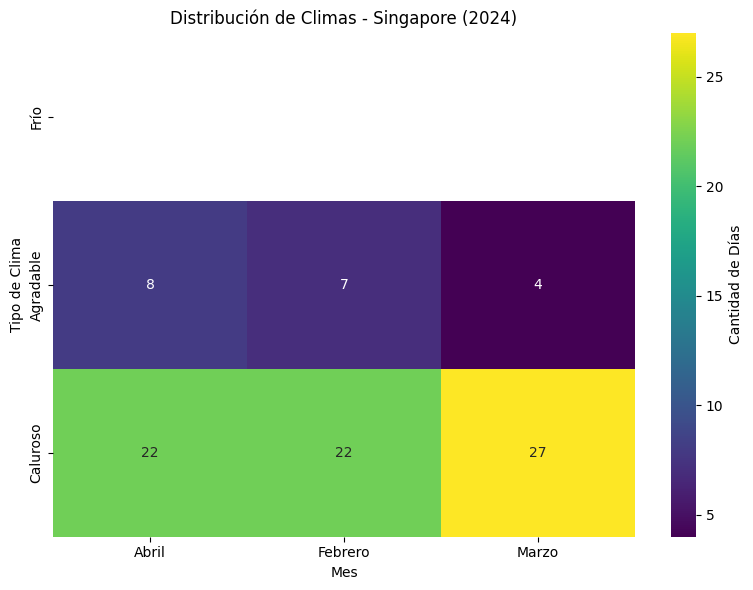

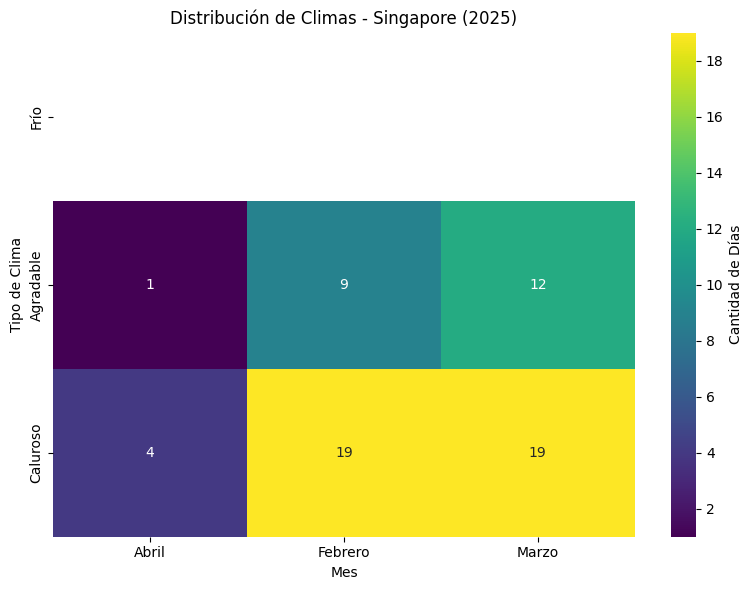

In [91]:
nombres_meses = {
    1: 'Enero', 2: 'Febrero', 3: 'Marzo',
    4: 'Abril', 5: 'Mayo', 6: 'Junio',
    7: 'Julio', 8: 'Agosto', 9: 'Septiembre',
    10: 'Octubre', 11: 'Noviembre', 12: 'Diciembre'
}

for city in ciudades:
    print(f"\n===== {city} =====")
    df_ciudad = df_filtrado[df_filtrado['city_name'] == city]

    for año in df_ciudad['año'].unique():
        df_año = df_ciudad[df_ciudad['año'] == año]

        # Calcular los 3 meses más calurosos
        promedio_max_por_mes = df_año.groupby('mes')['temperature_2m_max'].mean()
        meses_mas_calurosos = promedio_max_por_mes.sort_values(ascending=False).head(3).index.tolist()

        # Filtrar días de esos meses
        df_dias = df_año[df_año['mes'].isin(meses_mas_calurosos)][['dia', 'mes', 'temperature_2m_max', 'diferencia_aparente', 'amplitud_termica']].copy()

        # Clasificación climática
        def clasificar_clima(temp):
            if temp < 20:
                return 'Frío'
            elif 20 <= temp < 30:
                return 'Agradable'
            else:
                return 'Caluroso'

        df_dias['Clima'] = df_dias['temperature_2m_max'].apply(clasificar_clima)
        df_dias['Mes_nombre'] = df_dias['mes'].map(nombres_meses)

        # Crear tabla cruzada
        df_heat = pd.crosstab(df_dias['Clima'], df_dias['Mes_nombre'])

        # Asegurar orden de filas
        orden_clima = ['Frío', 'Agradable', 'Caluroso']
        df_heat = df_heat.reindex(index=orden_clima)

        # Crear heatmap
        plt.figure(figsize=(8, 6))
        sns.heatmap(df_heat, annot=True, cmap='viridis', fmt='.0f', cbar_kws={"label": "Cantidad de Días"})
        plt.title(f"Distribución de Climas - {city} ({año})")
        plt.xlabel('Mes')
        plt.ylabel('Tipo de Clima')
        plt.tight_layout()
        plt.show()


###Periodos frios


===== Abu Dhabi =====


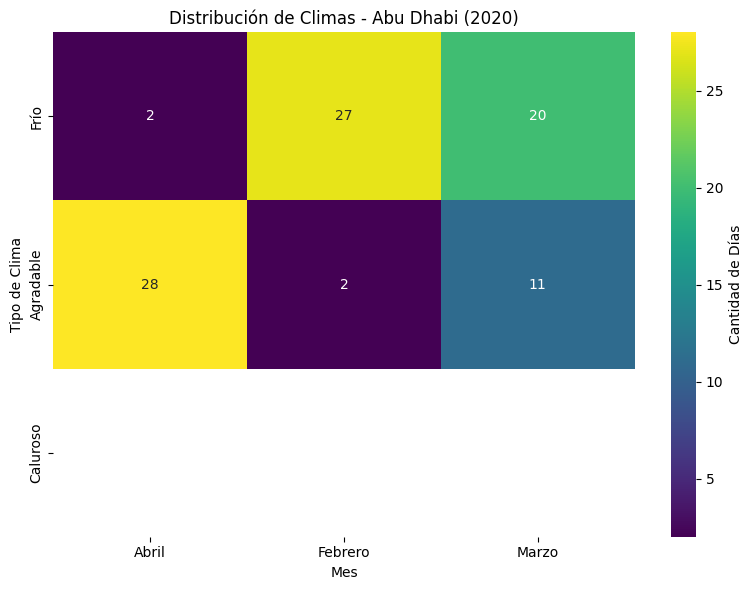

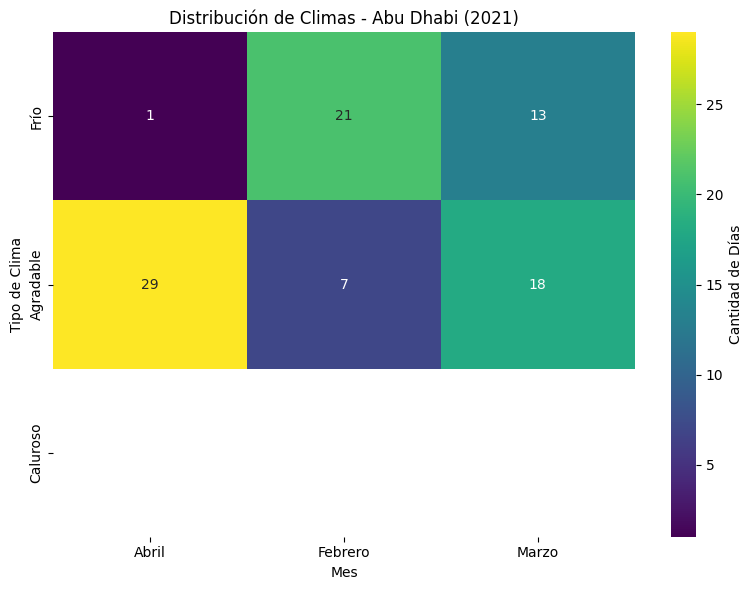

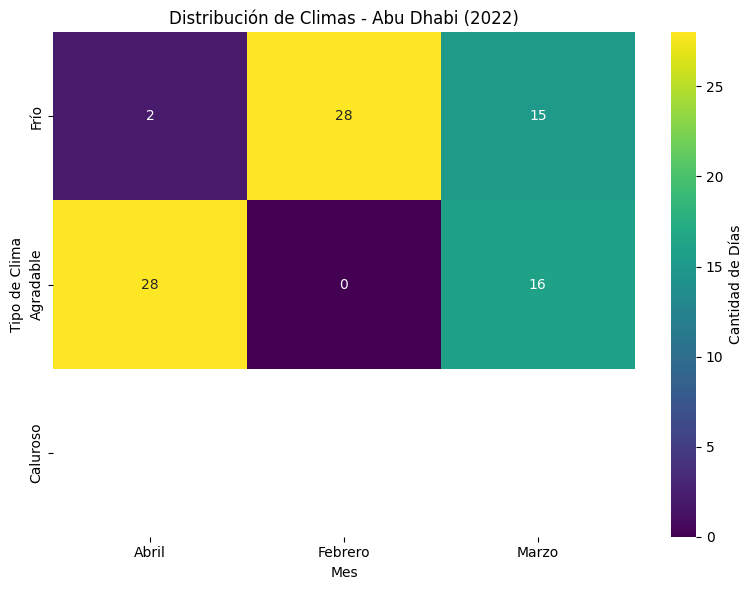

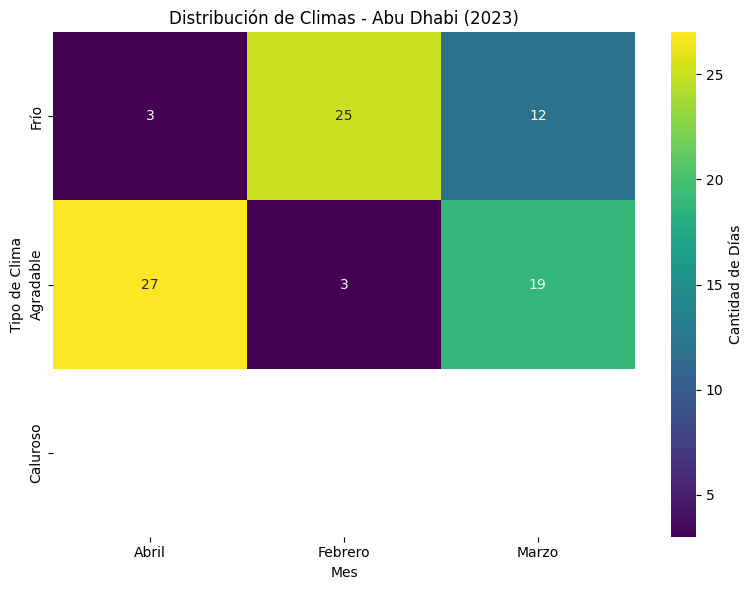

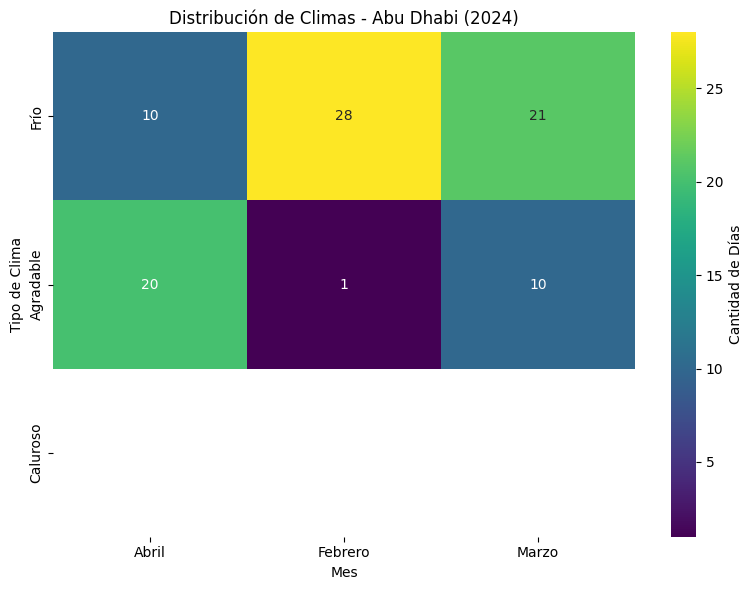

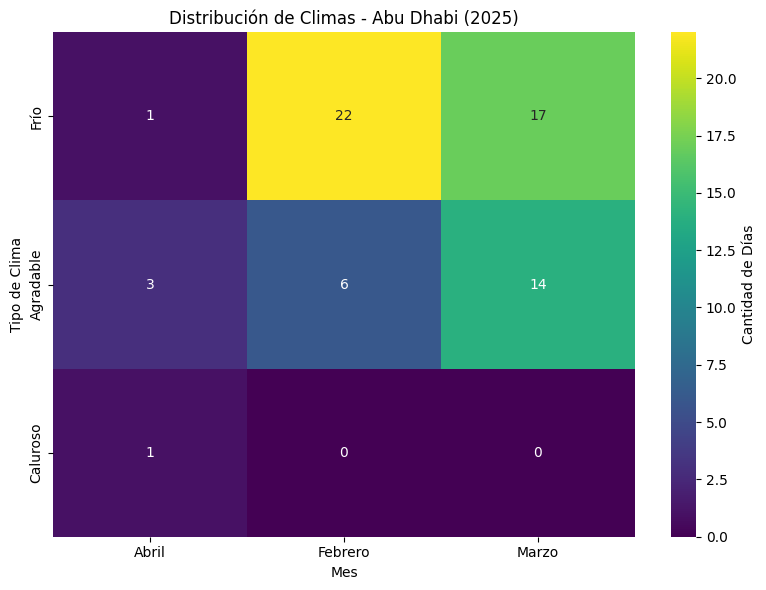


===== Bangkok =====


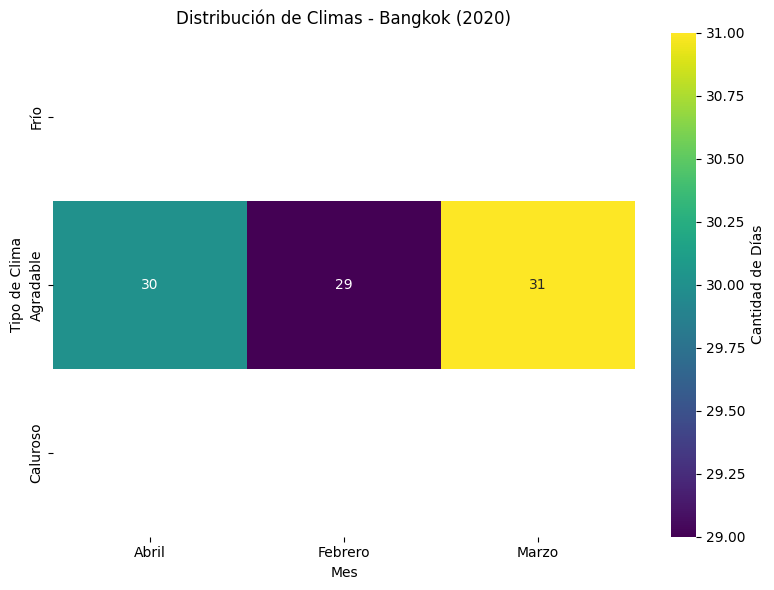

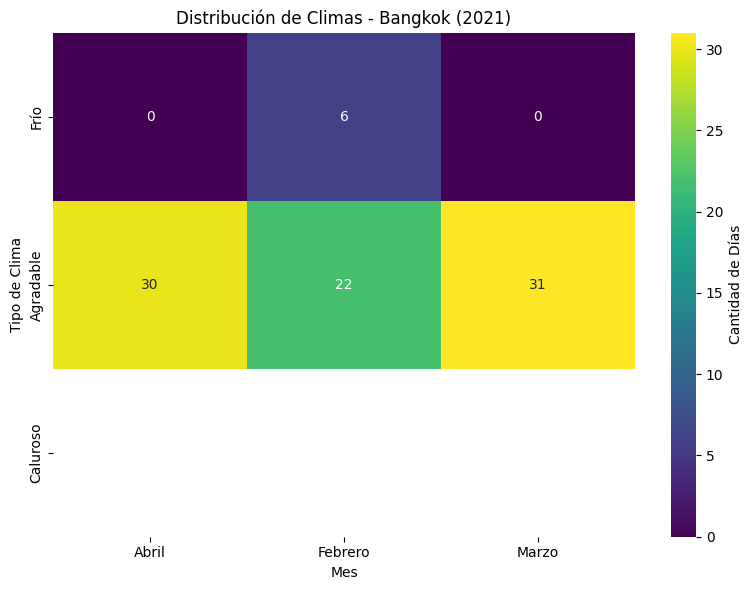

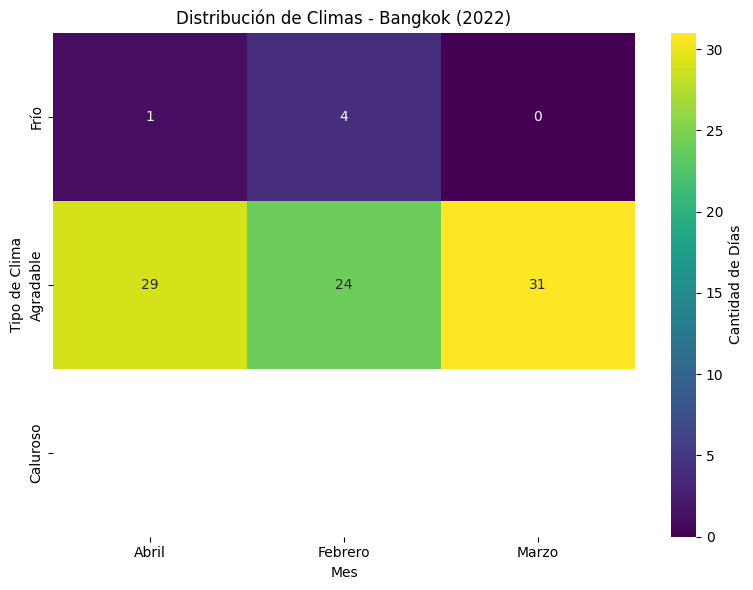

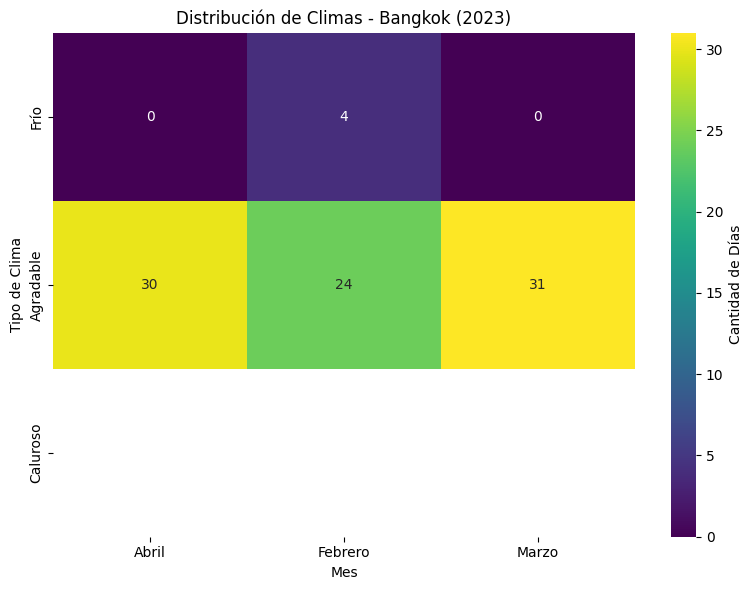

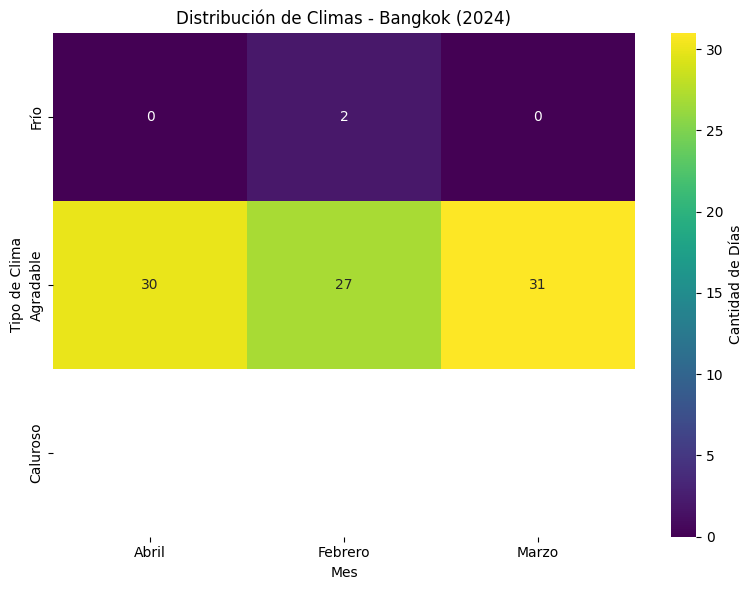

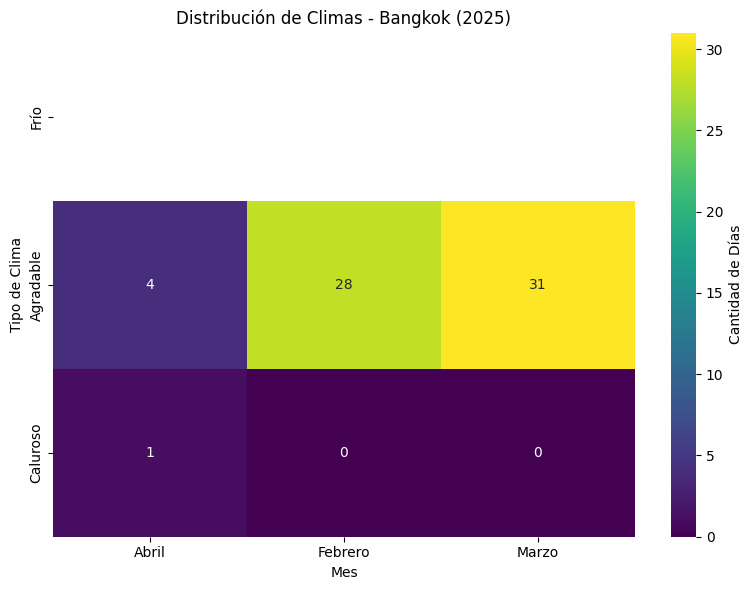


===== Doha =====


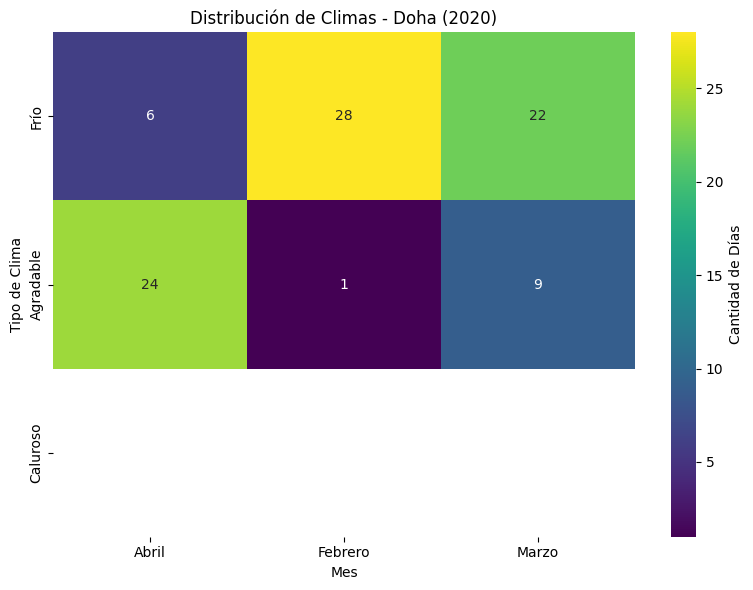

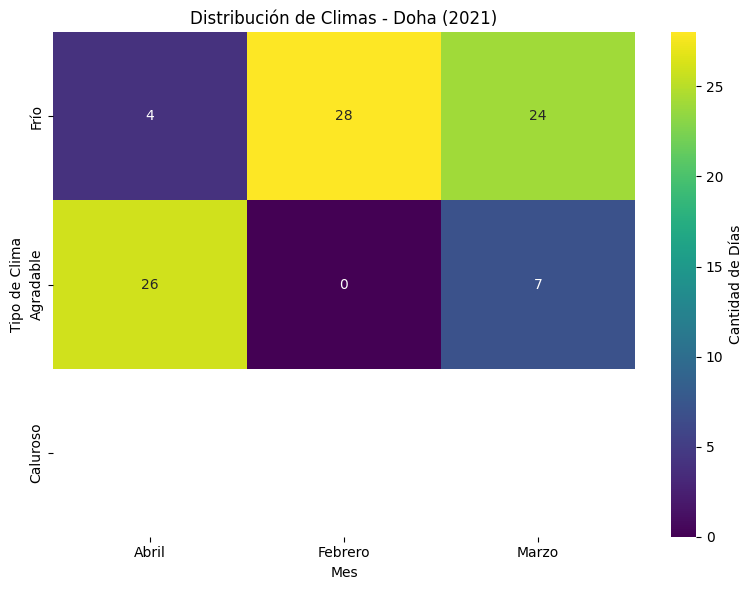

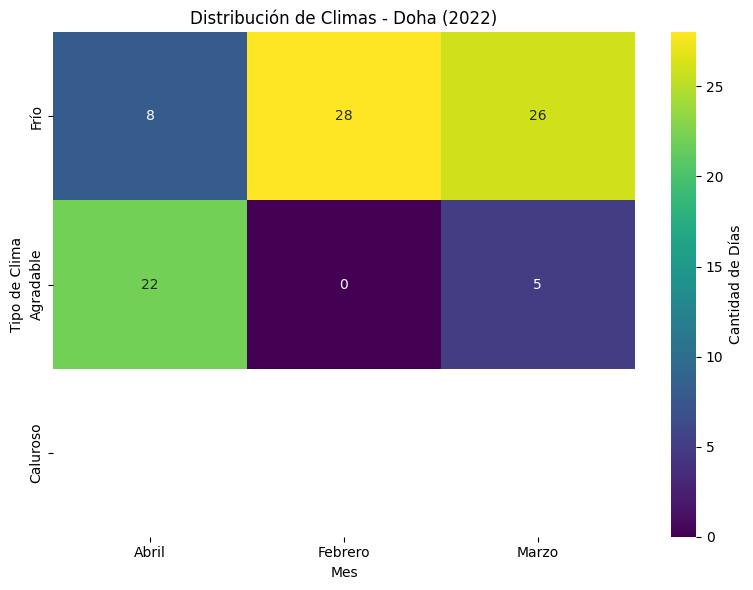

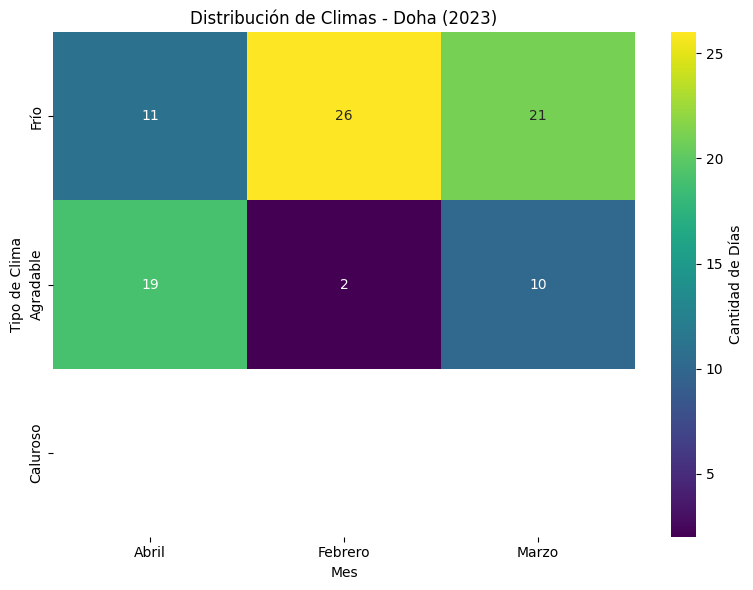

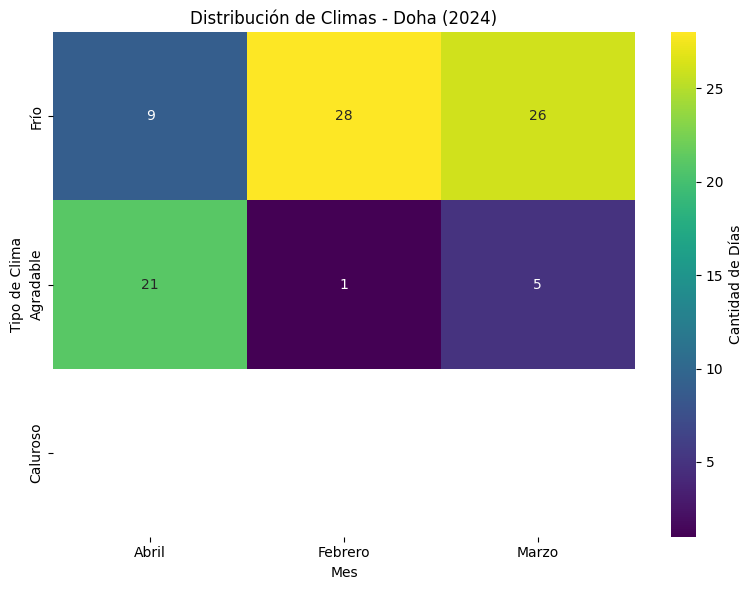

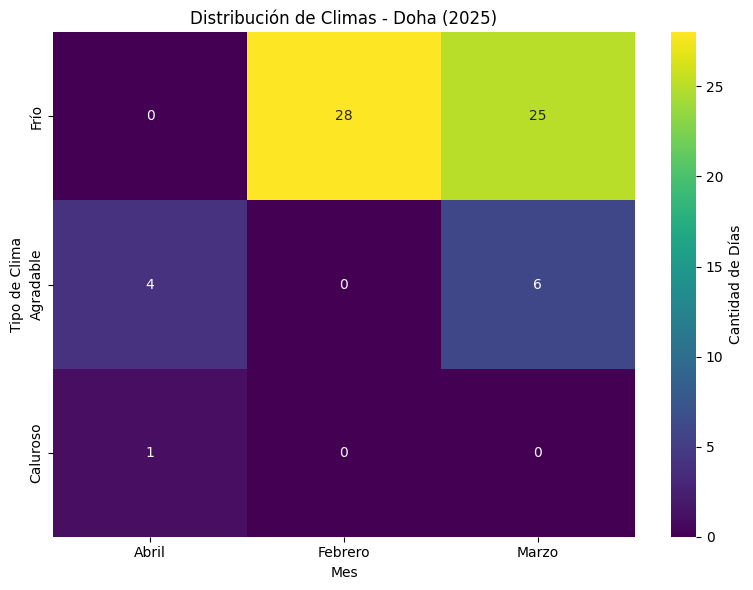


===== Dubai =====


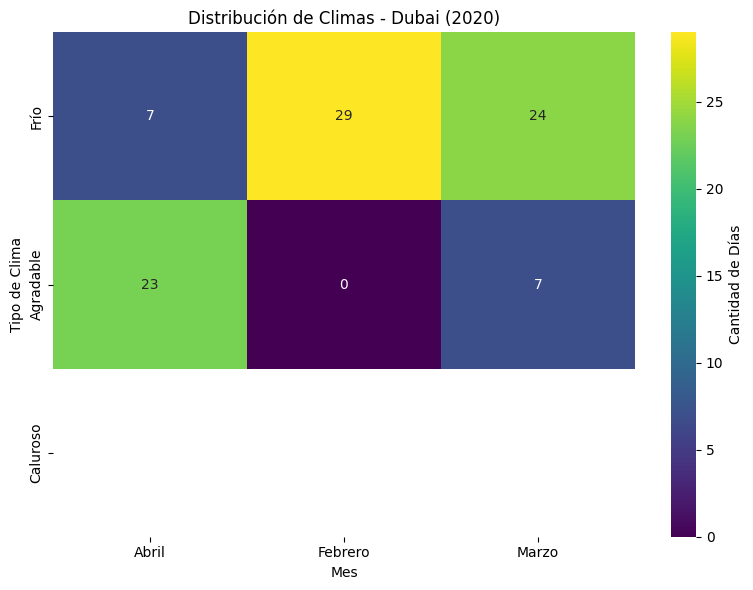

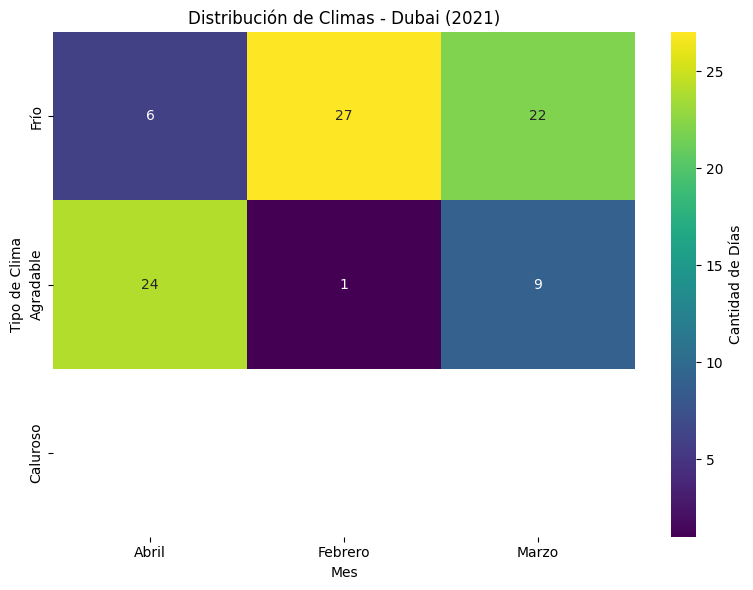

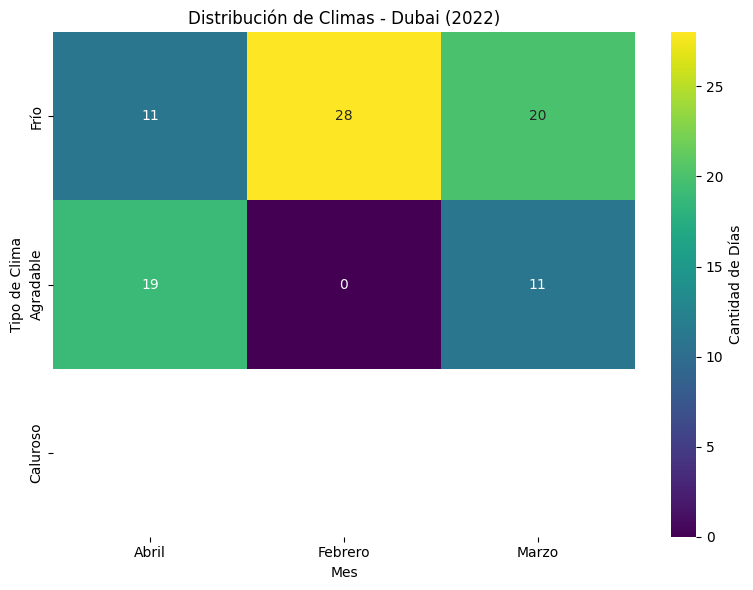

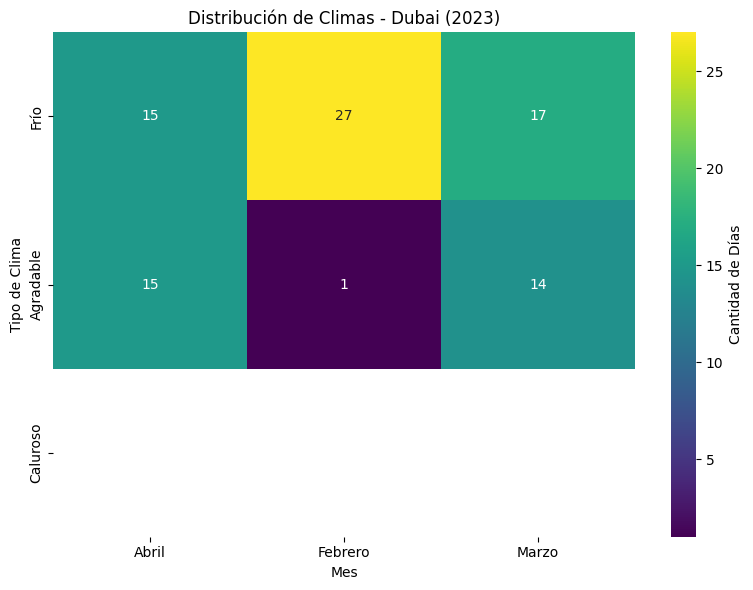

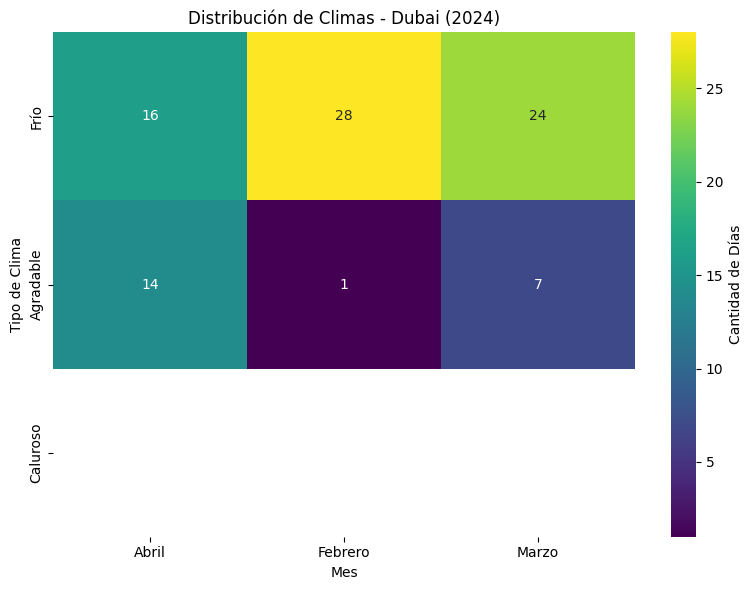

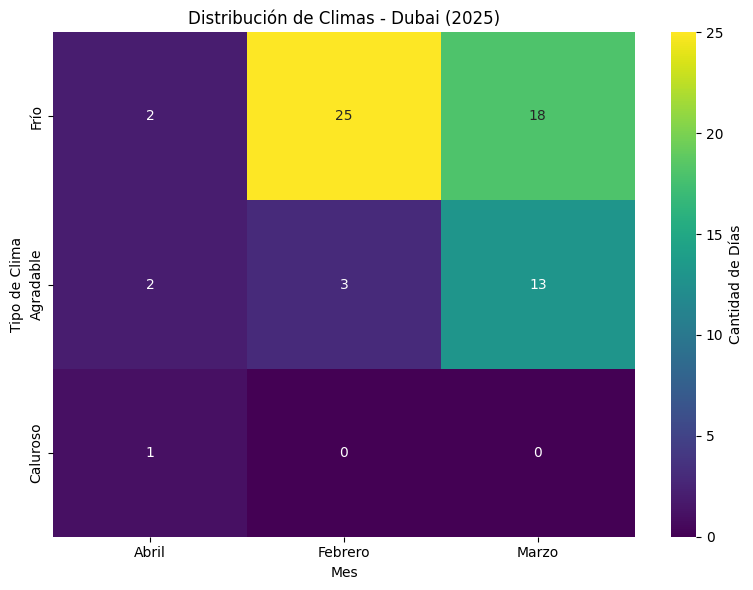


===== Kuwait City =====


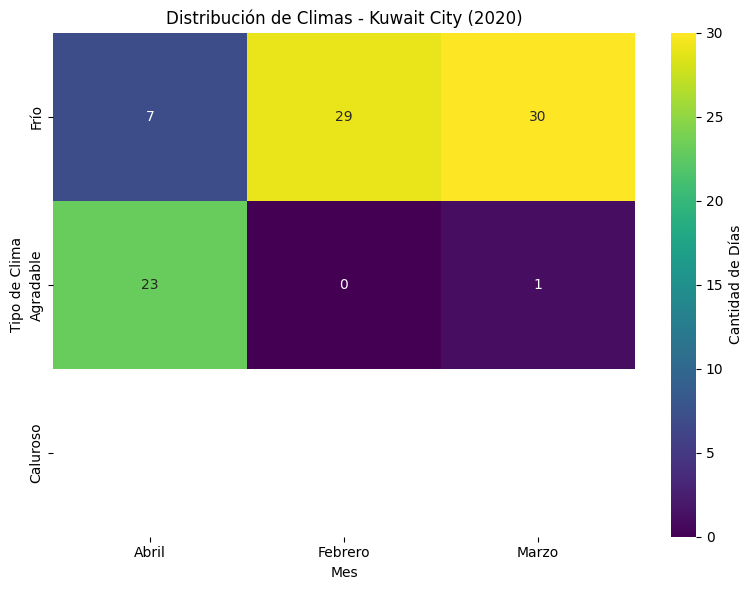

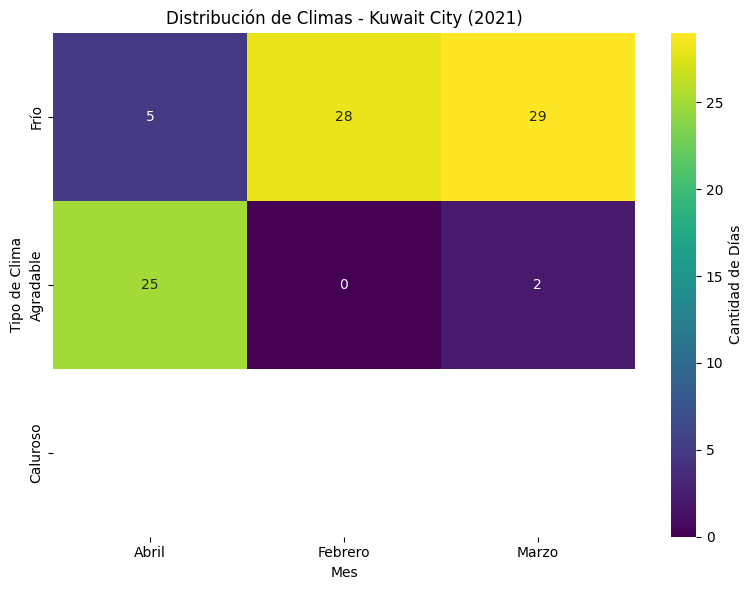

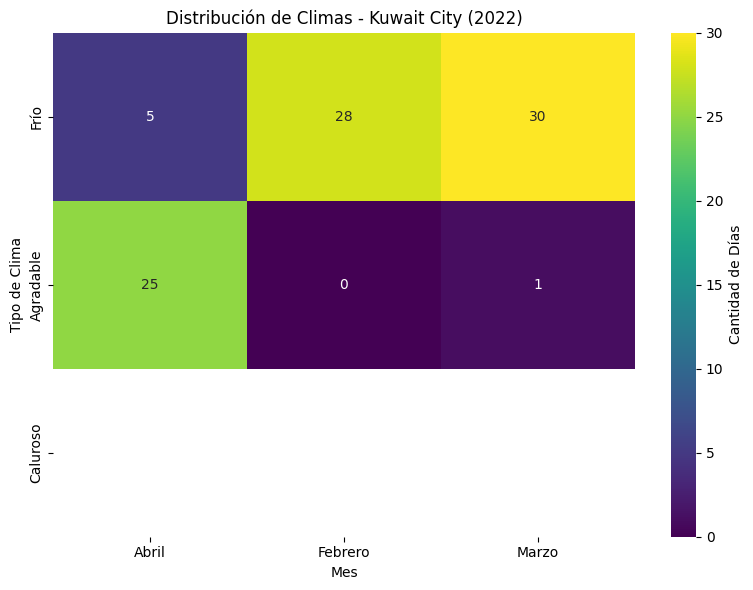

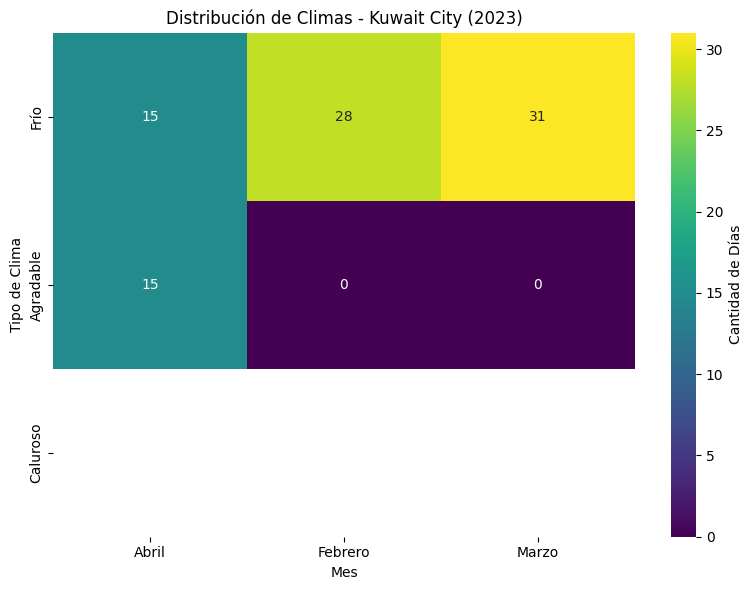

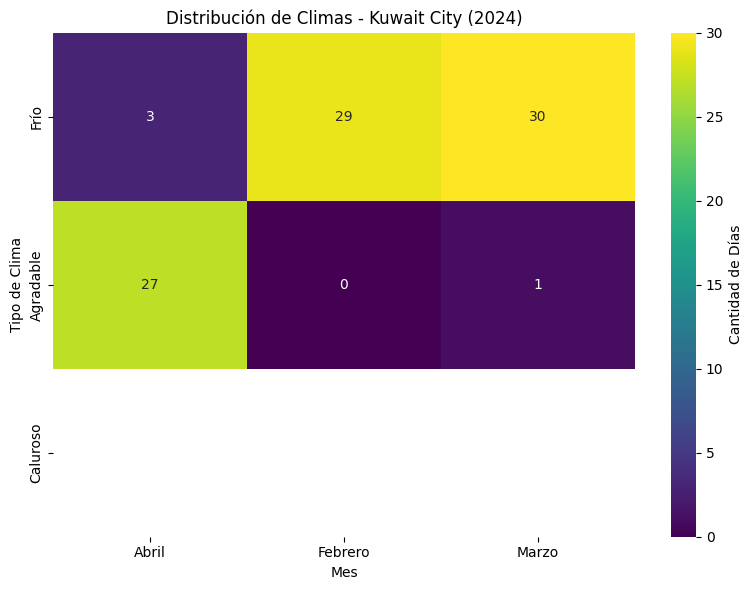

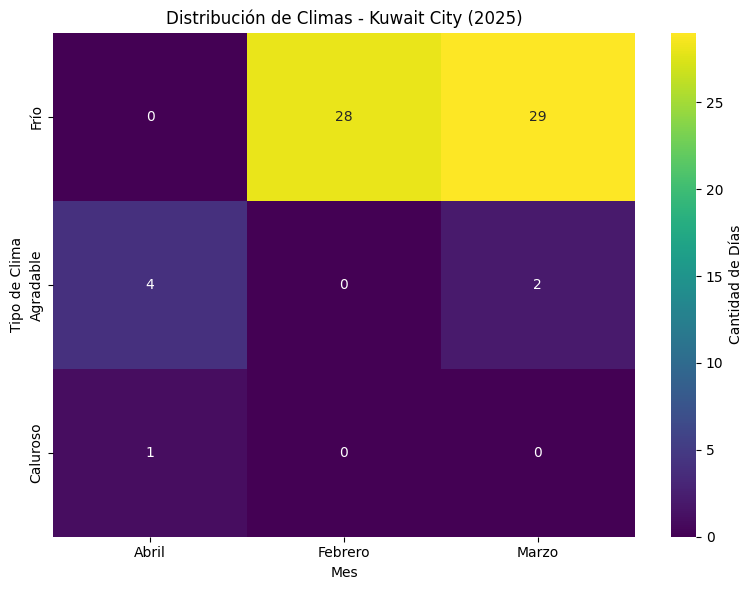


===== Muscat =====


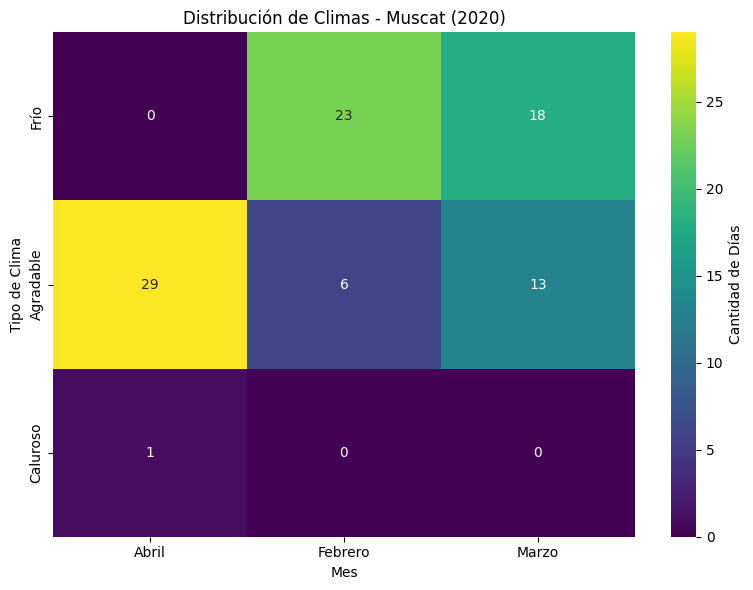

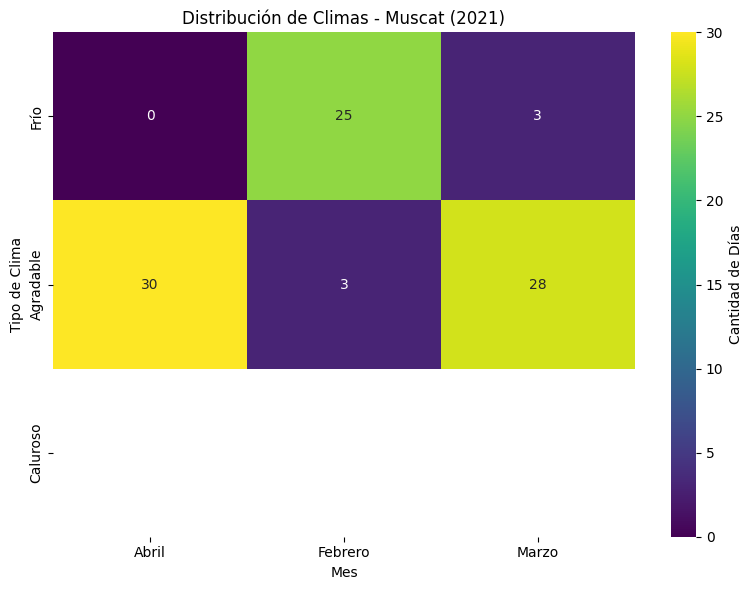

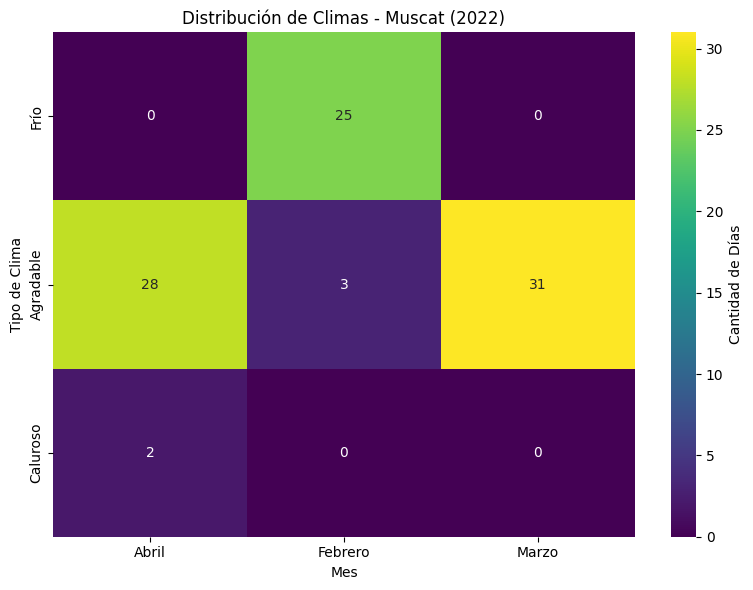

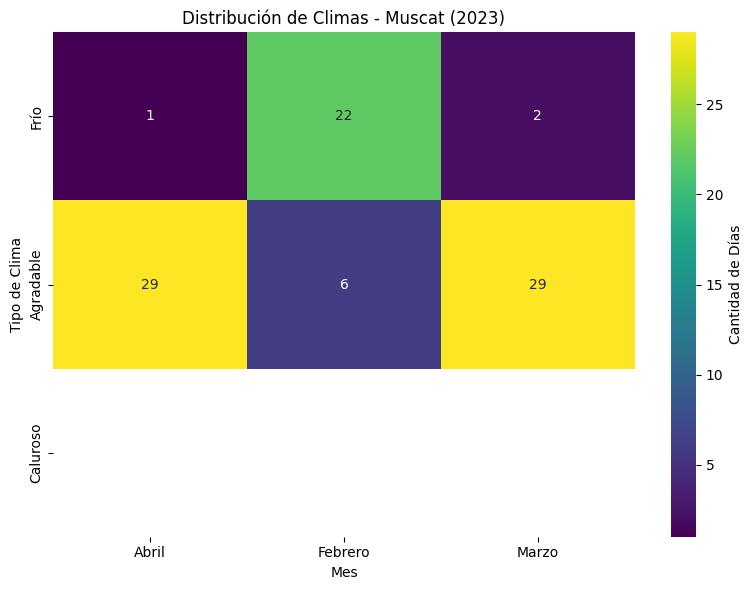

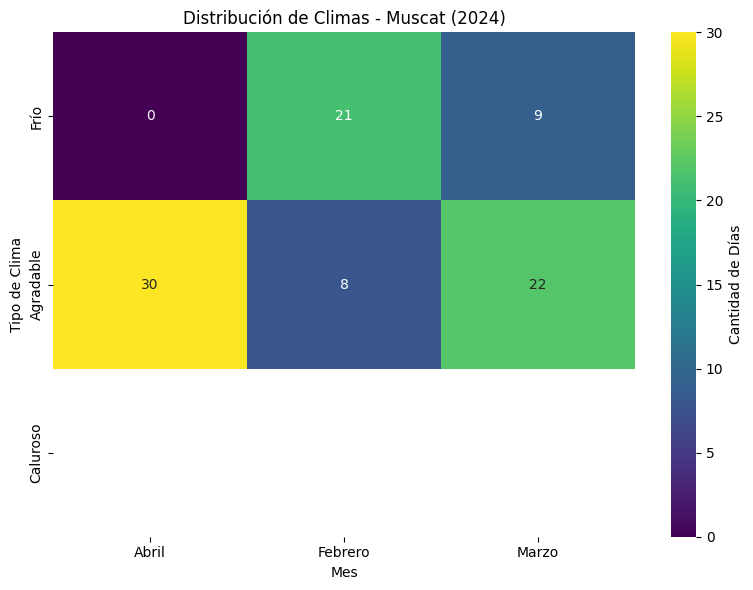

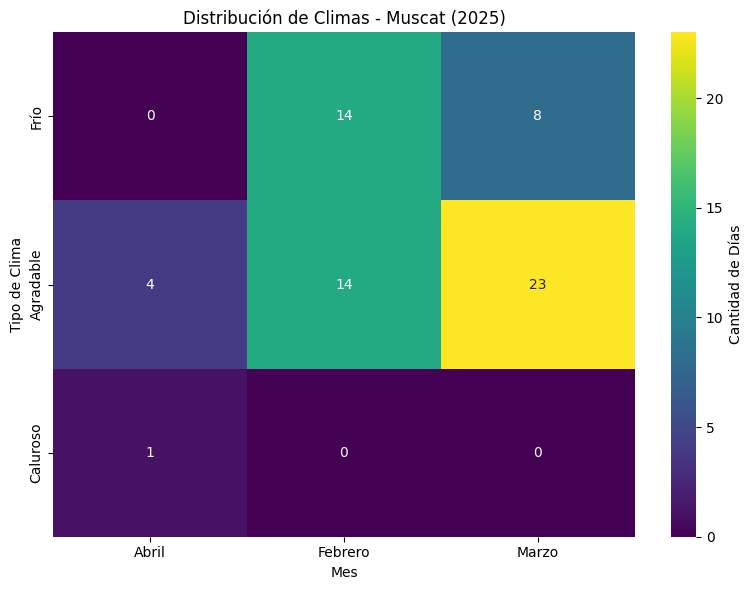


===== Rio de Janeiro =====


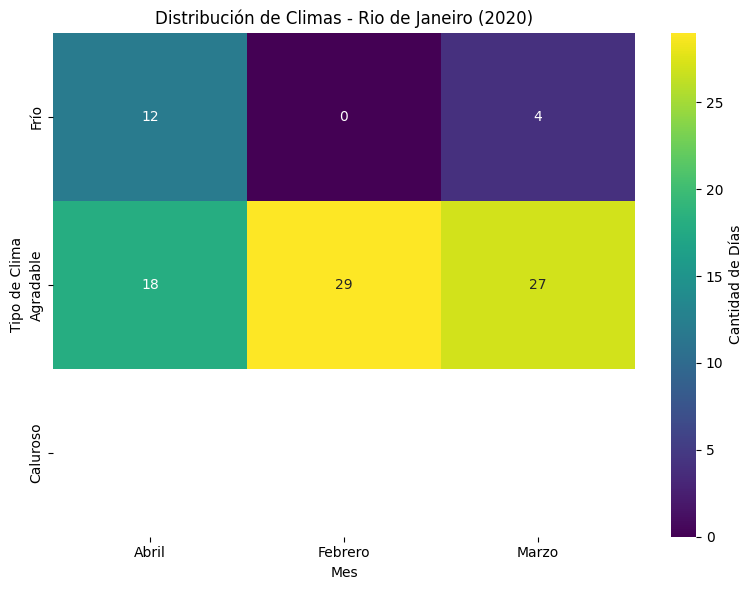

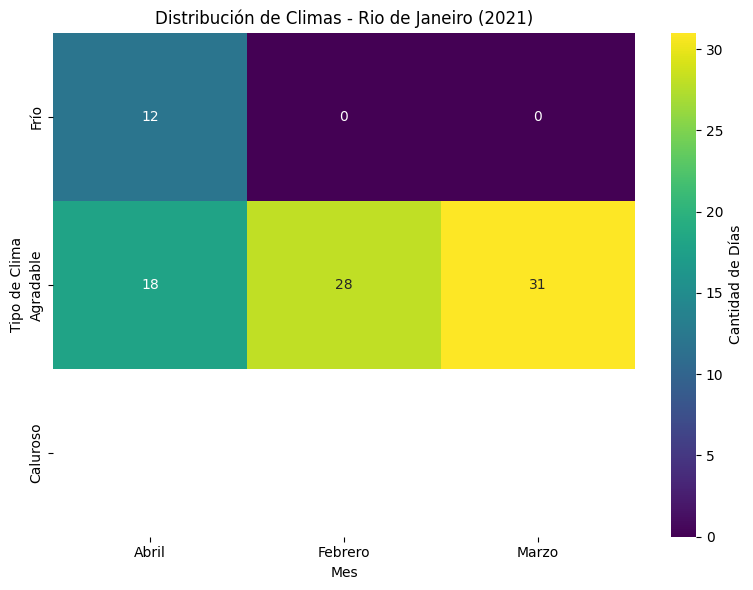

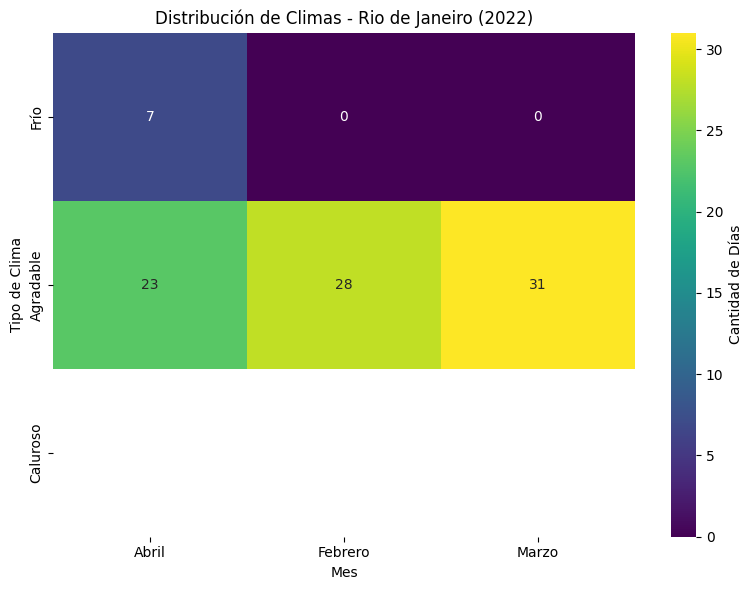

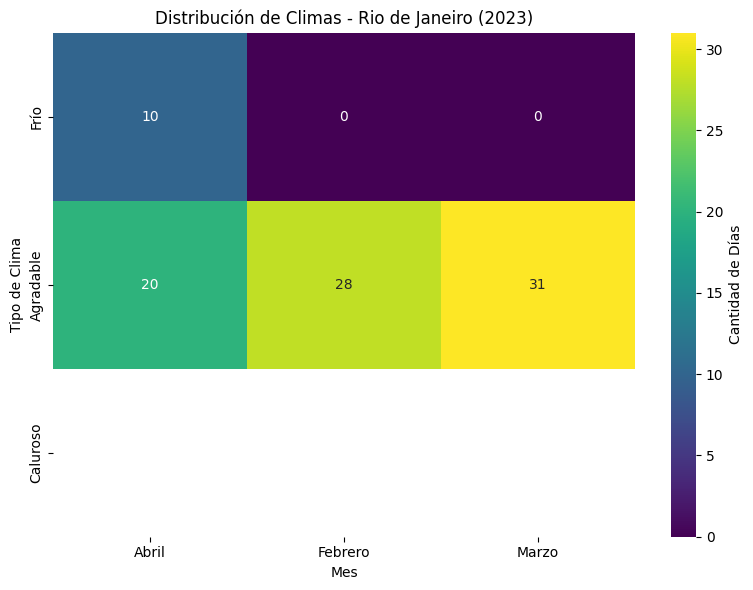

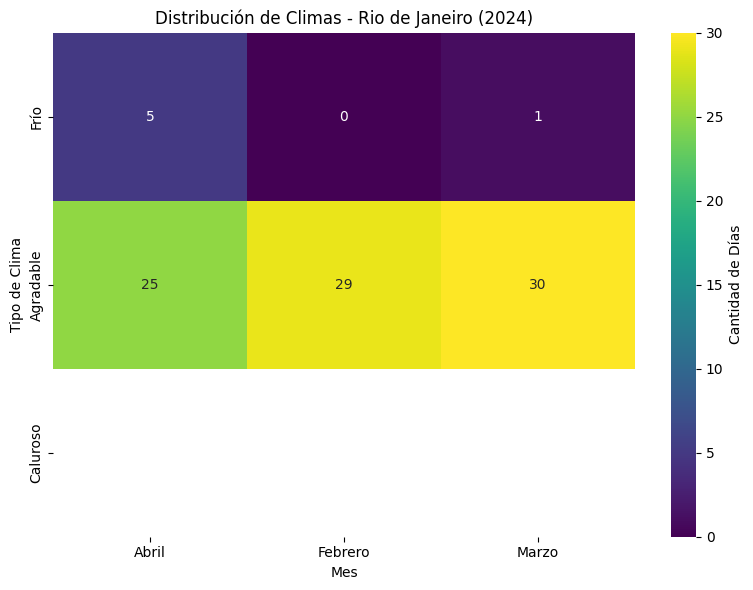

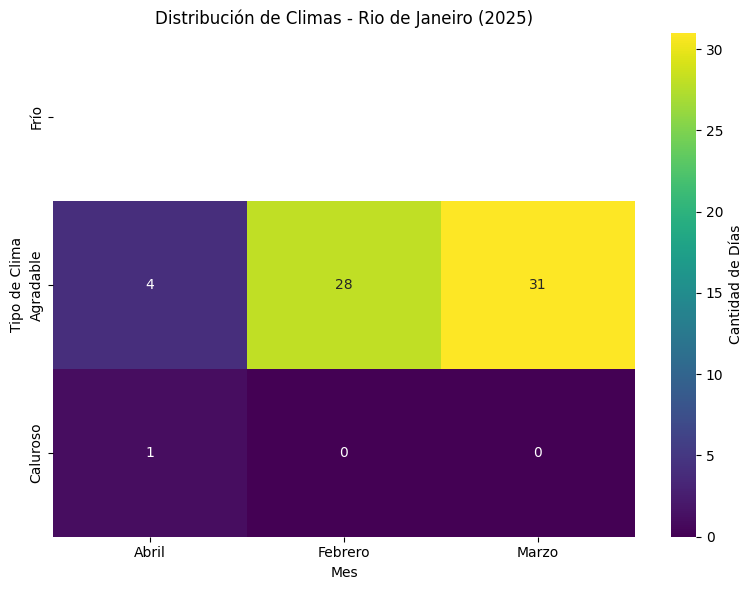


===== Riyadh =====


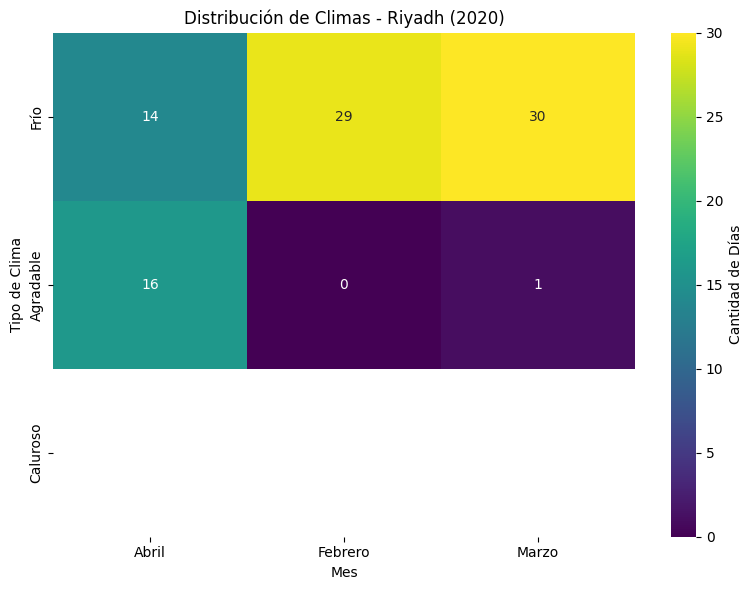

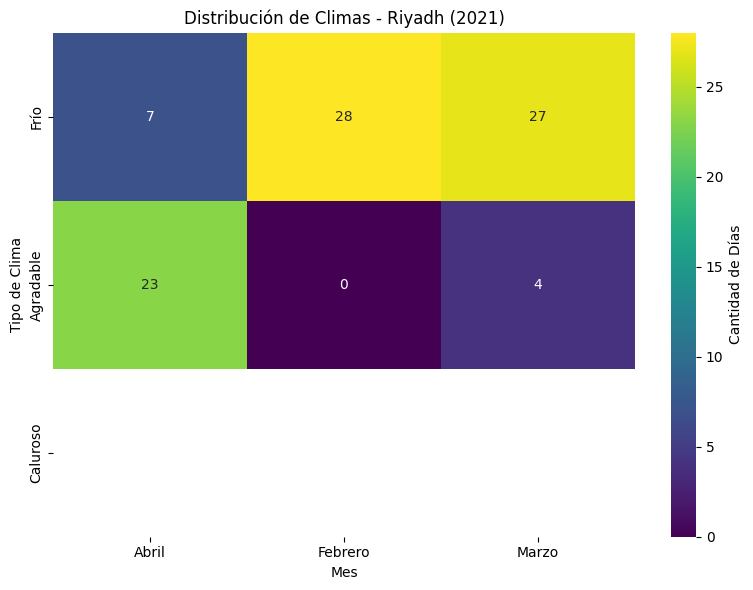

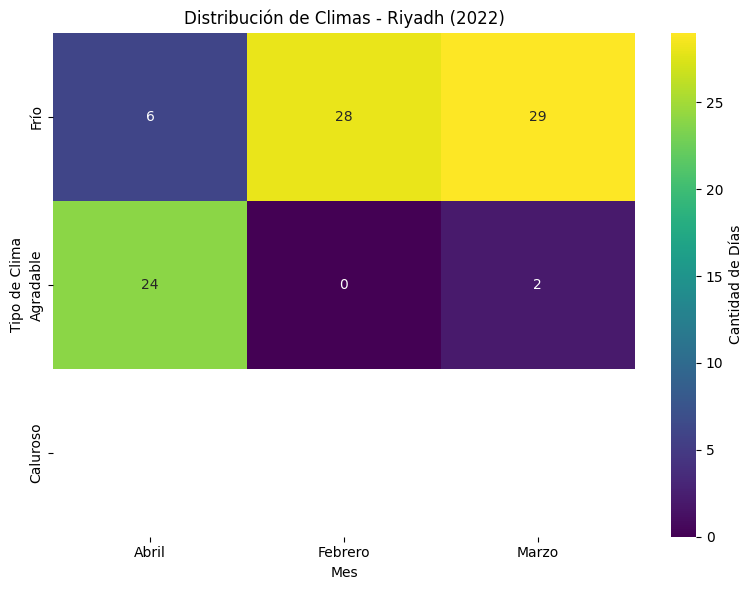

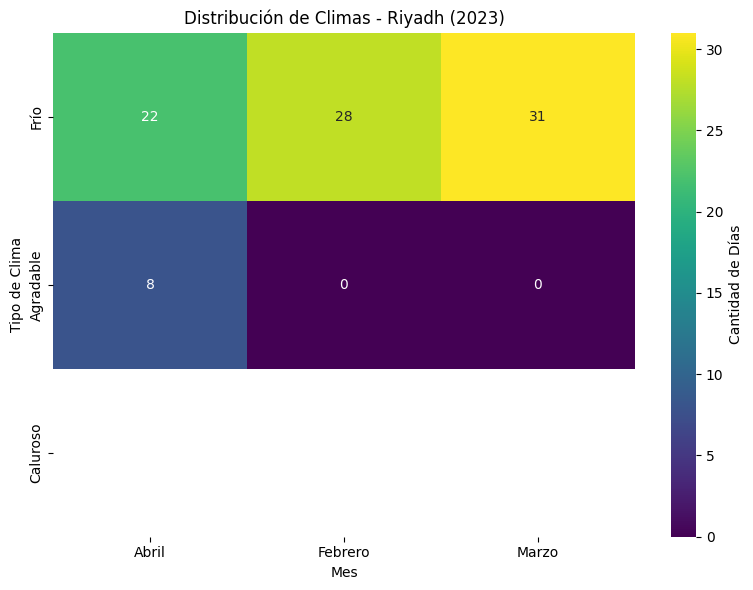

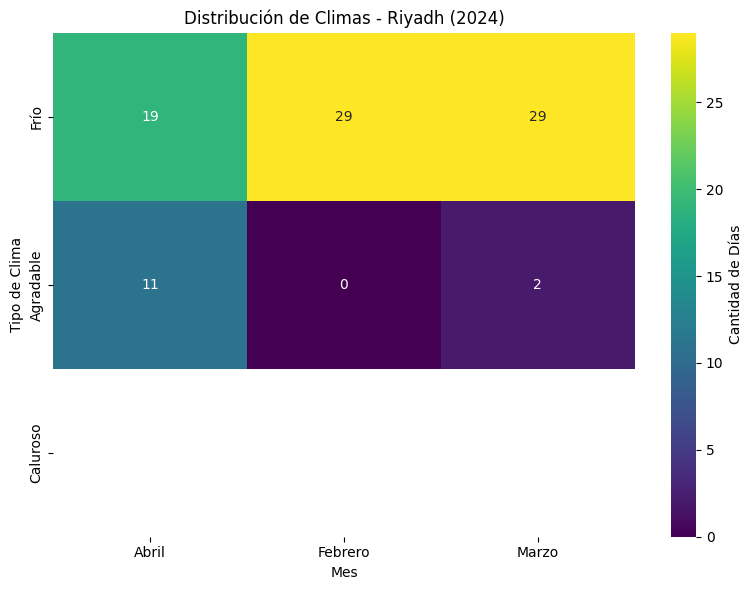

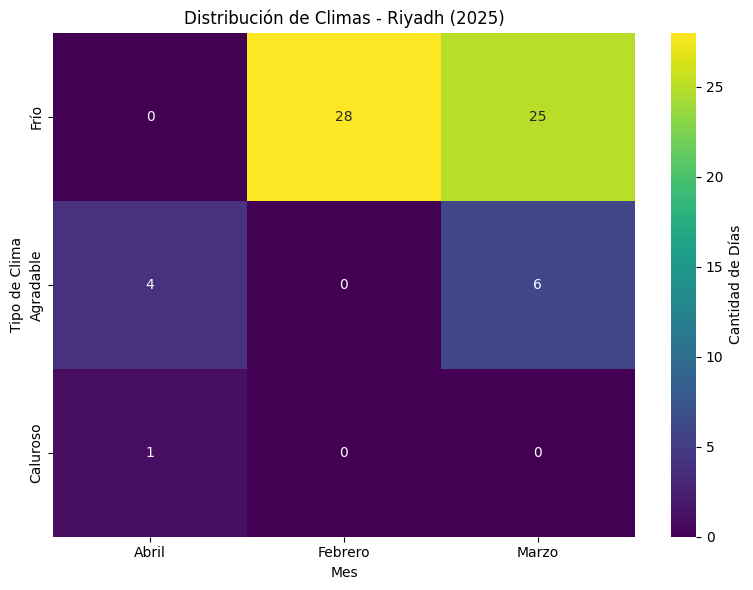


===== San Diego =====


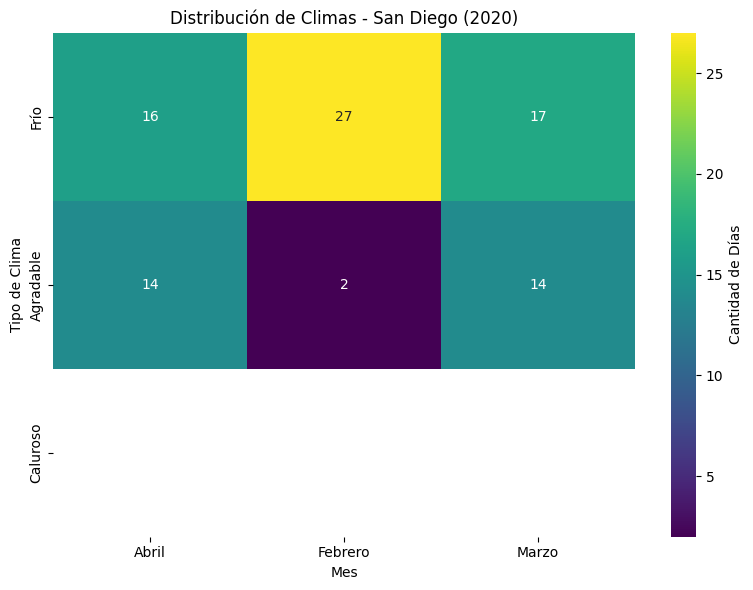

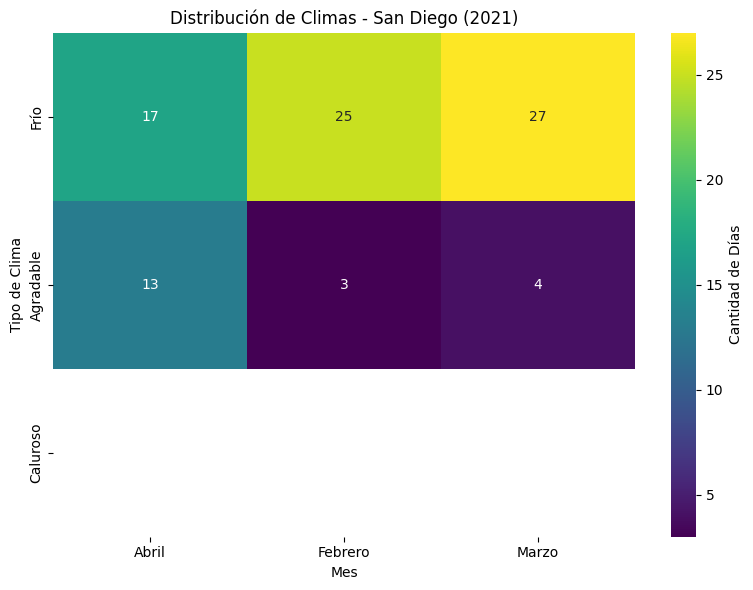

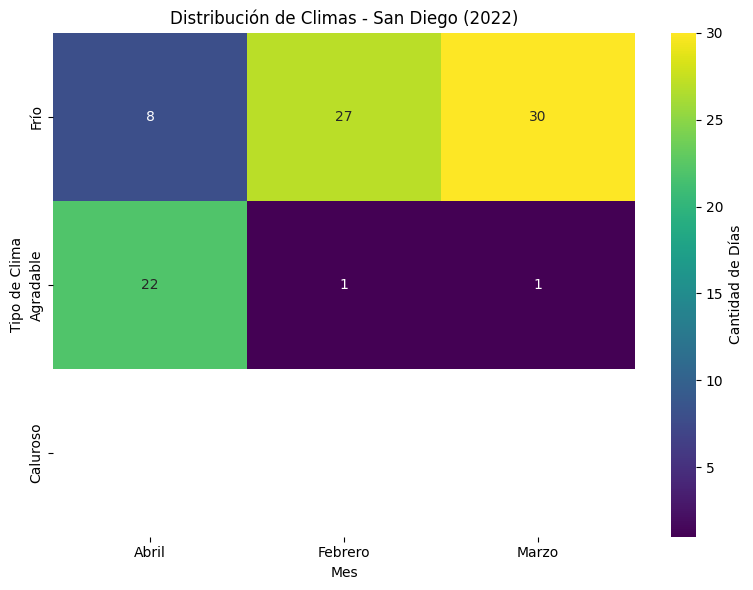

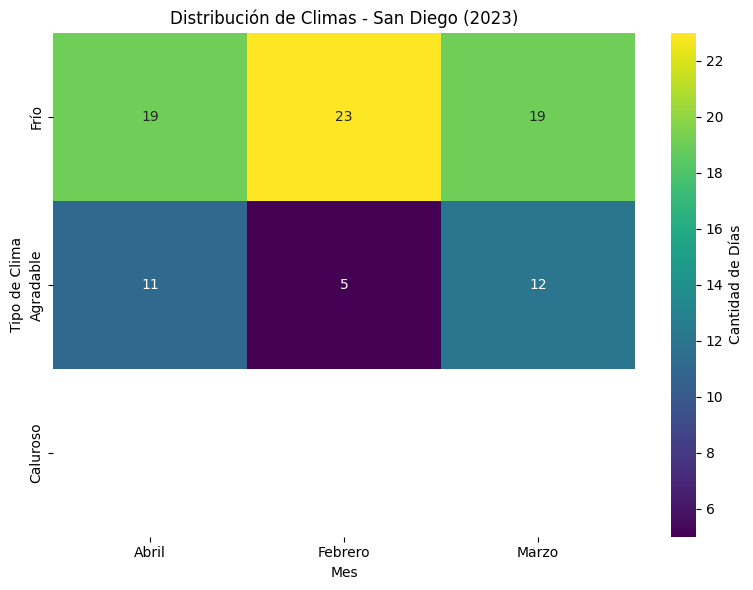

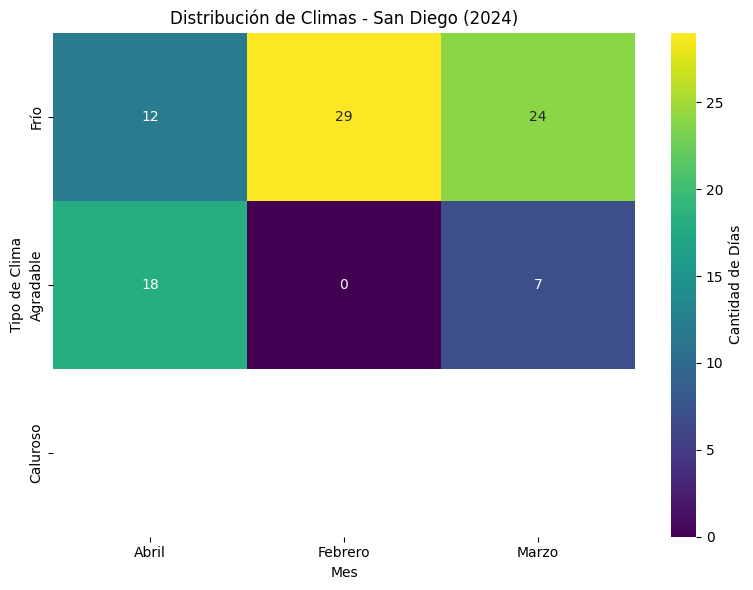

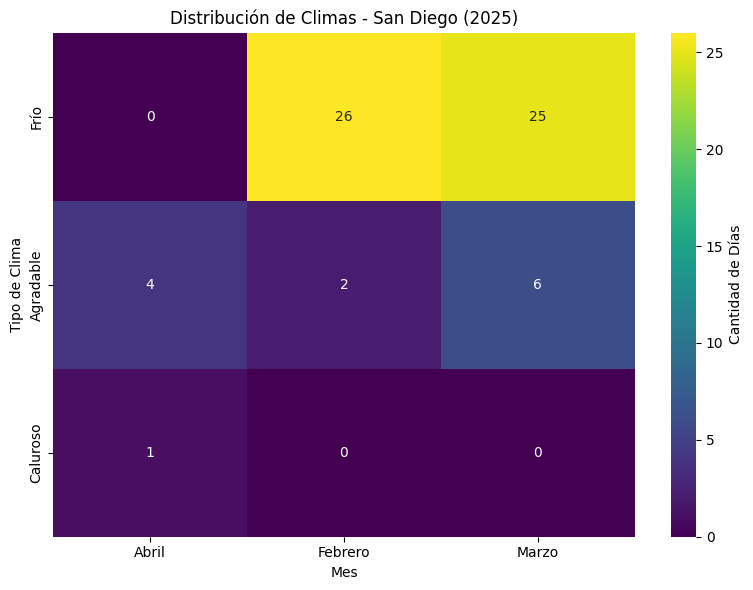


===== Singapore =====


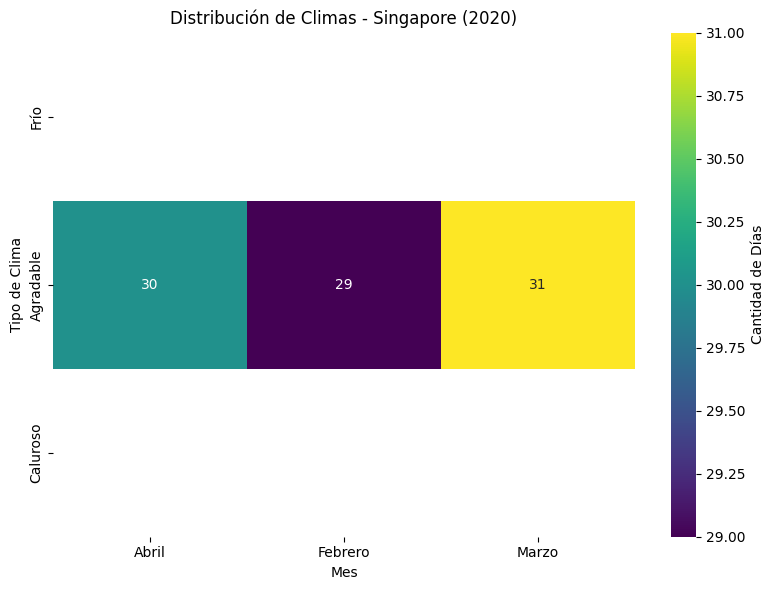

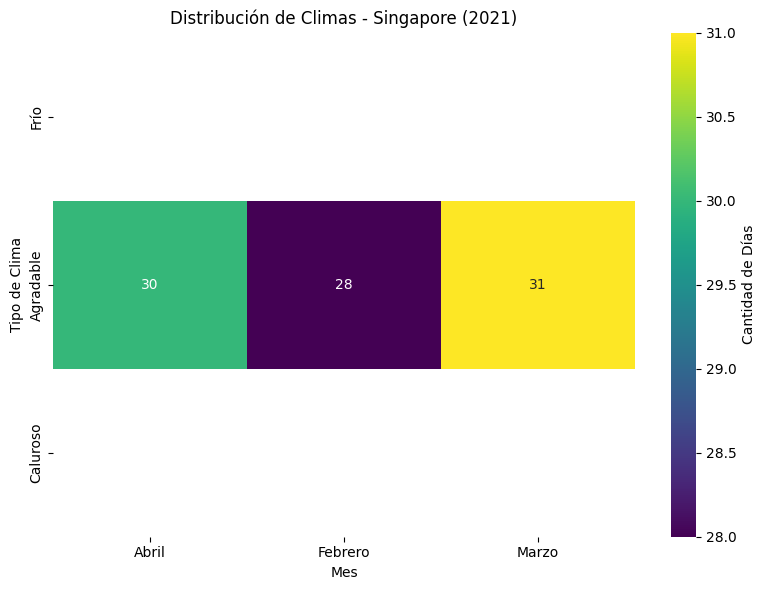

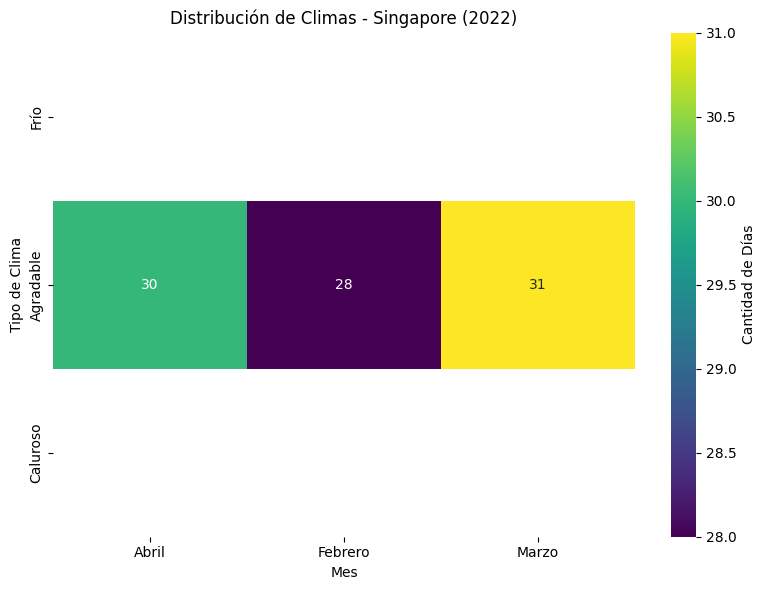

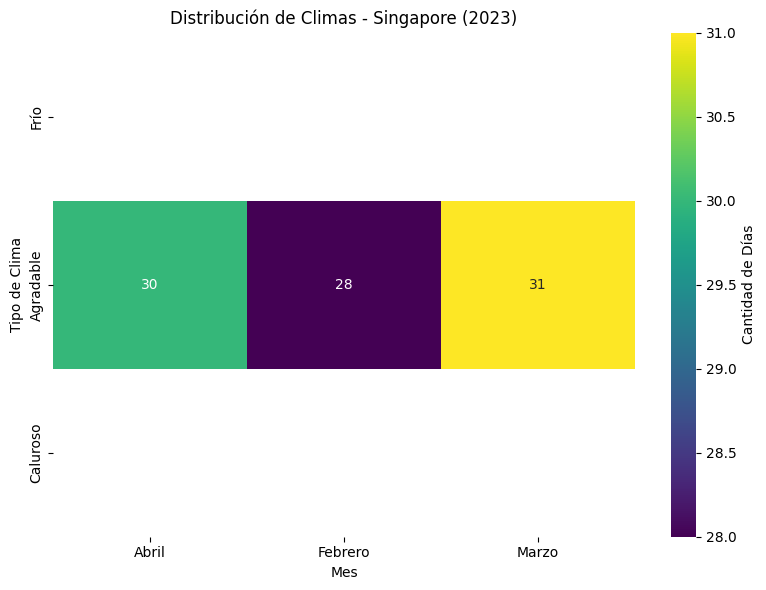

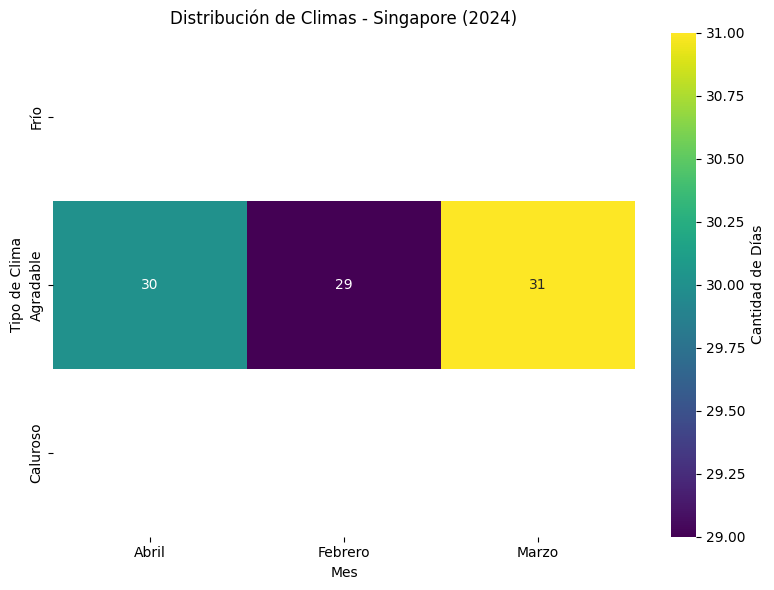

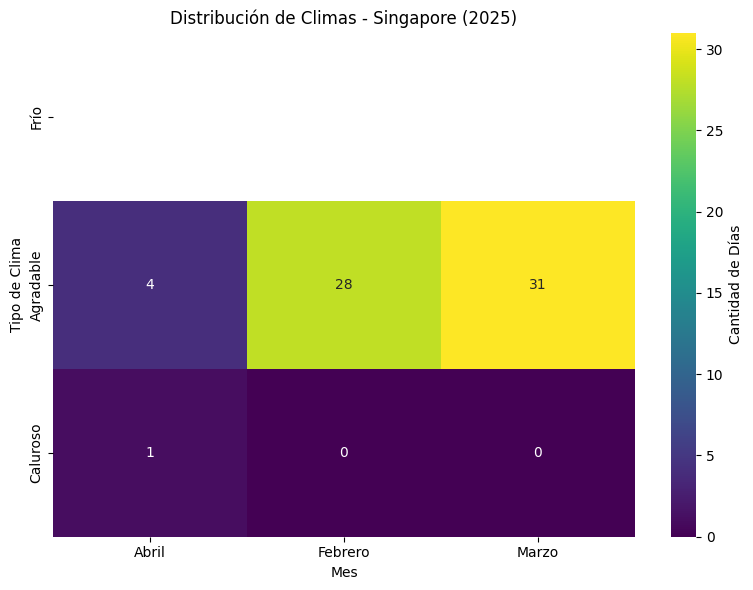

In [92]:
nombres_meses = {
    1: 'Enero', 2: 'Febrero', 3: 'Marzo',
    4: 'Abril', 5: 'Mayo', 6: 'Junio',
    7: 'Julio', 8: 'Agosto', 9: 'Septiembre',
    10: 'Octubre', 11: 'Noviembre', 12: 'Diciembre'
}

for city in ciudades:
    print(f"\n===== {city} =====")
    df_ciudad = df_filtrado[df_filtrado['city_name'] == city]

    for año in df_ciudad['año'].unique():
        df_año = df_ciudad[df_ciudad['año'] == año]

        # Calcular los 3 meses más calurosos
        promedio_min_por_mes = df_año.groupby('mes')['temperature_2m_min'].mean()
        meses_menos_calurosos = promedio_max_por_mes.sort_values(ascending=False).head(3).index.tolist()

        # Filtrar días de esos meses
        df_dias_frios = df_año[df_año['mes'].isin(meses_menos_calurosos)][['dia', 'mes', 'temperature_2m_min']].copy()

        # Clasificación climática
        def clasificar_clima(temp):
            if temp < 20:
                return 'Frío'
            elif 20 <= temp < 30:
                return 'Agradable'
            else:
                return 'Caluroso'

        df_dias_frios['Clima'] = df_dias_frios['temperature_2m_min'].apply(clasificar_clima)
        df_dias_frios['Mes_nombre'] = df_dias_frios['mes'].map(nombres_meses)

        # Crear tabla cruzada
        df_frios = pd.crosstab(df_dias_frios['Clima'], df_dias_frios['Mes_nombre']) # Change df_frio to df_frios

        # Asegurar orden de filas
        orden_clima = ['Frío', 'Agradable', 'Caluroso']
        df_frios = df_frios.reindex(index=orden_clima)

        # Crear heatmap
        plt.figure(figsize=(8, 6))
        sns.heatmap(df_frios, annot=True, cmap='viridis', fmt='.0f', cbar_kws={"label": "Cantidad de Días"})
        plt.title(f"Distribución de Climas - {city} ({año})")
        plt.xlabel('Mes')
        plt.ylabel('Tipo de Clima')
        plt.tight_layout()
        plt.show()

##¿Cómo se distribuye la diferencia entre la temperatura media y la sensación térmica (diferencia aparente) en estas ciudades?



In [93]:
for city in ciudades:
    print(f"\n===== {city} =====")
    df_ciudad = df_filtrado[df_filtrado['city_name'] == city]

    for año in df_ciudad['año'].unique():
        df_año = df_ciudad[df_ciudad['año'] == año]

        df_diferencia = df_año.groupby('mes')[['dia','diferencia_aparente']].mean()

        fig_age = px.histogram(df_diferencia, x="dia", title=f"Distribución de diferencia aparente entre la temperatura media y su sensacion termica de {city} en el año {año}")
        fig_age.show()


===== Abu Dhabi =====



===== Bangkok =====



===== Doha =====



===== Dubai =====



===== Kuwait City =====



===== Muscat =====



===== Rio de Janeiro =====



===== Riyadh =====



===== San Diego =====



===== Singapore =====


##¿Cómo se distribuye la diferencia entre la temperatura máxima y mínima (amplitud térmica) en estas ciudades?

In [94]:
for city in ciudades:
    print(f"\n===== {city} =====")
    df_ciudad = df_filtrado[df_filtrado['city_name'] == city]

    for año in df_ciudad['año'].unique():
        df_año = df_ciudad[df_ciudad['año'] == año]

        df_amplitud = df_año.groupby('mes')[['dia','amplitud_termica']].mean()

        fig_age = px.histogram(df_amplitud, x="dia", title=f"Distribución de amplitud termica entre la temperatura maxima y minima de {city} en el año {año}")
        fig_age.show()


===== Abu Dhabi =====



===== Bangkok =====



===== Doha =====



===== Dubai =====



===== Kuwait City =====



===== Muscat =====



===== Rio de Janeiro =====



===== Riyadh =====



===== San Diego =====



===== Singapore =====


¿cual es la probabilidad de lluvia de las ciudades?

In [95]:
for city in ciudades:
    print(f"\n===== {city} =====")
    df_ciudad = df_filtrado[df_filtrado['city_name'] == city]

    for año in df_ciudad['año'].unique():
        df_año = df_ciudad[df_ciudad['año'] == año]

        df_diferencia = df_año.groupby('mes')[['dia','diferencia_aparente']].mean()

        fig_age = px.histogram(df_diferencia, x="dia", title=f"Distribución de diferencia aparente entre la temperatura media y su sensacion termica de {city} en el año {año}")
        fig_age.show()


===== Abu Dhabi =====



===== Bangkok =====



===== Doha =====



===== Dubai =====



===== Kuwait City =====



===== Muscat =====



===== Rio de Janeiro =====



===== Riyadh =====



===== San Diego =====



===== Singapore =====


##¿Cuál es la probabilidad de lluvia en estas ciudades en los próximos dos años?

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpljcpx5kz/an18lpyr.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpljcpx5kz/5_8h7_qm.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=52905', 'data', 'file=/tmp/tmpljcpx5kz/an18lpyr.json', 'init=/tmp/tmpljcpx5kz/5_8h7_qm.json', 'output', 'file=/tmp/tmpljcpx5kz/prophet_modelsjhqoifa/prophet_model-20250430191531.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
19:15:31 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
19:15:31 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing



===== Abu Dhabi =====


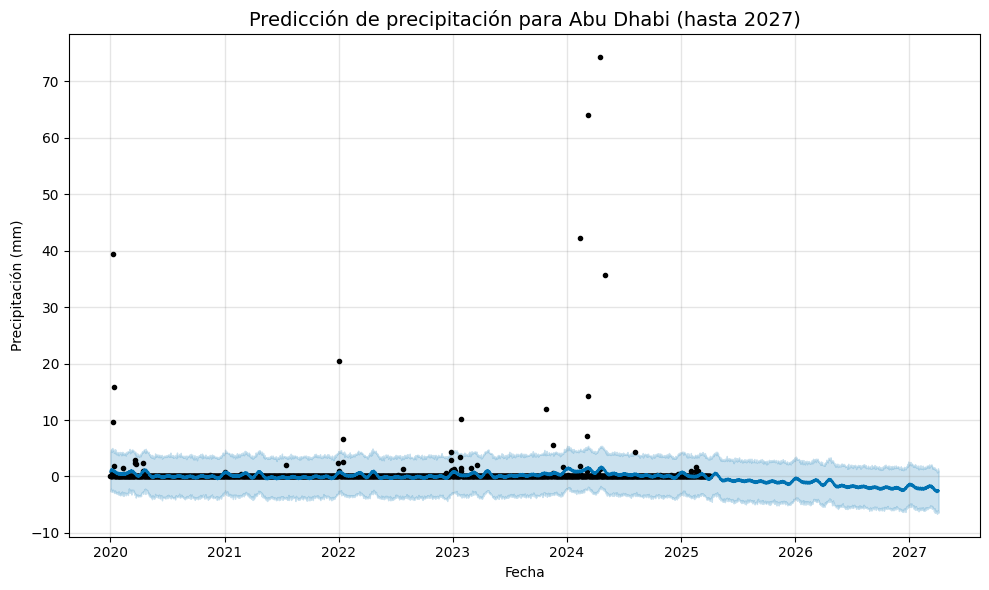

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpljcpx5kz/f98x3t5a.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpljcpx5kz/ucbo9249.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=35537', 'data', 'file=/tmp/tmpljcpx5kz/f98x3t5a.json', 'init=/tmp/tmpljcpx5kz/ucbo9249.json', 'output', 'file=/tmp/tmpljcpx5kz/prophet_modelijn6e0iy/prophet_model-20250430191532.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
19:15:32 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
19:15:32 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing



===== Bangkok =====


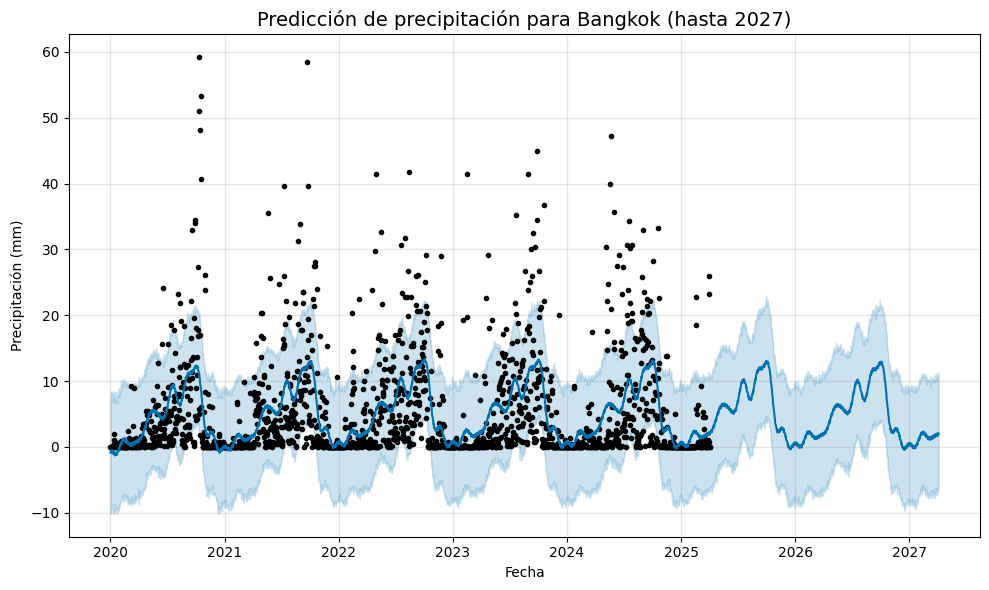

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpljcpx5kz/qr5_fd2t.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpljcpx5kz/whedqnyp.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=41824', 'data', 'file=/tmp/tmpljcpx5kz/qr5_fd2t.json', 'init=/tmp/tmpljcpx5kz/whedqnyp.json', 'output', 'file=/tmp/tmpljcpx5kz/prophet_modelwr29qygt/prophet_model-20250430191533.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
19:15:33 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
19:15:33 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing



===== Doha =====


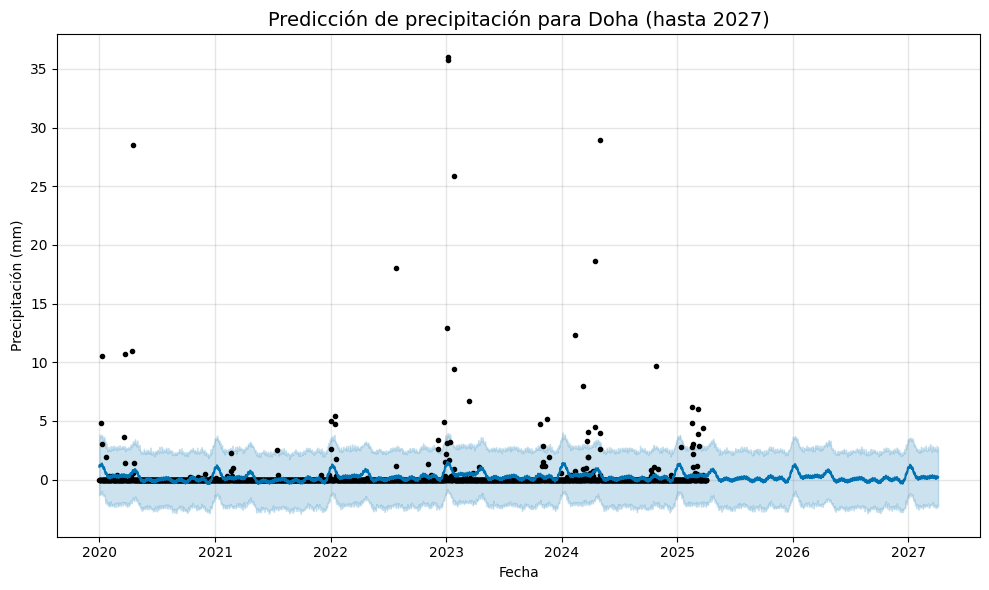

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpljcpx5kz/tu3ik8tk.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpljcpx5kz/z8znpm_i.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=84259', 'data', 'file=/tmp/tmpljcpx5kz/tu3ik8tk.json', 'init=/tmp/tmpljcpx5kz/z8znpm_i.json', 'output', 'file=/tmp/tmpljcpx5kz/prophet_modelsrqawl27/prophet_model-20250430191533.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
19:15:33 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing



===== Dubai =====


19:15:34 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


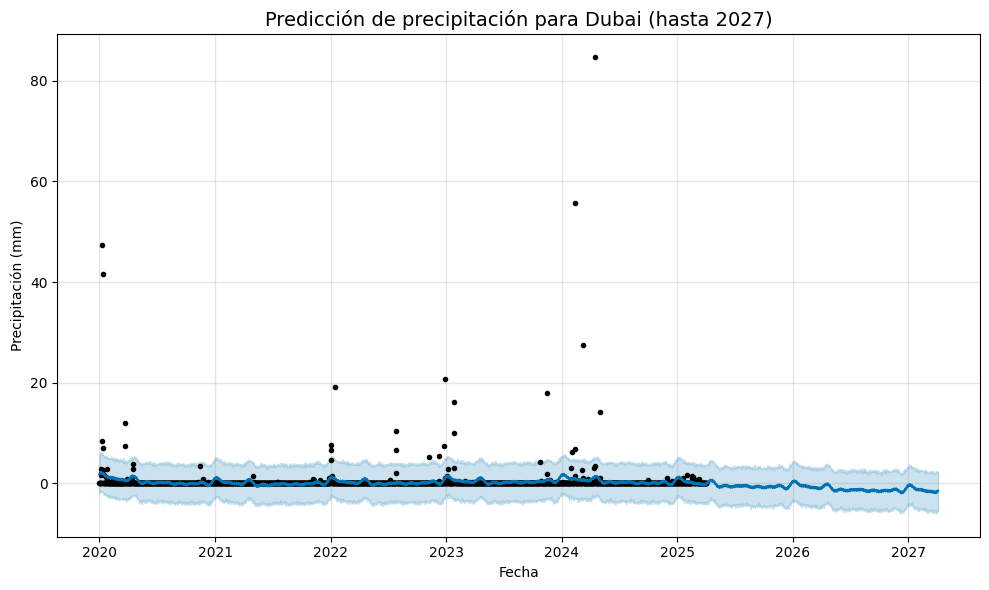

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpljcpx5kz/5xnbfrv9.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpljcpx5kz/w2n8wdk1.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=84350', 'data', 'file=/tmp/tmpljcpx5kz/5xnbfrv9.json', 'init=/tmp/tmpljcpx5kz/w2n8wdk1.json', 'output', 'file=/tmp/tmpljcpx5kz/prophet_modelntczge9b/prophet_model-20250430191534.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
19:15:34 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing



===== Kuwait City =====


19:15:35 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


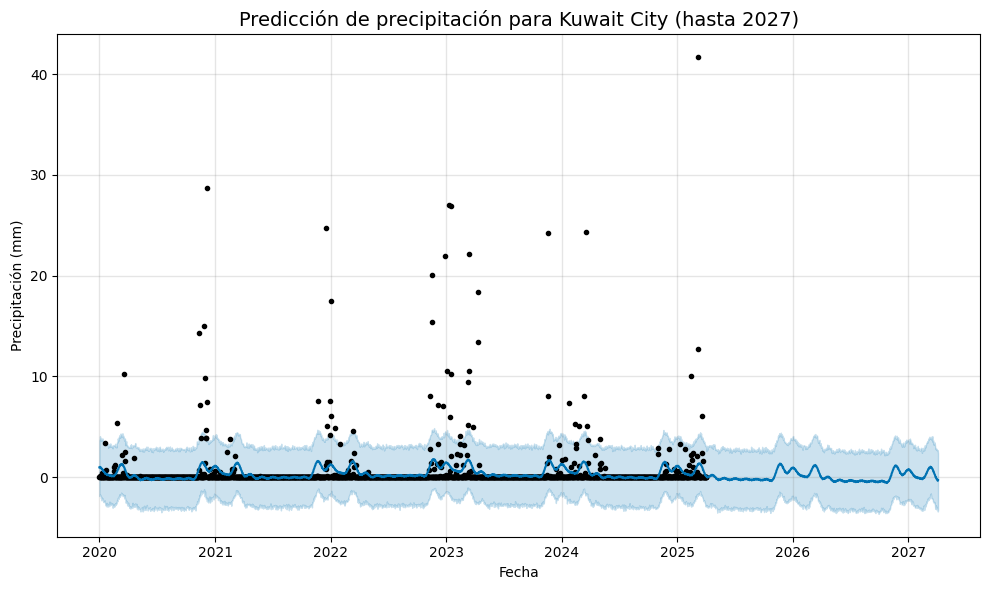

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpljcpx5kz/5tmbrkpc.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpljcpx5kz/4zbxyy5e.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=50097', 'data', 'file=/tmp/tmpljcpx5kz/5tmbrkpc.json', 'init=/tmp/tmpljcpx5kz/4zbxyy5e.json', 'output', 'file=/tmp/tmpljcpx5kz/prophet_modelth_mdyos/prophet_model-20250430191535.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
19:15:35 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
19:15:35 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing



===== Muscat =====


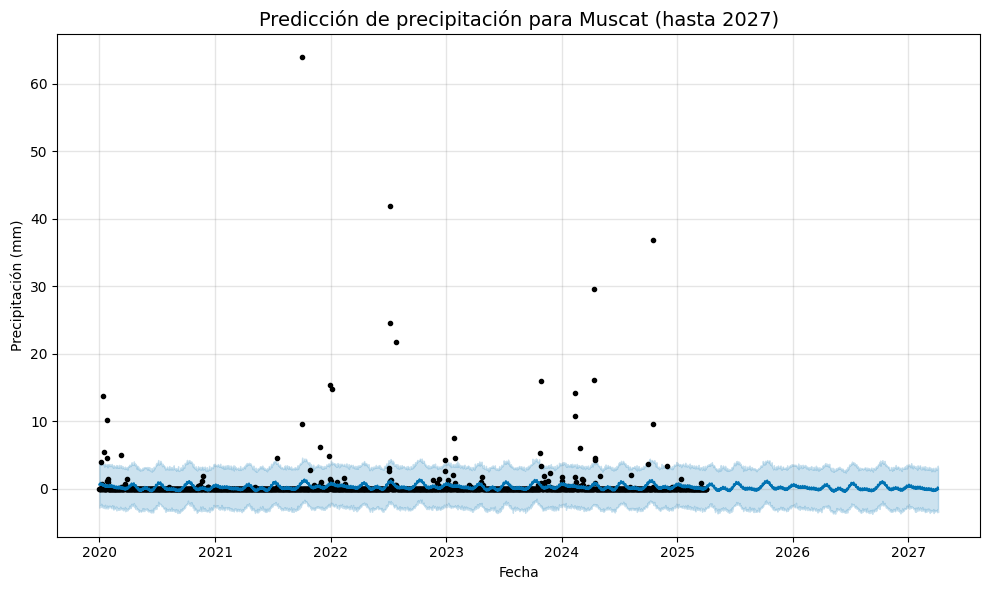

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpljcpx5kz/agqhwli5.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpljcpx5kz/8kypg7cm.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=88166', 'data', 'file=/tmp/tmpljcpx5kz/agqhwli5.json', 'init=/tmp/tmpljcpx5kz/8kypg7cm.json', 'output', 'file=/tmp/tmpljcpx5kz/prophet_model3xmmbqd1/prophet_model-20250430191536.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
19:15:36 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
19:15:36 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing



===== Rio de Janeiro =====


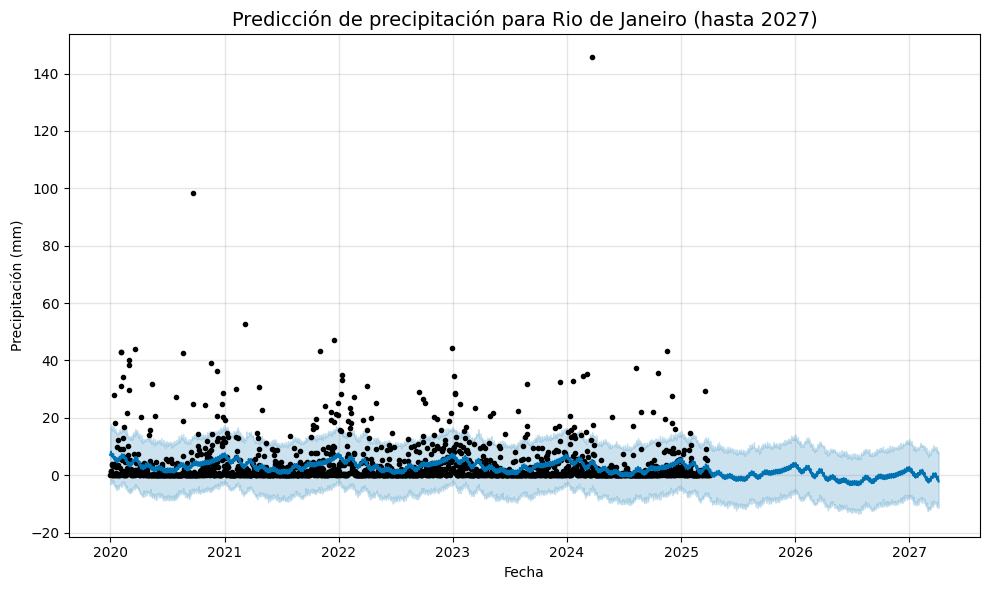

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpljcpx5kz/quv5acnl.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpljcpx5kz/a4ef0f0w.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=10150', 'data', 'file=/tmp/tmpljcpx5kz/quv5acnl.json', 'init=/tmp/tmpljcpx5kz/a4ef0f0w.json', 'output', 'file=/tmp/tmpljcpx5kz/prophet_model6bq0ppuk/prophet_model-20250430191537.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
19:15:37 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing



===== Riyadh =====


19:15:37 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


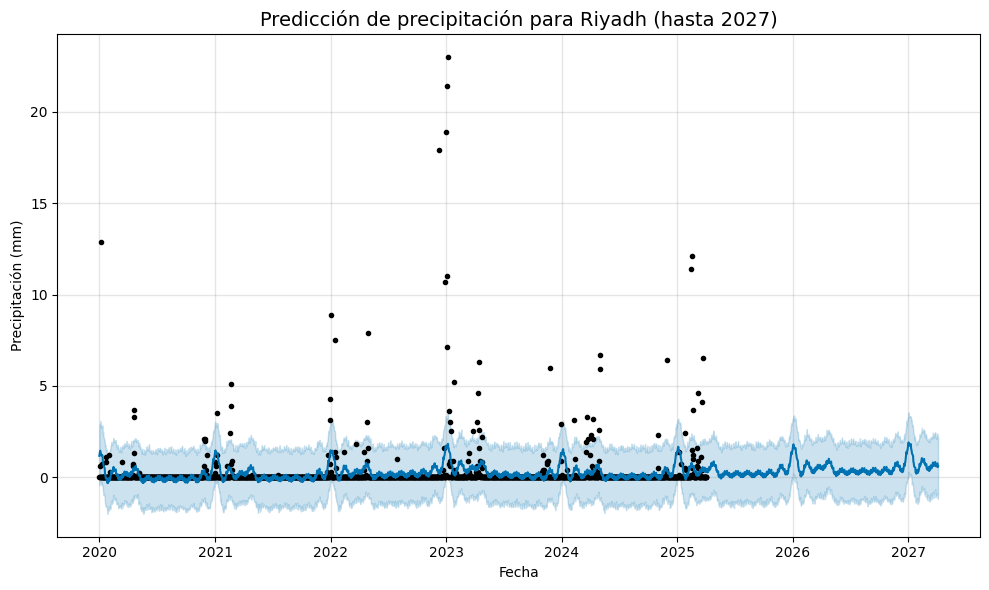

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpljcpx5kz/_cak1e_z.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpljcpx5kz/kgizgdg2.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=6979', 'data', 'file=/tmp/tmpljcpx5kz/_cak1e_z.json', 'init=/tmp/tmpljcpx5kz/kgizgdg2.json', 'output', 'file=/tmp/tmpljcpx5kz/prophet_modelp5axzt17/prophet_model-20250430191537.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
19:15:37 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
19:15:37 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing



===== San Diego =====


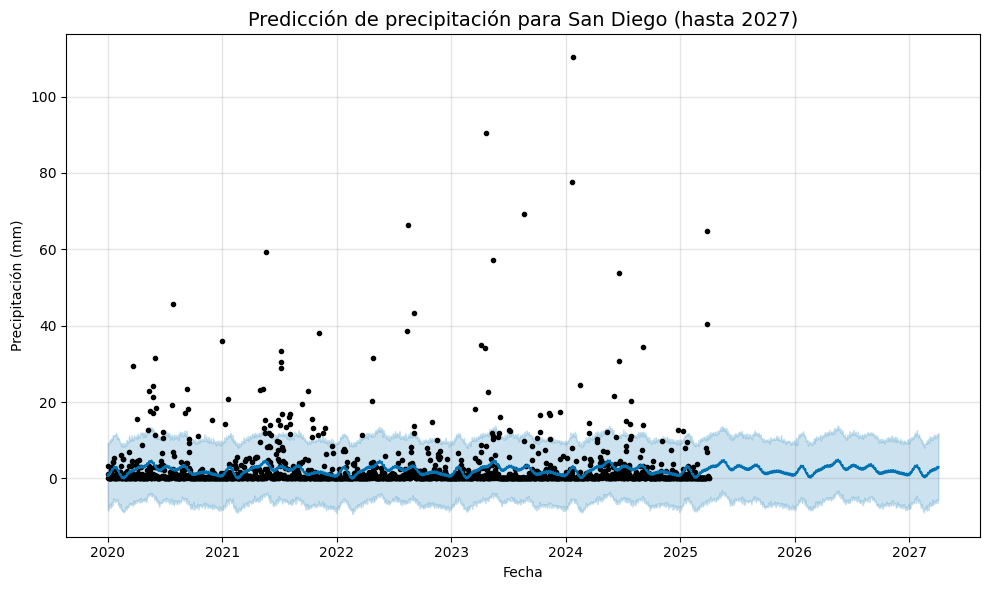

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpljcpx5kz/_okcge7z.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpljcpx5kz/dg1ax90g.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=5566', 'data', 'file=/tmp/tmpljcpx5kz/_okcge7z.json', 'init=/tmp/tmpljcpx5kz/dg1ax90g.json', 'output', 'file=/tmp/tmpljcpx5kz/prophet_model6444yvob/prophet_model-20250430191538.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
19:15:38 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
19:15:38 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing



===== Singapore =====


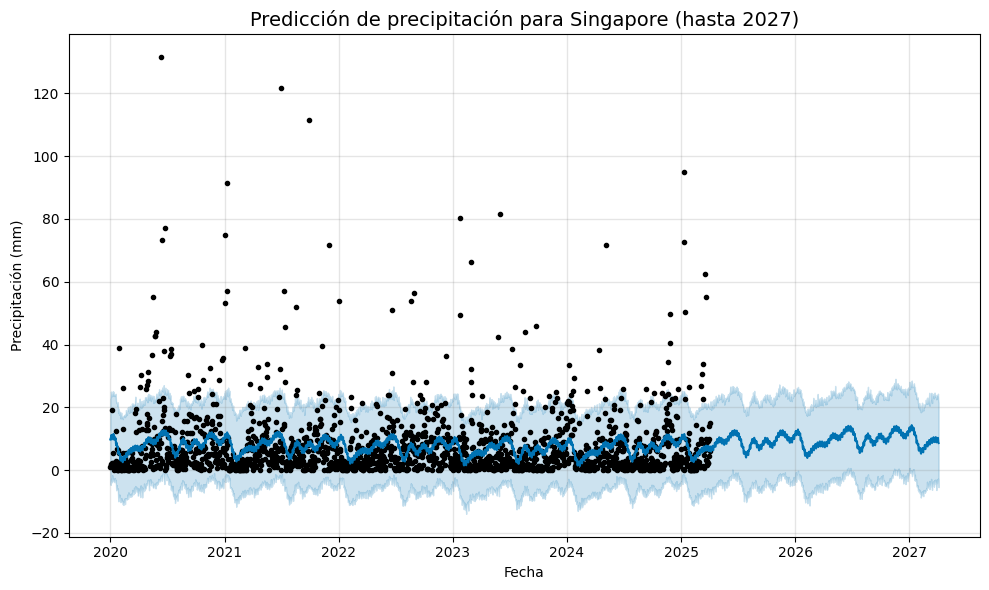

In [96]:
from prophet import Prophet
import matplotlib.pyplot as plt
import pandas as pd

# Asegúrate de que datetime es datetime
df_filtrado['datetime'] = pd.to_datetime(df_filtrado['datetime'])

for city in ciudades:
    print(f"\n===== {city} =====")

    # Filtrar datos hasta 2025 inclusive
    df_ciudad = df_filtrado[
        (df_filtrado['city_name'] == city) &
        (df_filtrado['datetime'].dt.year <= 2025)
    ][['datetime', 'precipitation_sum']].copy()

    # Renombrar columnas para Prophet
    df_ciudad = df_ciudad.rename(columns={'datetime': 'ds', 'precipitation_sum': 'y'})

    # Entrenar el modelo
    modelo = Prophet()
    modelo.fit(df_ciudad)

    # Crear fechas futuras (730 días ≈ 2 años)
    future = modelo.make_future_dataframe(periods=730)
    forecast = modelo.predict(future)

    # Filtrar solo los años futuros para graficar si quieres
    forecast_future = forecast[forecast['ds'].dt.year > 2025]

    # Graficar todo (pasado + futuro)
    fig = modelo.plot(forecast)
    plt.title(f'Predicción de precipitación para {city} (hasta 2027)', fontsize=14)
    plt.xlabel('Fecha')
    plt.ylabel('Precipitación (mm)')
    plt.grid(True)
    plt.tight_layout()
    plt.show()


#Ciudades con menor promedio de temperatura

##¿Cómo varían las diferentes variables de temperatura (máxima, mínima, media, aparente) a lo largo del año en las ciudades más frias?

In [97]:
import plotly.graph_objects as go
from plotly.subplots import make_subplots

# Filtrar por año
df_filtrado_frio = df_filtrado_frio[df_filtrado_frio['año'].between(2020, 2025)]

# Obtener ciudades del dataframe filtrado
ciudades_frio = df_filtrado_frio['city_name'].unique()

# Iterar sobre cada ciudad
for city in ciudades_frio:
    print(f"\n===== {city} =====")

    # Filtrar datos para la ciudad
    df_ciudad_frio = df_filtrado_frio[df_filtrado_frio['city_name'] == city]

    # Agrupar por año y calcular promedios
    promedio_anual_calor = df_ciudad_frio.groupby('año')['temperature_2m_max'].mean()
    promedio_total_calor = promedio_anual_calor.mean()

    promedio_anual_frio = df_ciudad_frio.groupby('año')['temperature_2m_min'].mean()
    promedio_total_frio = promedio_anual_frio.mean()

    promedio_anual_medio = df_ciudad_frio.groupby('año')['temperature_2m_mean'].mean()
    promedio_total_medio = promedio_anual_medio.mean()

    promedio_anual_aparente = df_ciudad_frio.groupby('año')['apparent_temperature_mean'].mean()
    promedio_total_aparente = promedio_anual_aparente.mean()

    promedio_anual_amplitud = df_ciudad_frio.groupby('año')['amplitud_termica'].mean()
    promedio_total_amplitud = promedio_anual_amplitud.mean()

    # Crear gráfico de barras
    fig_subplots = make_subplots(
        rows=2, cols=3,
        subplot_titles=[
            "Promedio de calor por año",
            "Promedio de frío por año",
            "Promedio de temperatura media por año",
            "Temperatura aparente por año",
            "Amplitud térmica por año"
        ]
    )

    fig_subplots.add_trace(go.Bar(x=promedio_anual_calor.index, y=promedio_anual_calor, name="Temp. Máxima"), row=1, col=1)
    fig_subplots.add_trace(go.Bar(x=promedio_anual_frio.index, y=promedio_anual_frio, name="Temp. Mínima"), row=1, col=2)
    fig_subplots.add_trace(go.Bar(x=promedio_anual_medio.index, y=promedio_anual_medio, name="Temp. Media"), row=1, col=3)
    fig_subplots.add_trace(go.Bar(x=promedio_anual_aparente.index, y=promedio_anual_aparente, name="Temp. Aparente"), row=2, col=1)
    fig_subplots.add_trace(go.Bar(x=promedio_anual_amplitud.index, y=promedio_anual_amplitud, name="Amplitud Térmica"), row=2, col=2)

    fig_subplots.update_layout(height=700, width=1900, title_text=f"Promedios de temperatura en {city} (2020-2025)")
    fig_subplots.show()

    # Mostrar promedios en consola
    print(f"Promedio de temperatura máxima (2020–2025): {promedio_total_calor:.2f} °C")
    print(f"Promedio de temperatura mínima (2020–2025): {promedio_total_frio:.2f} °C")
    print(f"Promedio de temperatura media (2020–2025): {promedio_total_medio:.2f} °C")
    print(f"Promedio de temperatura aparente (2020–2025): {promedio_total_aparente:.2f} °C")
    print(f"Promedio de amplitud térmica (2020–2025): {promedio_total_amplitud:.2f} °C")


===== Calgary =====


Promedio de temperatura máxima (2020–2025): 9.51 °C
Promedio de temperatura mínima (2020–2025): -1.89 °C
Promedio de temperatura media (2020–2025): 3.15 °C
Promedio de temperatura aparente (2020–2025): -0.57 °C
Promedio de amplitud térmica (2020–2025): 11.41 °C

===== Helsinki =====


Promedio de temperatura máxima (2020–2025): 7.37 °C
Promedio de temperatura mínima (2020–2025): 3.95 °C
Promedio de temperatura media (2020–2025): 5.76 °C
Promedio de temperatura aparente (2020–2025): 1.46 °C
Promedio de amplitud térmica (2020–2025): 3.42 °C

===== Las Vegas =====


Promedio de temperatura máxima (2020–2025): 17.79 °C
Promedio de temperatura mínima (2020–2025): 2.40 °C
Promedio de temperatura media (2020–2025): 9.52 °C
Promedio de temperatura aparente (2020–2025): 5.56 °C
Promedio de amplitud térmica (2020–2025): 15.39 °C

===== Minsk =====


Promedio de temperatura máxima (2020–2025): 10.20 °C
Promedio de temperatura mínima (2020–2025): 3.08 °C
Promedio de temperatura media (2020–2025): 6.72 °C
Promedio de temperatura aparente (2020–2025): 3.37 °C
Promedio de amplitud térmica (2020–2025): 7.12 °C

===== Montreal =====


Promedio de temperatura máxima (2020–2025): 10.49 °C
Promedio de temperatura mínima (2020–2025): 1.94 °C
Promedio de temperatura media (2020–2025): 5.84 °C
Promedio de temperatura aparente (2020–2025): 2.82 °C
Promedio de amplitud térmica (2020–2025): 8.55 °C

===== Oslo =====


Promedio de temperatura máxima (2020–2025): 9.35 °C
Promedio de temperatura mínima (2020–2025): 2.52 °C
Promedio de temperatura media (2020–2025): 5.96 °C
Promedio de temperatura aparente (2020–2025): 3.20 °C
Promedio de amplitud térmica (2020–2025): 6.83 °C

===== Ottawa =====


Promedio de temperatura máxima (2020–2025): 10.76 °C
Promedio de temperatura mínima (2020–2025): 1.41 °C
Promedio de temperatura media (2020–2025): 5.67 °C
Promedio de temperatura aparente (2020–2025): 2.82 °C
Promedio de amplitud térmica (2020–2025): 9.35 °C

===== Sapporo =====


Promedio de temperatura máxima (2020–2025): 10.74 °C
Promedio de temperatura mínima (2020–2025): 2.59 °C
Promedio de temperatura media (2020–2025): 6.52 °C
Promedio de temperatura aparente (2020–2025): 3.84 °C
Promedio de amplitud térmica (2020–2025): 8.15 °C

===== Stockholm =====


Promedio de temperatura máxima (2020–2025): 10.13 °C
Promedio de temperatura mínima (2020–2025): 3.13 °C
Promedio de temperatura media (2020–2025): 6.69 °C
Promedio de temperatura aparente (2020–2025): 3.60 °C
Promedio de amplitud térmica (2020–2025): 6.99 °C

===== Toronto =====


Promedio de temperatura máxima (2020–2025): 11.26 °C
Promedio de temperatura mínima (2020–2025): 3.63 °C
Promedio de temperatura media (2020–2025): 7.27 °C
Promedio de temperatura aparente (2020–2025): 4.18 °C
Promedio de amplitud térmica (2020–2025): 7.63 °C


##¿Cuáles son los meses con mayor y menor temperatura en estas ciudades?


===== Calgary =====


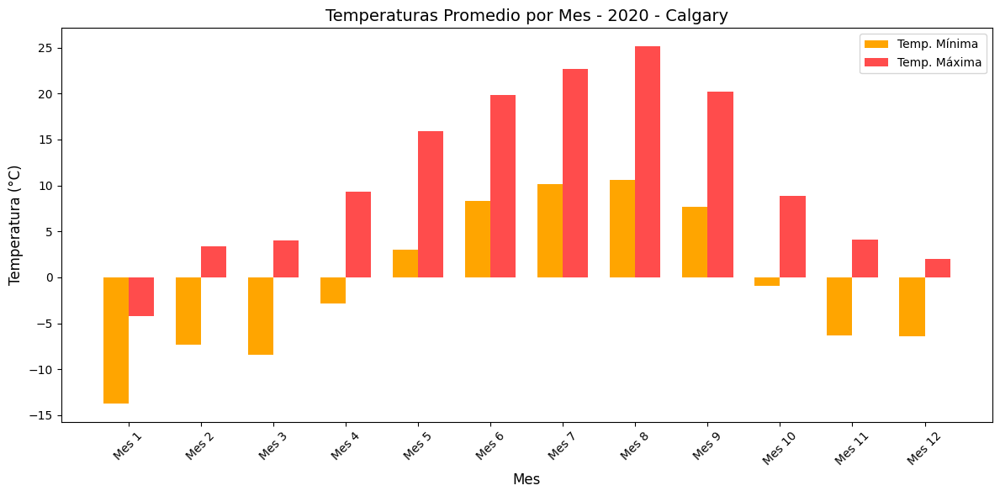


Top 3 meses más calurosos (Temp. máxima promedio más alta):
  Mes 8: 25.18 °C
  Mes 7: 22.72 °C
  Mes 9: 20.23 °C

Top 3 meses más fríos (Temp. mínima promedio más baja):
  Mes 1: -13.76 °C
  Mes 3: -8.45 °C
  Mes 2: -7.36 °C


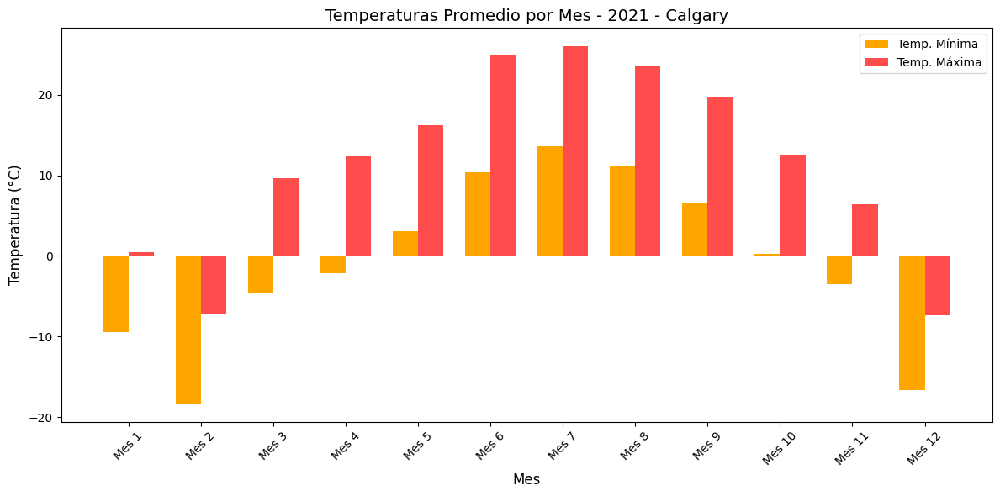


Top 3 meses más calurosos (Temp. máxima promedio más alta):
  Mes 7: 26.07 °C
  Mes 6: 25.02 °C
  Mes 8: 23.52 °C

Top 3 meses más fríos (Temp. mínima promedio más baja):
  Mes 2: -18.35 °C
  Mes 12: -16.66 °C
  Mes 1: -9.50 °C


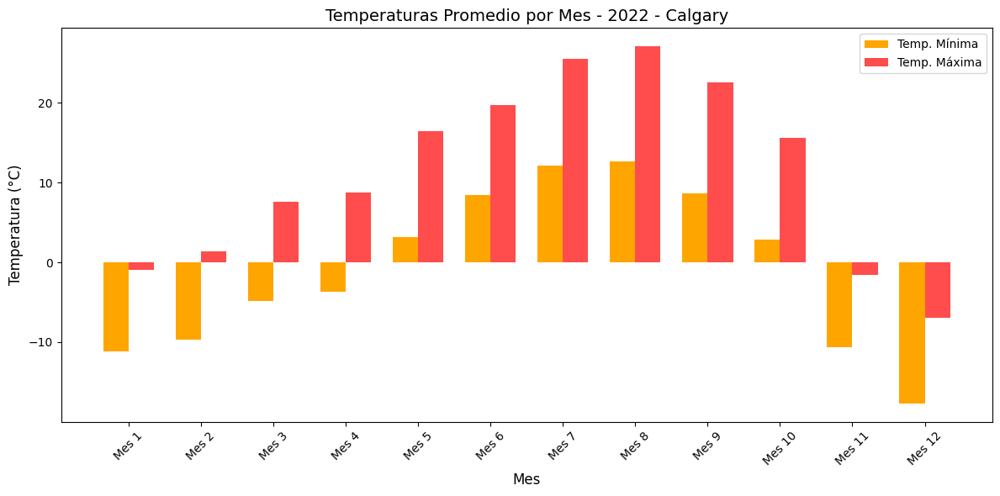


Top 3 meses más calurosos (Temp. máxima promedio más alta):
  Mes 8: 27.13 °C
  Mes 7: 25.55 °C
  Mes 9: 22.52 °C

Top 3 meses más fríos (Temp. mínima promedio más baja):
  Mes 12: -17.73 °C
  Mes 1: -11.18 °C
  Mes 11: -10.67 °C


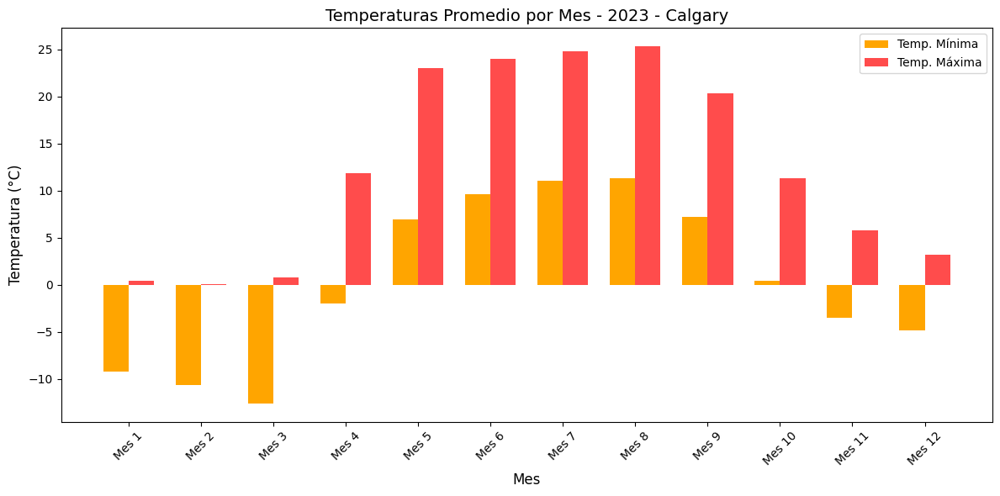


Top 3 meses más calurosos (Temp. máxima promedio más alta):
  Mes 8: 25.37 °C
  Mes 7: 24.76 °C
  Mes 6: 23.98 °C

Top 3 meses más fríos (Temp. mínima promedio más baja):
  Mes 3: -12.66 °C
  Mes 2: -10.70 °C
  Mes 1: -9.23 °C


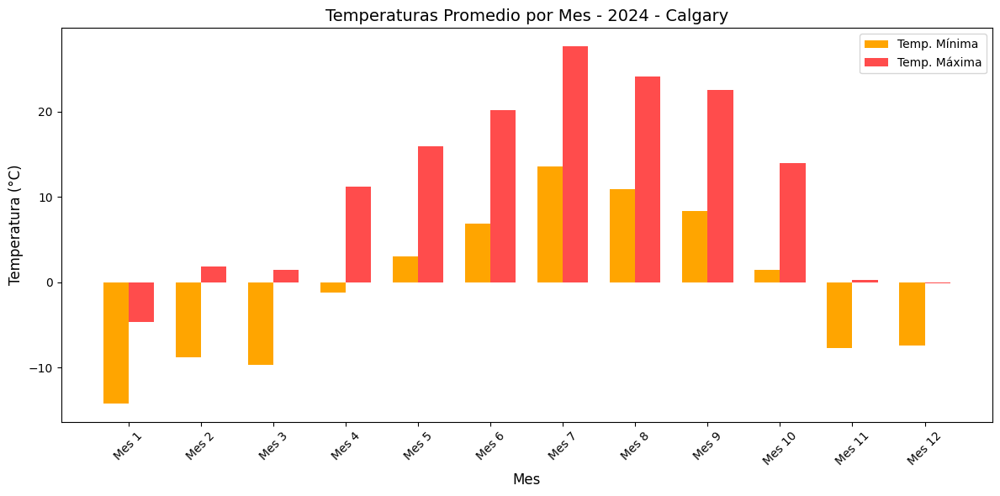


Top 3 meses más calurosos (Temp. máxima promedio más alta):
  Mes 7: 27.68 °C
  Mes 8: 24.10 °C
  Mes 9: 22.49 °C

Top 3 meses más fríos (Temp. mínima promedio más baja):
  Mes 1: -14.22 °C
  Mes 3: -9.61 °C
  Mes 2: -8.75 °C


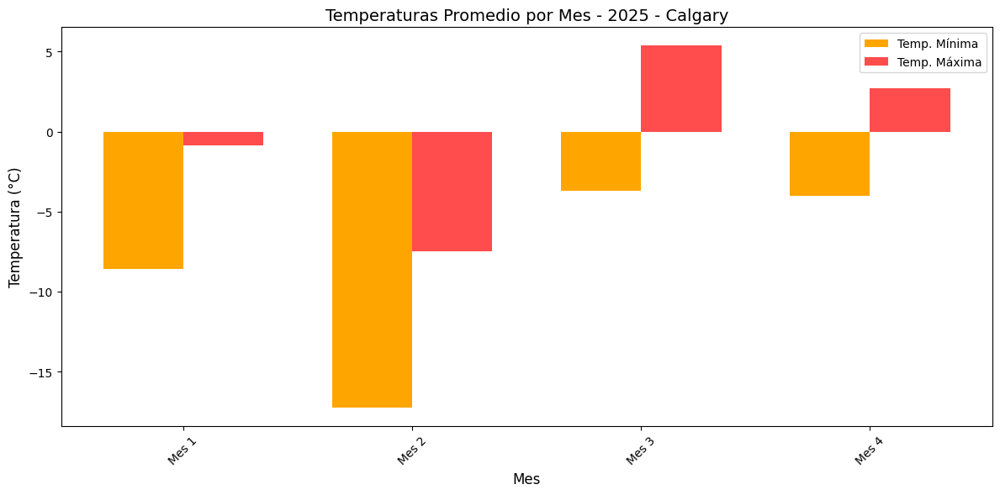


Top 3 meses más calurosos (Temp. máxima promedio más alta):
  Mes 3: 5.40 °C
  Mes 4: 2.70 °C
  Mes 1: -0.88 °C

Top 3 meses más fríos (Temp. mínima promedio más baja):
  Mes 2: -17.27 °C
  Mes 1: -8.60 °C
  Mes 4: -4.03 °C

===== Helsinki =====


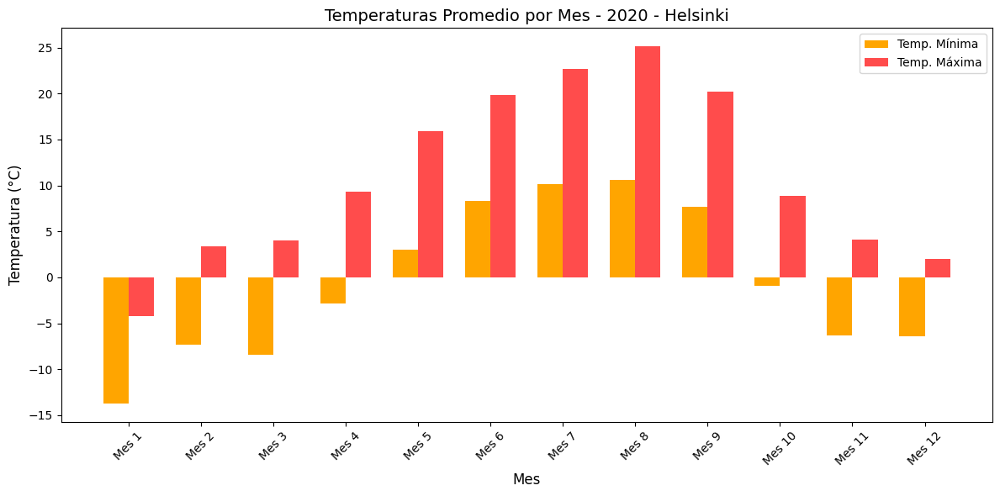


Top 3 meses más calurosos (Temp. máxima promedio más alta):
  Mes 8: 25.18 °C
  Mes 7: 22.72 °C
  Mes 9: 20.23 °C

Top 3 meses más fríos (Temp. mínima promedio más baja):
  Mes 1: -13.76 °C
  Mes 3: -8.45 °C
  Mes 2: -7.36 °C


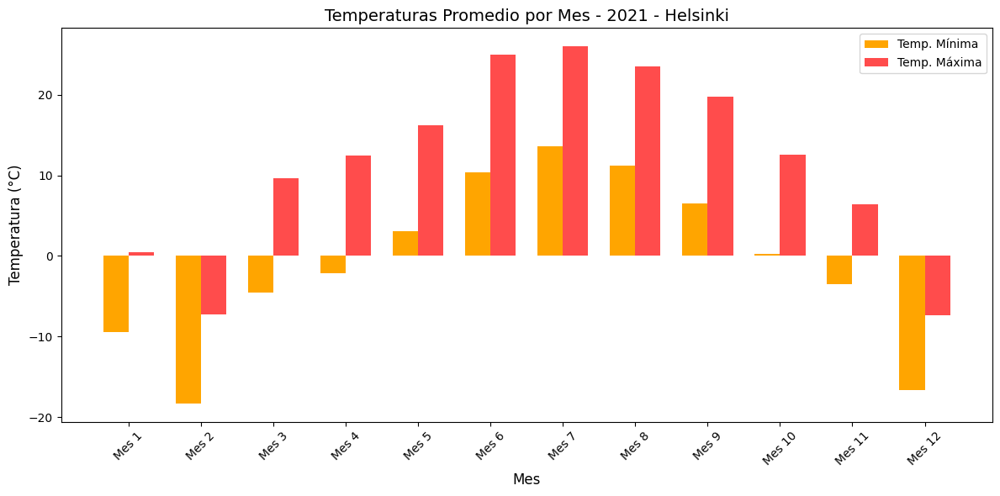


Top 3 meses más calurosos (Temp. máxima promedio más alta):
  Mes 7: 26.07 °C
  Mes 6: 25.02 °C
  Mes 8: 23.52 °C

Top 3 meses más fríos (Temp. mínima promedio más baja):
  Mes 2: -18.35 °C
  Mes 12: -16.66 °C
  Mes 1: -9.50 °C


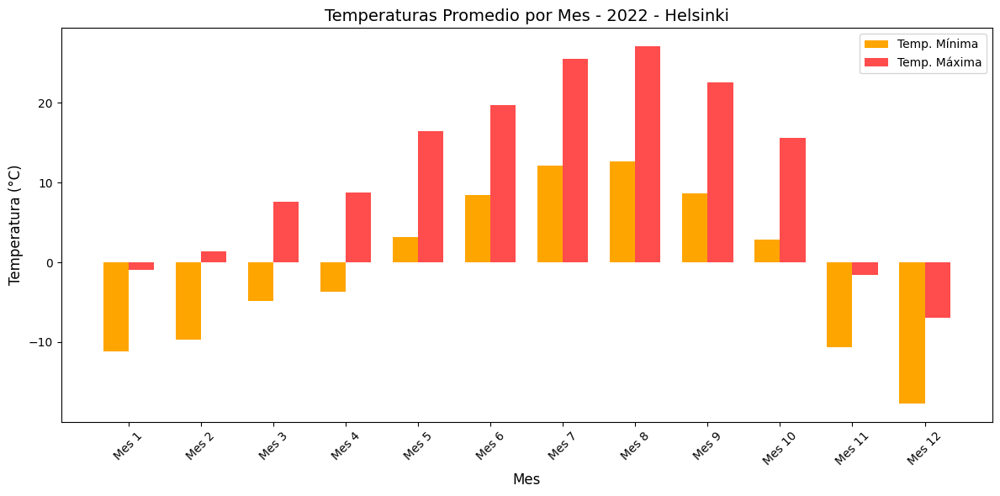


Top 3 meses más calurosos (Temp. máxima promedio más alta):
  Mes 8: 27.13 °C
  Mes 7: 25.55 °C
  Mes 9: 22.52 °C

Top 3 meses más fríos (Temp. mínima promedio más baja):
  Mes 12: -17.73 °C
  Mes 1: -11.18 °C
  Mes 11: -10.67 °C


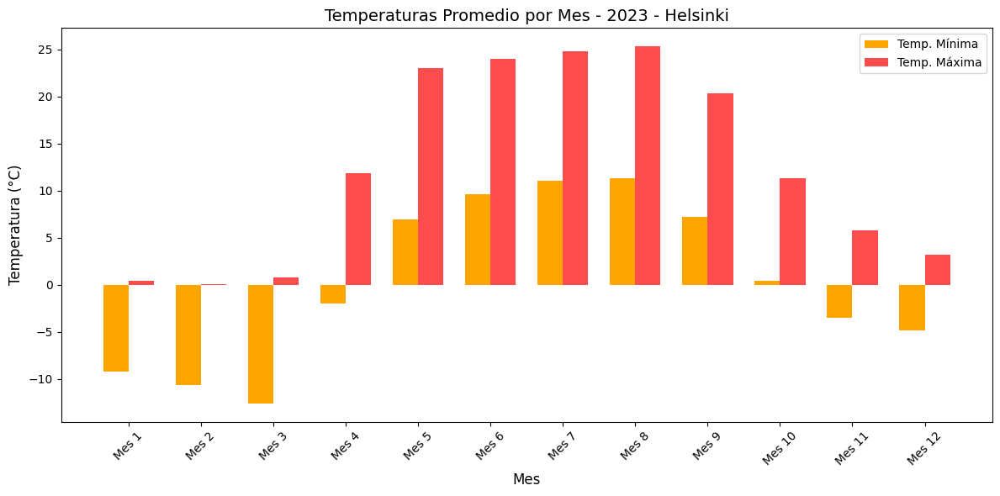


Top 3 meses más calurosos (Temp. máxima promedio más alta):
  Mes 8: 25.37 °C
  Mes 7: 24.76 °C
  Mes 6: 23.98 °C

Top 3 meses más fríos (Temp. mínima promedio más baja):
  Mes 3: -12.66 °C
  Mes 2: -10.70 °C
  Mes 1: -9.23 °C


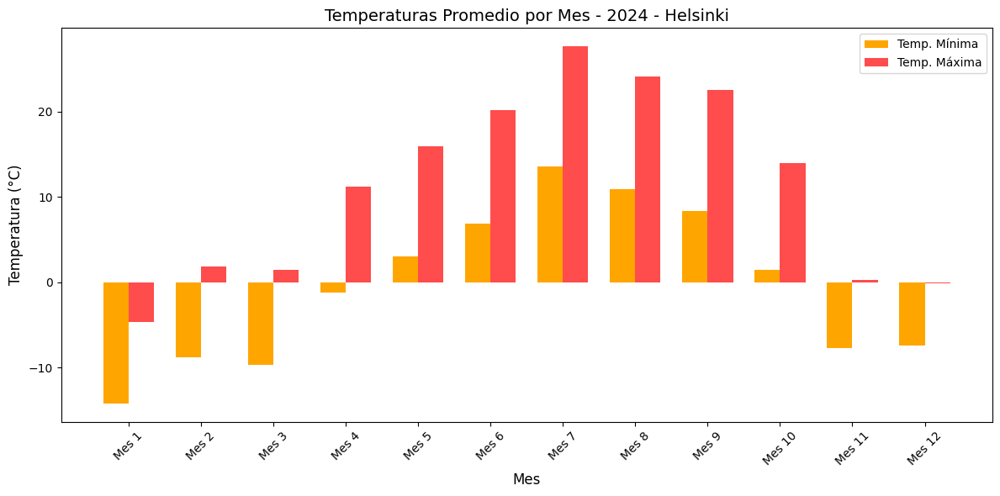


Top 3 meses más calurosos (Temp. máxima promedio más alta):
  Mes 7: 27.68 °C
  Mes 8: 24.10 °C
  Mes 9: 22.49 °C

Top 3 meses más fríos (Temp. mínima promedio más baja):
  Mes 1: -14.22 °C
  Mes 3: -9.61 °C
  Mes 2: -8.75 °C


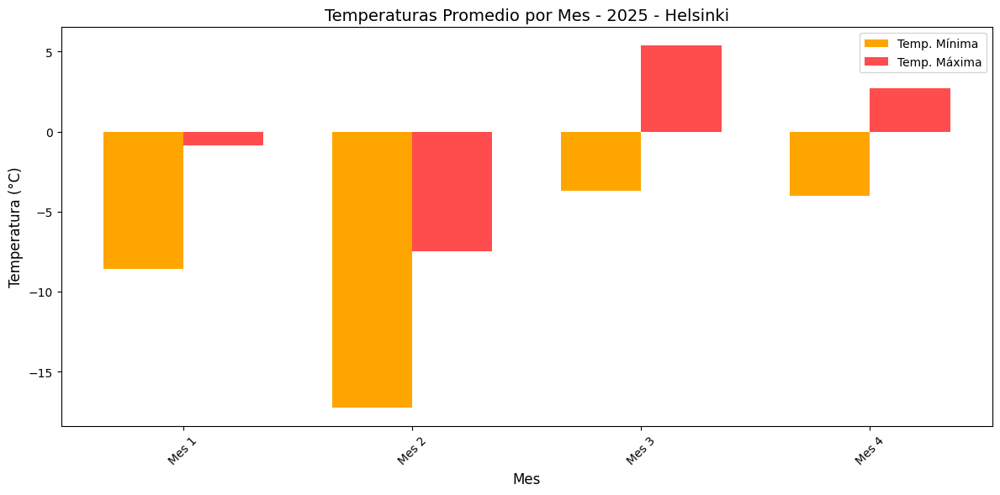


Top 3 meses más calurosos (Temp. máxima promedio más alta):
  Mes 3: 5.40 °C
  Mes 4: 2.70 °C
  Mes 1: -0.88 °C

Top 3 meses más fríos (Temp. mínima promedio más baja):
  Mes 2: -17.27 °C
  Mes 1: -8.60 °C
  Mes 4: -4.03 °C

===== Las Vegas =====


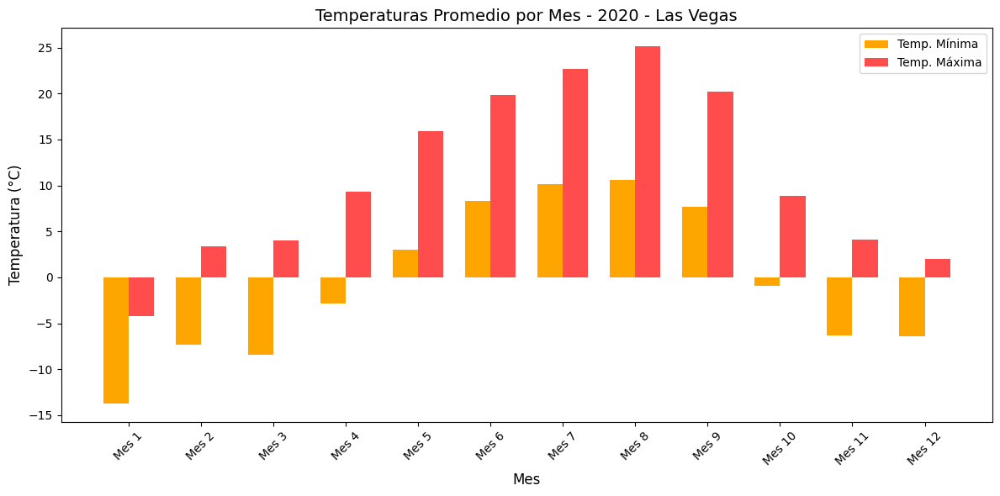


Top 3 meses más calurosos (Temp. máxima promedio más alta):
  Mes 8: 25.18 °C
  Mes 7: 22.72 °C
  Mes 9: 20.23 °C

Top 3 meses más fríos (Temp. mínima promedio más baja):
  Mes 1: -13.76 °C
  Mes 3: -8.45 °C
  Mes 2: -7.36 °C


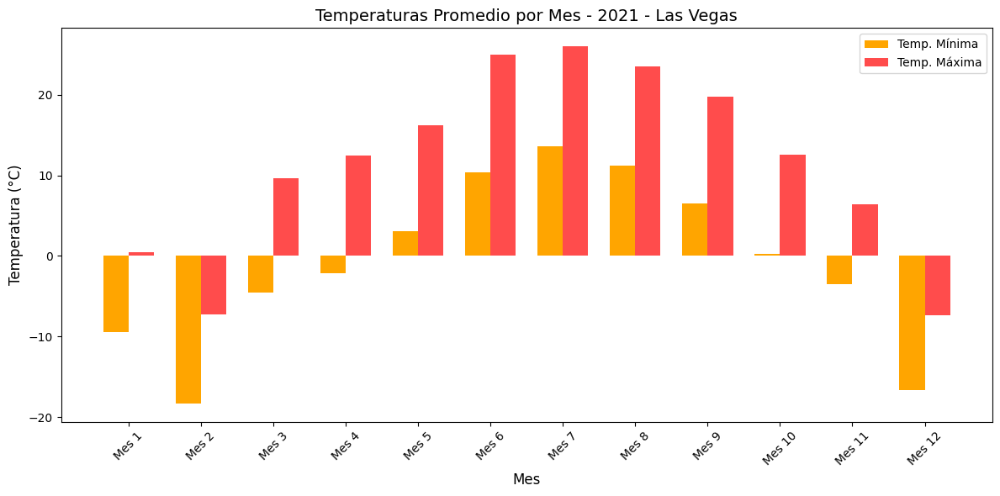


Top 3 meses más calurosos (Temp. máxima promedio más alta):
  Mes 7: 26.07 °C
  Mes 6: 25.02 °C
  Mes 8: 23.52 °C

Top 3 meses más fríos (Temp. mínima promedio más baja):
  Mes 2: -18.35 °C
  Mes 12: -16.66 °C
  Mes 1: -9.50 °C


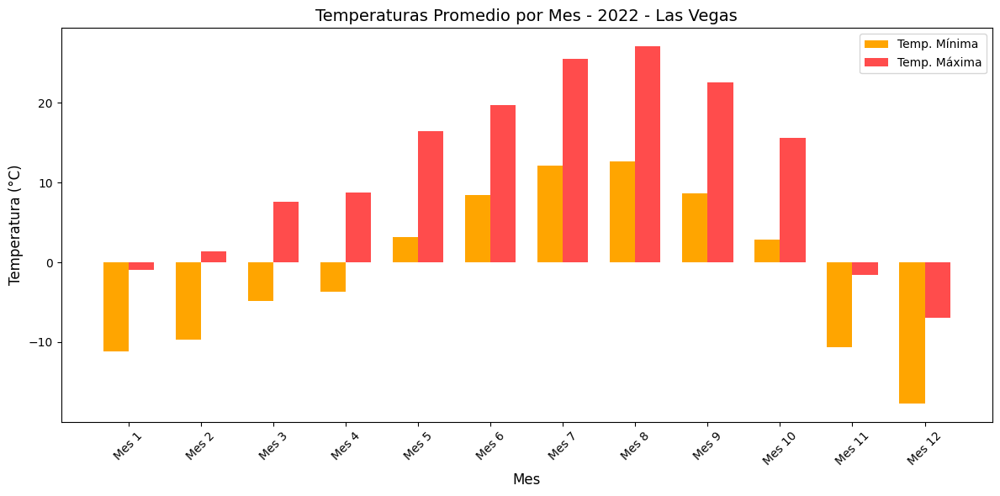


Top 3 meses más calurosos (Temp. máxima promedio más alta):
  Mes 8: 27.13 °C
  Mes 7: 25.55 °C
  Mes 9: 22.52 °C

Top 3 meses más fríos (Temp. mínima promedio más baja):
  Mes 12: -17.73 °C
  Mes 1: -11.18 °C
  Mes 11: -10.67 °C


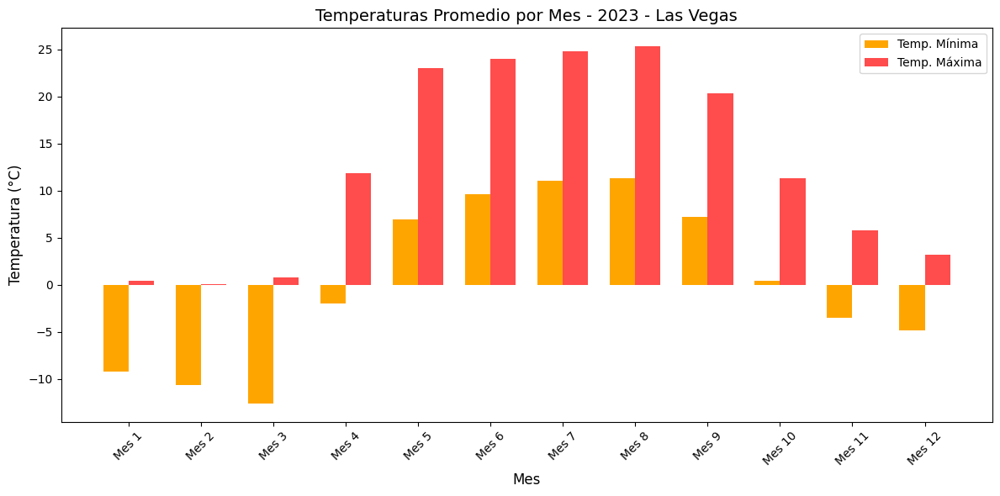


Top 3 meses más calurosos (Temp. máxima promedio más alta):
  Mes 8: 25.37 °C
  Mes 7: 24.76 °C
  Mes 6: 23.98 °C

Top 3 meses más fríos (Temp. mínima promedio más baja):
  Mes 3: -12.66 °C
  Mes 2: -10.70 °C
  Mes 1: -9.23 °C


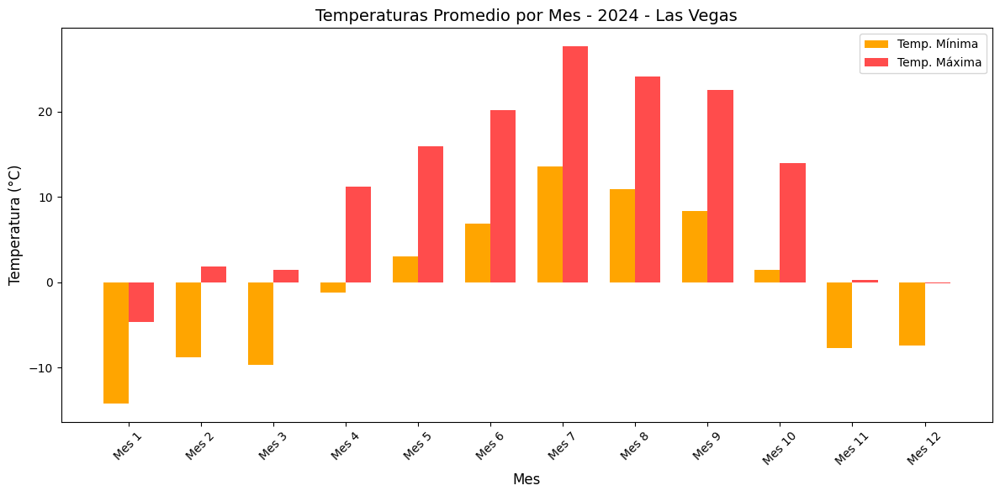


Top 3 meses más calurosos (Temp. máxima promedio más alta):
  Mes 7: 27.68 °C
  Mes 8: 24.10 °C
  Mes 9: 22.49 °C

Top 3 meses más fríos (Temp. mínima promedio más baja):
  Mes 1: -14.22 °C
  Mes 3: -9.61 °C
  Mes 2: -8.75 °C


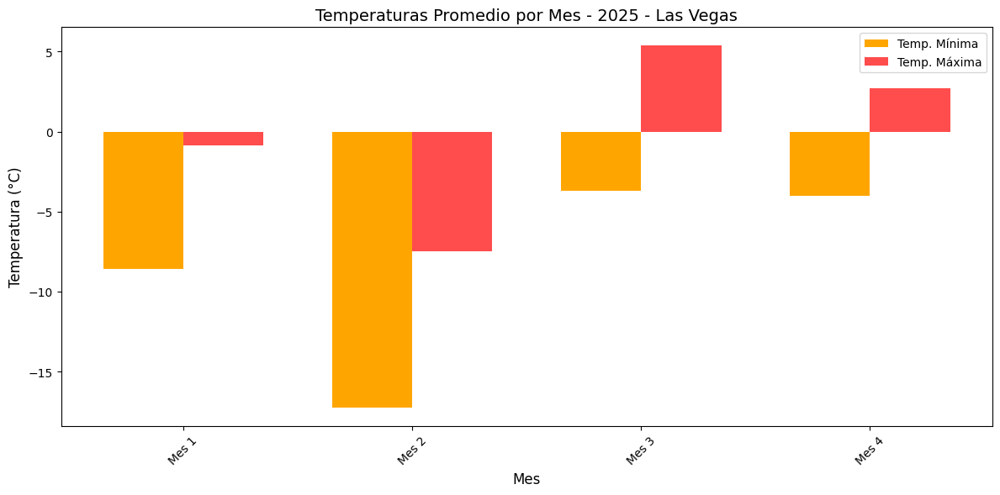


Top 3 meses más calurosos (Temp. máxima promedio más alta):
  Mes 3: 5.40 °C
  Mes 4: 2.70 °C
  Mes 1: -0.88 °C

Top 3 meses más fríos (Temp. mínima promedio más baja):
  Mes 2: -17.27 °C
  Mes 1: -8.60 °C
  Mes 4: -4.03 °C

===== Minsk =====


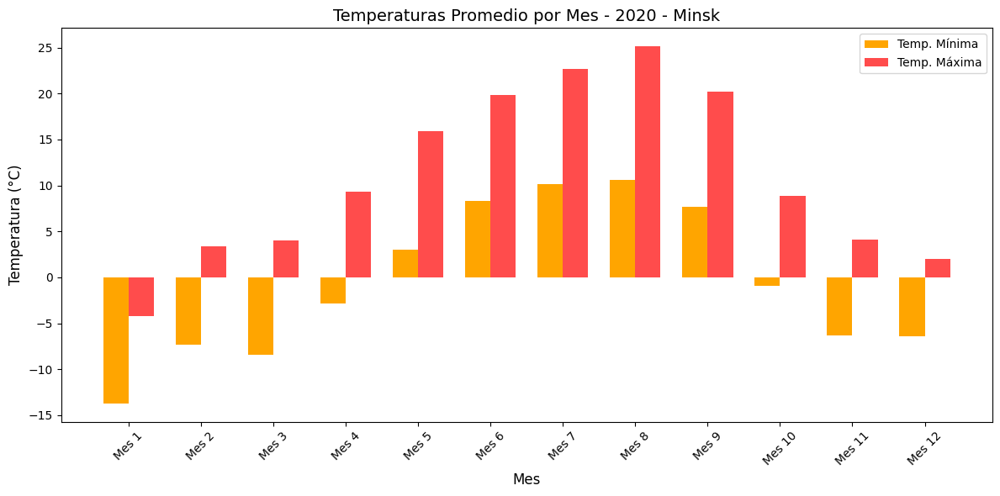


Top 3 meses más calurosos (Temp. máxima promedio más alta):
  Mes 8: 25.18 °C
  Mes 7: 22.72 °C
  Mes 9: 20.23 °C

Top 3 meses más fríos (Temp. mínima promedio más baja):
  Mes 1: -13.76 °C
  Mes 3: -8.45 °C
  Mes 2: -7.36 °C


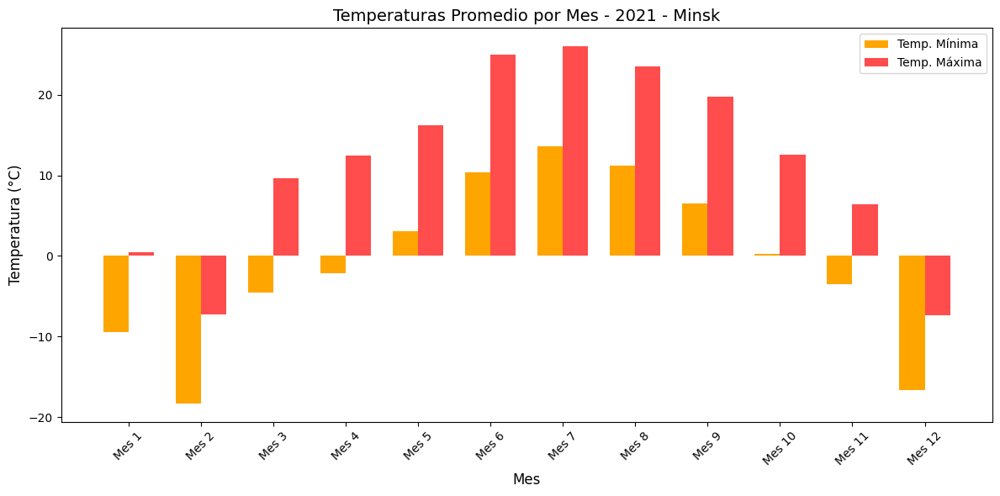


Top 3 meses más calurosos (Temp. máxima promedio más alta):
  Mes 7: 26.07 °C
  Mes 6: 25.02 °C
  Mes 8: 23.52 °C

Top 3 meses más fríos (Temp. mínima promedio más baja):
  Mes 2: -18.35 °C
  Mes 12: -16.66 °C
  Mes 1: -9.50 °C


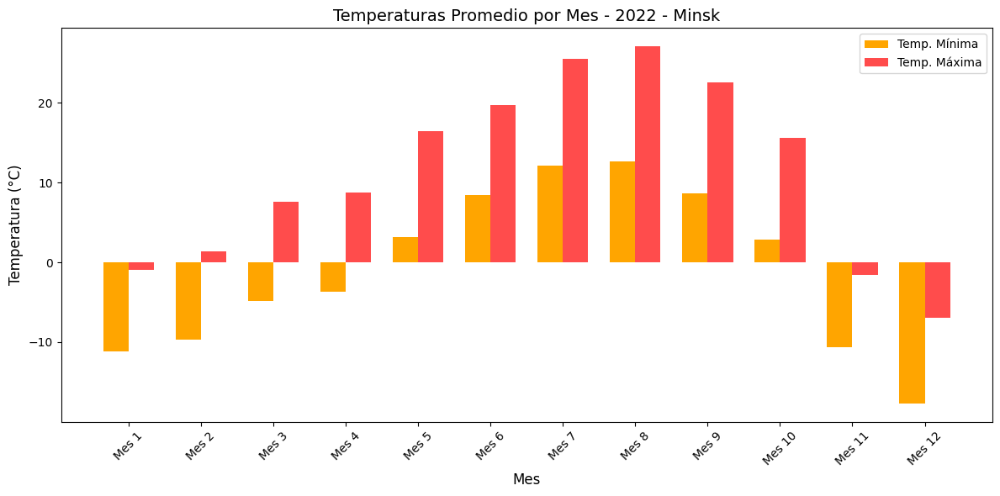


Top 3 meses más calurosos (Temp. máxima promedio más alta):
  Mes 8: 27.13 °C
  Mes 7: 25.55 °C
  Mes 9: 22.52 °C

Top 3 meses más fríos (Temp. mínima promedio más baja):
  Mes 12: -17.73 °C
  Mes 1: -11.18 °C
  Mes 11: -10.67 °C


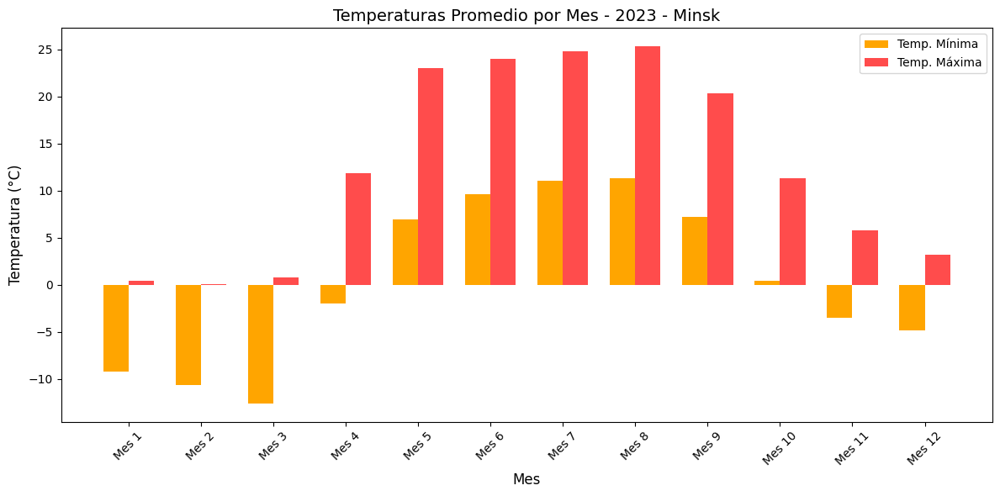


Top 3 meses más calurosos (Temp. máxima promedio más alta):
  Mes 8: 25.37 °C
  Mes 7: 24.76 °C
  Mes 6: 23.98 °C

Top 3 meses más fríos (Temp. mínima promedio más baja):
  Mes 3: -12.66 °C
  Mes 2: -10.70 °C
  Mes 1: -9.23 °C


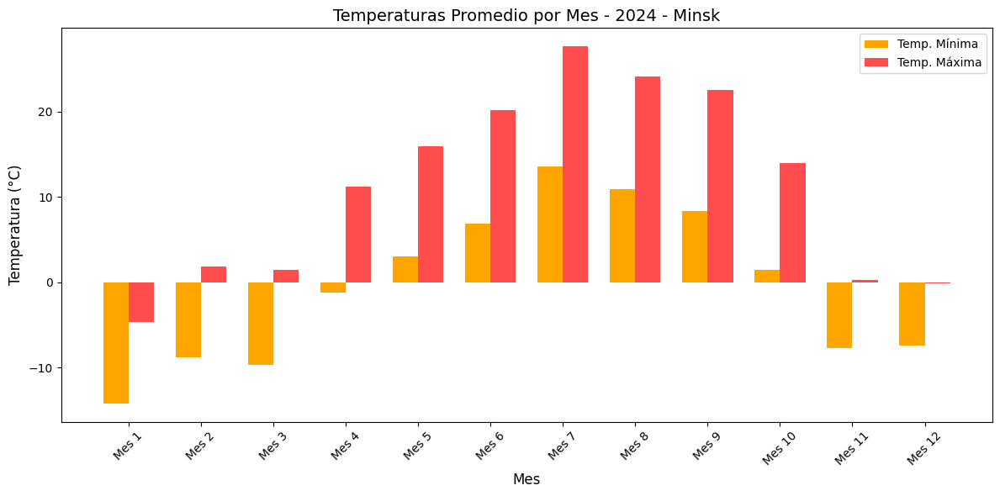


Top 3 meses más calurosos (Temp. máxima promedio más alta):
  Mes 7: 27.68 °C
  Mes 8: 24.10 °C
  Mes 9: 22.49 °C

Top 3 meses más fríos (Temp. mínima promedio más baja):
  Mes 1: -14.22 °C
  Mes 3: -9.61 °C
  Mes 2: -8.75 °C


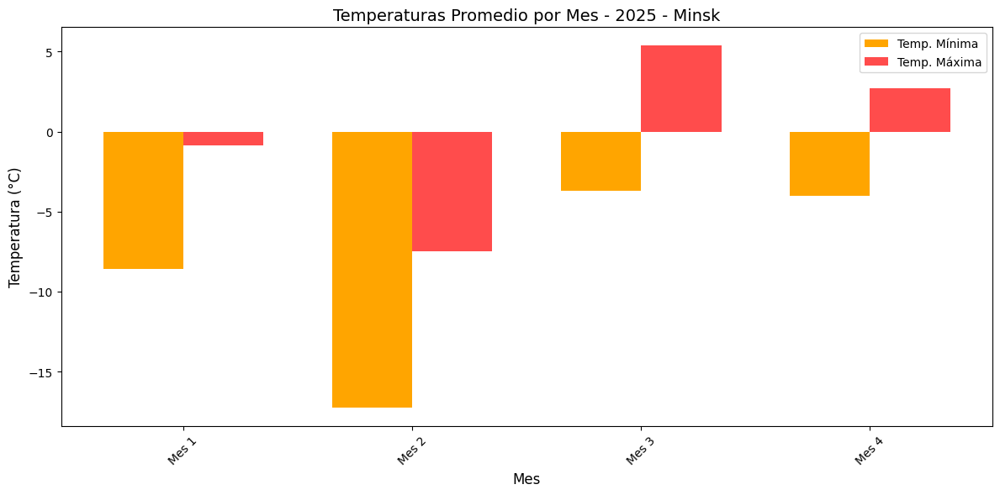


Top 3 meses más calurosos (Temp. máxima promedio más alta):
  Mes 3: 5.40 °C
  Mes 4: 2.70 °C
  Mes 1: -0.88 °C

Top 3 meses más fríos (Temp. mínima promedio más baja):
  Mes 2: -17.27 °C
  Mes 1: -8.60 °C
  Mes 4: -4.03 °C

===== Montreal =====


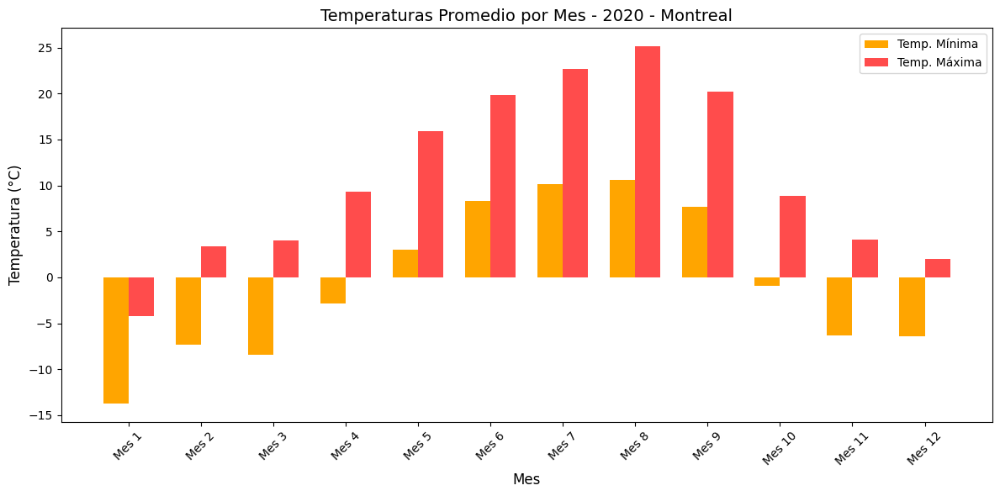


Top 3 meses más calurosos (Temp. máxima promedio más alta):
  Mes 8: 25.18 °C
  Mes 7: 22.72 °C
  Mes 9: 20.23 °C

Top 3 meses más fríos (Temp. mínima promedio más baja):
  Mes 1: -13.76 °C
  Mes 3: -8.45 °C
  Mes 2: -7.36 °C


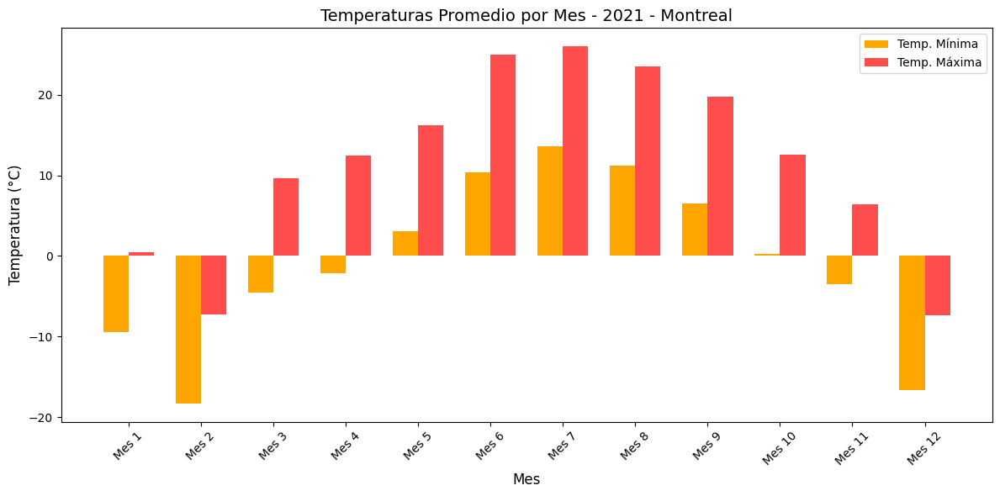


Top 3 meses más calurosos (Temp. máxima promedio más alta):
  Mes 7: 26.07 °C
  Mes 6: 25.02 °C
  Mes 8: 23.52 °C

Top 3 meses más fríos (Temp. mínima promedio más baja):
  Mes 2: -18.35 °C
  Mes 12: -16.66 °C
  Mes 1: -9.50 °C


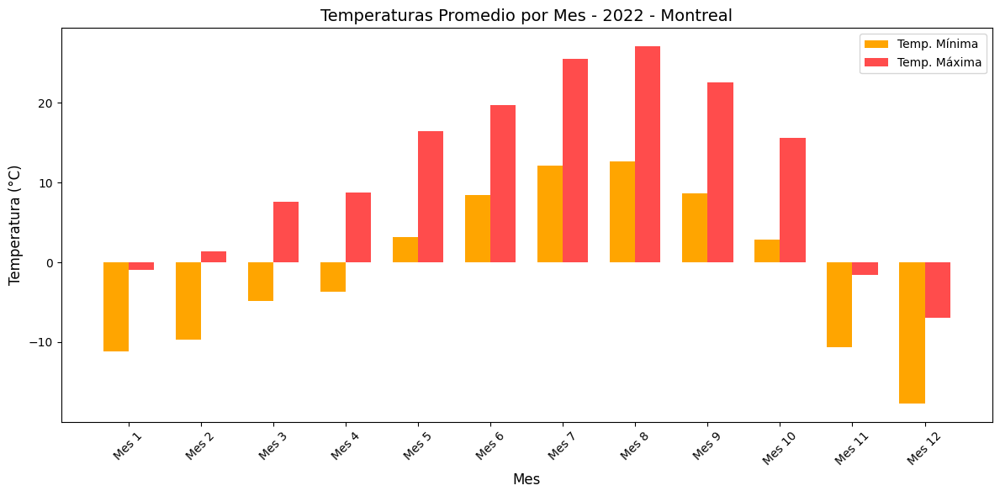


Top 3 meses más calurosos (Temp. máxima promedio más alta):
  Mes 8: 27.13 °C
  Mes 7: 25.55 °C
  Mes 9: 22.52 °C

Top 3 meses más fríos (Temp. mínima promedio más baja):
  Mes 12: -17.73 °C
  Mes 1: -11.18 °C
  Mes 11: -10.67 °C


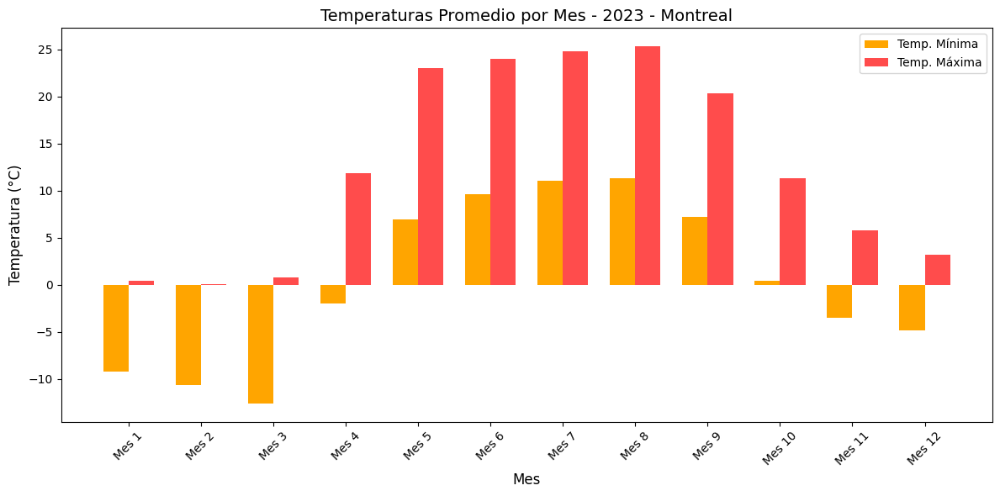


Top 3 meses más calurosos (Temp. máxima promedio más alta):
  Mes 8: 25.37 °C
  Mes 7: 24.76 °C
  Mes 6: 23.98 °C

Top 3 meses más fríos (Temp. mínima promedio más baja):
  Mes 3: -12.66 °C
  Mes 2: -10.70 °C
  Mes 1: -9.23 °C


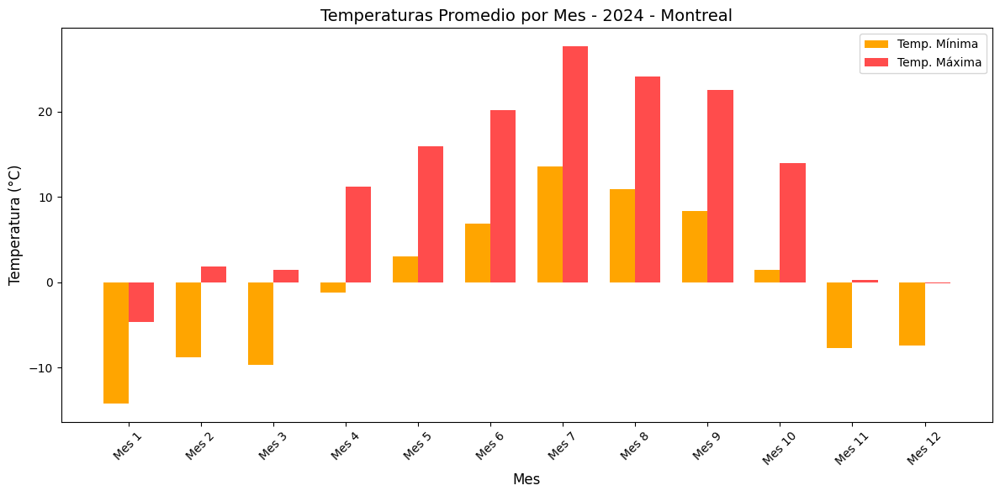


Top 3 meses más calurosos (Temp. máxima promedio más alta):
  Mes 7: 27.68 °C
  Mes 8: 24.10 °C
  Mes 9: 22.49 °C

Top 3 meses más fríos (Temp. mínima promedio más baja):
  Mes 1: -14.22 °C
  Mes 3: -9.61 °C
  Mes 2: -8.75 °C


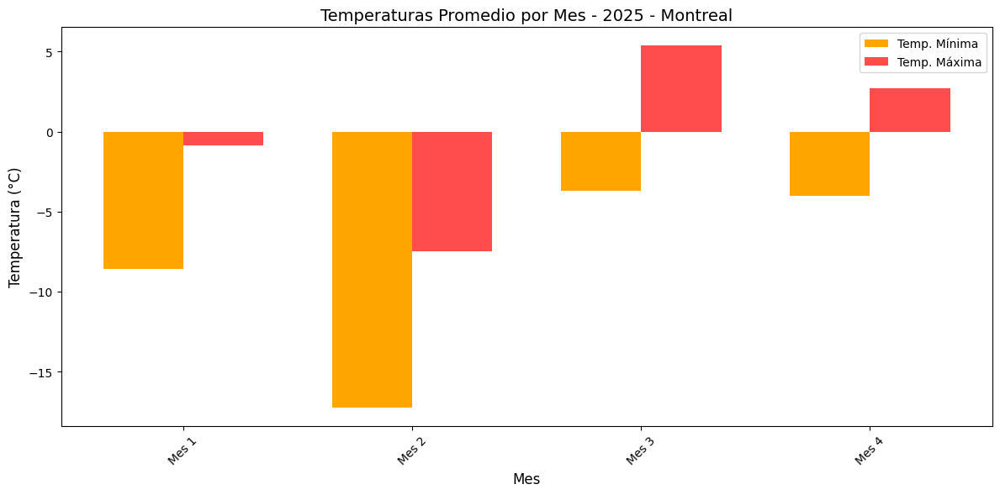


Top 3 meses más calurosos (Temp. máxima promedio más alta):
  Mes 3: 5.40 °C
  Mes 4: 2.70 °C
  Mes 1: -0.88 °C

Top 3 meses más fríos (Temp. mínima promedio más baja):
  Mes 2: -17.27 °C
  Mes 1: -8.60 °C
  Mes 4: -4.03 °C

===== Oslo =====


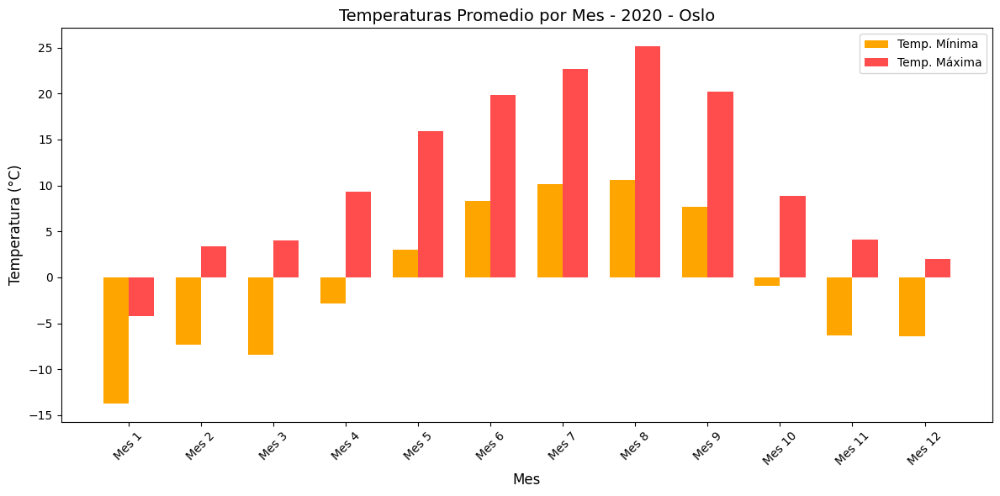


Top 3 meses más calurosos (Temp. máxima promedio más alta):
  Mes 8: 25.18 °C
  Mes 7: 22.72 °C
  Mes 9: 20.23 °C

Top 3 meses más fríos (Temp. mínima promedio más baja):
  Mes 1: -13.76 °C
  Mes 3: -8.45 °C
  Mes 2: -7.36 °C


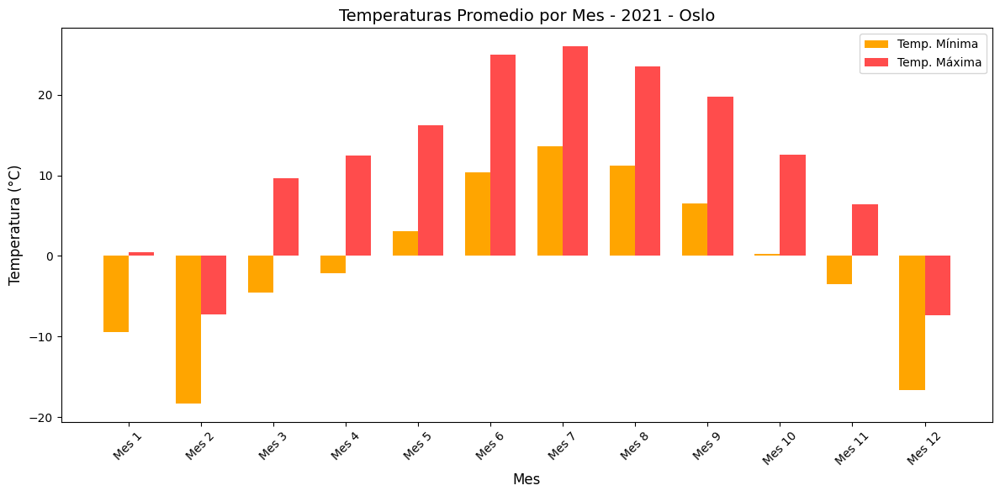


Top 3 meses más calurosos (Temp. máxima promedio más alta):
  Mes 7: 26.07 °C
  Mes 6: 25.02 °C
  Mes 8: 23.52 °C

Top 3 meses más fríos (Temp. mínima promedio más baja):
  Mes 2: -18.35 °C
  Mes 12: -16.66 °C
  Mes 1: -9.50 °C


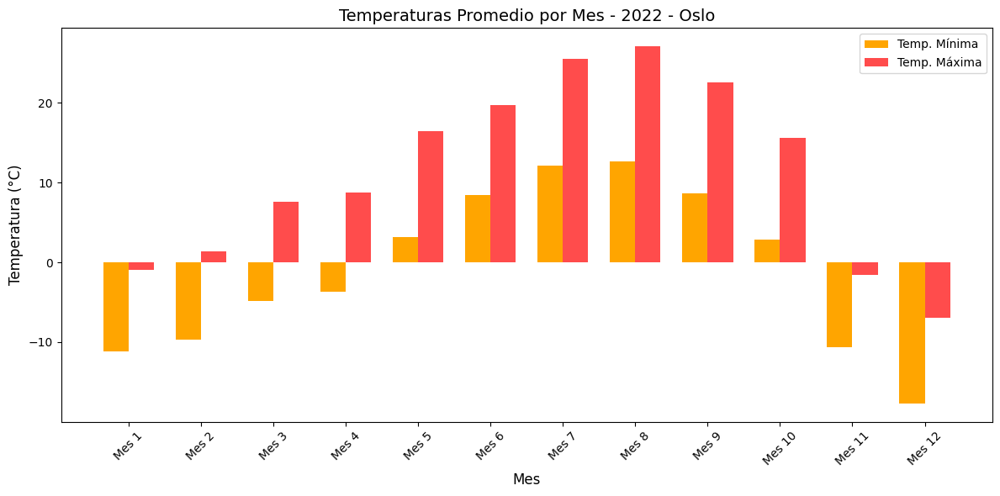


Top 3 meses más calurosos (Temp. máxima promedio más alta):
  Mes 8: 27.13 °C
  Mes 7: 25.55 °C
  Mes 9: 22.52 °C

Top 3 meses más fríos (Temp. mínima promedio más baja):
  Mes 12: -17.73 °C
  Mes 1: -11.18 °C
  Mes 11: -10.67 °C


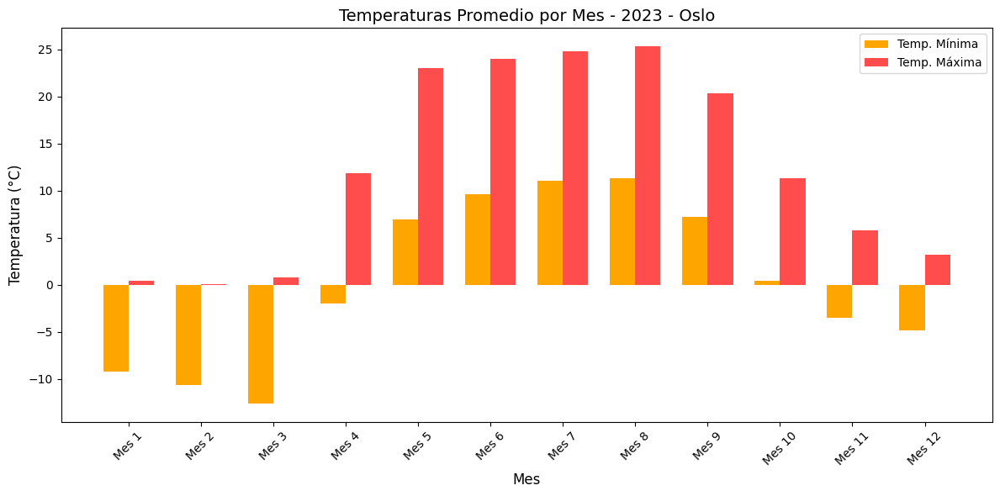


Top 3 meses más calurosos (Temp. máxima promedio más alta):
  Mes 8: 25.37 °C
  Mes 7: 24.76 °C
  Mes 6: 23.98 °C

Top 3 meses más fríos (Temp. mínima promedio más baja):
  Mes 3: -12.66 °C
  Mes 2: -10.70 °C
  Mes 1: -9.23 °C


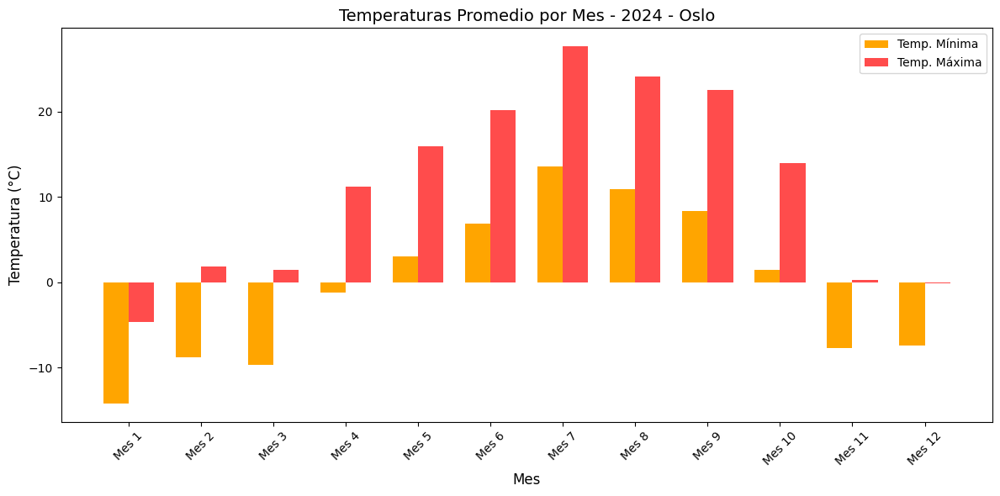


Top 3 meses más calurosos (Temp. máxima promedio más alta):
  Mes 7: 27.68 °C
  Mes 8: 24.10 °C
  Mes 9: 22.49 °C

Top 3 meses más fríos (Temp. mínima promedio más baja):
  Mes 1: -14.22 °C
  Mes 3: -9.61 °C
  Mes 2: -8.75 °C


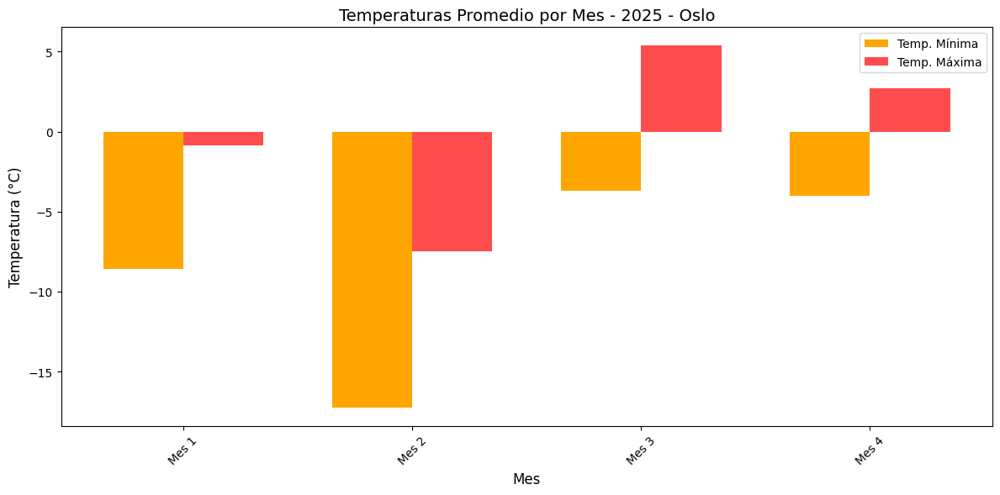


Top 3 meses más calurosos (Temp. máxima promedio más alta):
  Mes 3: 5.40 °C
  Mes 4: 2.70 °C
  Mes 1: -0.88 °C

Top 3 meses más fríos (Temp. mínima promedio más baja):
  Mes 2: -17.27 °C
  Mes 1: -8.60 °C
  Mes 4: -4.03 °C

===== Ottawa =====


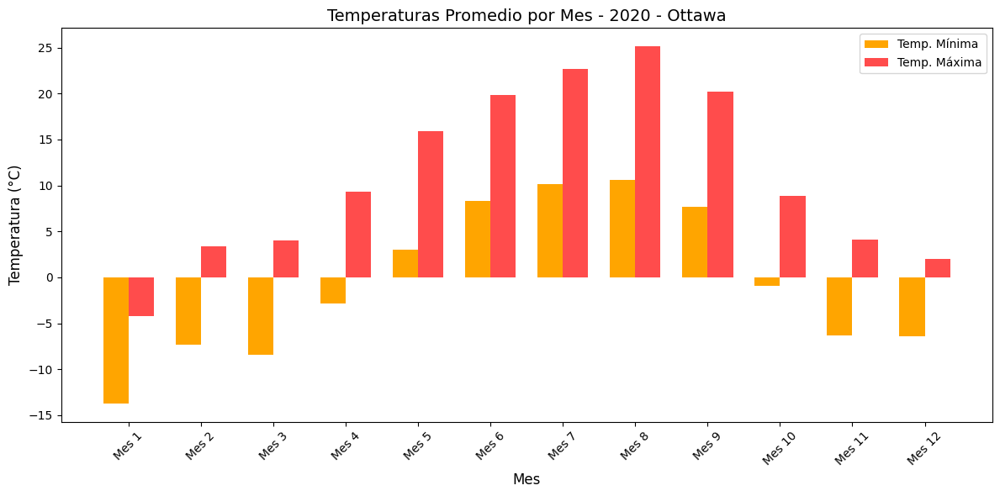


Top 3 meses más calurosos (Temp. máxima promedio más alta):
  Mes 8: 25.18 °C
  Mes 7: 22.72 °C
  Mes 9: 20.23 °C

Top 3 meses más fríos (Temp. mínima promedio más baja):
  Mes 1: -13.76 °C
  Mes 3: -8.45 °C
  Mes 2: -7.36 °C


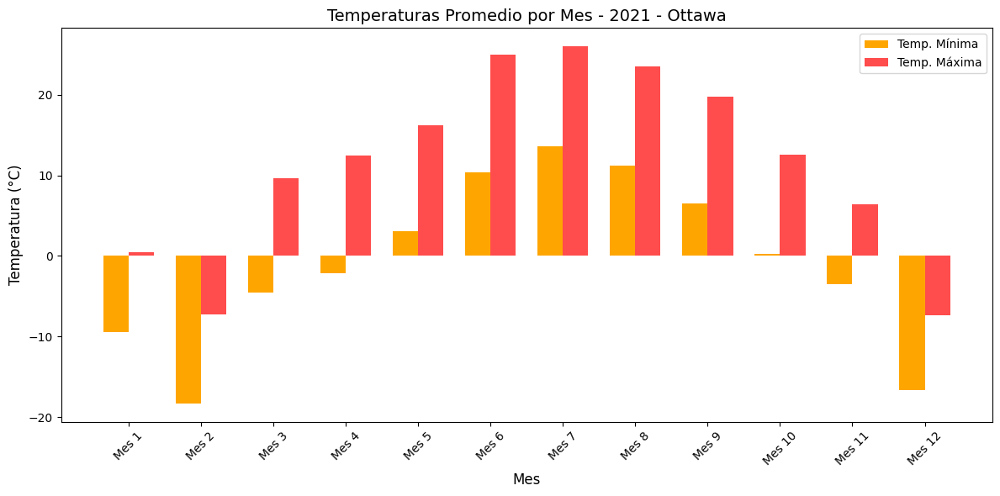


Top 3 meses más calurosos (Temp. máxima promedio más alta):
  Mes 7: 26.07 °C
  Mes 6: 25.02 °C
  Mes 8: 23.52 °C

Top 3 meses más fríos (Temp. mínima promedio más baja):
  Mes 2: -18.35 °C
  Mes 12: -16.66 °C
  Mes 1: -9.50 °C


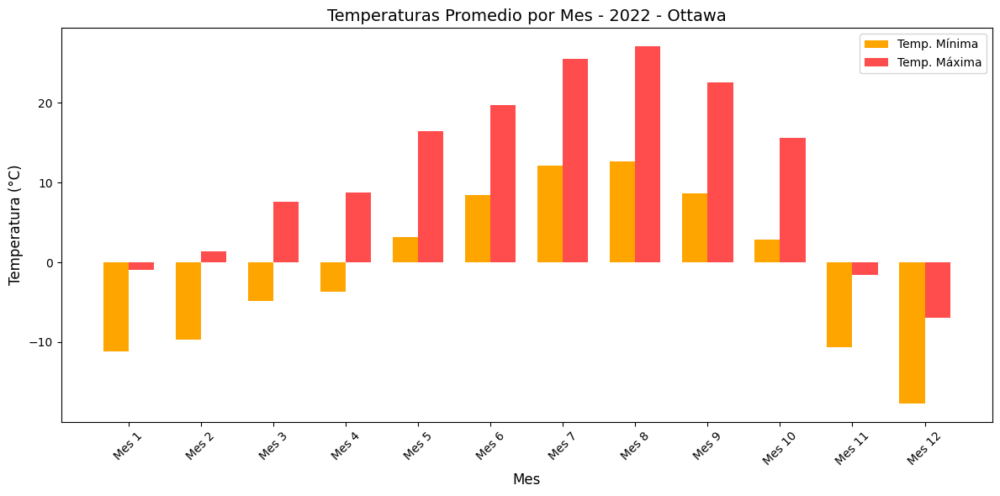


Top 3 meses más calurosos (Temp. máxima promedio más alta):
  Mes 8: 27.13 °C
  Mes 7: 25.55 °C
  Mes 9: 22.52 °C

Top 3 meses más fríos (Temp. mínima promedio más baja):
  Mes 12: -17.73 °C
  Mes 1: -11.18 °C
  Mes 11: -10.67 °C


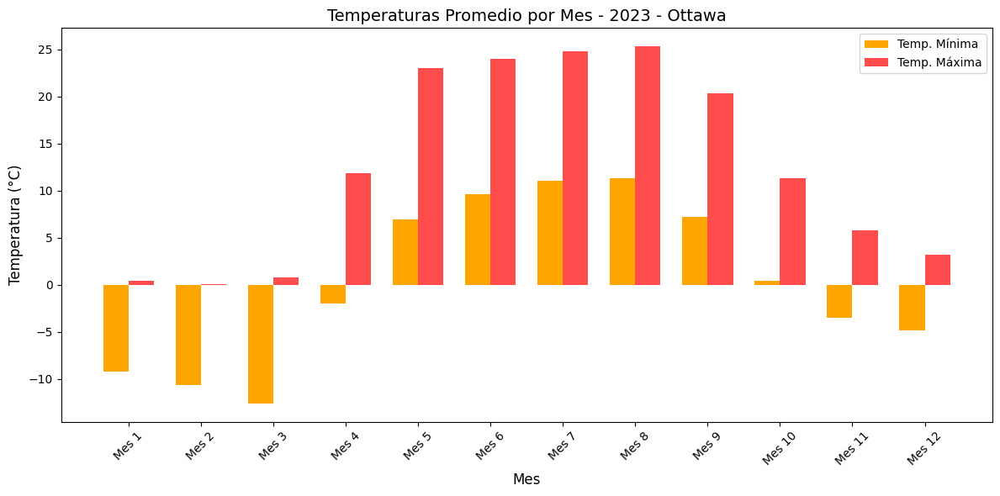


Top 3 meses más calurosos (Temp. máxima promedio más alta):
  Mes 8: 25.37 °C
  Mes 7: 24.76 °C
  Mes 6: 23.98 °C

Top 3 meses más fríos (Temp. mínima promedio más baja):
  Mes 3: -12.66 °C
  Mes 2: -10.70 °C
  Mes 1: -9.23 °C


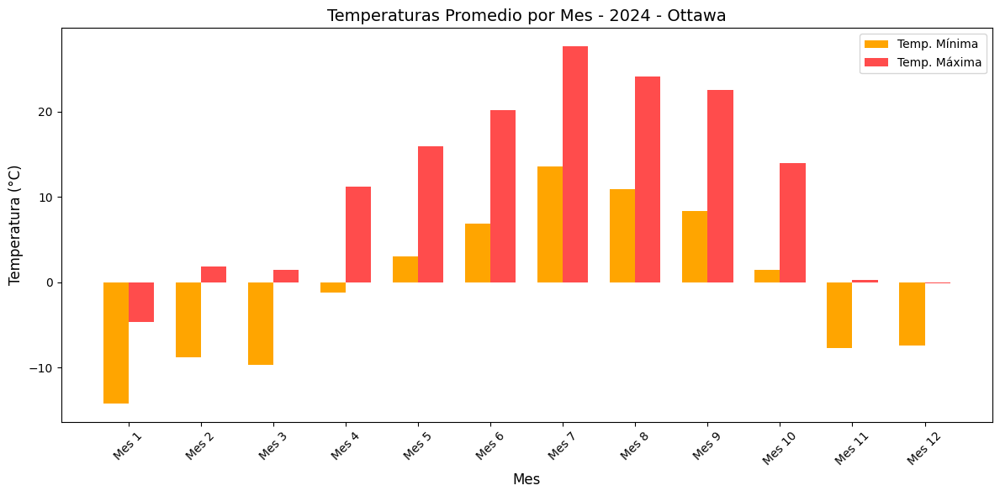


Top 3 meses más calurosos (Temp. máxima promedio más alta):
  Mes 7: 27.68 °C
  Mes 8: 24.10 °C
  Mes 9: 22.49 °C

Top 3 meses más fríos (Temp. mínima promedio más baja):
  Mes 1: -14.22 °C
  Mes 3: -9.61 °C
  Mes 2: -8.75 °C


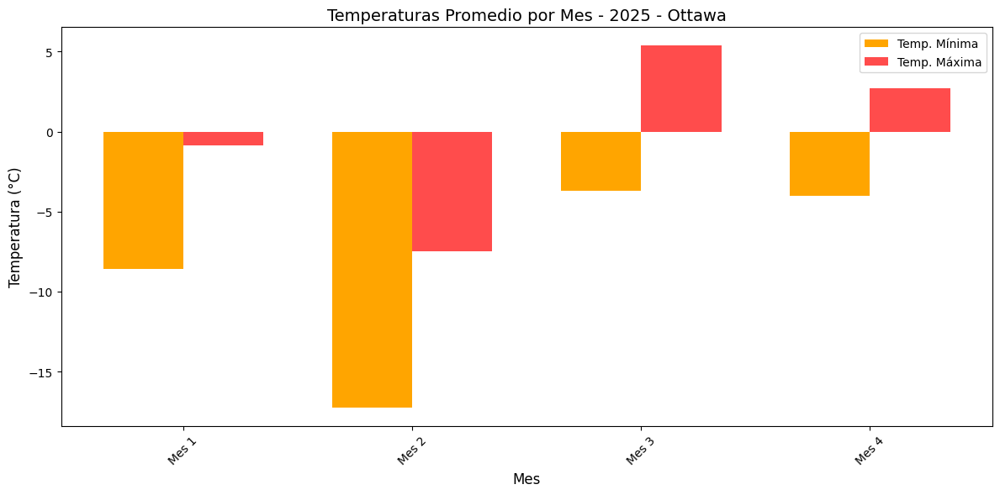


Top 3 meses más calurosos (Temp. máxima promedio más alta):
  Mes 3: 5.40 °C
  Mes 4: 2.70 °C
  Mes 1: -0.88 °C

Top 3 meses más fríos (Temp. mínima promedio más baja):
  Mes 2: -17.27 °C
  Mes 1: -8.60 °C
  Mes 4: -4.03 °C

===== Sapporo =====


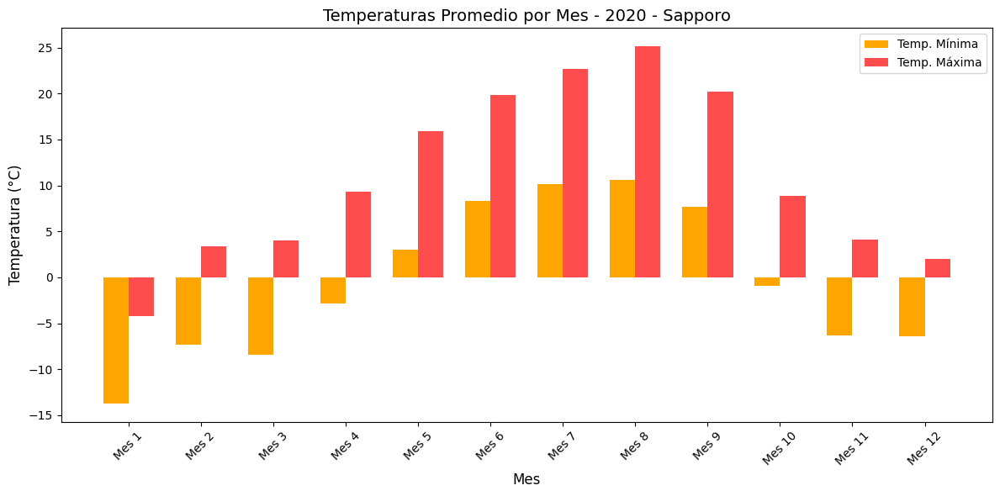


Top 3 meses más calurosos (Temp. máxima promedio más alta):
  Mes 8: 25.18 °C
  Mes 7: 22.72 °C
  Mes 9: 20.23 °C

Top 3 meses más fríos (Temp. mínima promedio más baja):
  Mes 1: -13.76 °C
  Mes 3: -8.45 °C
  Mes 2: -7.36 °C


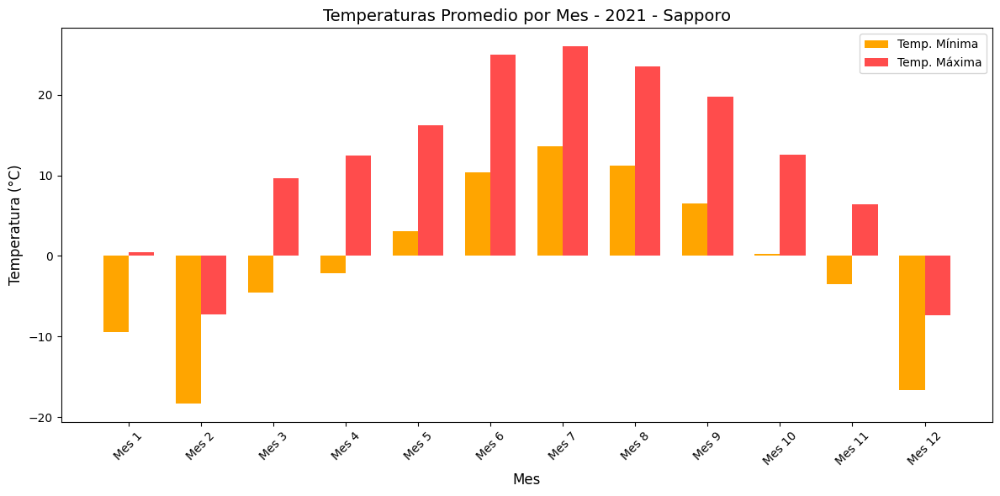


Top 3 meses más calurosos (Temp. máxima promedio más alta):
  Mes 7: 26.07 °C
  Mes 6: 25.02 °C
  Mes 8: 23.52 °C

Top 3 meses más fríos (Temp. mínima promedio más baja):
  Mes 2: -18.35 °C
  Mes 12: -16.66 °C
  Mes 1: -9.50 °C


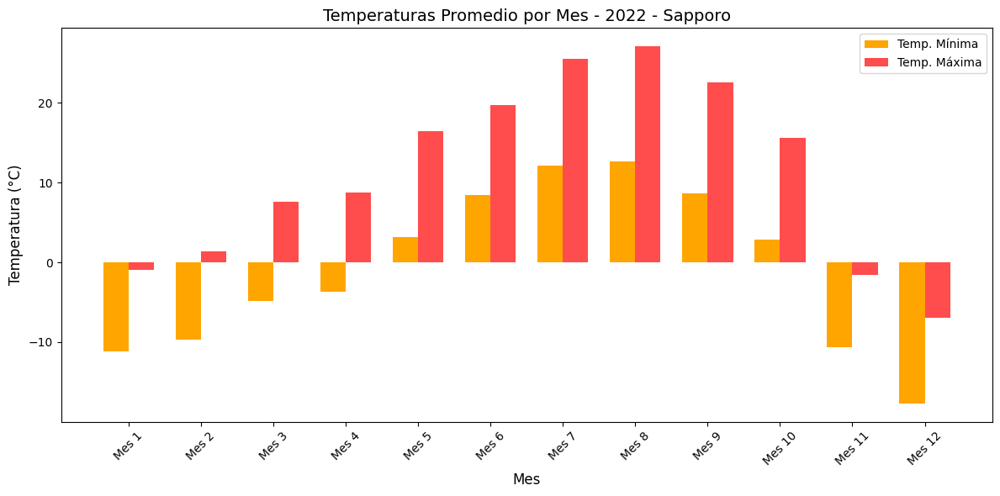


Top 3 meses más calurosos (Temp. máxima promedio más alta):
  Mes 8: 27.13 °C
  Mes 7: 25.55 °C
  Mes 9: 22.52 °C

Top 3 meses más fríos (Temp. mínima promedio más baja):
  Mes 12: -17.73 °C
  Mes 1: -11.18 °C
  Mes 11: -10.67 °C


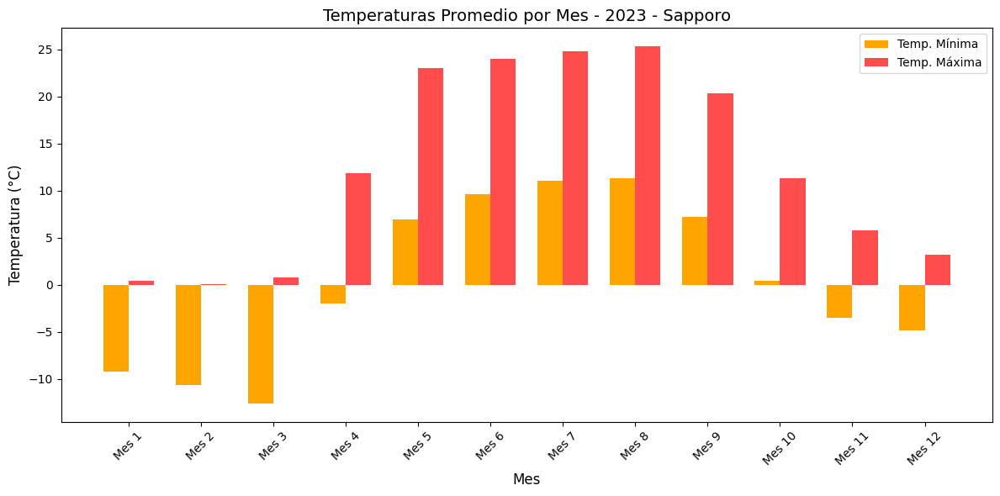


Top 3 meses más calurosos (Temp. máxima promedio más alta):
  Mes 8: 25.37 °C
  Mes 7: 24.76 °C
  Mes 6: 23.98 °C

Top 3 meses más fríos (Temp. mínima promedio más baja):
  Mes 3: -12.66 °C
  Mes 2: -10.70 °C
  Mes 1: -9.23 °C


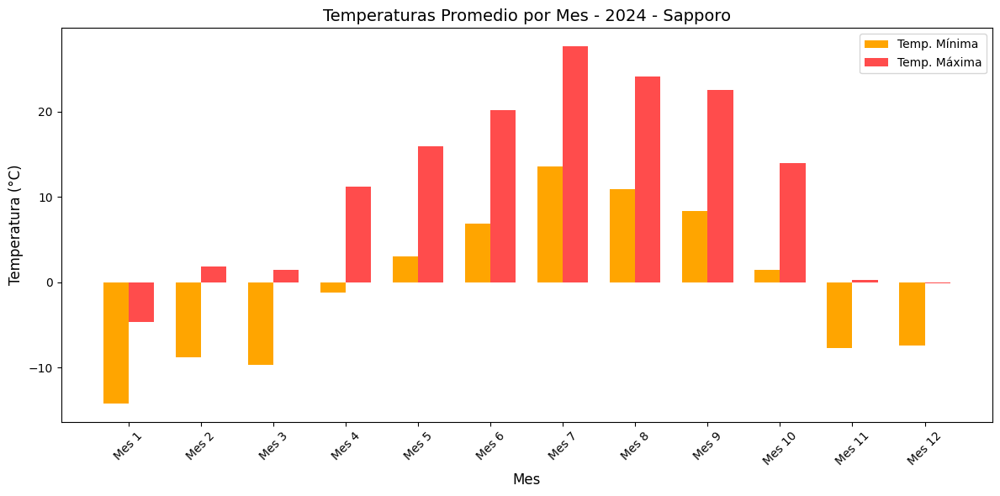


Top 3 meses más calurosos (Temp. máxima promedio más alta):
  Mes 7: 27.68 °C
  Mes 8: 24.10 °C
  Mes 9: 22.49 °C

Top 3 meses más fríos (Temp. mínima promedio más baja):
  Mes 1: -14.22 °C
  Mes 3: -9.61 °C
  Mes 2: -8.75 °C


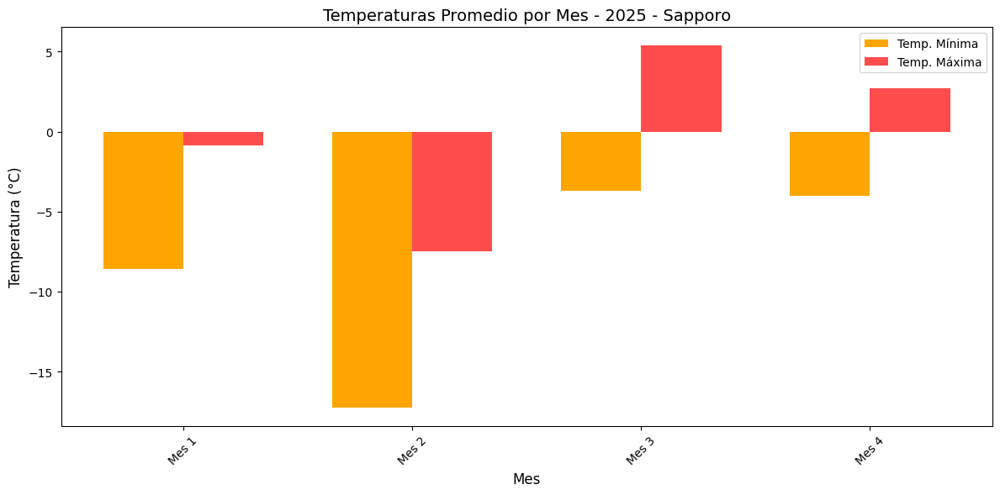


Top 3 meses más calurosos (Temp. máxima promedio más alta):
  Mes 3: 5.40 °C
  Mes 4: 2.70 °C
  Mes 1: -0.88 °C

Top 3 meses más fríos (Temp. mínima promedio más baja):
  Mes 2: -17.27 °C
  Mes 1: -8.60 °C
  Mes 4: -4.03 °C

===== Stockholm =====


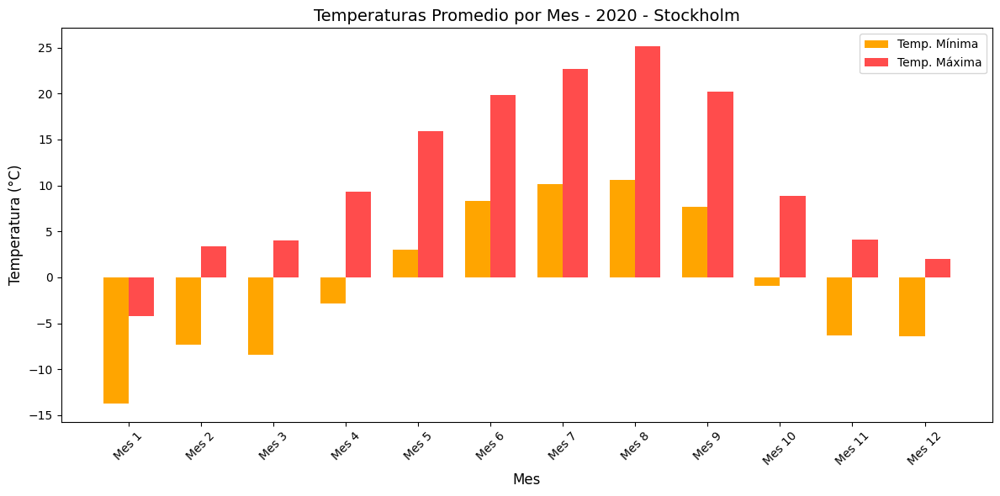


Top 3 meses más calurosos (Temp. máxima promedio más alta):
  Mes 8: 25.18 °C
  Mes 7: 22.72 °C
  Mes 9: 20.23 °C

Top 3 meses más fríos (Temp. mínima promedio más baja):
  Mes 1: -13.76 °C
  Mes 3: -8.45 °C
  Mes 2: -7.36 °C


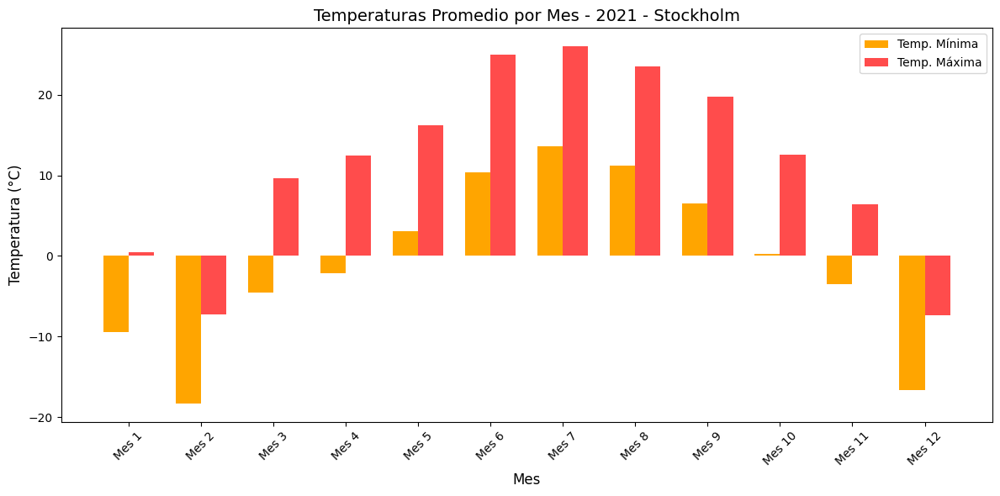


Top 3 meses más calurosos (Temp. máxima promedio más alta):
  Mes 7: 26.07 °C
  Mes 6: 25.02 °C
  Mes 8: 23.52 °C

Top 3 meses más fríos (Temp. mínima promedio más baja):
  Mes 2: -18.35 °C
  Mes 12: -16.66 °C
  Mes 1: -9.50 °C


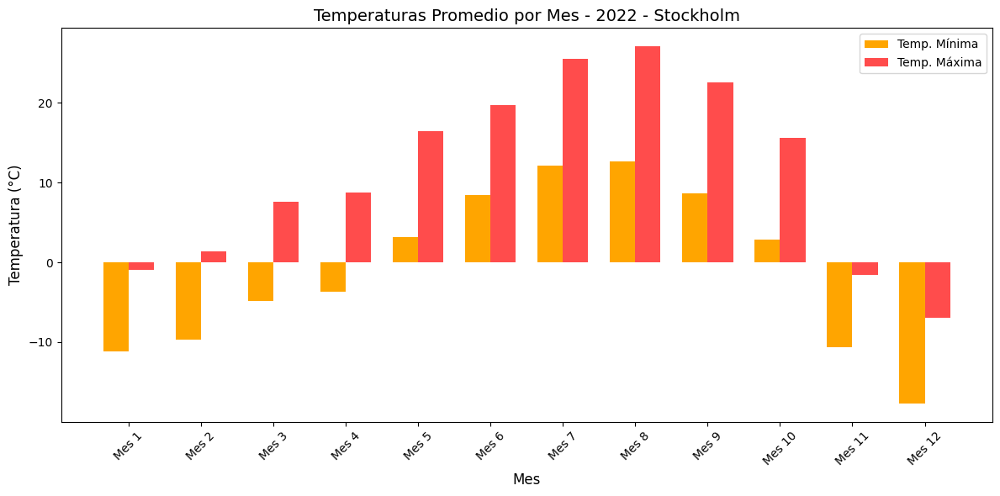


Top 3 meses más calurosos (Temp. máxima promedio más alta):
  Mes 8: 27.13 °C
  Mes 7: 25.55 °C
  Mes 9: 22.52 °C

Top 3 meses más fríos (Temp. mínima promedio más baja):
  Mes 12: -17.73 °C
  Mes 1: -11.18 °C
  Mes 11: -10.67 °C


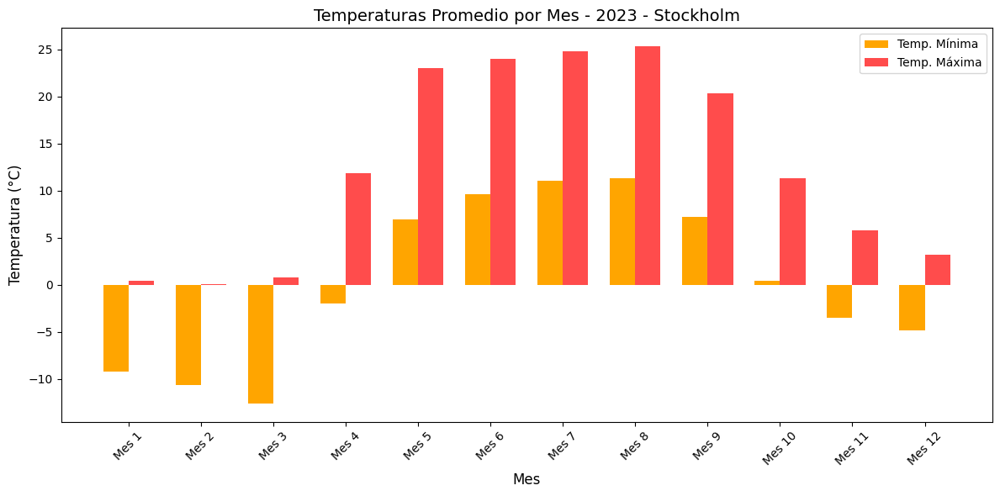


Top 3 meses más calurosos (Temp. máxima promedio más alta):
  Mes 8: 25.37 °C
  Mes 7: 24.76 °C
  Mes 6: 23.98 °C

Top 3 meses más fríos (Temp. mínima promedio más baja):
  Mes 3: -12.66 °C
  Mes 2: -10.70 °C
  Mes 1: -9.23 °C


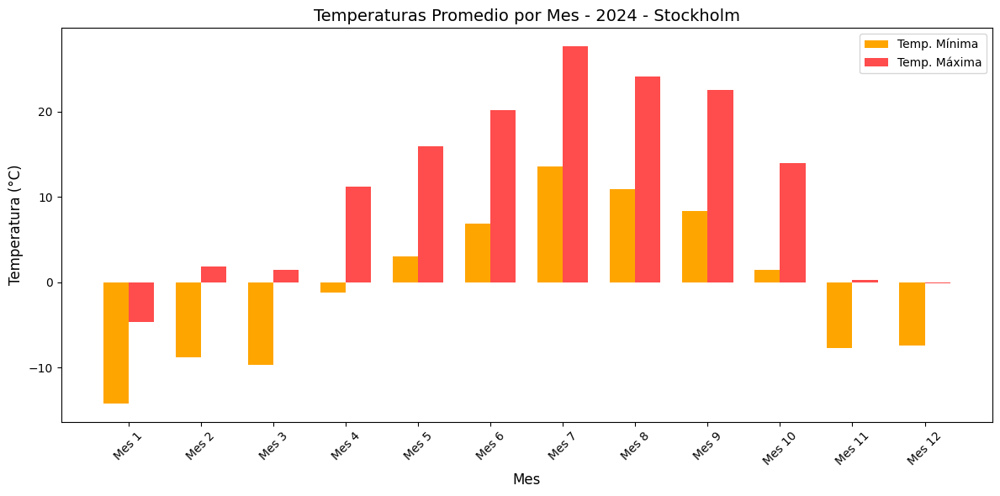


Top 3 meses más calurosos (Temp. máxima promedio más alta):
  Mes 7: 27.68 °C
  Mes 8: 24.10 °C
  Mes 9: 22.49 °C

Top 3 meses más fríos (Temp. mínima promedio más baja):
  Mes 1: -14.22 °C
  Mes 3: -9.61 °C
  Mes 2: -8.75 °C


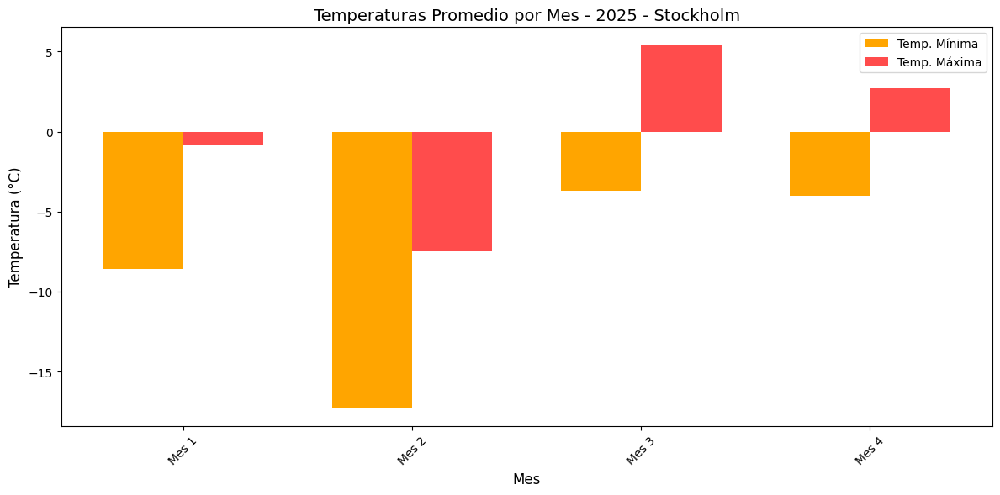


Top 3 meses más calurosos (Temp. máxima promedio más alta):
  Mes 3: 5.40 °C
  Mes 4: 2.70 °C
  Mes 1: -0.88 °C

Top 3 meses más fríos (Temp. mínima promedio más baja):
  Mes 2: -17.27 °C
  Mes 1: -8.60 °C
  Mes 4: -4.03 °C

===== Toronto =====


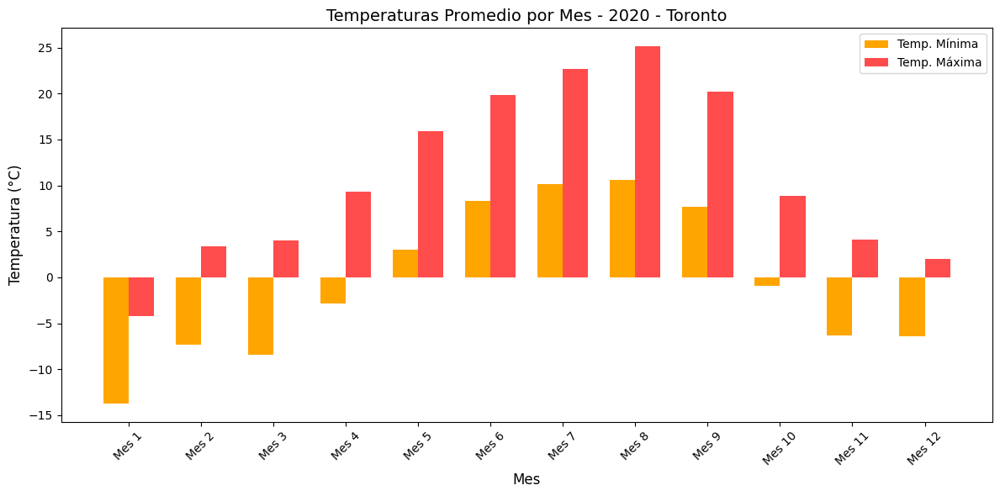


Top 3 meses más calurosos (Temp. máxima promedio más alta):
  Mes 8: 25.18 °C
  Mes 7: 22.72 °C
  Mes 9: 20.23 °C

Top 3 meses más fríos (Temp. mínima promedio más baja):
  Mes 1: -13.76 °C
  Mes 3: -8.45 °C
  Mes 2: -7.36 °C


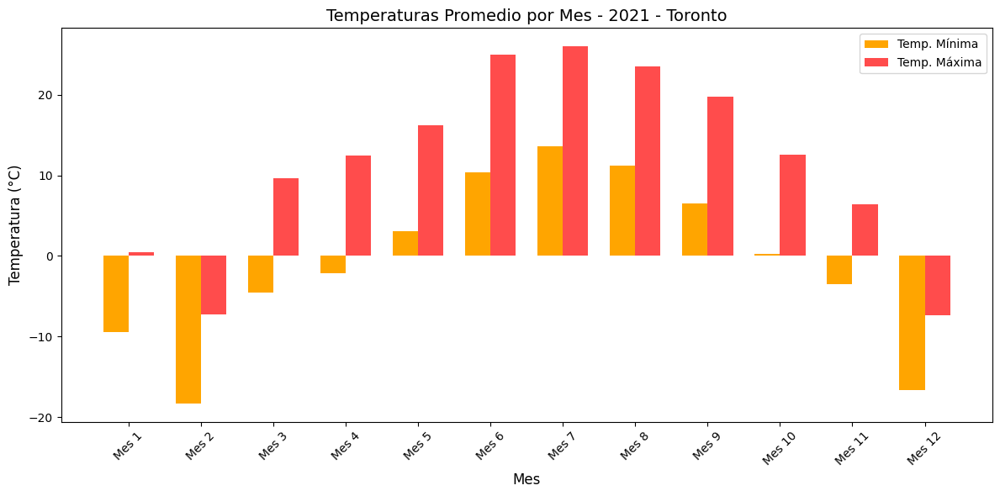


Top 3 meses más calurosos (Temp. máxima promedio más alta):
  Mes 7: 26.07 °C
  Mes 6: 25.02 °C
  Mes 8: 23.52 °C

Top 3 meses más fríos (Temp. mínima promedio más baja):
  Mes 2: -18.35 °C
  Mes 12: -16.66 °C
  Mes 1: -9.50 °C


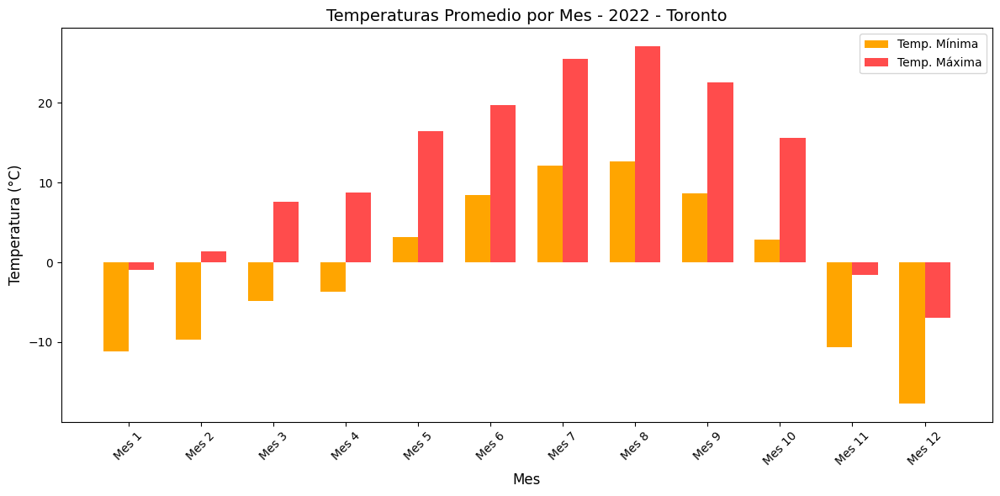


Top 3 meses más calurosos (Temp. máxima promedio más alta):
  Mes 8: 27.13 °C
  Mes 7: 25.55 °C
  Mes 9: 22.52 °C

Top 3 meses más fríos (Temp. mínima promedio más baja):
  Mes 12: -17.73 °C
  Mes 1: -11.18 °C
  Mes 11: -10.67 °C


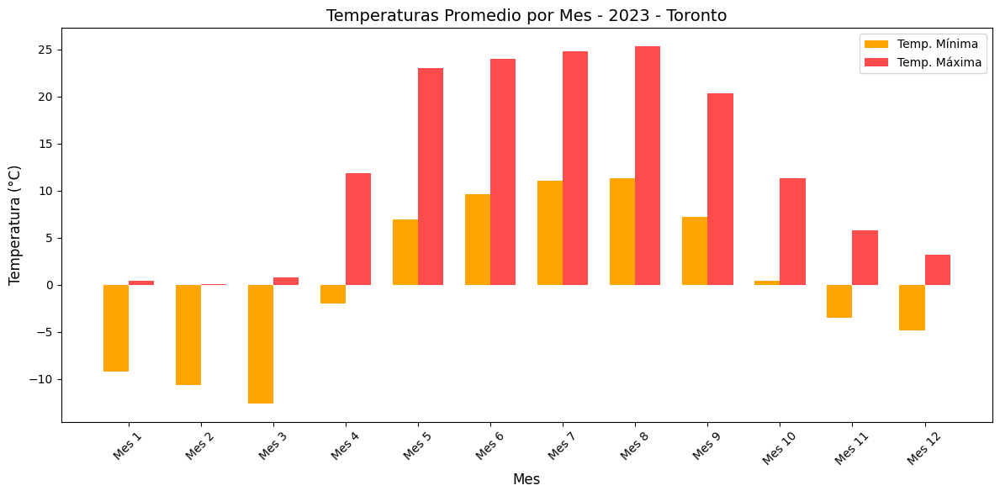


Top 3 meses más calurosos (Temp. máxima promedio más alta):
  Mes 8: 25.37 °C
  Mes 7: 24.76 °C
  Mes 6: 23.98 °C

Top 3 meses más fríos (Temp. mínima promedio más baja):
  Mes 3: -12.66 °C
  Mes 2: -10.70 °C
  Mes 1: -9.23 °C


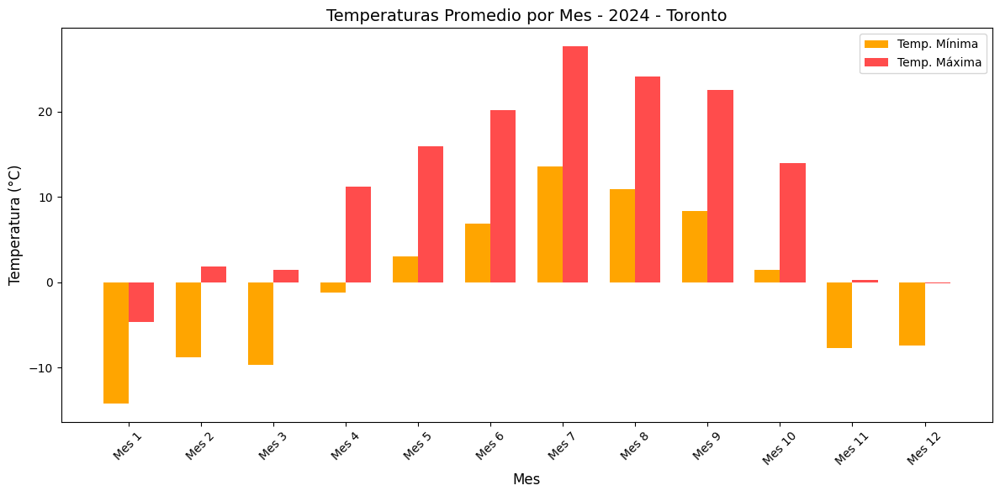


Top 3 meses más calurosos (Temp. máxima promedio más alta):
  Mes 7: 27.68 °C
  Mes 8: 24.10 °C
  Mes 9: 22.49 °C

Top 3 meses más fríos (Temp. mínima promedio más baja):
  Mes 1: -14.22 °C
  Mes 3: -9.61 °C
  Mes 2: -8.75 °C


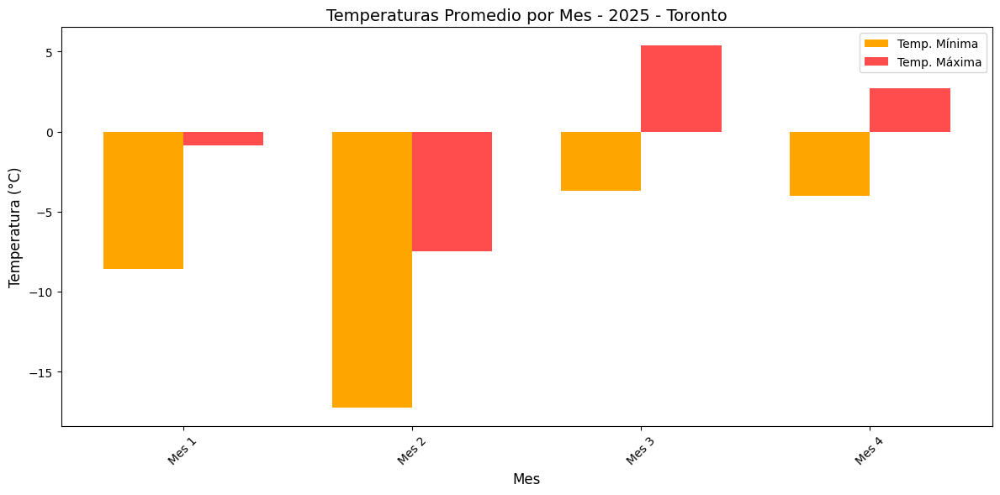


Top 3 meses más calurosos (Temp. máxima promedio más alta):
  Mes 3: 5.40 °C
  Mes 4: 2.70 °C
  Mes 1: -0.88 °C

Top 3 meses más fríos (Temp. mínima promedio más baja):
  Mes 2: -17.27 °C
  Mes 1: -8.60 °C
  Mes 4: -4.03 °C


In [107]:
for city in ciudades_frio:
    print(f"\n===== {city} =====")

    # Filtrar datos para la ciudad
    df_ciudad_frio = df_filtrado_frio[df_filtrado_frio['city_name'] == city]

    for año in df_ciudad_fria['año'].unique():
        df_año_fria = df_ciudad_fria[df_ciudad_fria['año'] == año]

        # Agrupar por mes y calcular promedios
        promedio_min_fria = df_año_fria.groupby('mes')['temperature_2m_min'].mean()
        promedio_max_fria = df_año_fria.groupby('mes')['temperature_2m_max'].mean()

        # Obtener el índice (meses) del promedio mínimo para la ciudad fría actual
        x = promedio_min_fria.index  # Changed this line to get the index from the current city's data
        width = 0.35  # ancho de las barras

        plt.figure(figsize=(12, 6))
        plt.bar(x - 0.175, promedio_min_fria.values, width=width, color='orange', label='Temp. Mínima')
        plt.bar(x + 0.175, promedio_max_fria.values, width=width, color='red', alpha=0.7, label='Temp. Máxima')

        plt.title(f'Temperaturas Promedio por Mes - {año} - {city}', fontsize=14)  # Changed this line to display the year correctly
        plt.xlabel('Mes', fontsize=12)
        plt.ylabel('Temperatura (°C)', fontsize=12)
        plt.legend()
        plt.xticks(ticks=x, labels=[f'Mes {m}' for m in x], rotation=45)
        plt.tight_layout()
        plt.show()

        # Detectar los 3 meses más cálidos y más fríos
        meses_maximos_fria = promedio_max_fria.sort_values(ascending=False).head(3)
        meses_minimos_fria = promedio_min_fria.sort_values(ascending=True).head(3)

        print(f"\nTop 3 meses más calurosos (Temp. máxima promedio más alta):")
        for mes, temp in meses_maximos_fria.items():
            print(f"  Mes {mes}: {temp:.2f} °C")

        print(f"\nTop 3 meses más fríos (Temp. mínima promedio más baja):")
        for mes, temp in meses_minimos_fria.items():
            print(f"  Mes {mes}: {temp:.2f} °C")

##¿Qué meses tienen más días con temperaturas agradables (entre 20 y 30 grados) en las ciudades más calurosas?

###Periodos calidos


===== Calgary =====


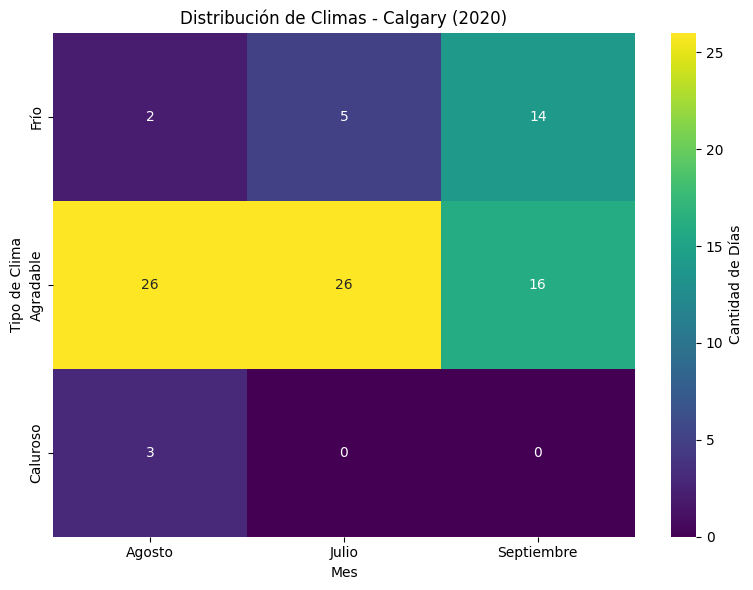

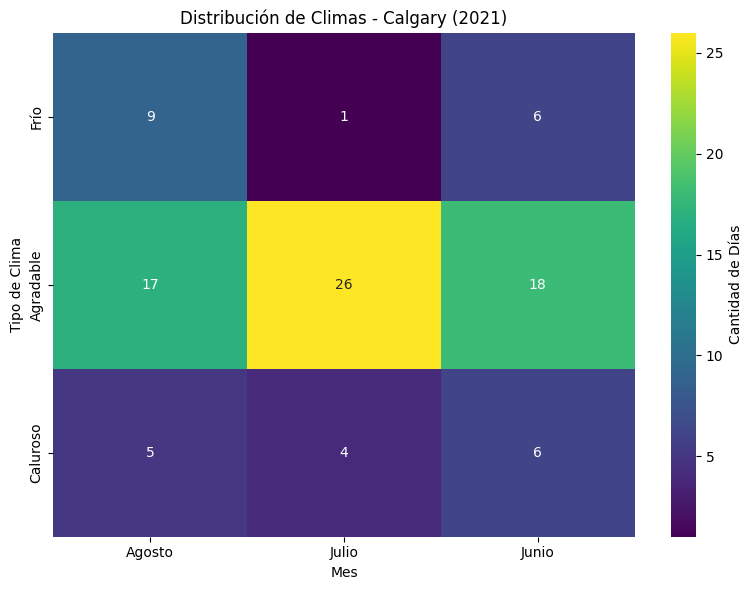

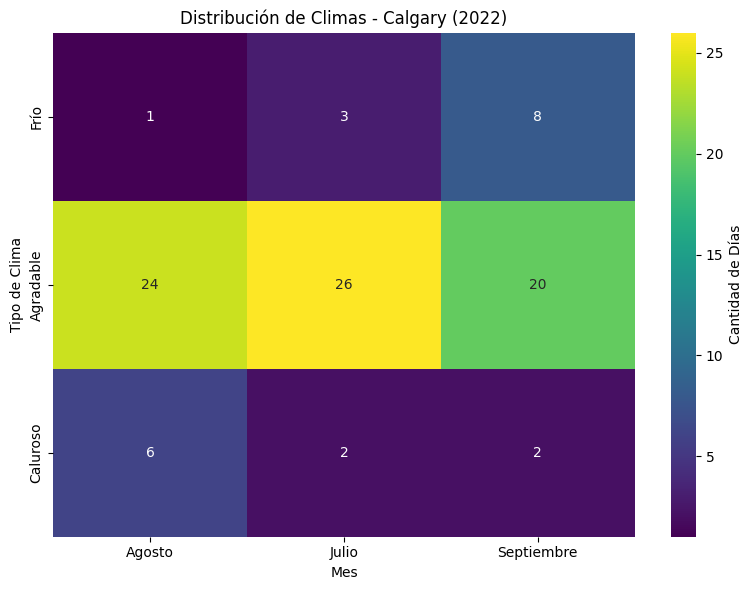

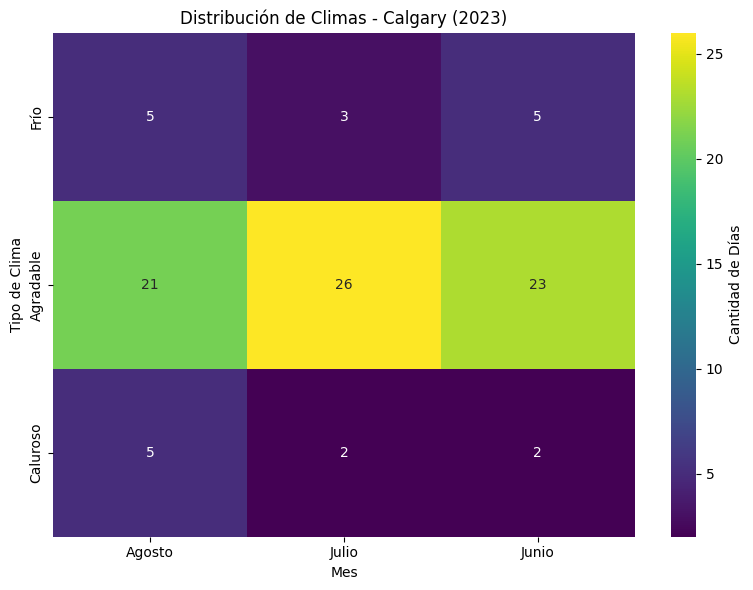

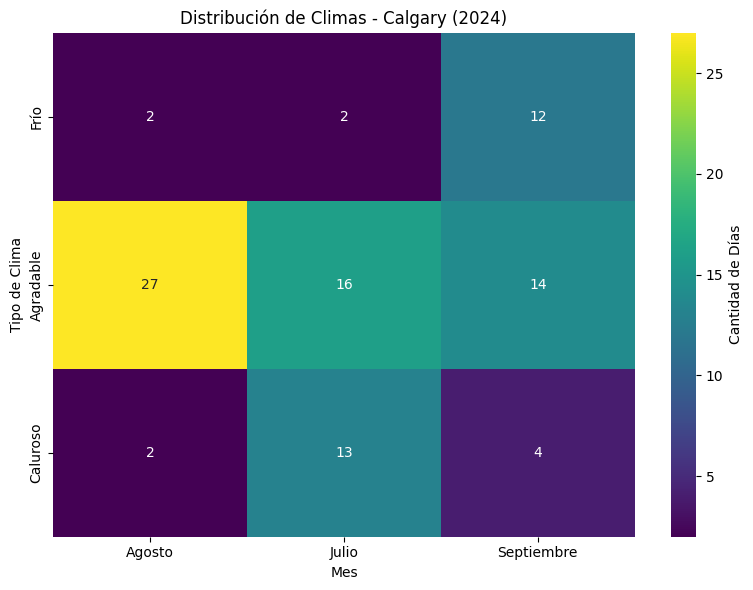

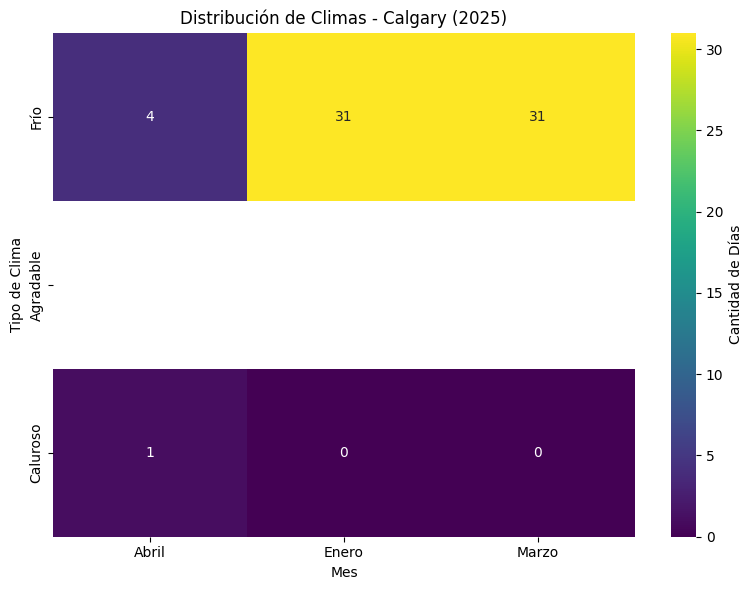


===== Helsinki =====


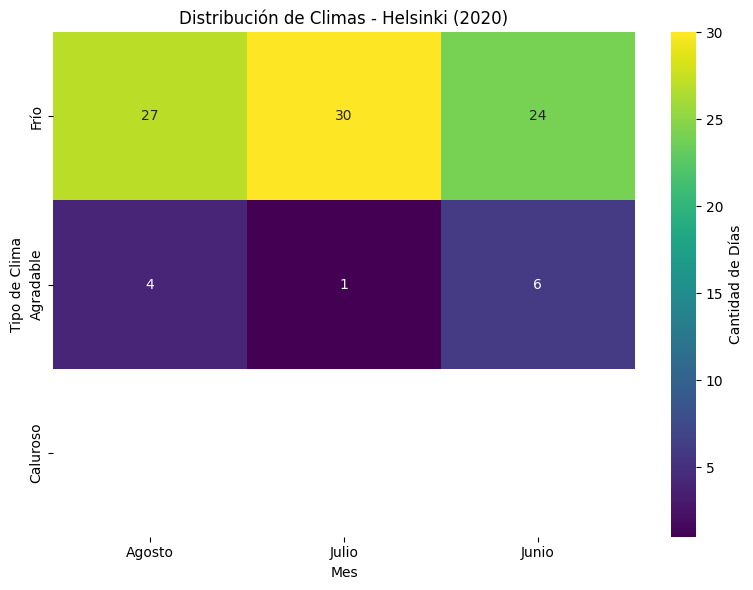

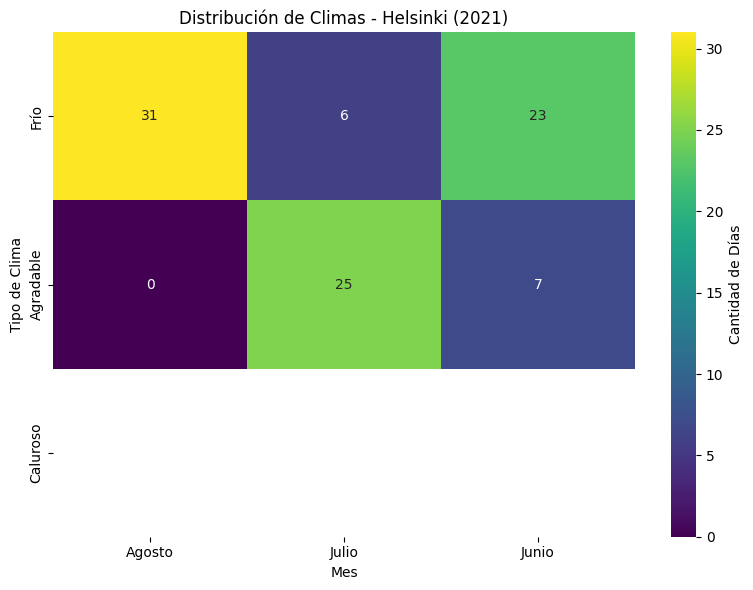

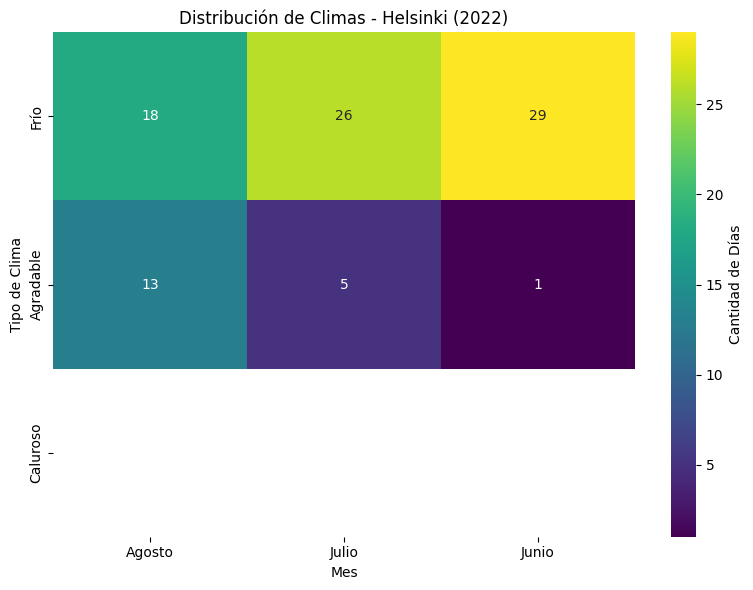

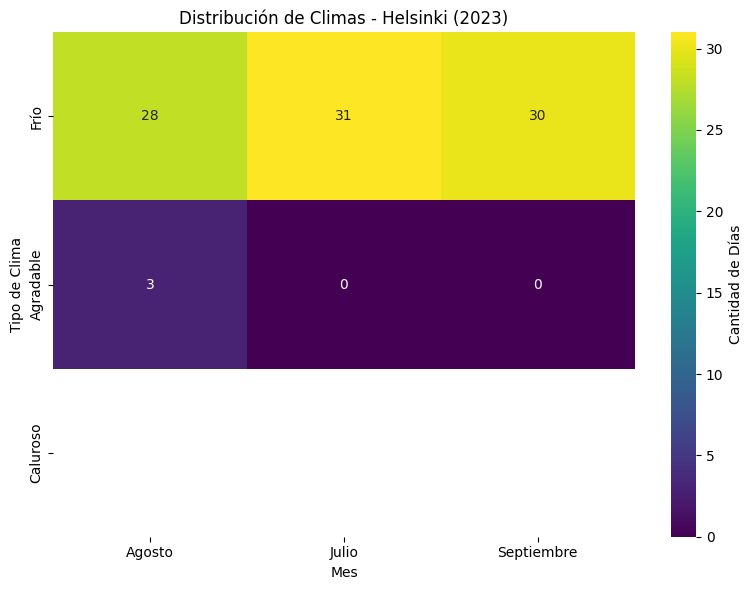

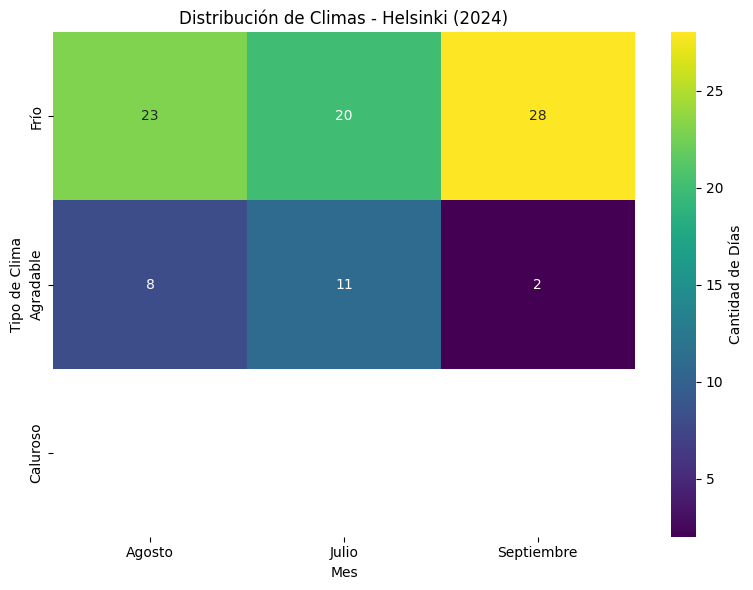

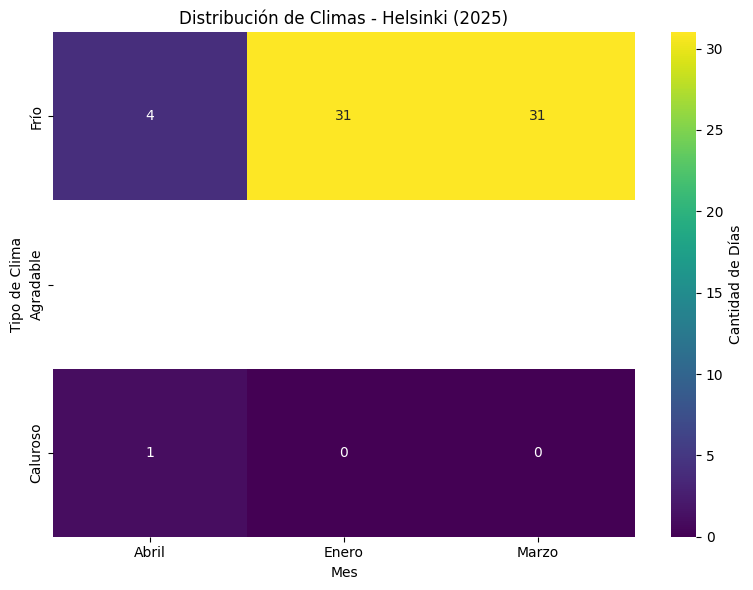


===== Las Vegas =====


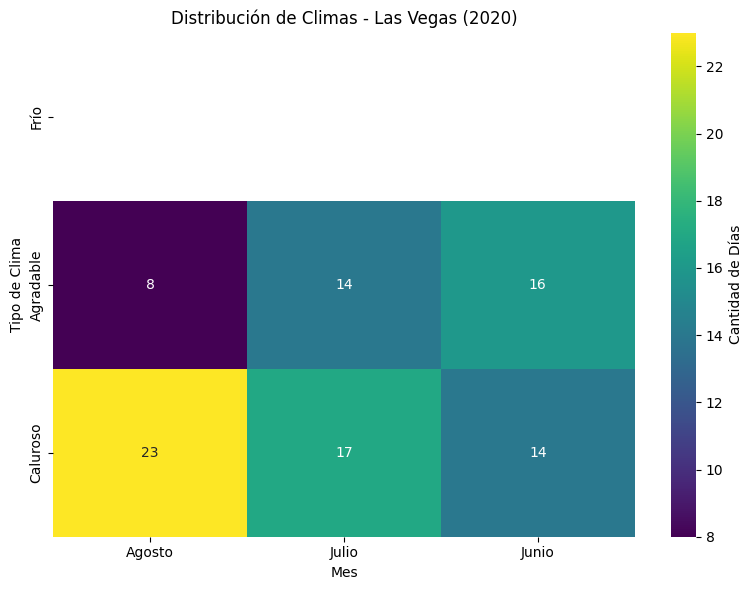

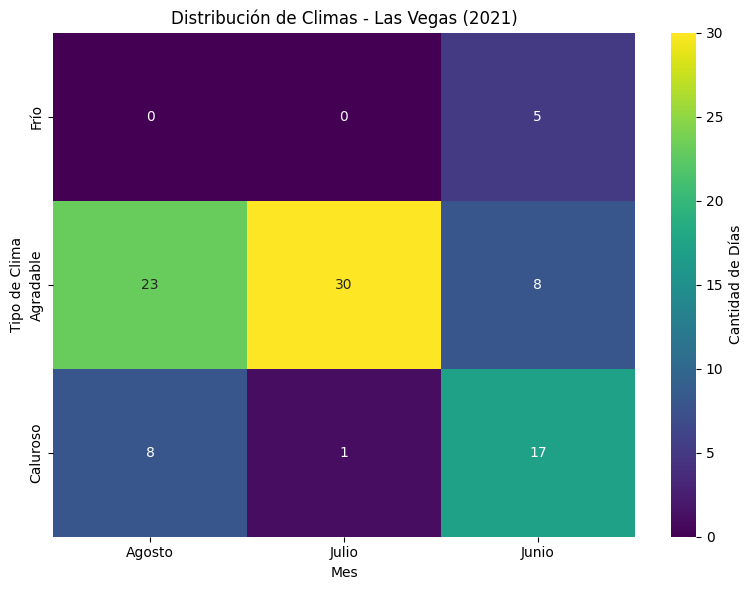

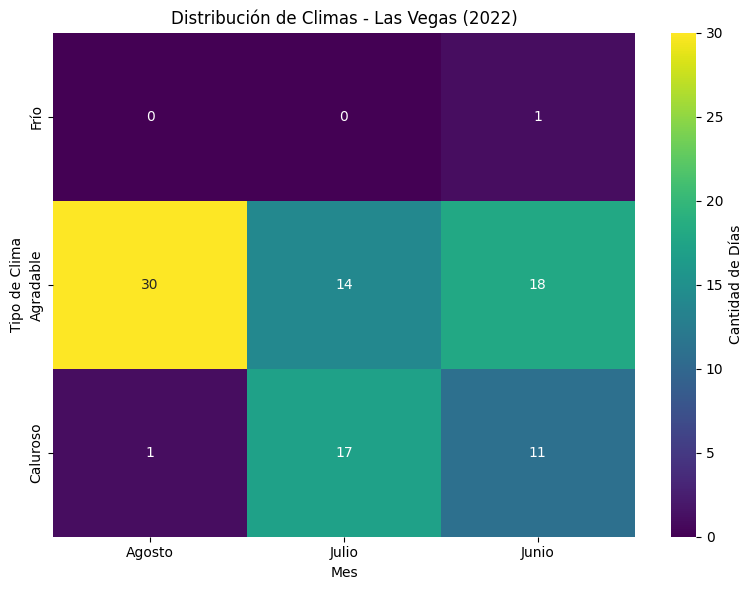

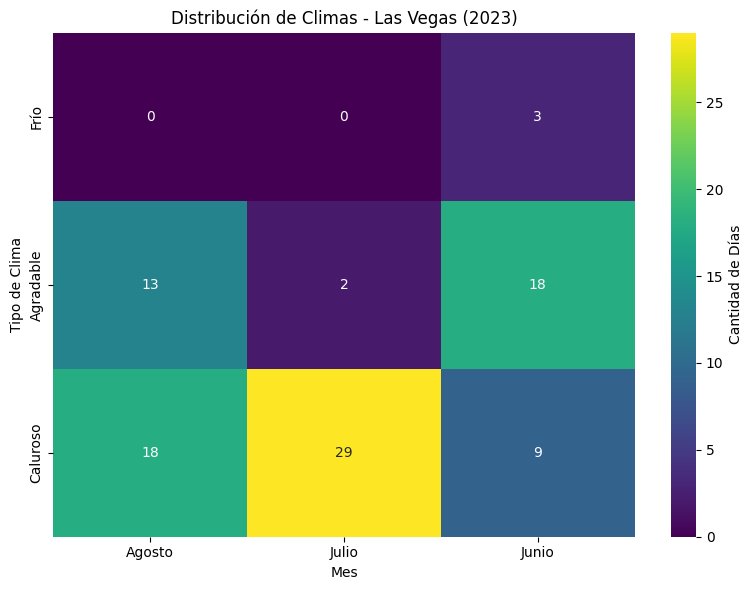

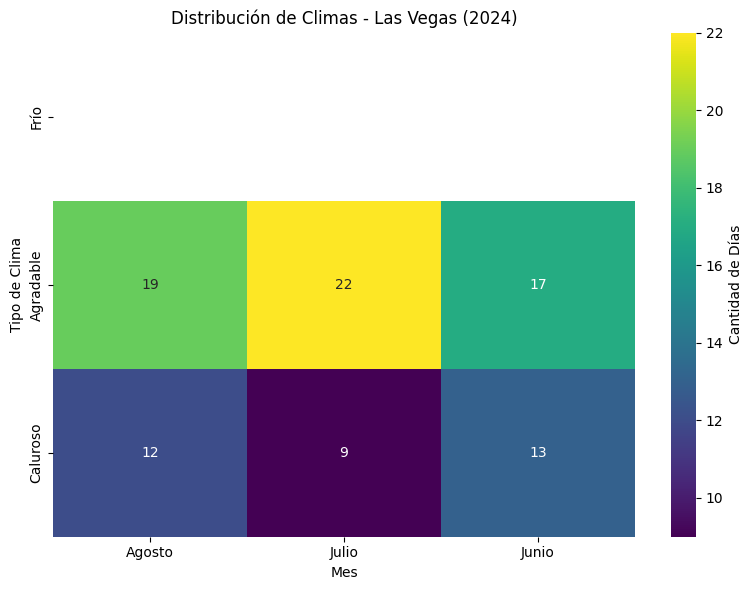

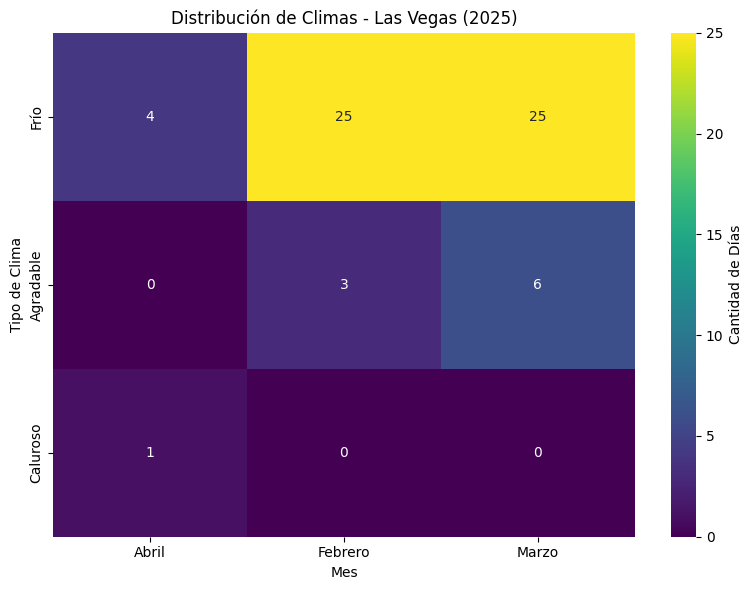


===== Minsk =====


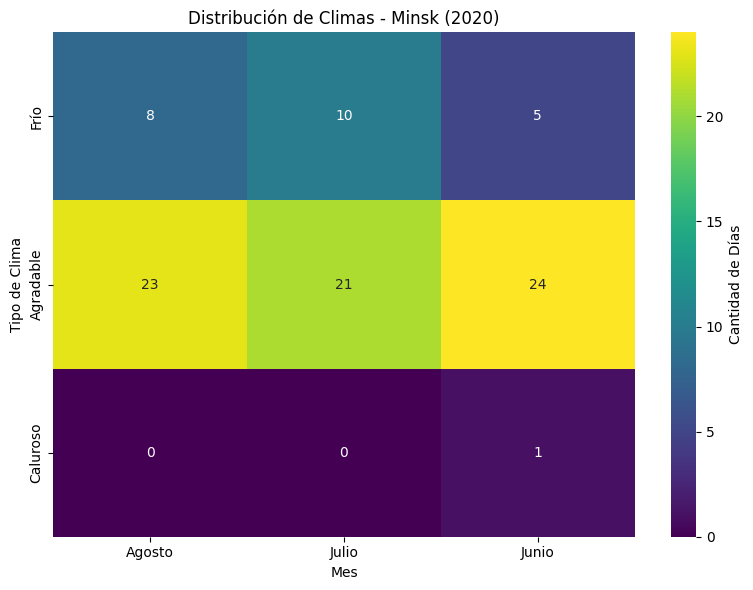

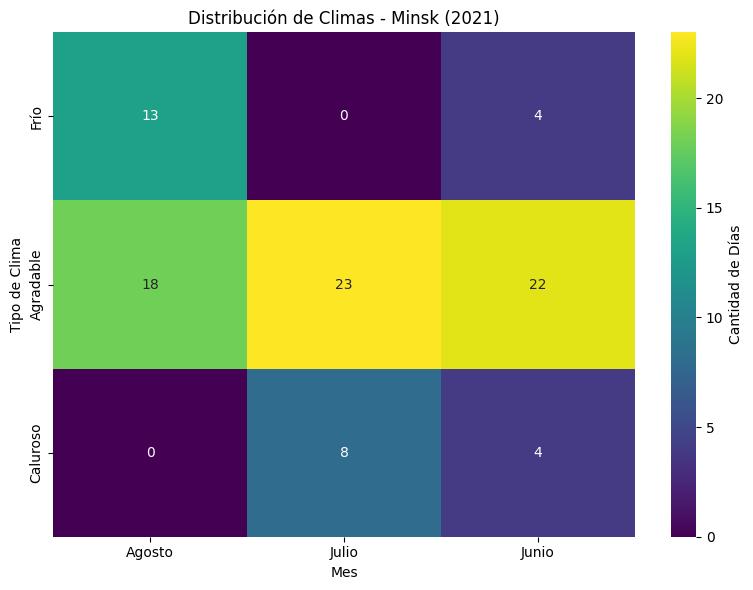

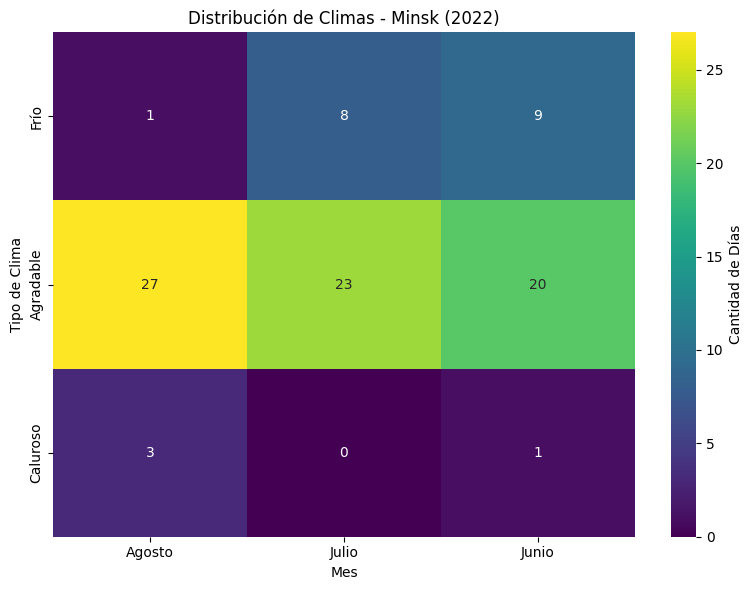

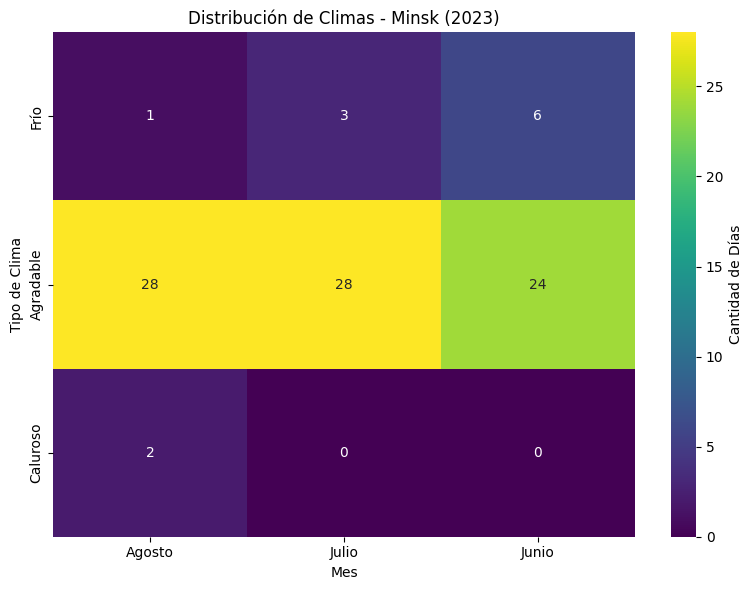

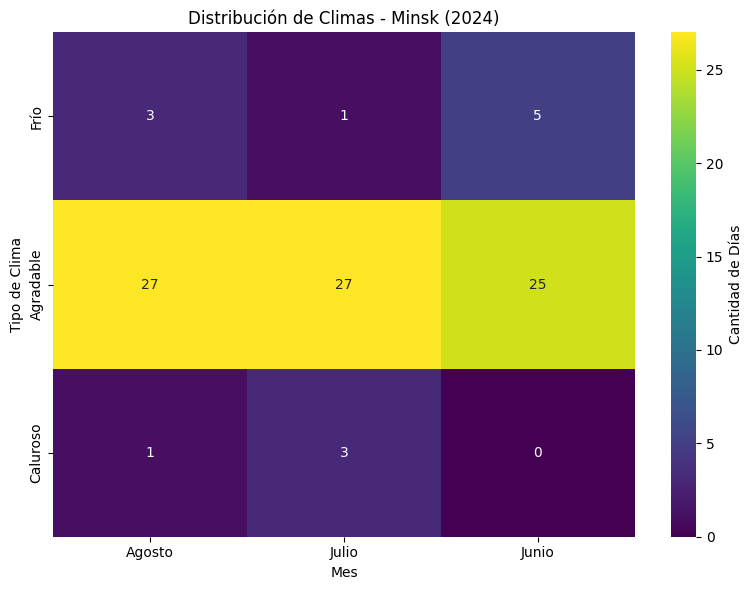

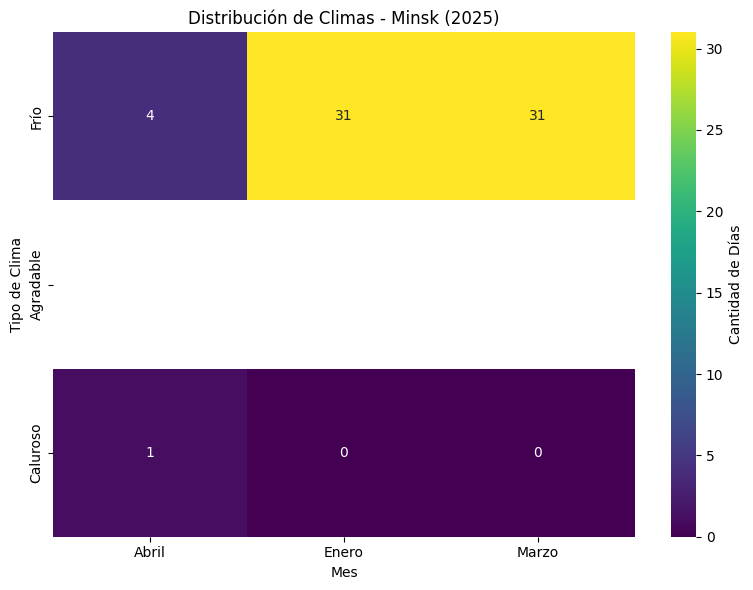


===== Montreal =====


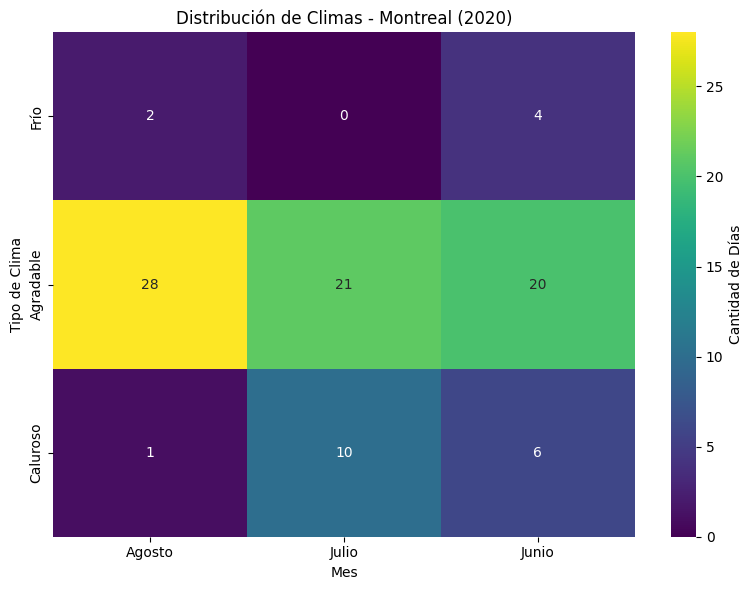

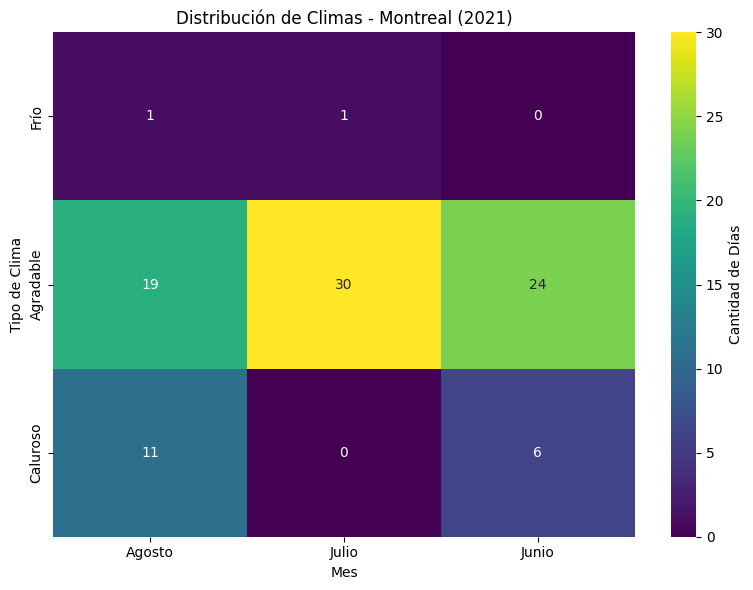

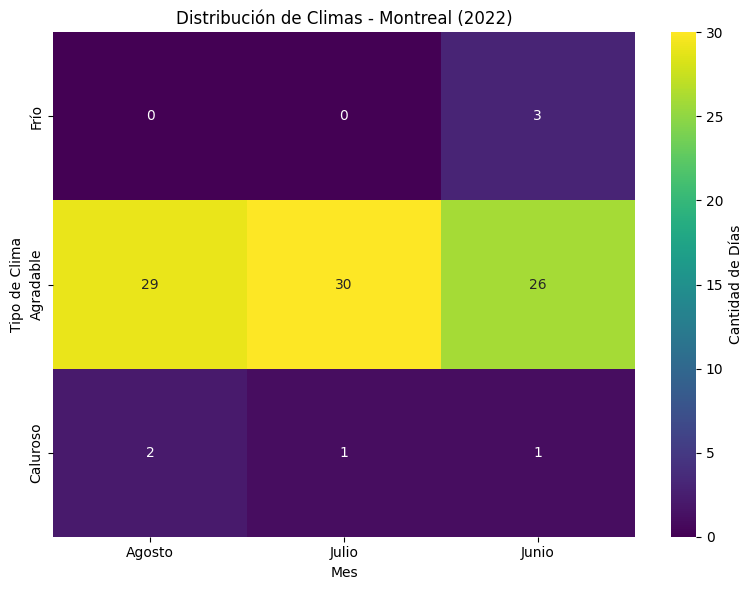

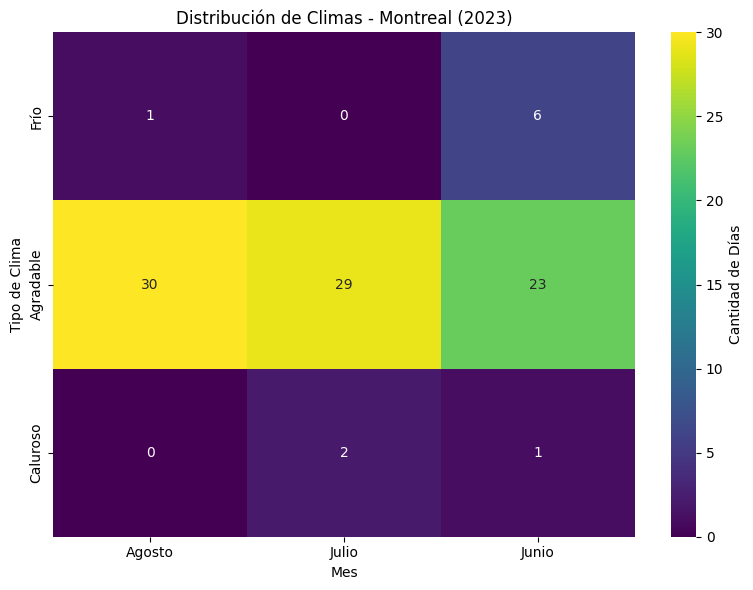

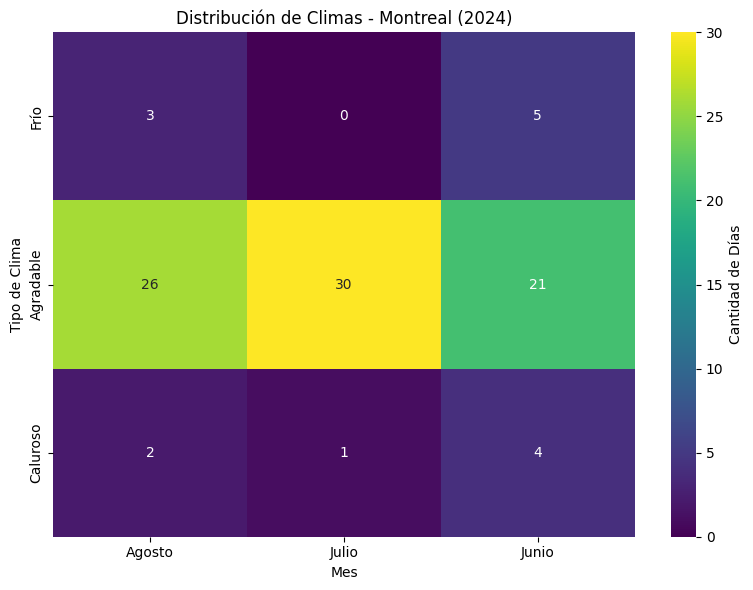

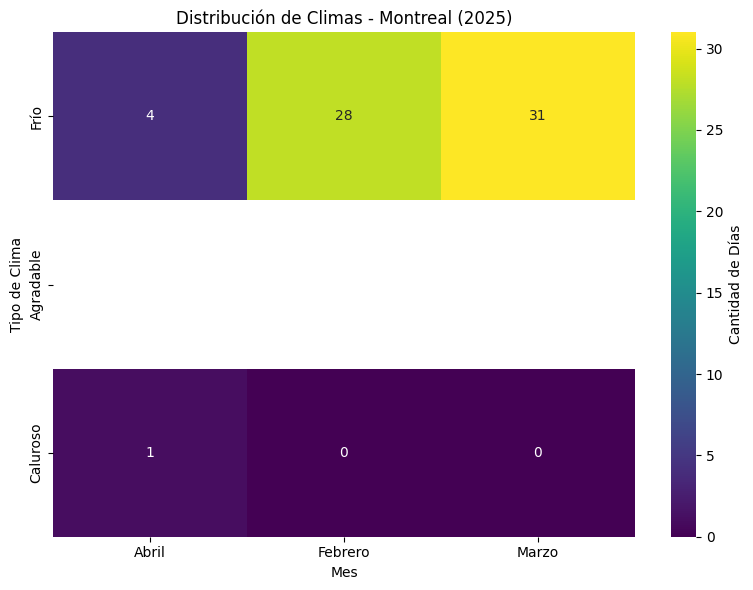


===== Oslo =====


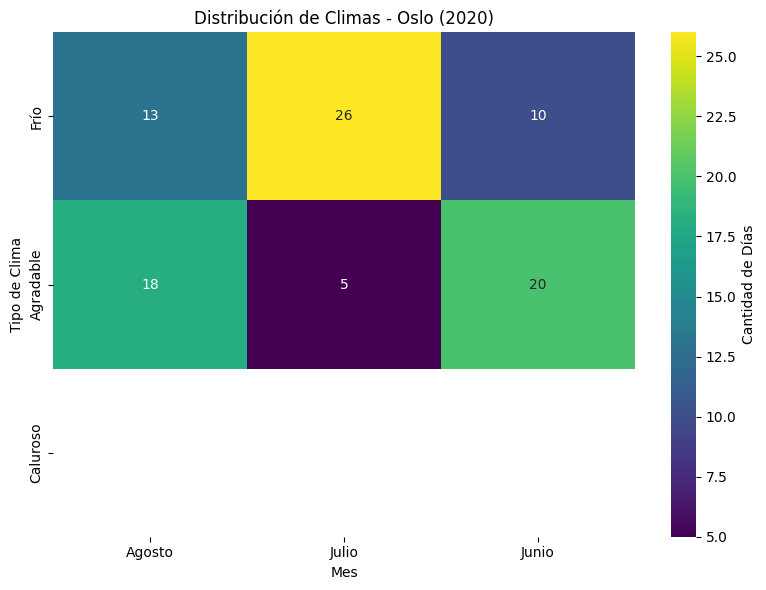

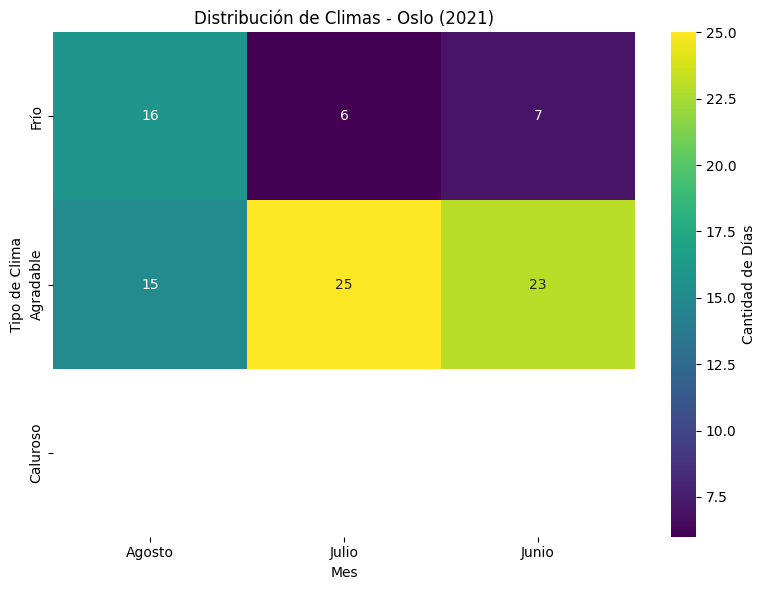

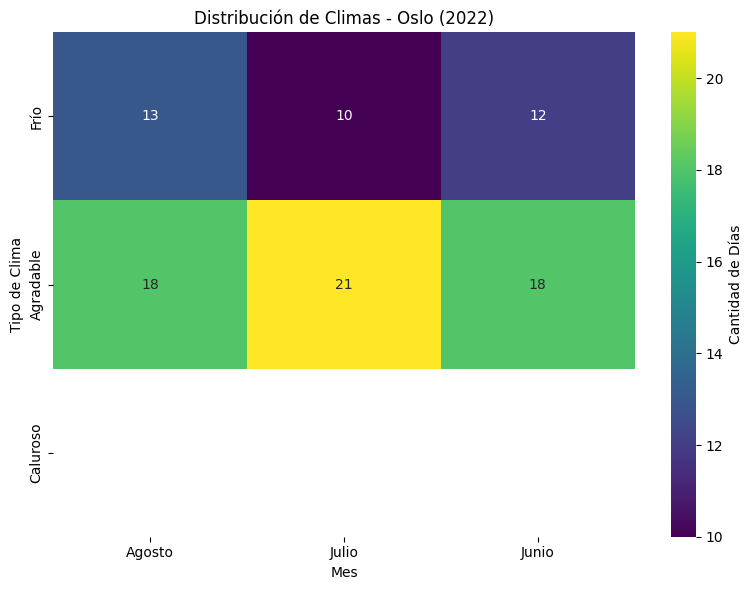

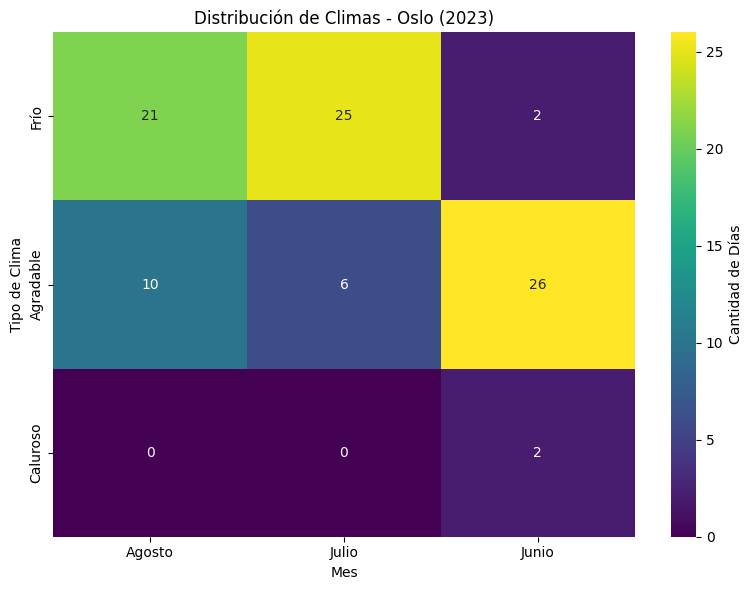

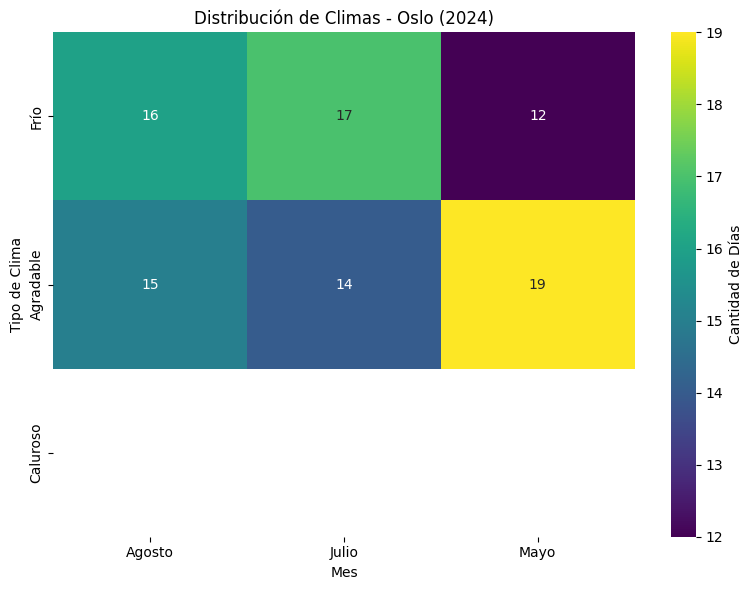

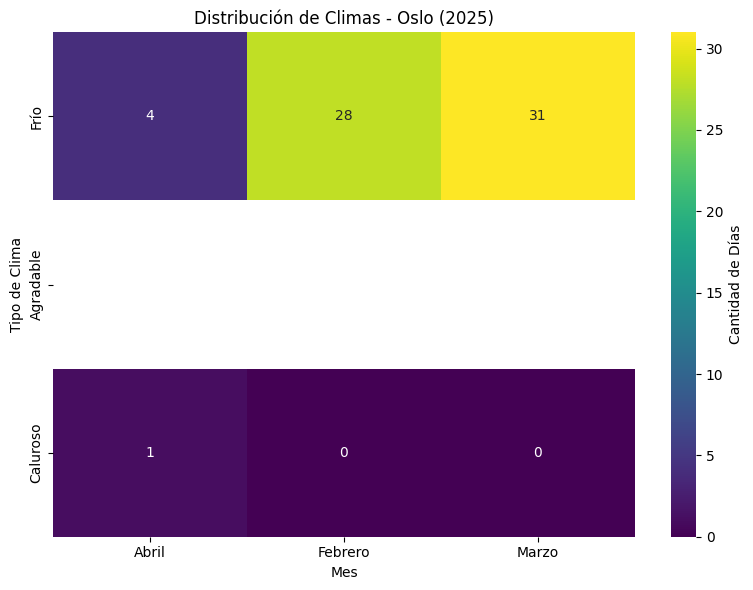


===== Ottawa =====


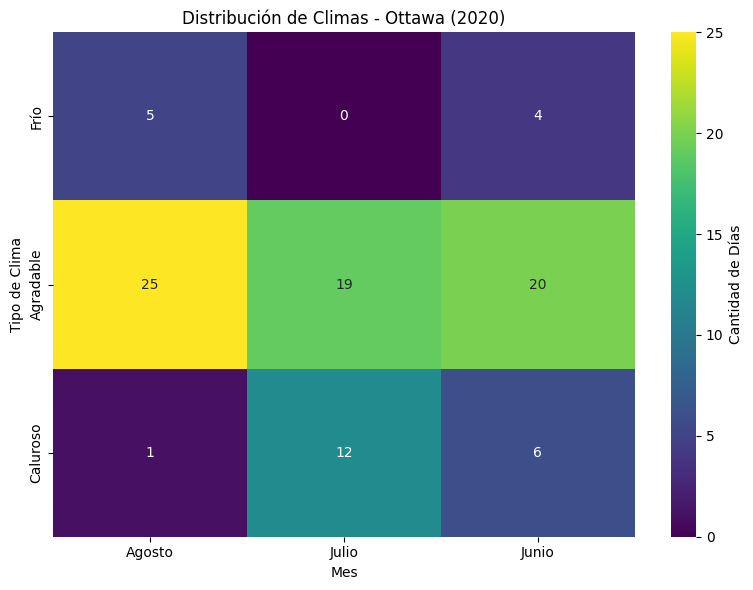

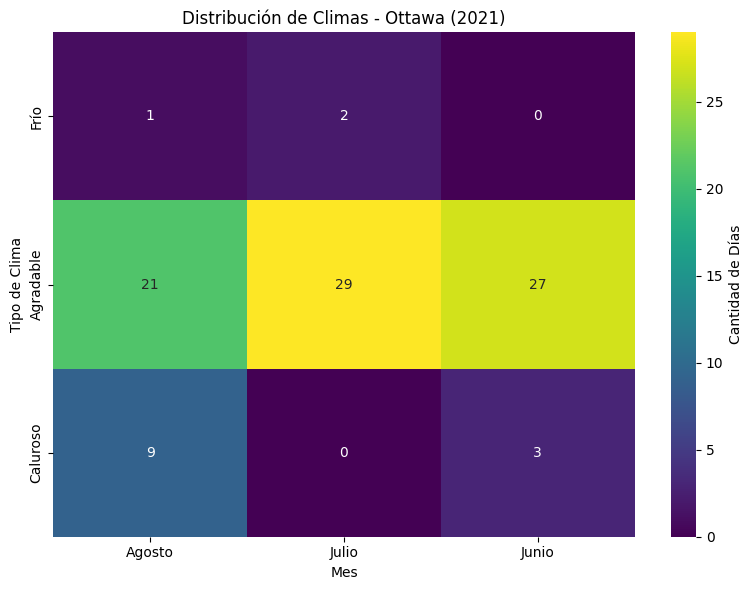

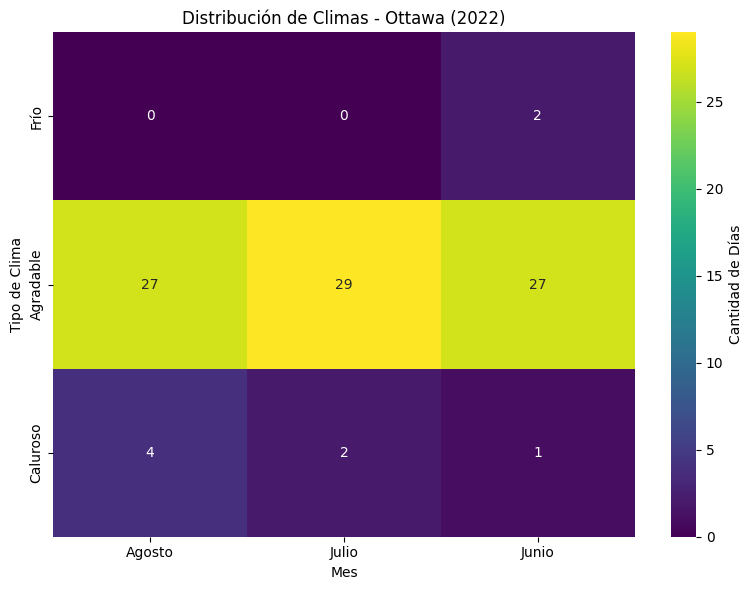

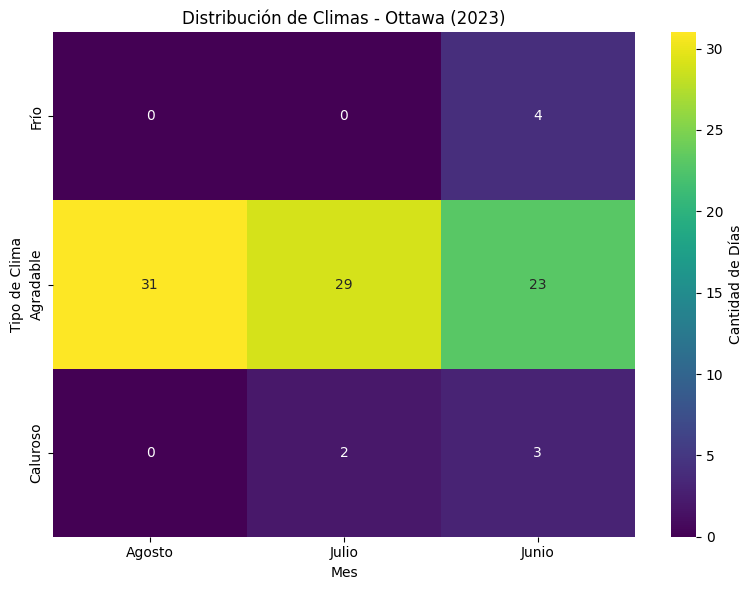

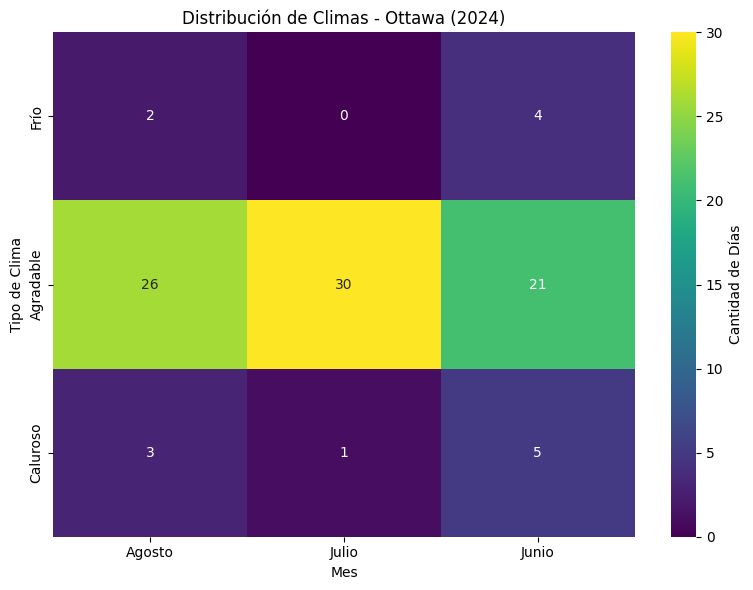

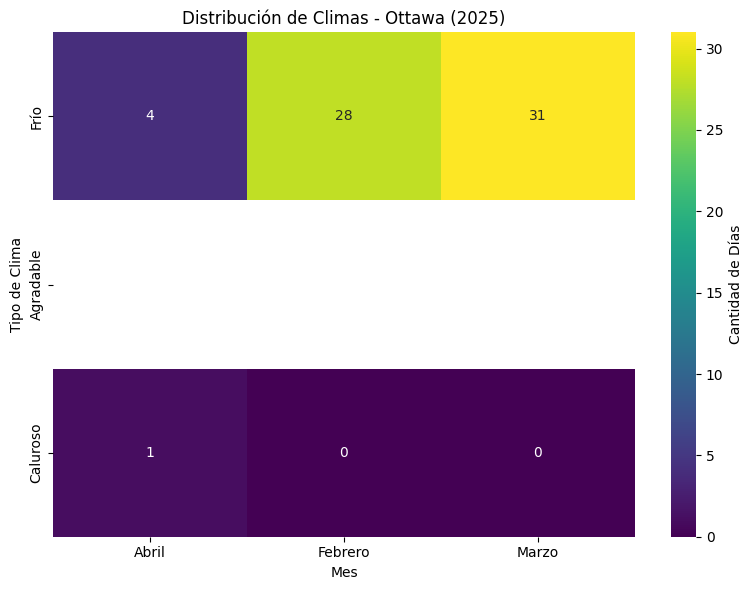


===== Sapporo =====


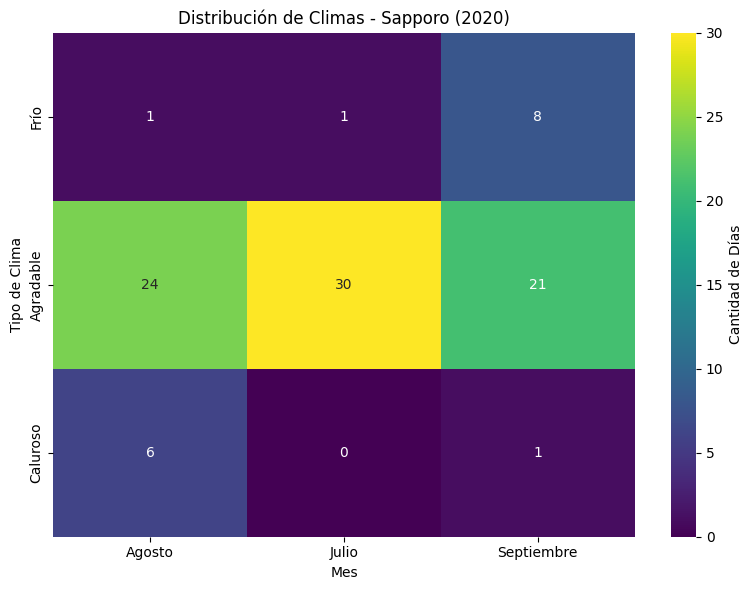

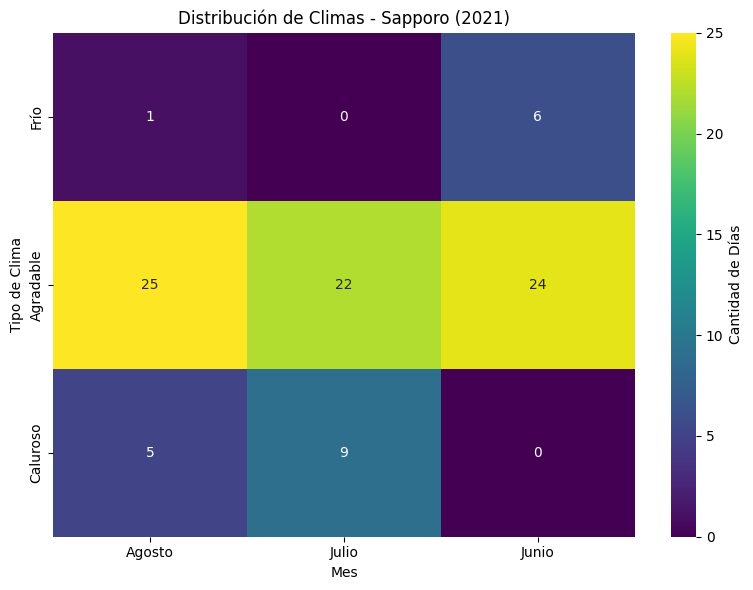

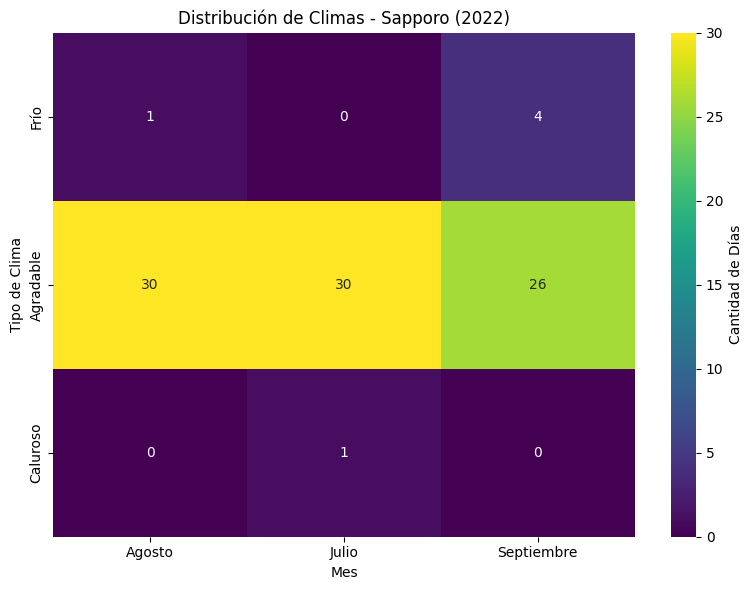

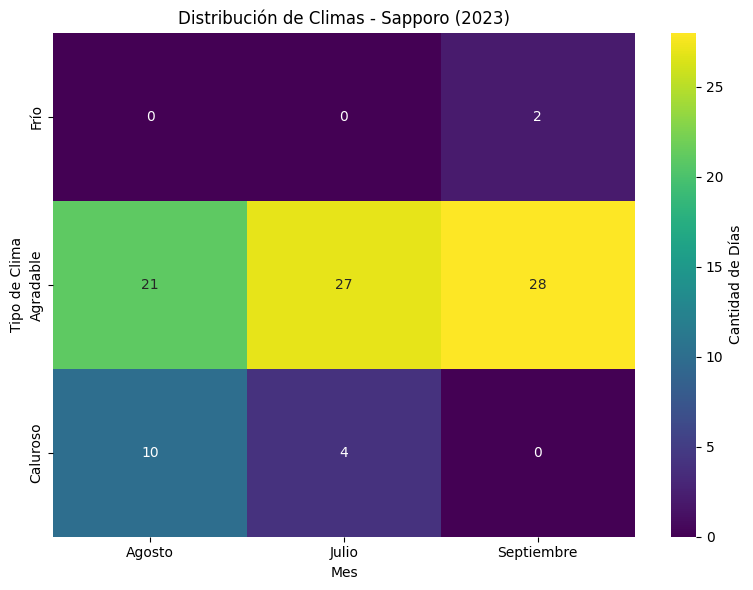

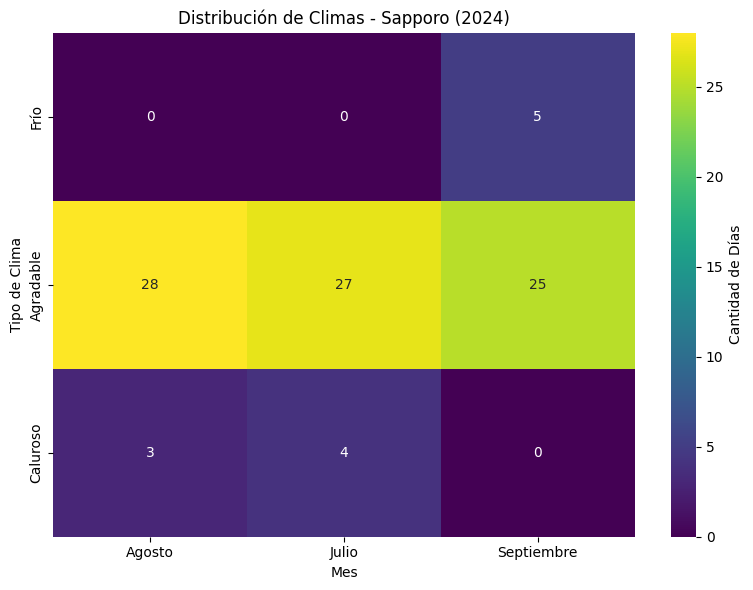

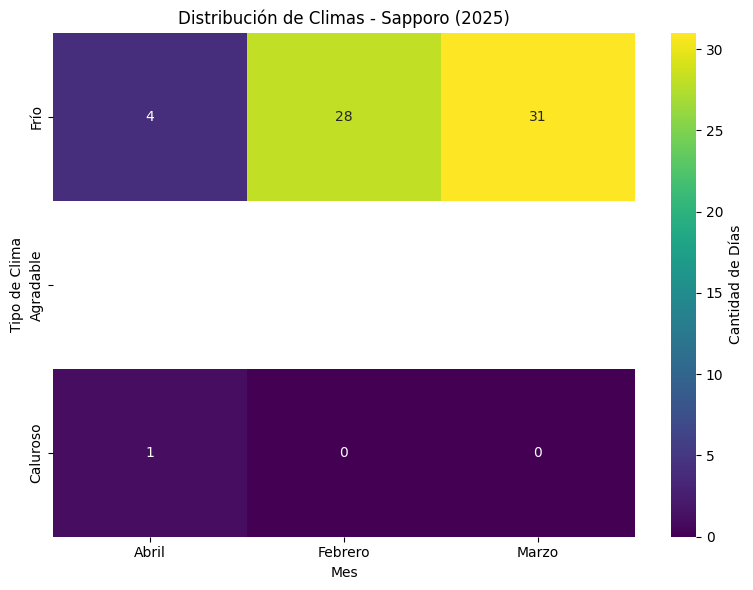


===== Stockholm =====


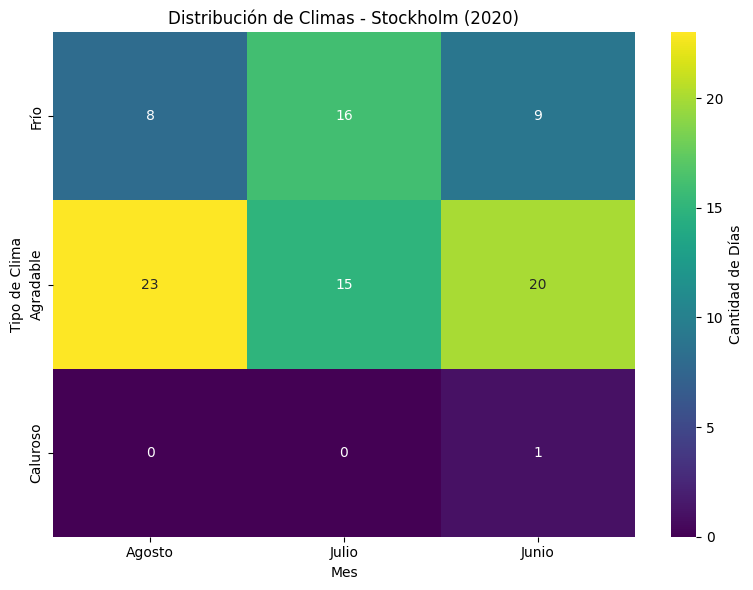

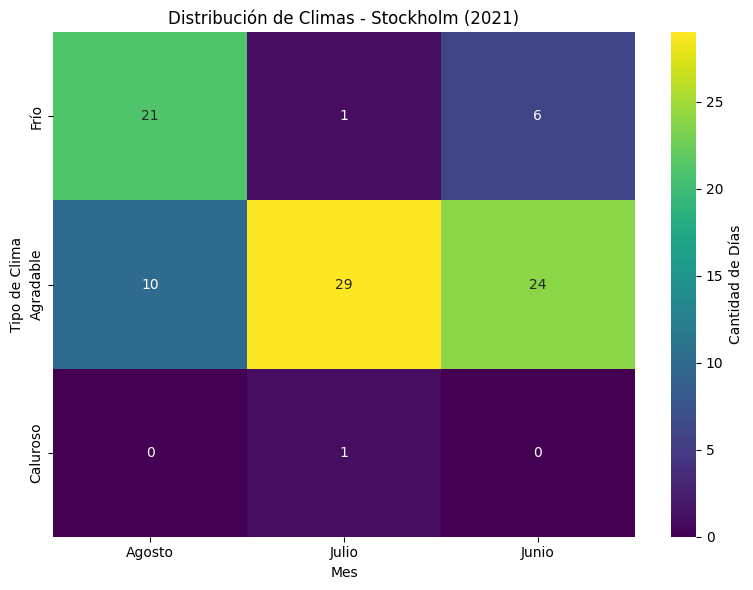

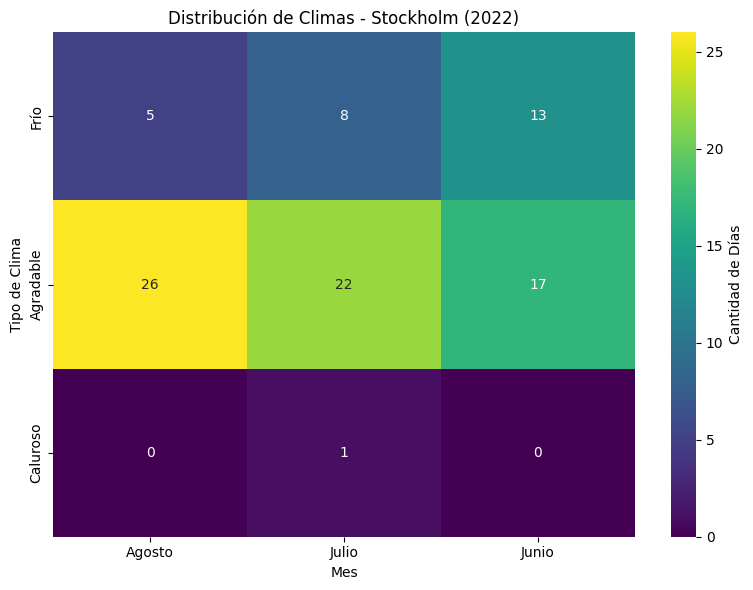

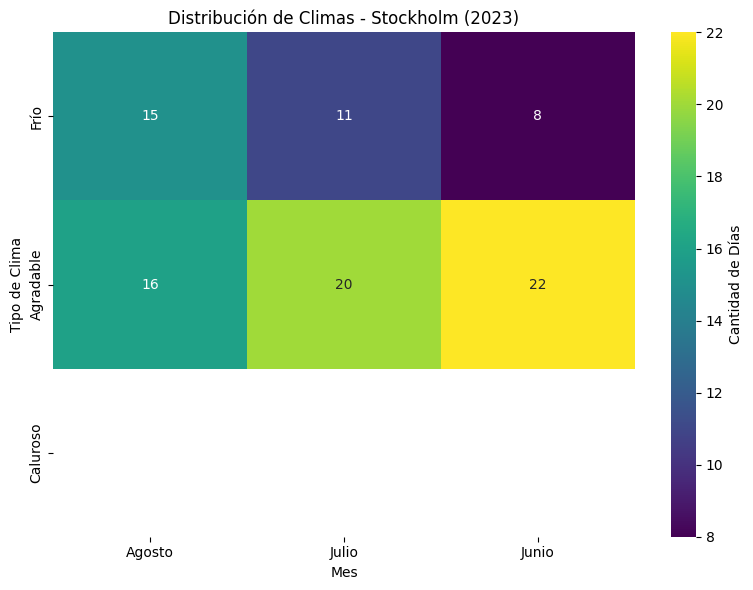

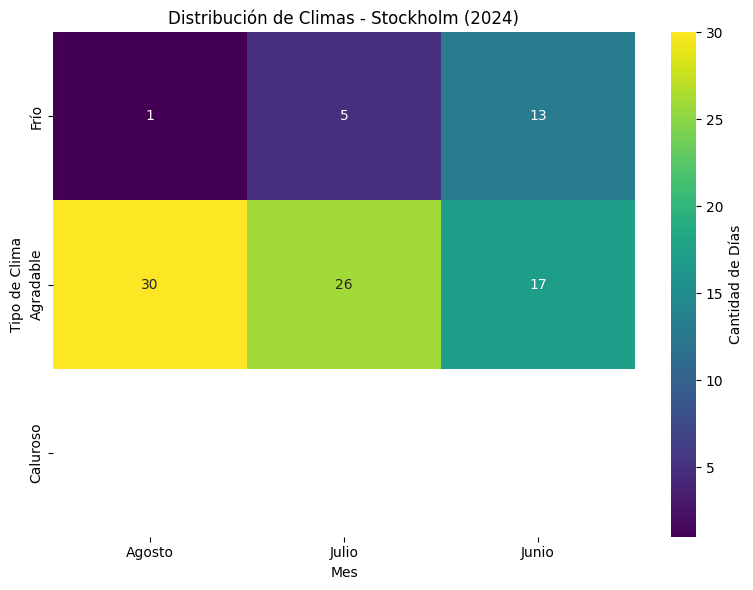

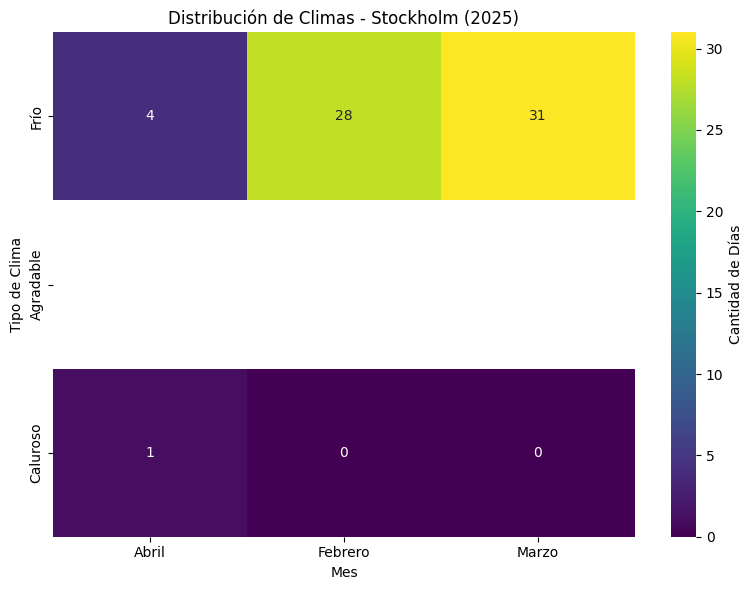


===== Toronto =====


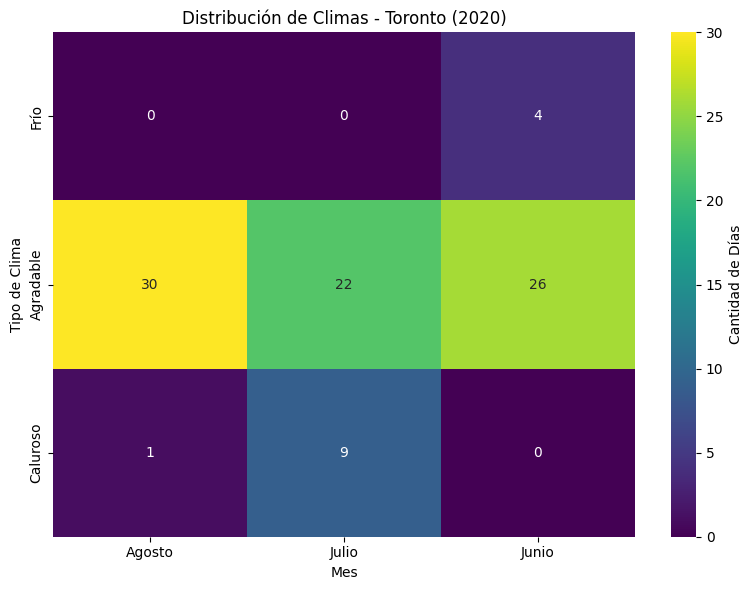

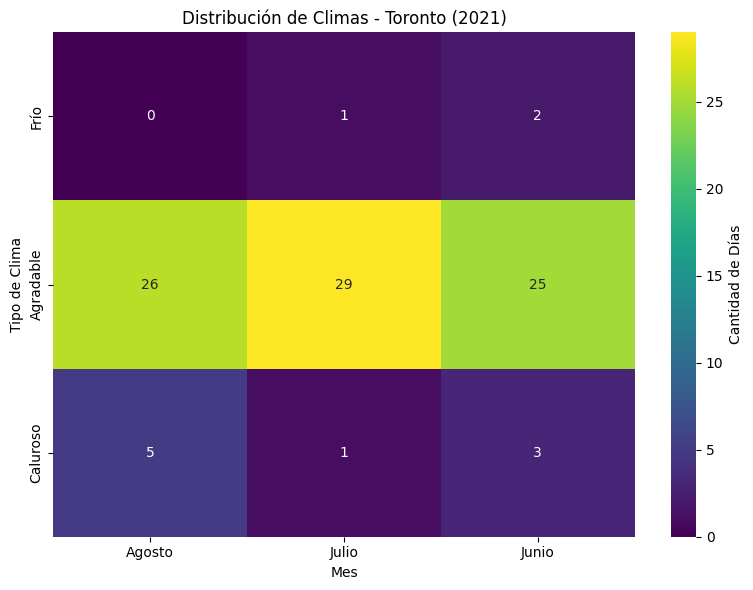

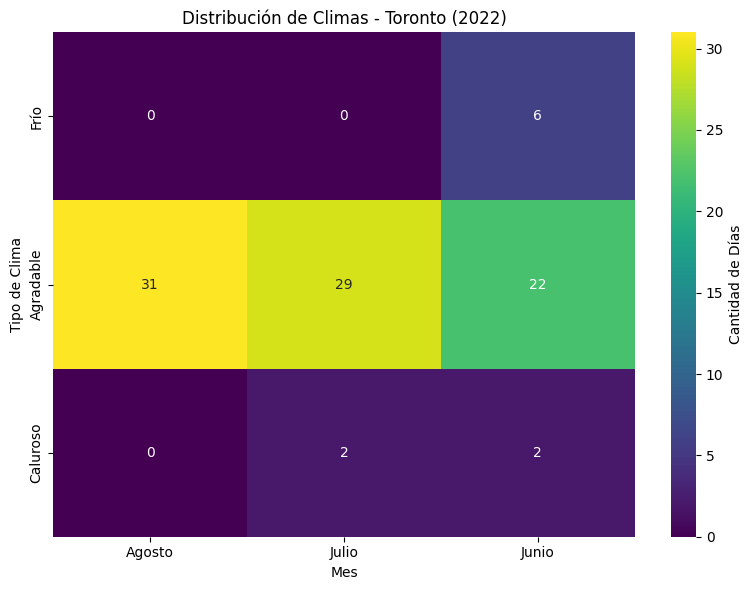

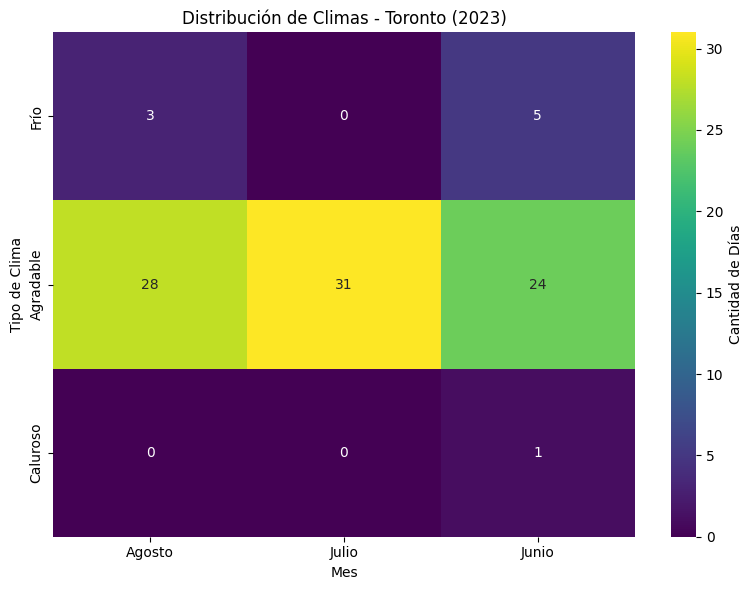

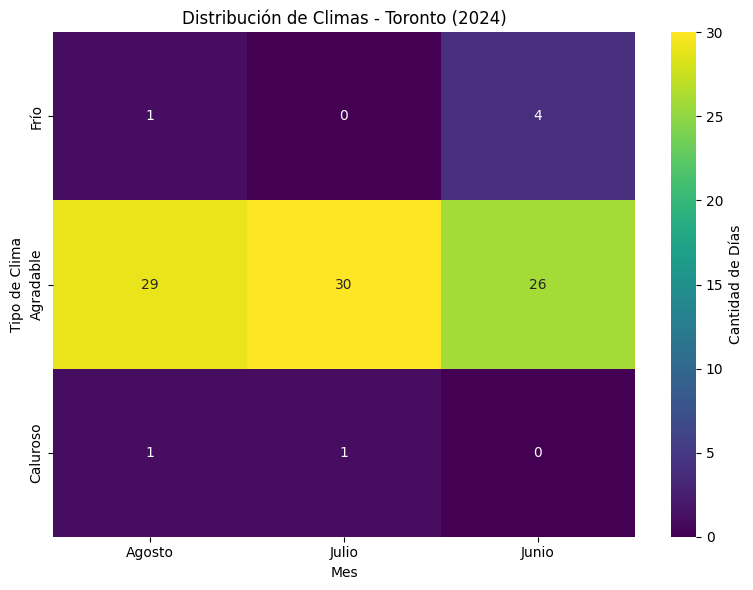

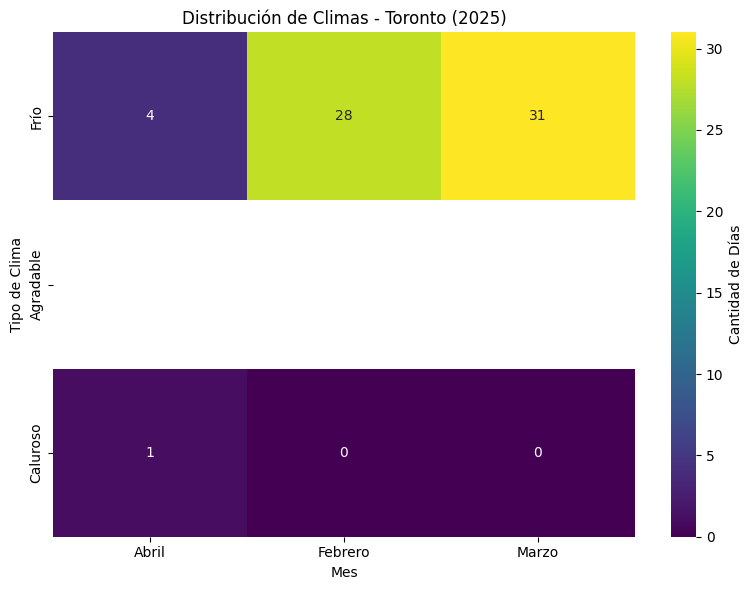

In [108]:
nombres_meses = {
    1: 'Enero', 2: 'Febrero', 3: 'Marzo',
    4: 'Abril', 5: 'Mayo', 6: 'Junio',
    7: 'Julio', 8: 'Agosto', 9: 'Septiembre',
    10: 'Octubre', 11: 'Noviembre', 12: 'Diciembre'
}

for city in ciudades_frio:
    print(f"\n===== {city} =====")
    df_ciudad_fria = df_filtrado_frio[df_filtrado_frio['city_name'] == city]

    for año in df_ciudad_fria['año'].unique():
        df_año = df_ciudad_fria[df_ciudad_fria['año'] == año]

        # Calcular los 3 meses más calurosos
        promedio_max_por_mes = df_año.groupby('mes')['temperature_2m_max'].mean()
        meses_mas_calurosos = promedio_max_por_mes.sort_values(ascending=False).head(3).index.tolist()

        # Filtrar días de esos meses
        df_dias = df_año[df_año['mes'].isin(meses_mas_calurosos)][['dia', 'mes', 'temperature_2m_max']].copy()

        # Clasificación climática
        def clasificar_clima(temp):
            if temp < 20:
                return 'Frío'
            elif 20 <= temp < 30:
                return 'Agradable'
            else:
                return 'Caluroso'

        df_dias['Clima'] = df_dias['temperature_2m_max'].apply(clasificar_clima)
        df_dias['Mes_nombre'] = df_dias['mes'].map(nombres_meses)

        # Crear tabla cruzada
        df_heat = pd.crosstab(df_dias['Clima'], df_dias['Mes_nombre'])

        # Asegurar orden de filas
        orden_clima = ['Frío', 'Agradable', 'Caluroso']
        df_heat = df_heat.reindex(index=orden_clima)

        # Crear heatmap
        plt.figure(figsize=(8, 6))
        sns.heatmap(df_heat, annot=True, cmap='viridis', fmt='.0f', cbar_kws={"label": "Cantidad de Días"})
        plt.title(f"Distribución de Climas - {city} ({año})")
        plt.xlabel('Mes')
        plt.ylabel('Tipo de Clima')
        plt.tight_layout()
        plt.show()

###Periodos frios


===== Calgary =====


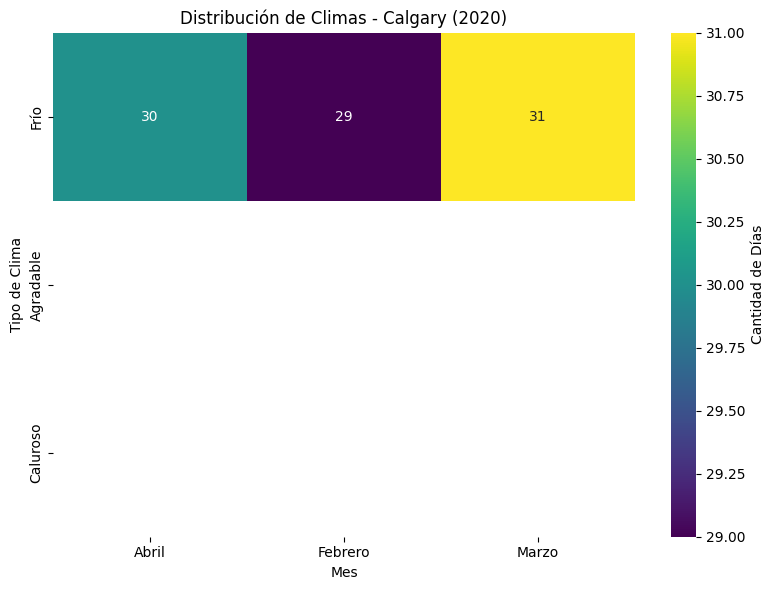

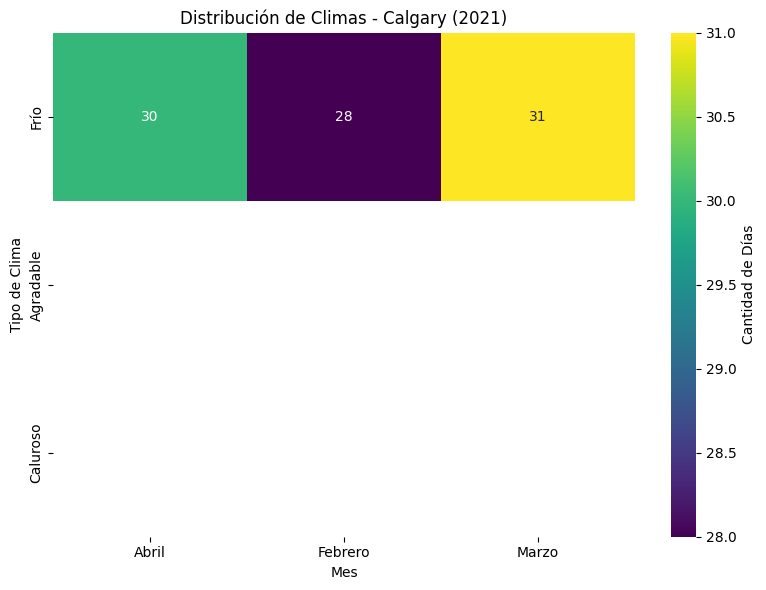

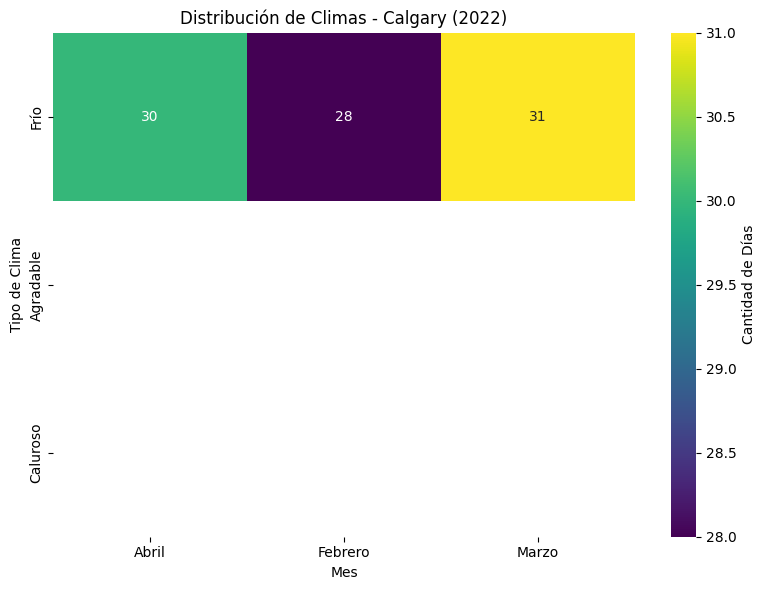

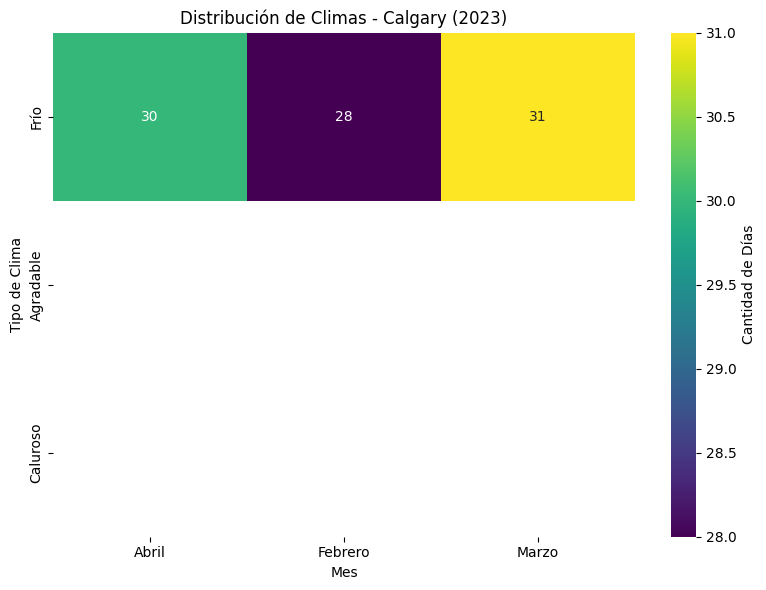

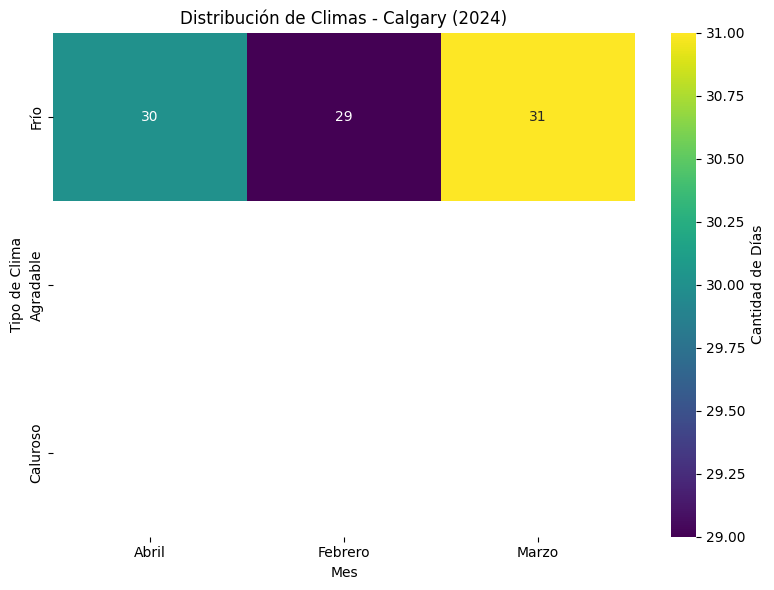

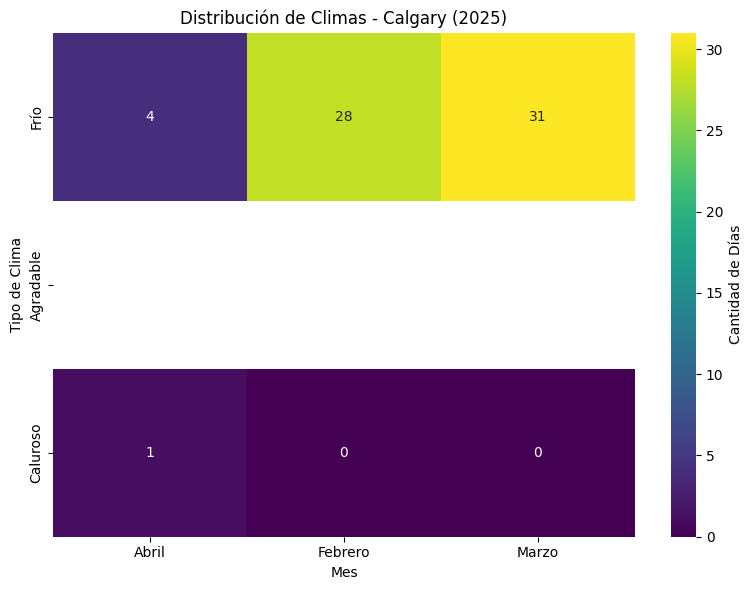


===== Helsinki =====


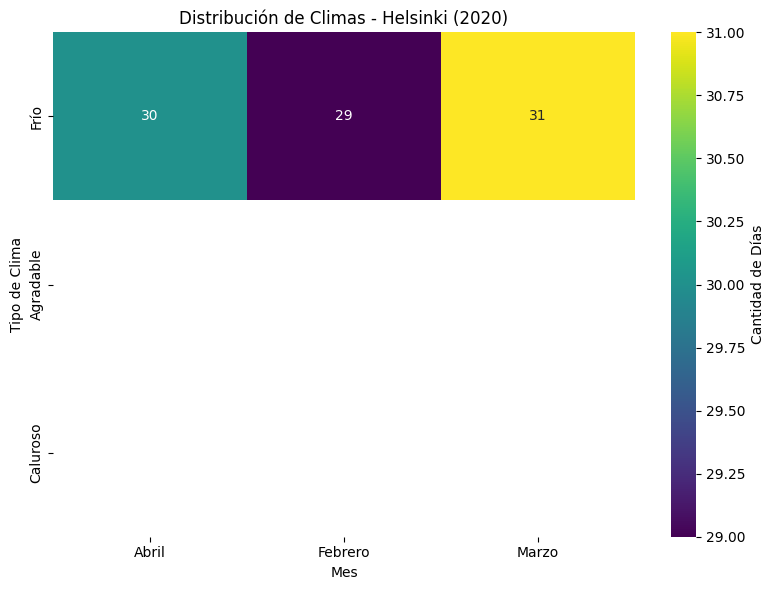

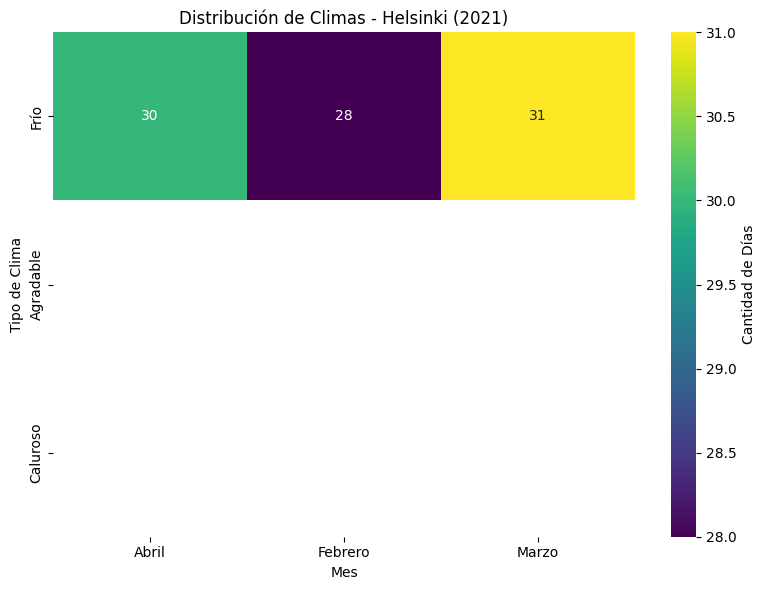

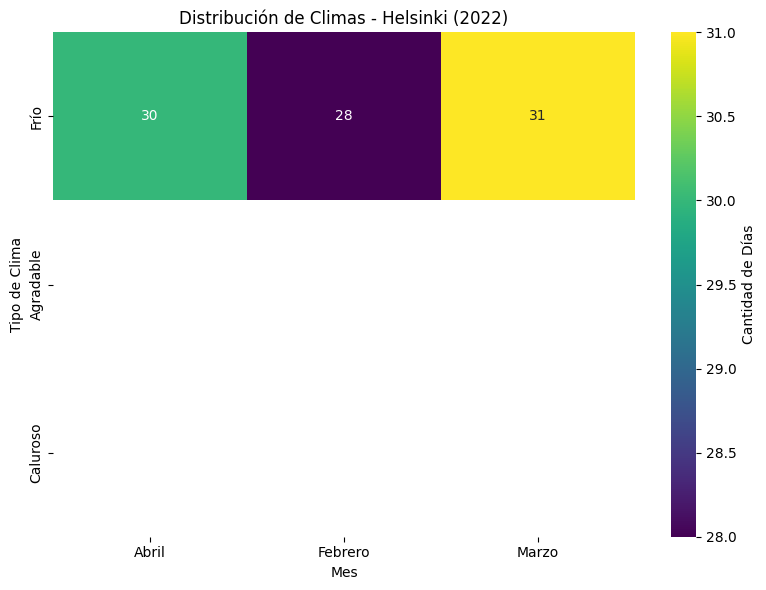

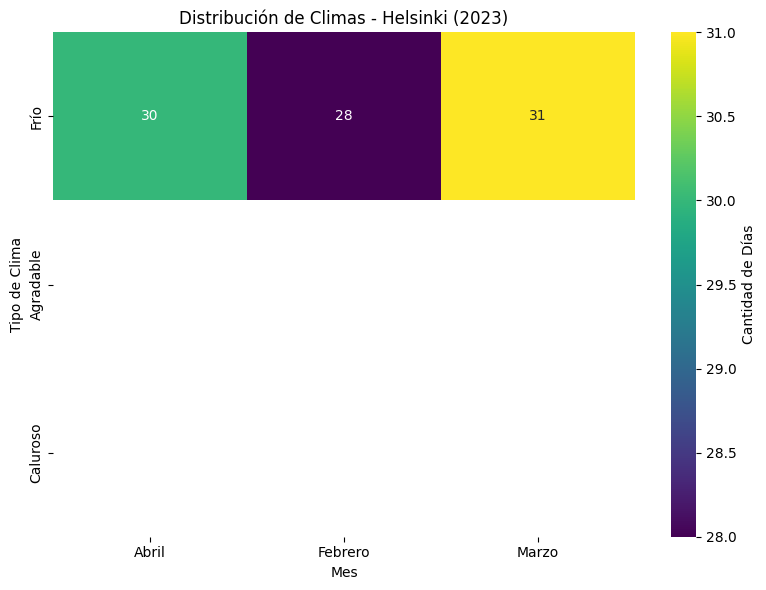

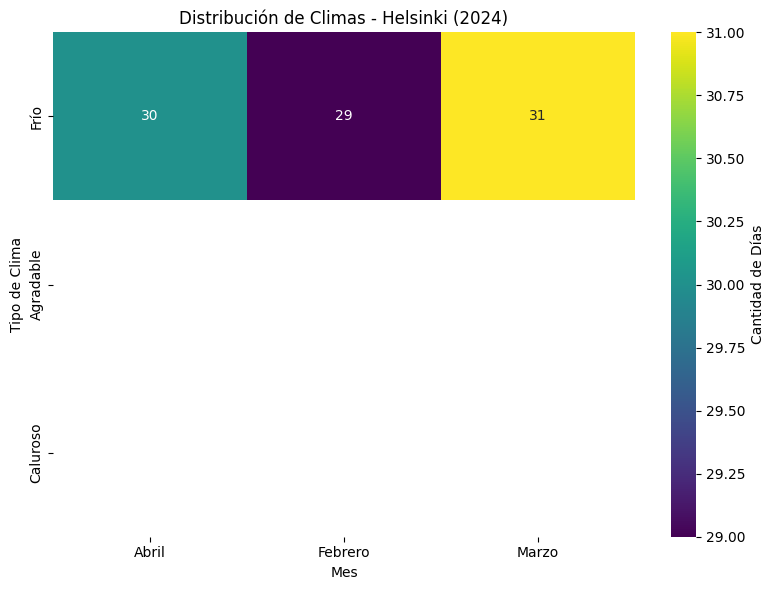

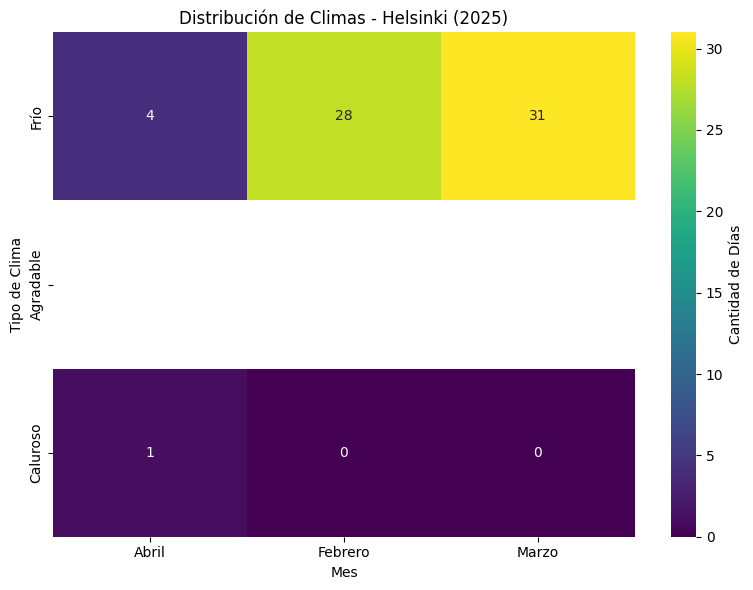


===== Las Vegas =====


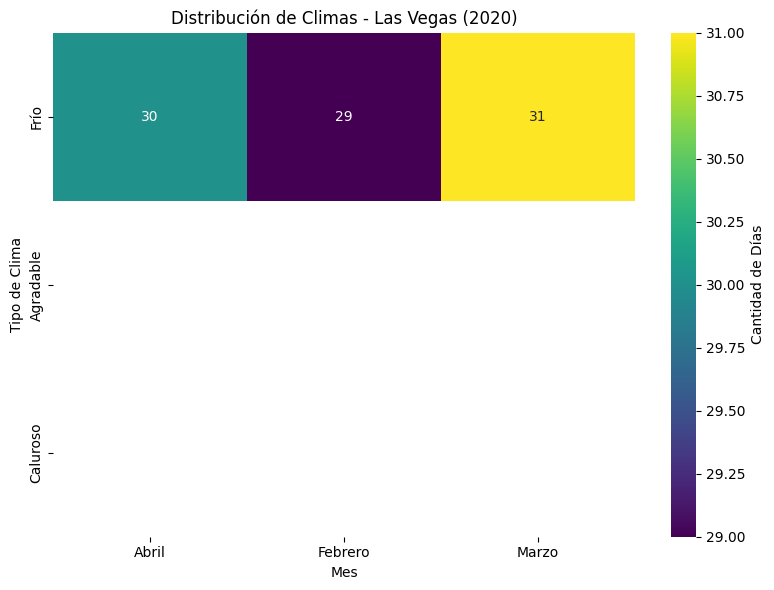

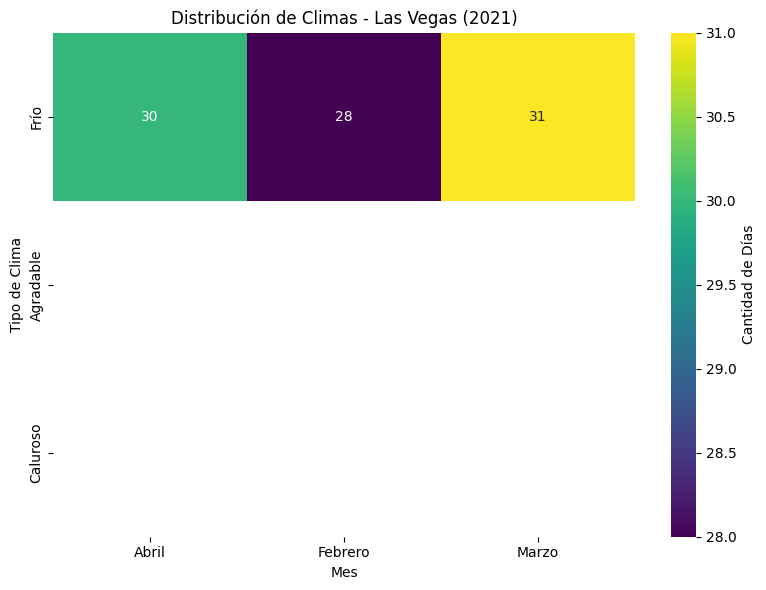

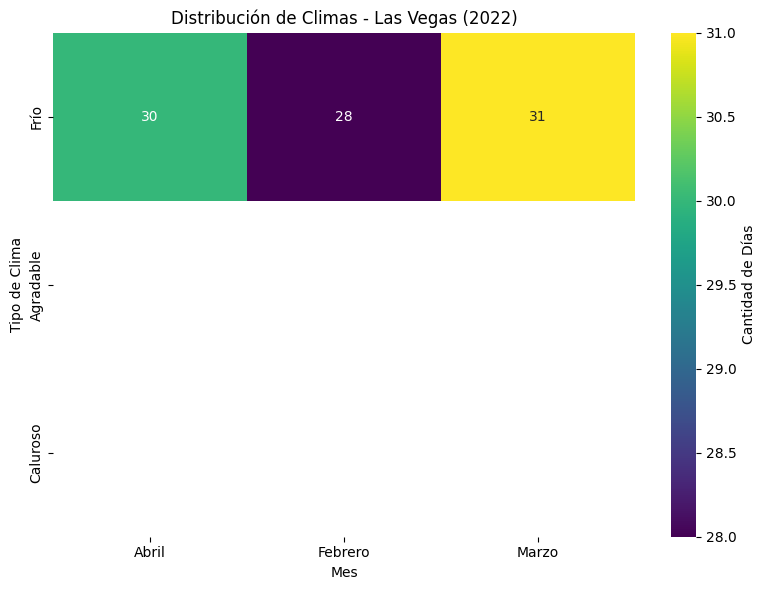

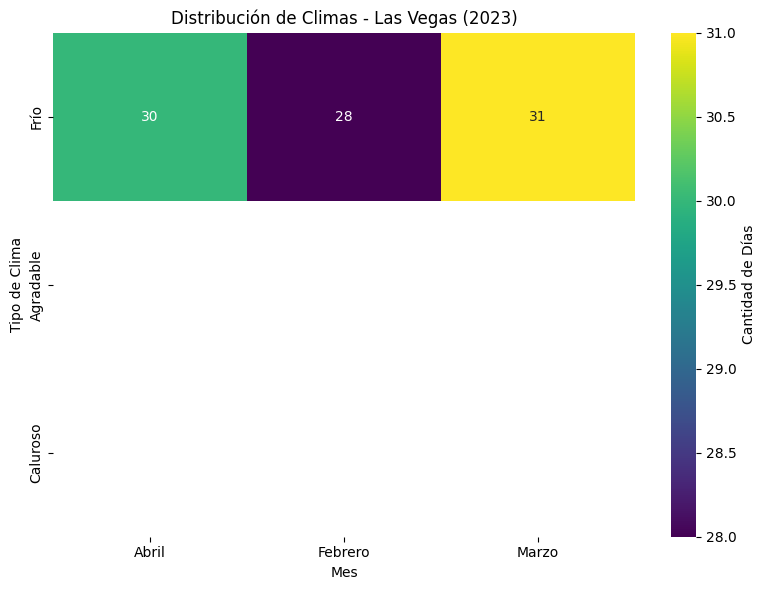

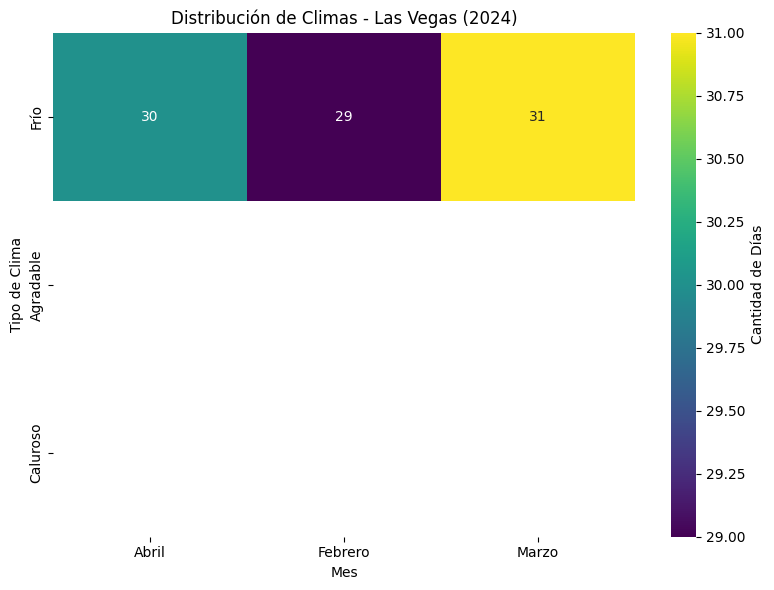

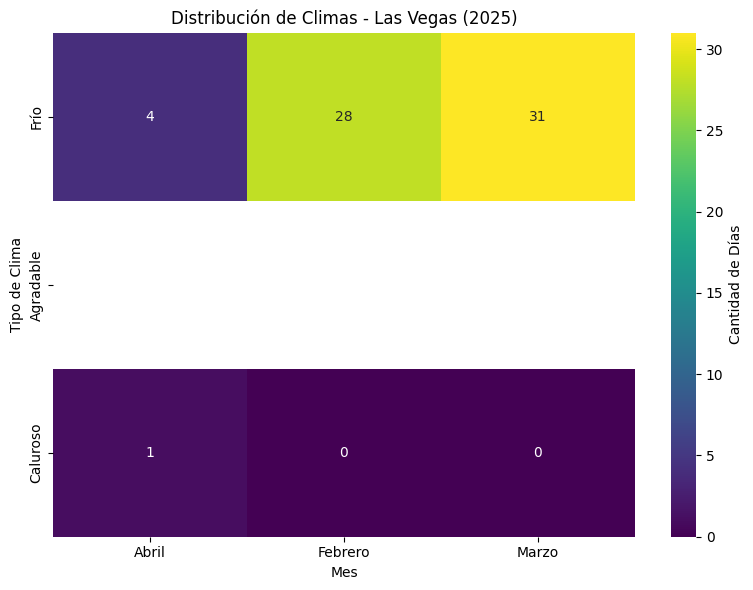


===== Minsk =====


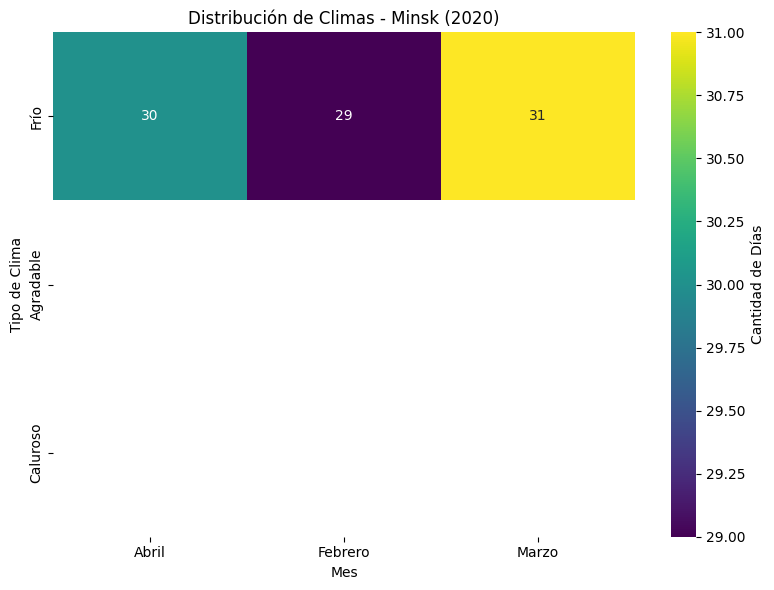

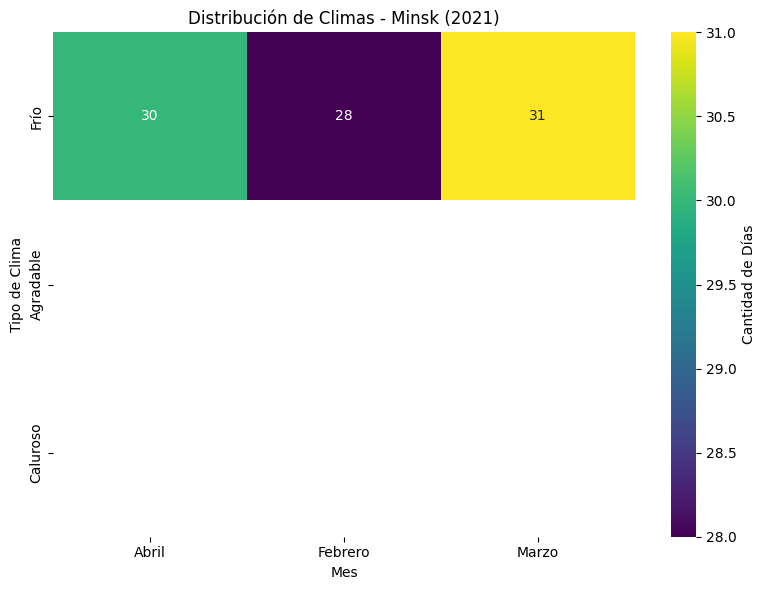

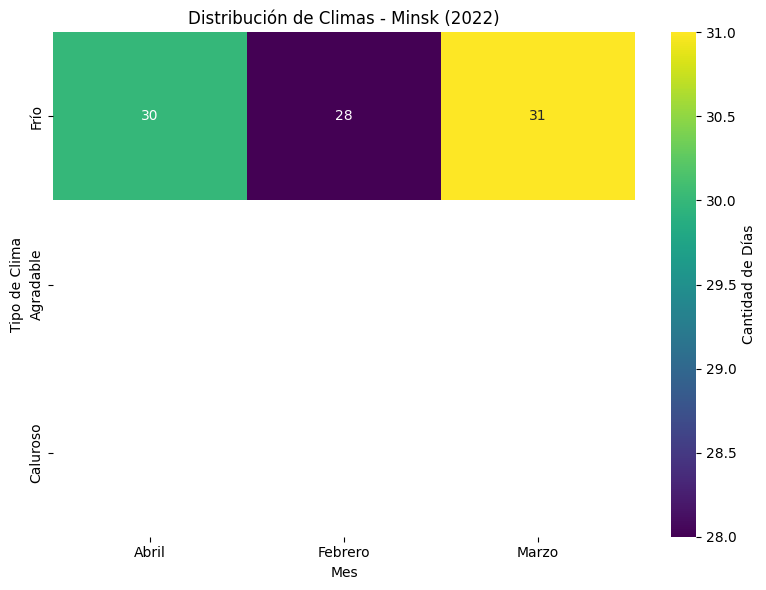

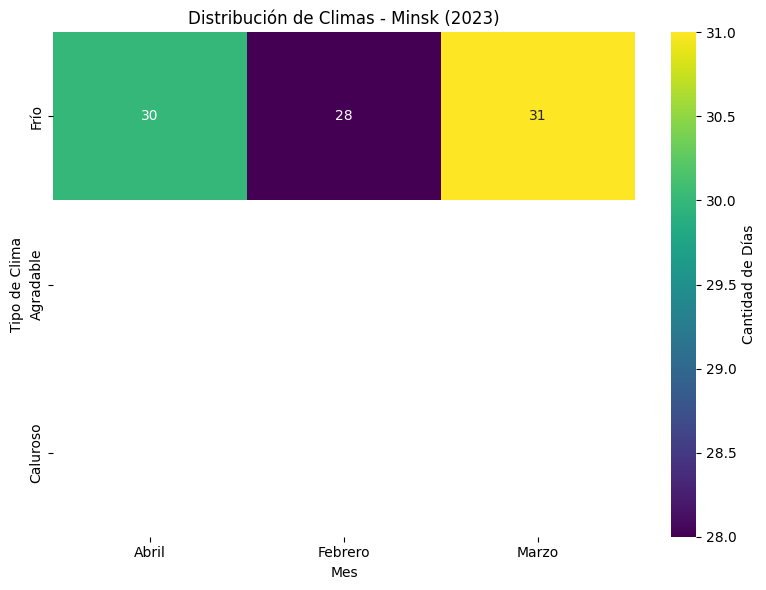

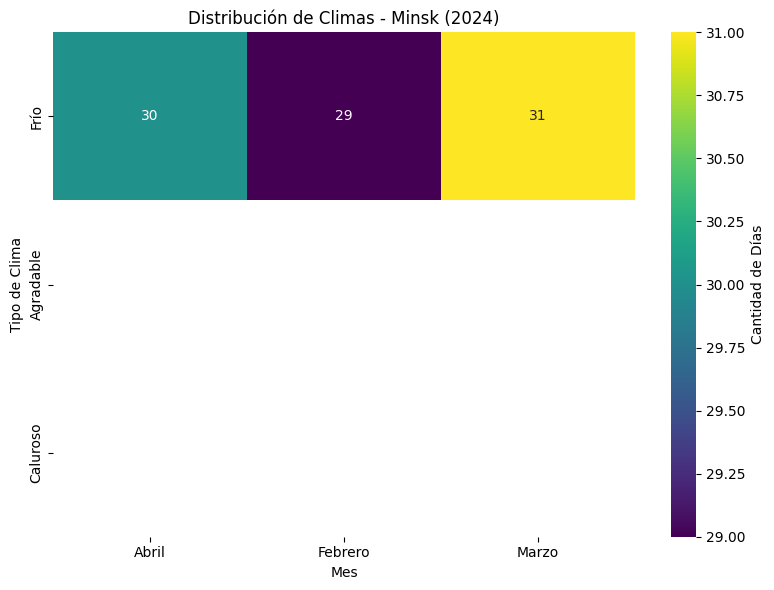

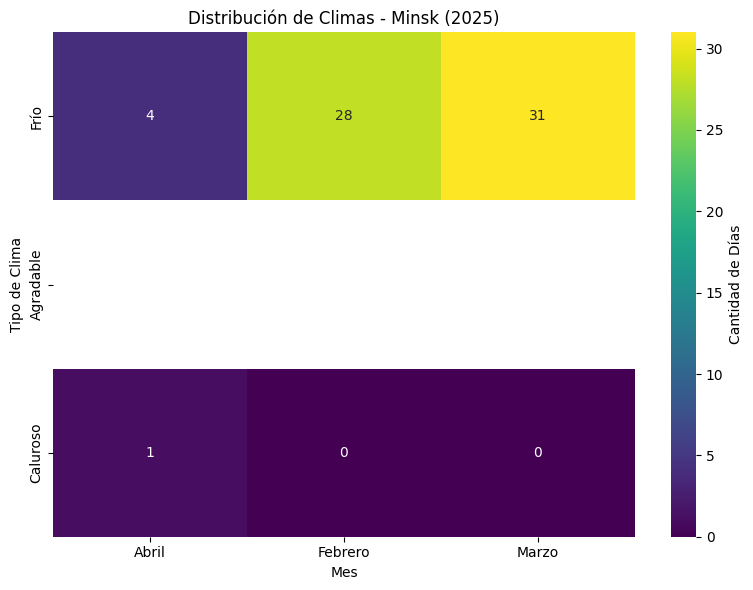


===== Montreal =====


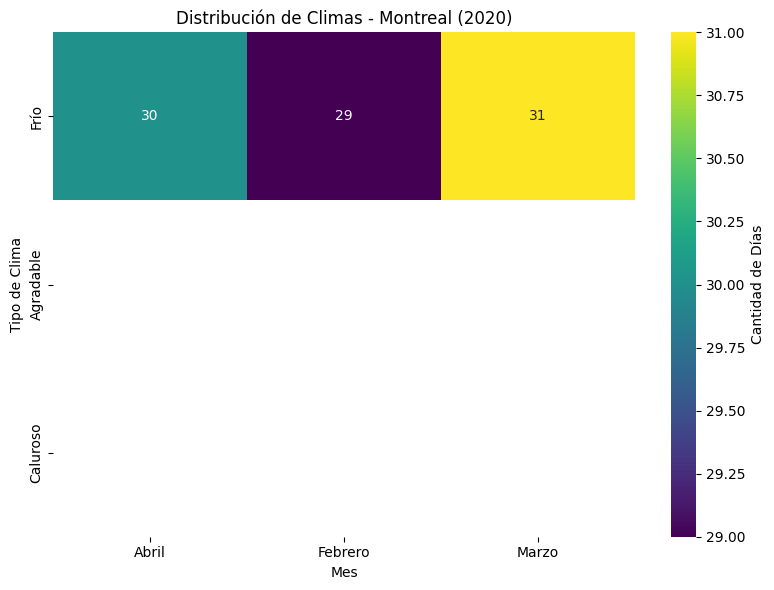

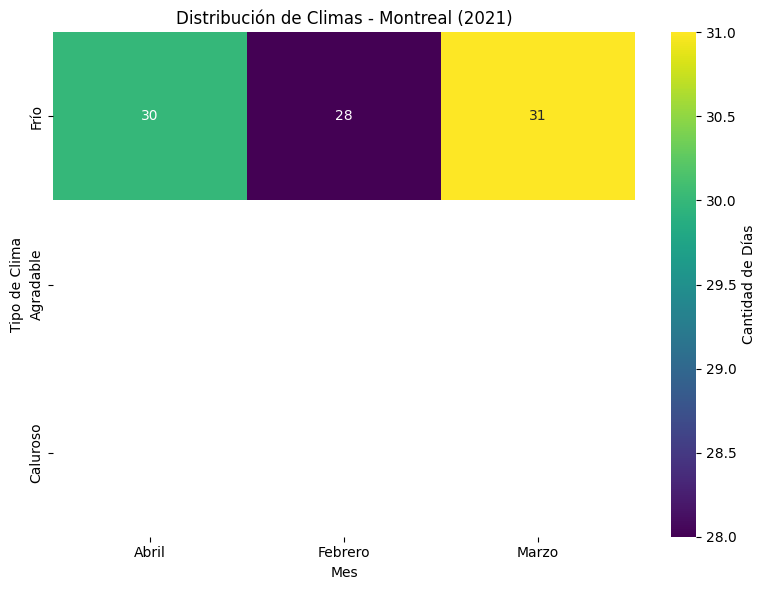

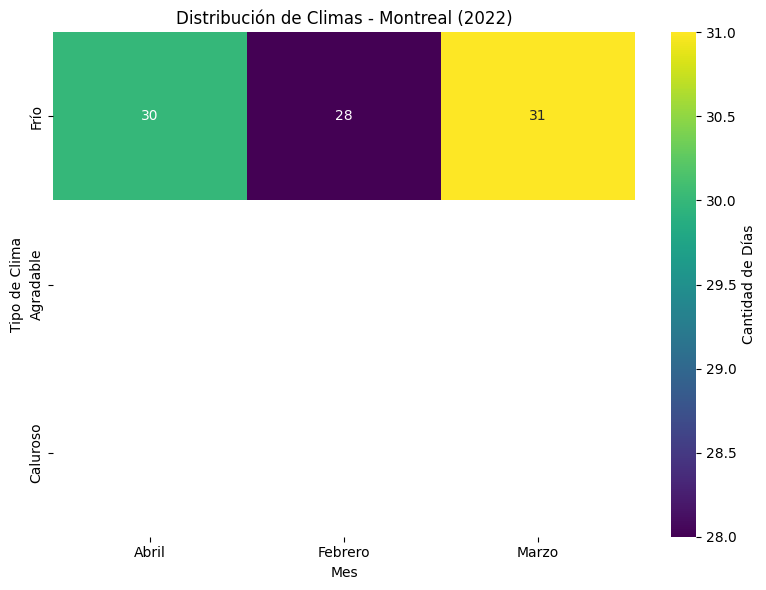

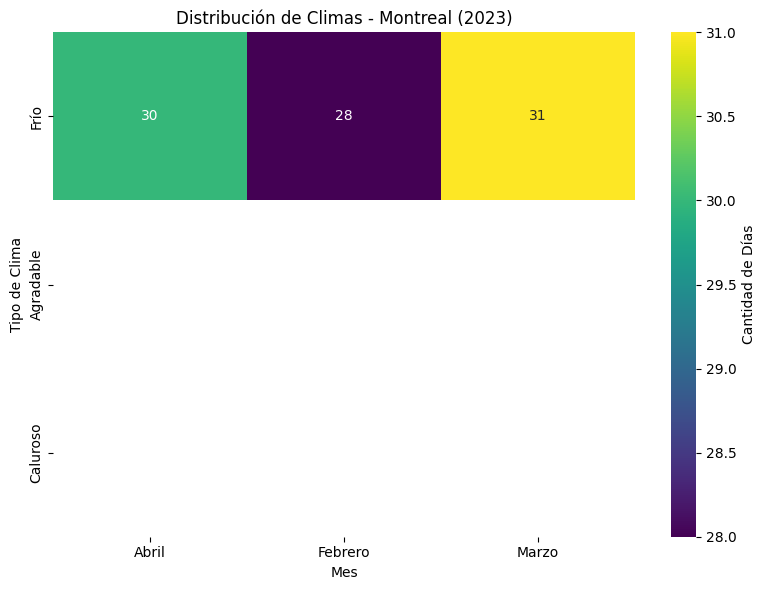

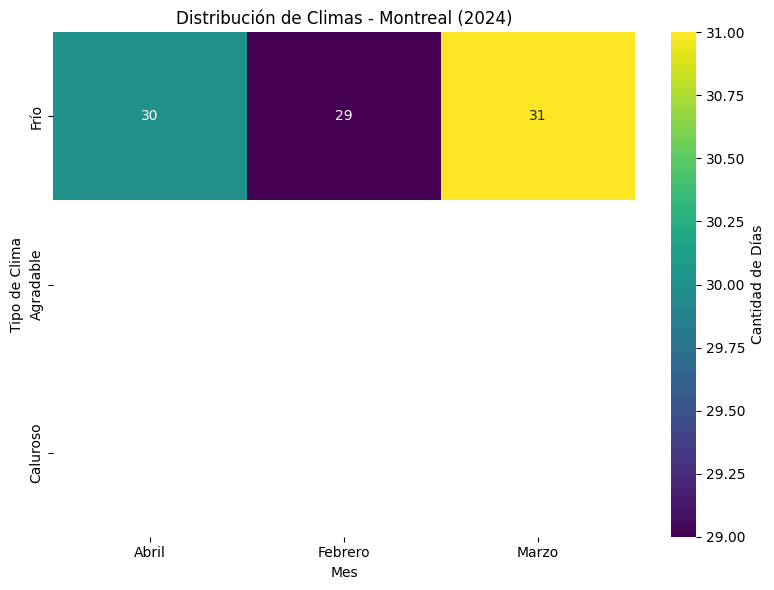

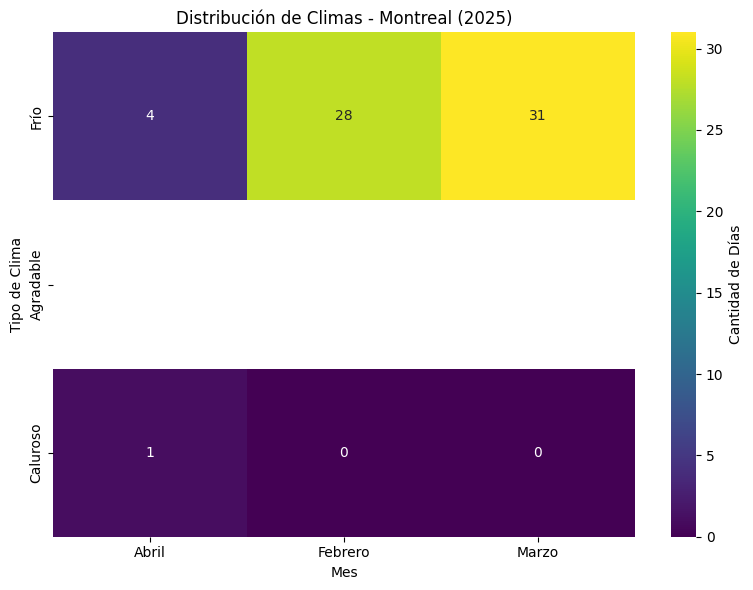


===== Oslo =====


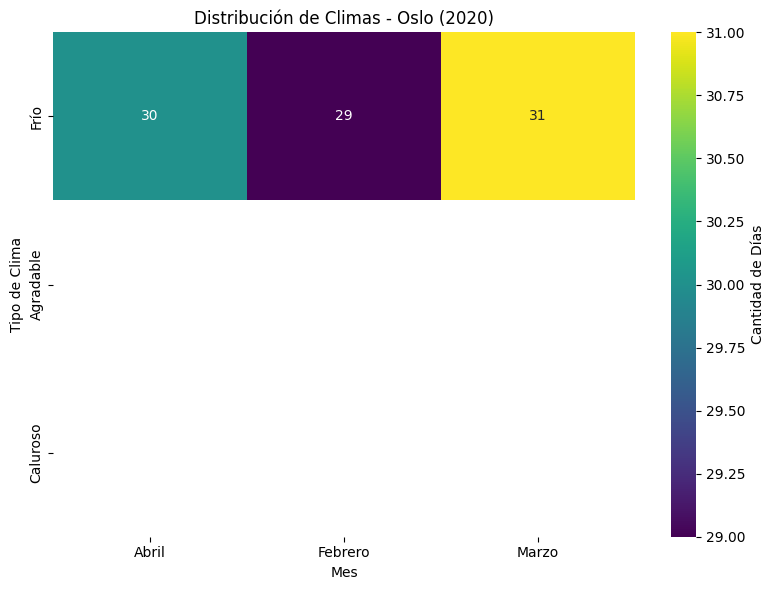

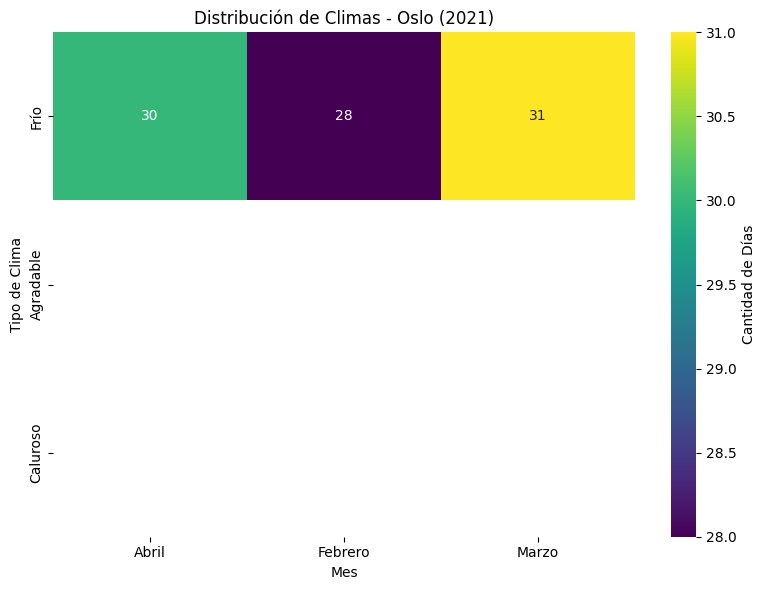

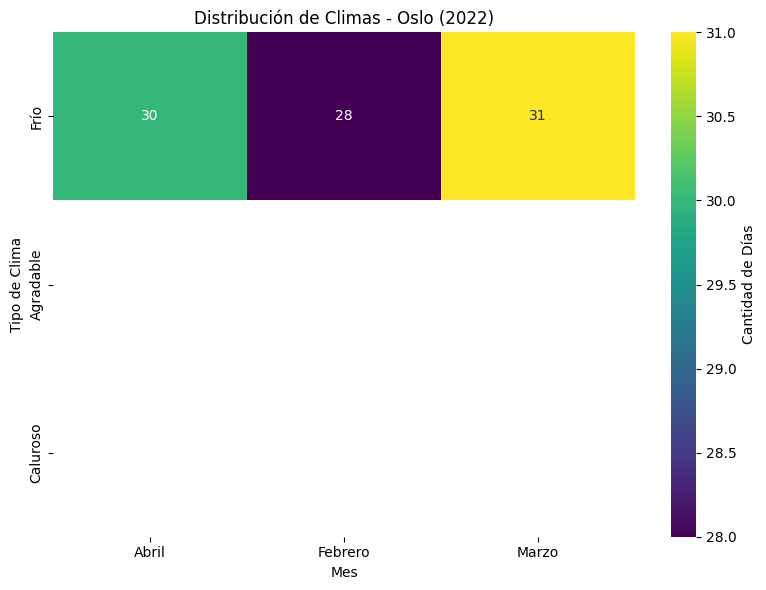

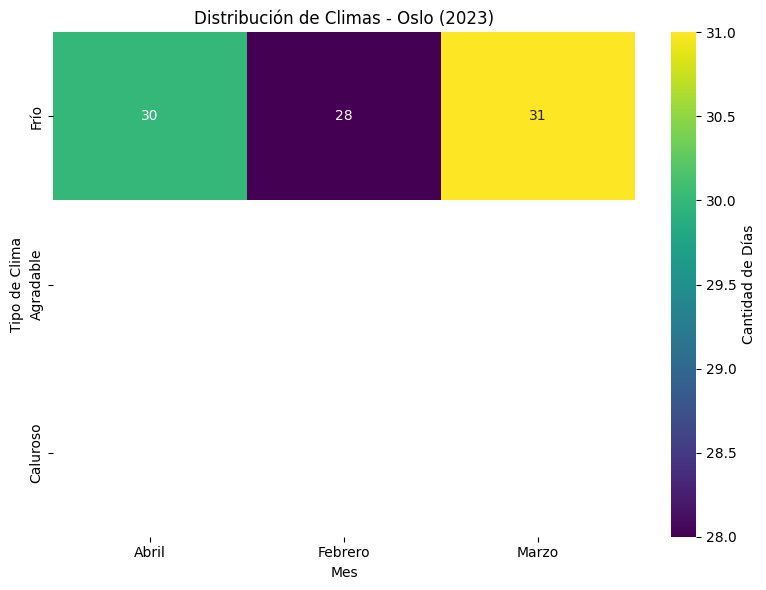

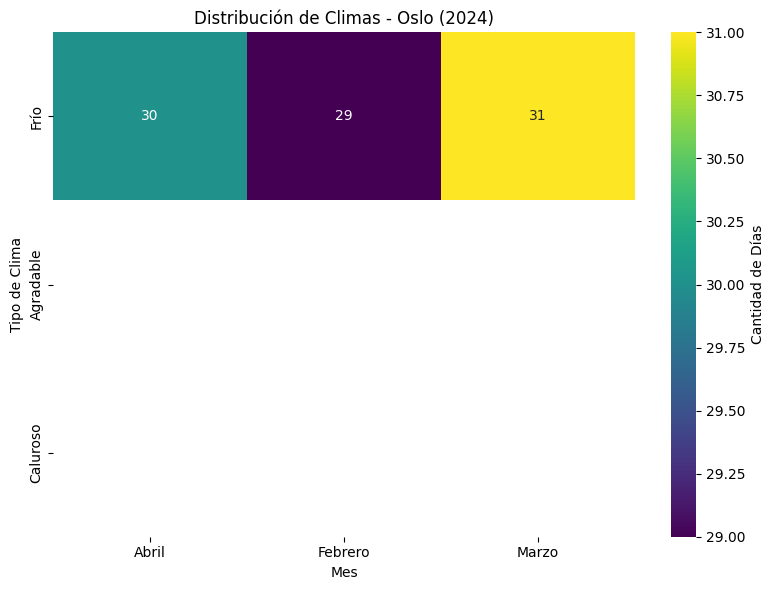

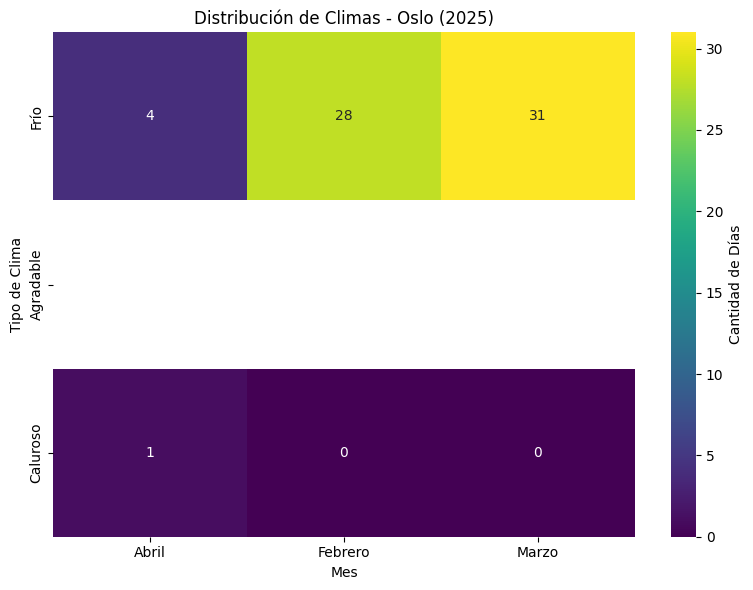


===== Ottawa =====


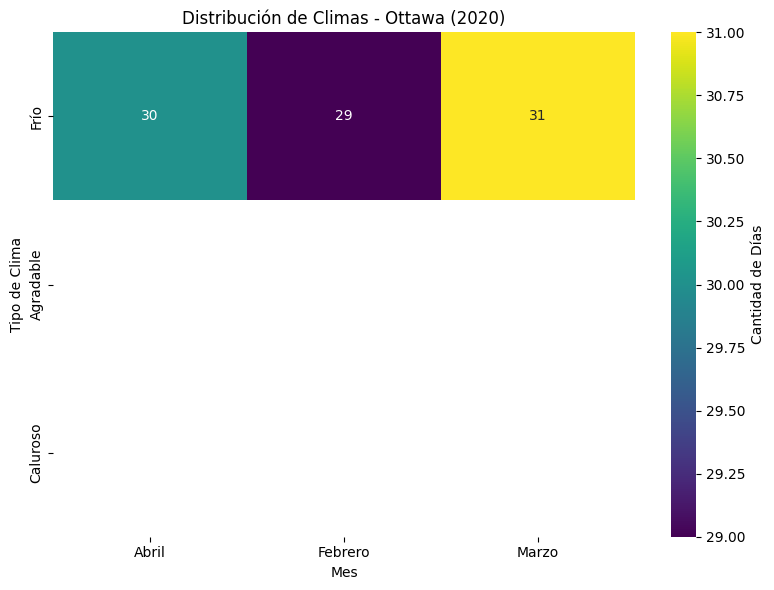

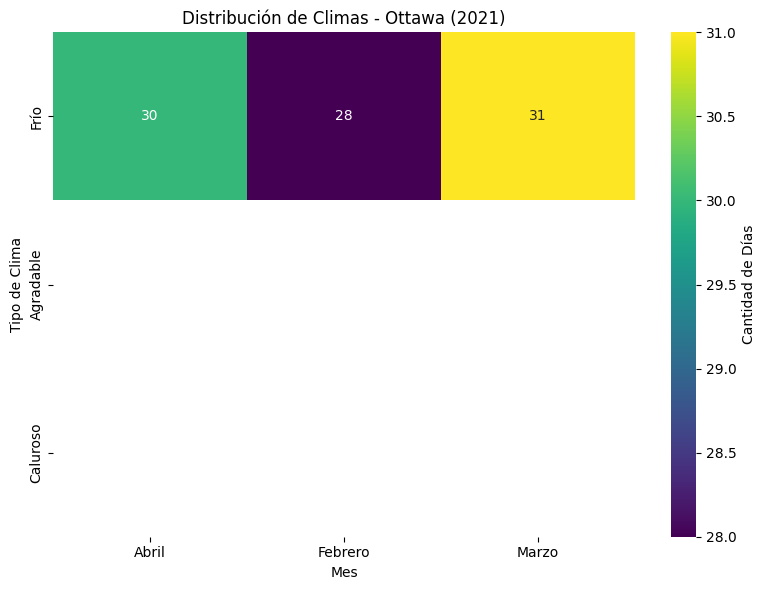

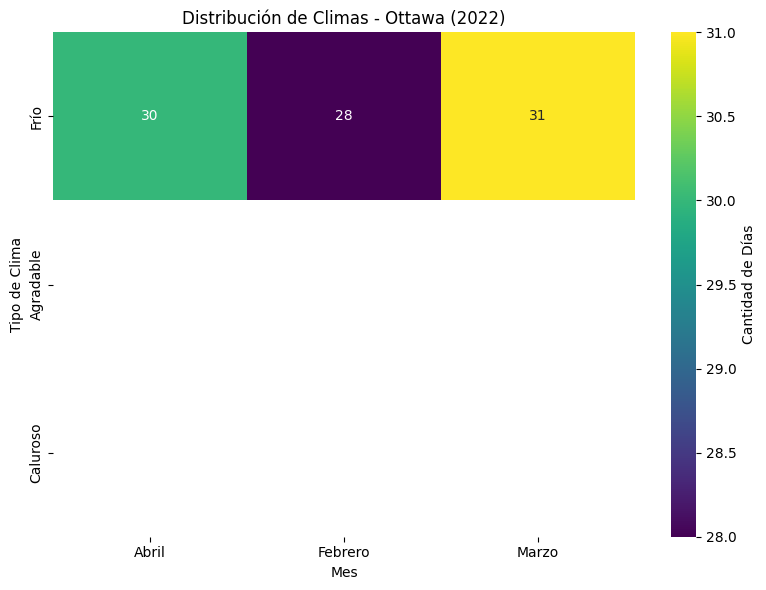

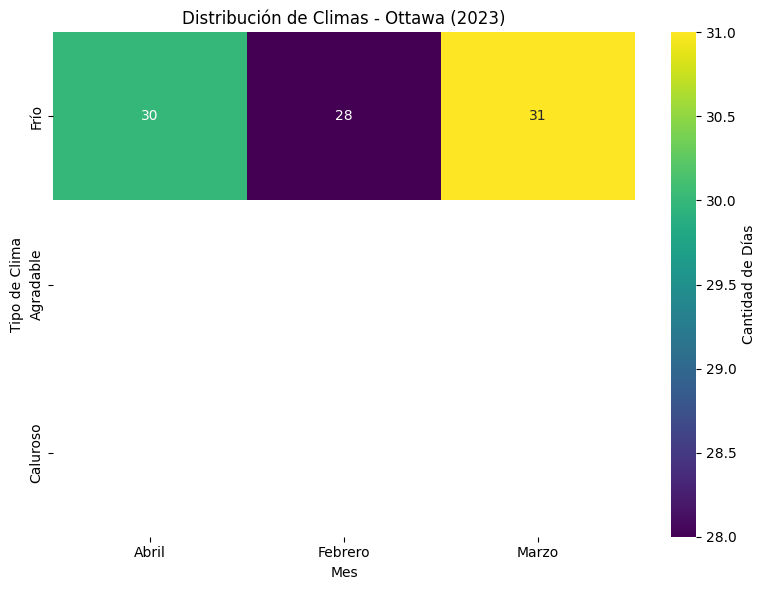

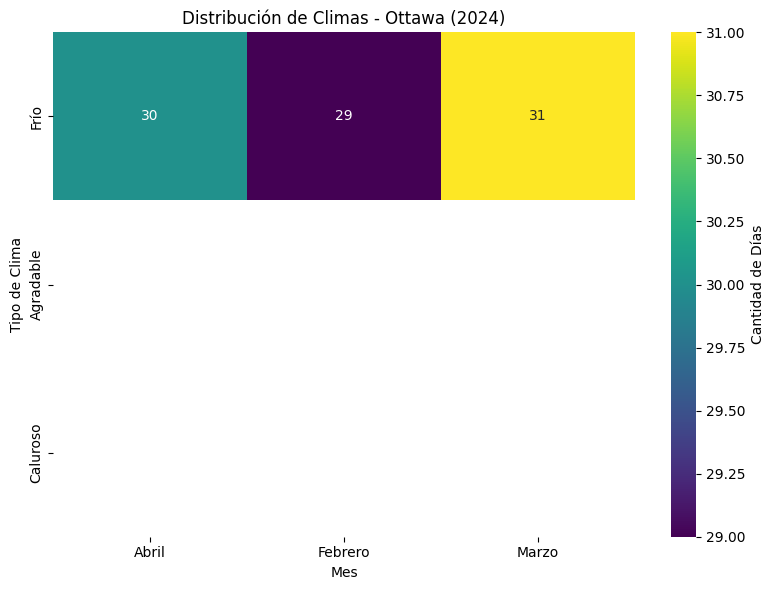

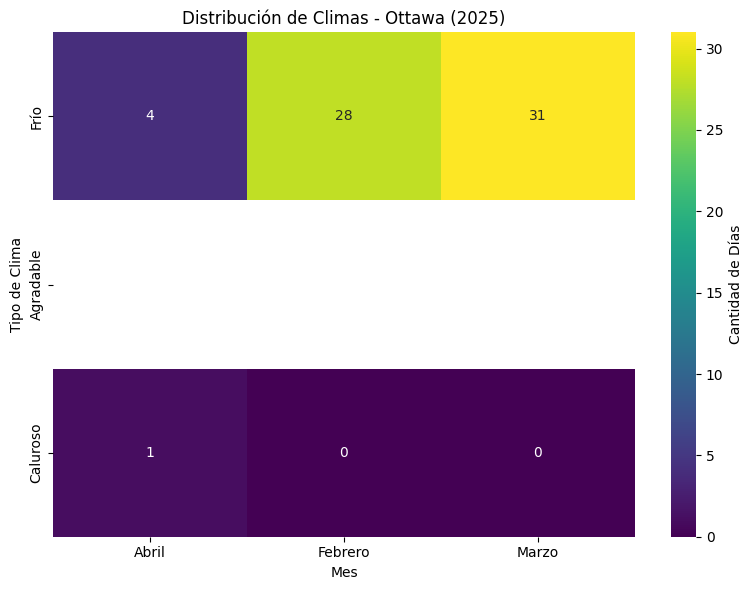


===== Sapporo =====


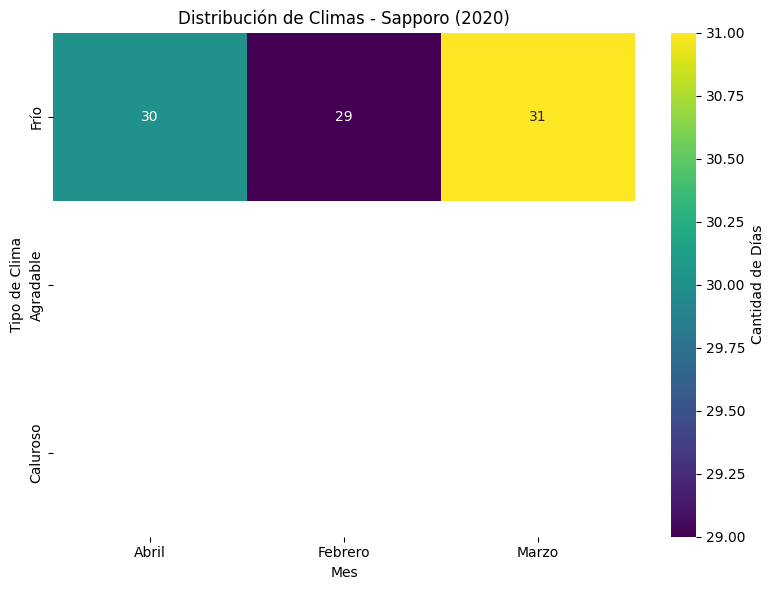

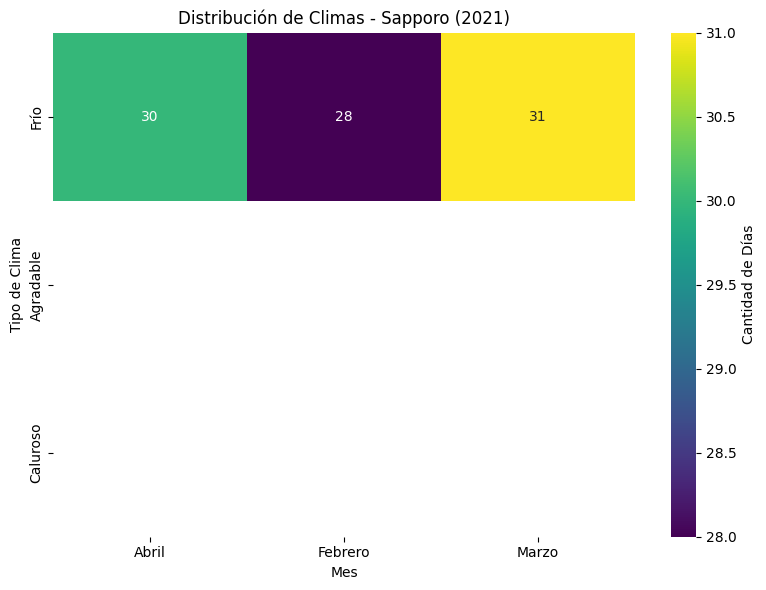

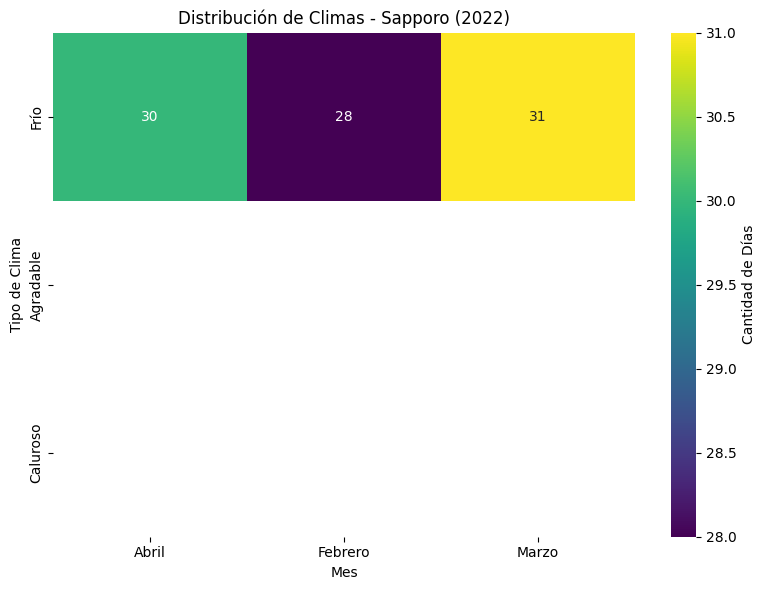

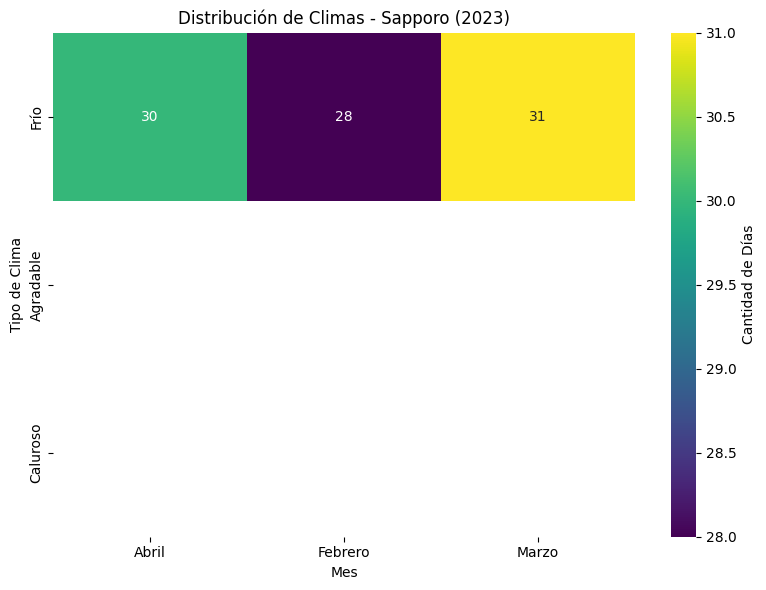

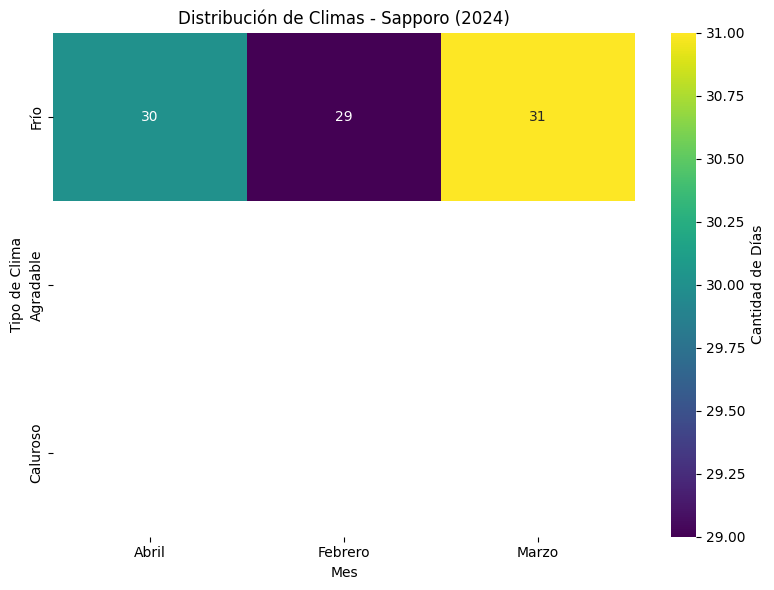

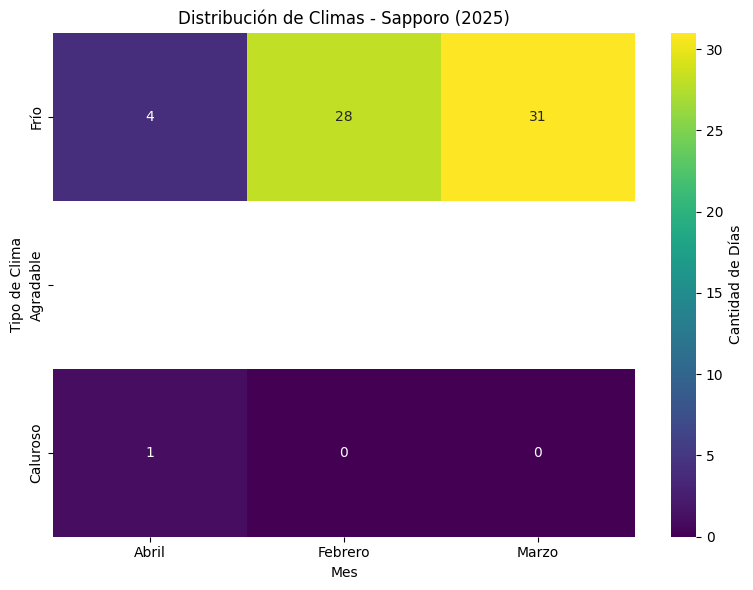


===== Stockholm =====


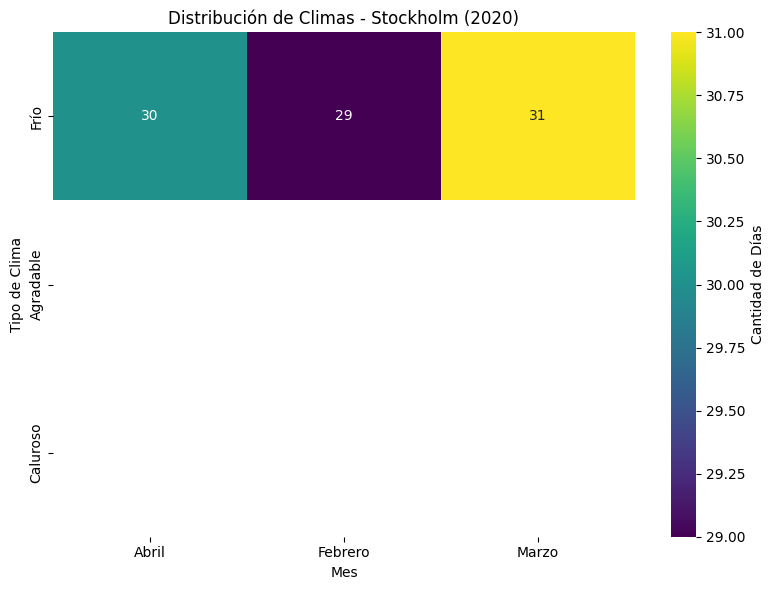

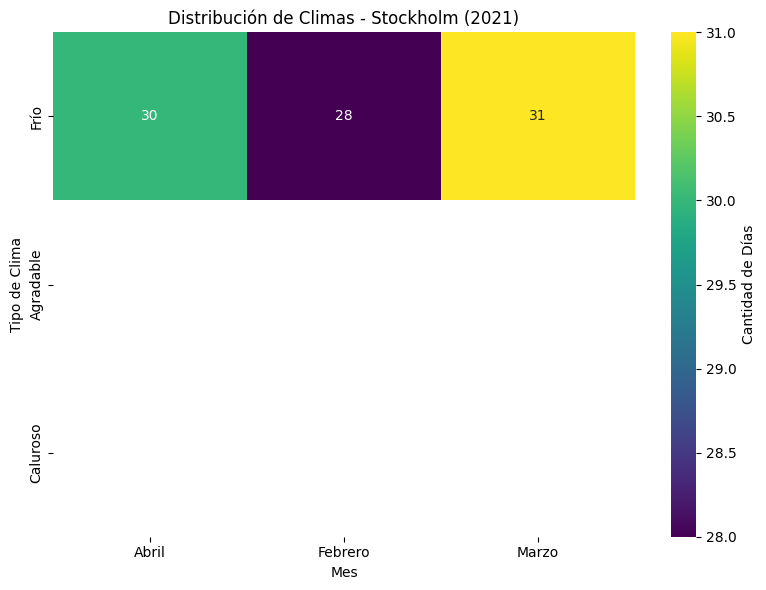

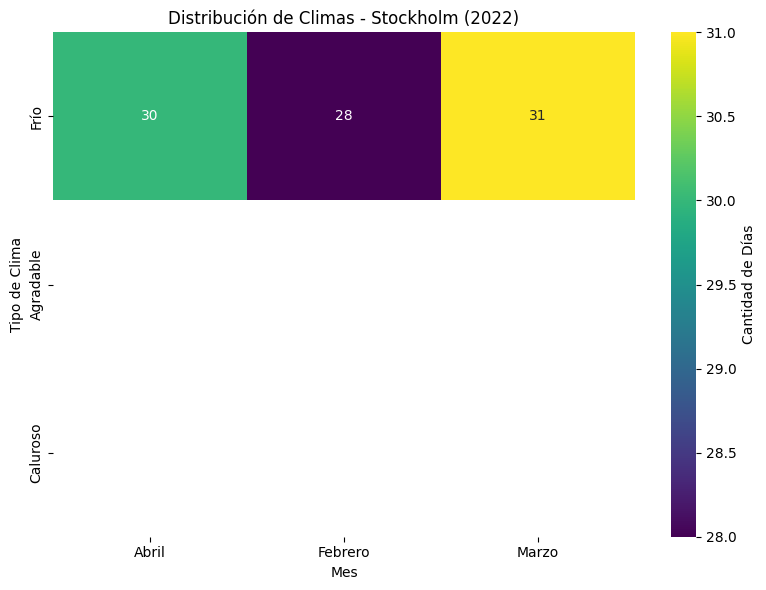

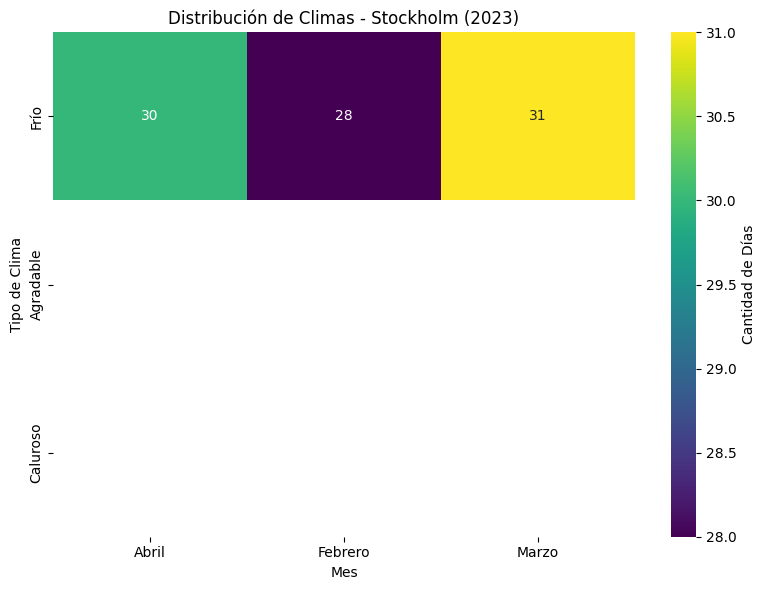

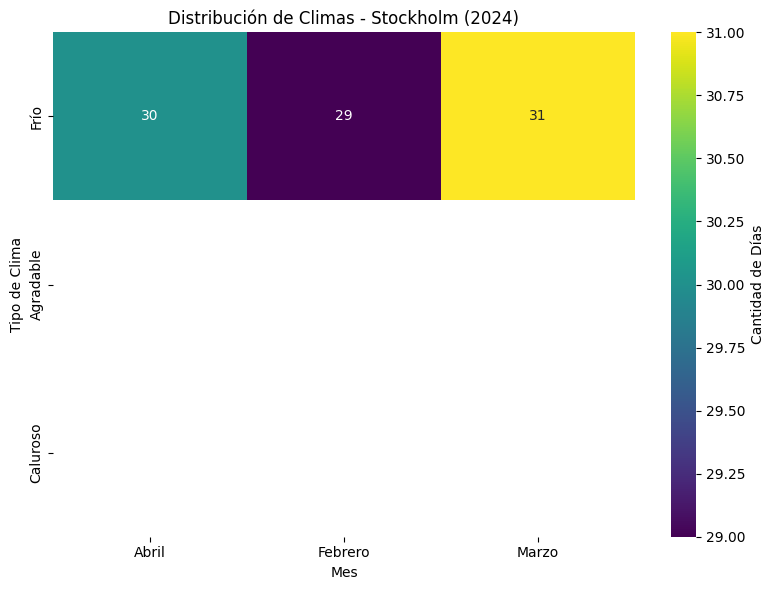

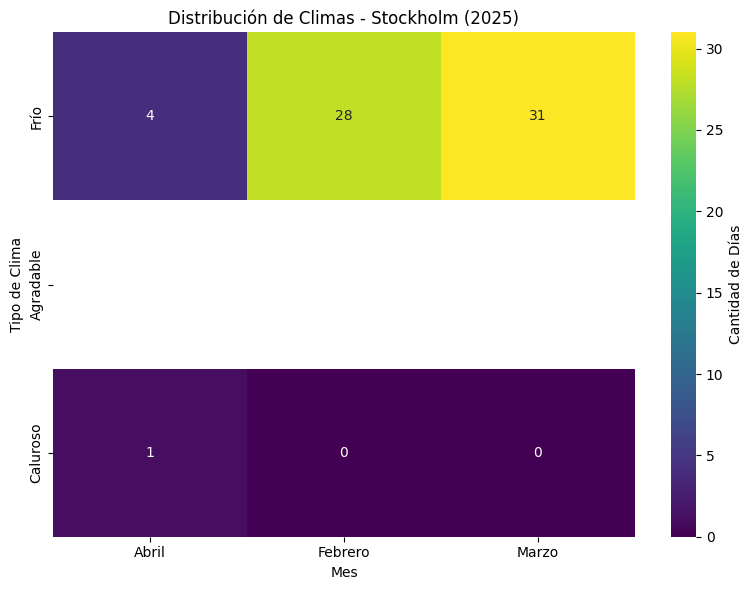


===== Toronto =====


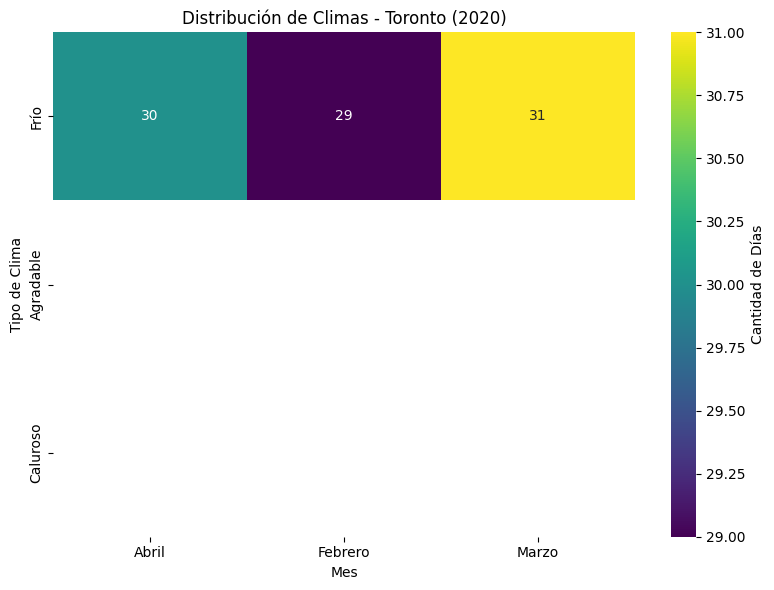

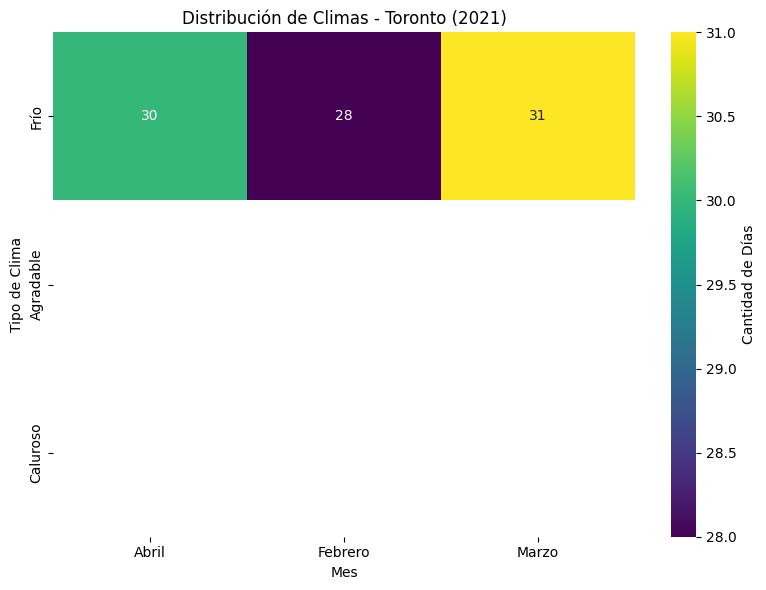

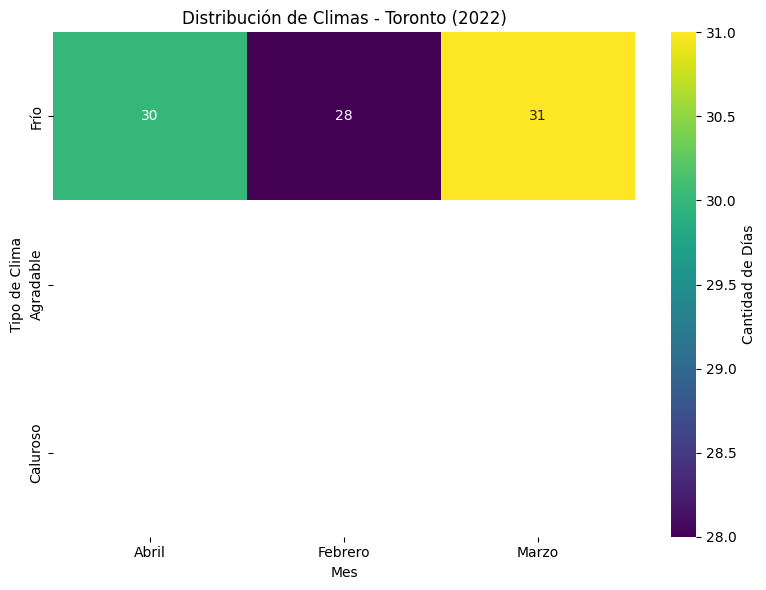

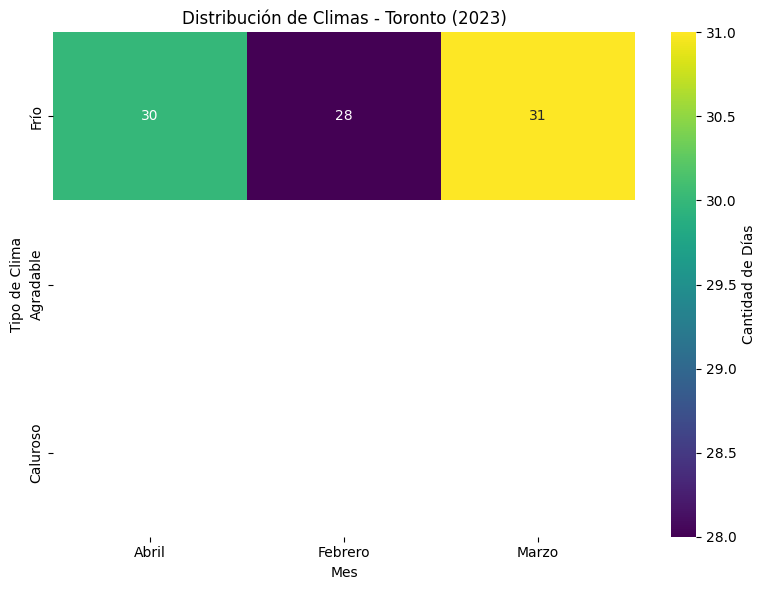

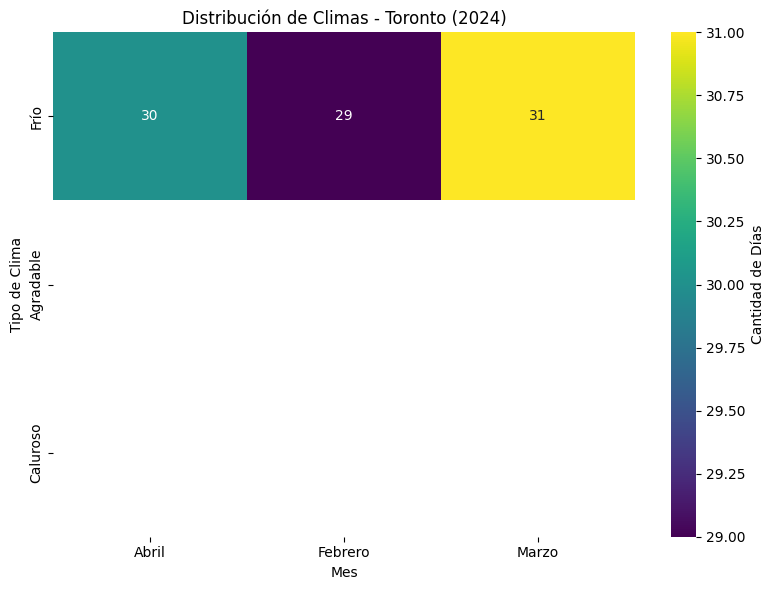

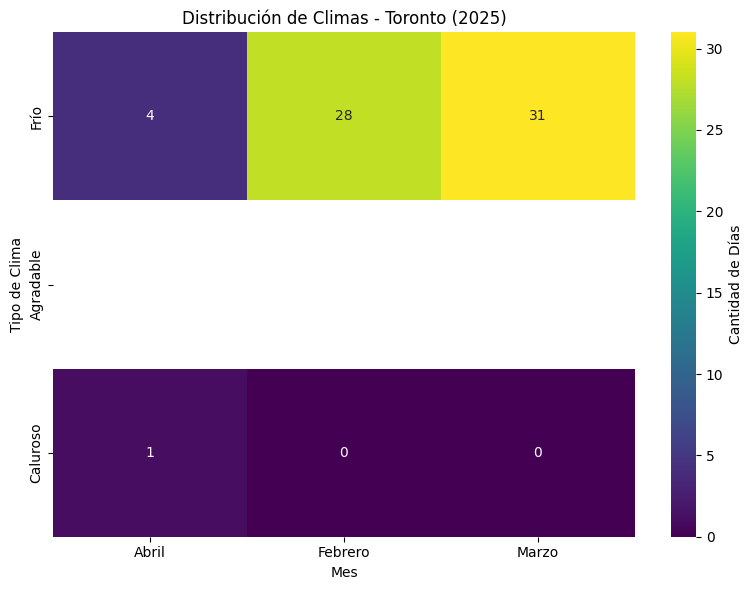

In [109]:
nombres_meses = {
    1: 'Enero', 2: 'Febrero', 3: 'Marzo',
    4: 'Abril', 5: 'Mayo', 6: 'Junio',
    7: 'Julio', 8: 'Agosto', 9: 'Septiembre',
    10: 'Octubre', 11: 'Noviembre', 12: 'Diciembre'
}

for city in ciudades_frio:
    print(f"\n===== {city} =====")
    df_ciudad_fria = df_filtrado_frio[df_filtrado_frio['city_name'] == city]

    for año in df_ciudad_fria['año'].unique():
        df_año = df_ciudad_fria[df_ciudad_fria['año'] == año]

        # Calcular los 3 meses más calurosos
        promedio_min_por_mes = df_año.groupby('mes')['temperature_2m_min'].mean()
        meses_menos_calurosos = promedio_max_por_mes.sort_values(ascending=False).head(3).index.tolist()

        # Filtrar días de esos meses
        df_dias_frios = df_año[df_año['mes'].isin(meses_menos_calurosos)][['dia', 'mes', 'temperature_2m_min']].copy()

        # Clasificación climática
        def clasificar_clima(temp):
            if temp < 20:
                return 'Frío'
            elif 20 <= temp < 30:
                return 'Agradable'
            else:
                return 'Caluroso'

        df_dias_frios['Clima'] = df_dias_frios['temperature_2m_min'].apply(clasificar_clima)
        df_dias_frios['Mes_nombre'] = df_dias_frios['mes'].map(nombres_meses)

        # Crear tabla cruzada
        df_frios = pd.crosstab(df_dias_frios['Clima'], df_dias_frios['Mes_nombre']) # Change df_frio to df_frios

        # Asegurar orden de filas
        orden_clima = ['Frío', 'Agradable', 'Caluroso']
        df_frios = df_frios.reindex(index=orden_clima)

        # Crear heatmap
        plt.figure(figsize=(8, 6))
        sns.heatmap(df_frios, annot=True, cmap='viridis', fmt='.0f', cbar_kws={"label": "Cantidad de Días"})
        plt.title(f"Distribución de Climas - {city} ({año})")
        plt.xlabel('Mes')
        plt.ylabel('Tipo de Clima')
        plt.tight_layout()
        plt.show()

##¿Cómo se distribuye la diferencia entre la temperatura media y la sensación térmica (diferencia aparente) en estas ciudades?

In [110]:
for city in ciudades_frio:
    print(f"\n===== {city} =====")
    df_ciudad_fria = df_filtrado_frio[df_filtrado_frio['city_name'] == city]

    for año in df_ciudad_fria['año'].unique():
        df_año = df_ciudad_fria[df_ciudad_fria['año'] == año]

        df_diferencia_fria = df_año.groupby('mes')[['dia','diferencia_aparente']].mean()

        fig_age = px.histogram(df_diferencia_fria, x="dia", title=f"Distribución de diferencia aparente entre la temperatura media y su sensacion termica de {city} en el año {año}")
        fig_age.show()


===== Calgary =====



===== Helsinki =====



===== Las Vegas =====



===== Minsk =====



===== Montreal =====



===== Oslo =====



===== Ottawa =====



===== Sapporo =====



===== Stockholm =====



===== Toronto =====


##¿Cómo se distribuye la diferencia entre la temperatura máxima y mínima (amplitud térmica) en estas ciudades?

In [111]:
for city in ciudades_frio:
    print(f"\n===== {city} =====")
    df_ciudad_fria = df_filtrado_frio[df_filtrado_frio['city_name'] == city]

    for año in df_ciudad_fria['año'].unique():
        df_año = df_ciudad_fria[df_ciudad_fria['año'] == año]
        df_diferencia = df_año.groupby('mes')[['dia','diferencia_aparente']].mean()

        fig_age = px.histogram(df_diferencia, x="dia", title=f"Distribución de diferencia aparente entre la temperatura media y su sensacion termica de {city} en el año {año}")
        fig_age.show()


===== Calgary =====



===== Helsinki =====



===== Las Vegas =====



===== Minsk =====



===== Montreal =====



===== Oslo =====



===== Ottawa =====



===== Sapporo =====



===== Stockholm =====



===== Toronto =====


##¿Cuál es la probabilidad de lluvia en estas ciudades en los próximos dos años?

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpljcpx5kz/k6wyk9f8.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpljcpx5kz/i4yadniz.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=86641', 'data', 'file=/tmp/tmpljcpx5kz/k6wyk9f8.json', 'init=/tmp/tmpljcpx5kz/i4yadniz.json', 'output', 'file=/tmp/tmpljcpx5kz/prophet_model4ccadkgj/prophet_model-20250430192141.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
19:21:41 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
19:21:41 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing



===== Calgary =====


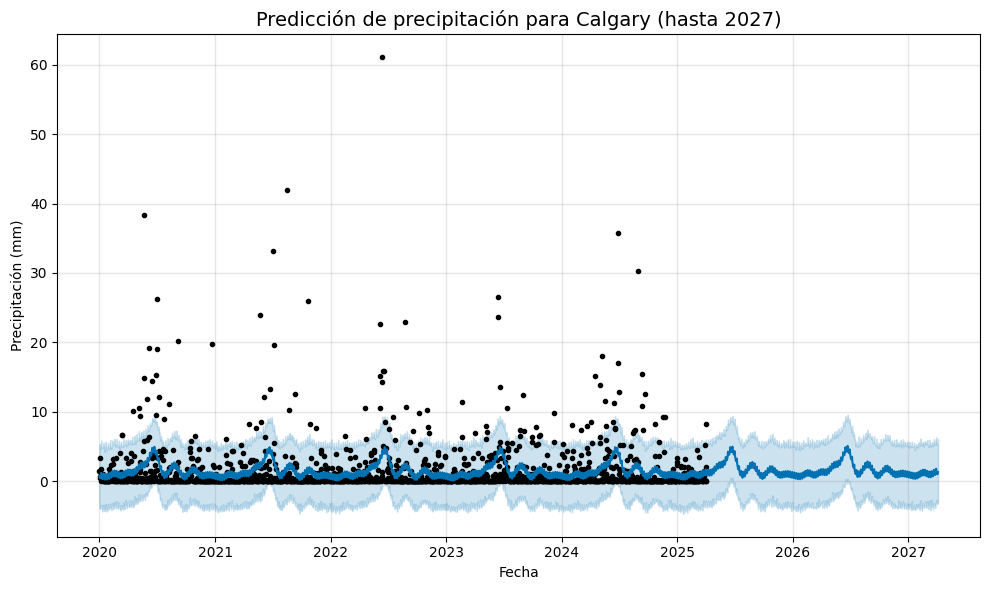

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpljcpx5kz/sl83zw7d.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpljcpx5kz/7r0tnmnt.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=94888', 'data', 'file=/tmp/tmpljcpx5kz/sl83zw7d.json', 'init=/tmp/tmpljcpx5kz/7r0tnmnt.json', 'output', 'file=/tmp/tmpljcpx5kz/prophet_modelrrbn197_/prophet_model-20250430192142.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
19:21:42 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
19:21:42 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing



===== Helsinki =====


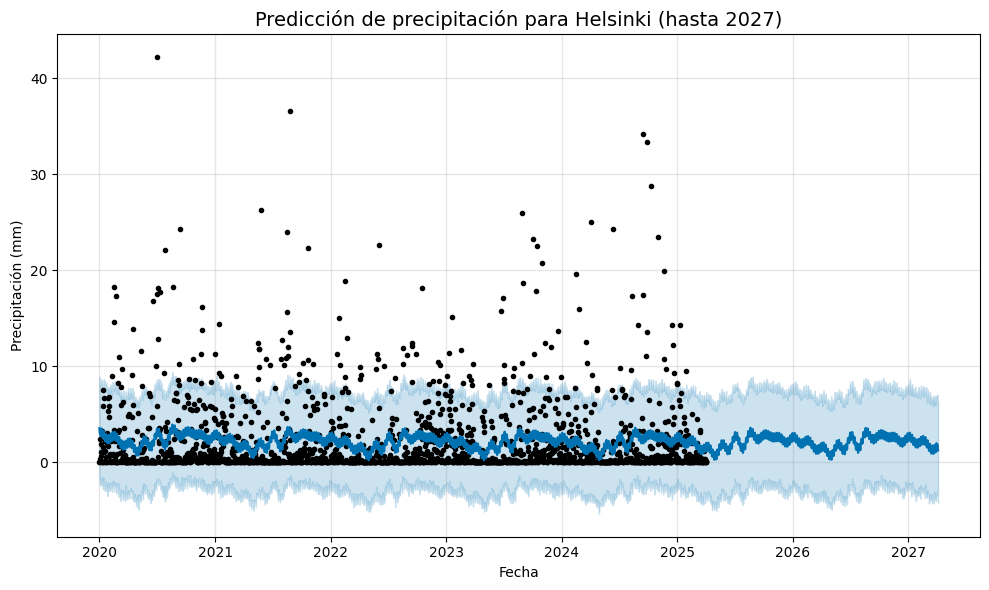

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpljcpx5kz/9rutfakd.json



===== Las Vegas =====


DEBUG:cmdstanpy:input tempfile: /tmp/tmpljcpx5kz/feg08nq6.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=83302', 'data', 'file=/tmp/tmpljcpx5kz/9rutfakd.json', 'init=/tmp/tmpljcpx5kz/feg08nq6.json', 'output', 'file=/tmp/tmpljcpx5kz/prophet_model756s3l_w/prophet_model-20250430192143.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
19:21:43 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
19:21:43 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


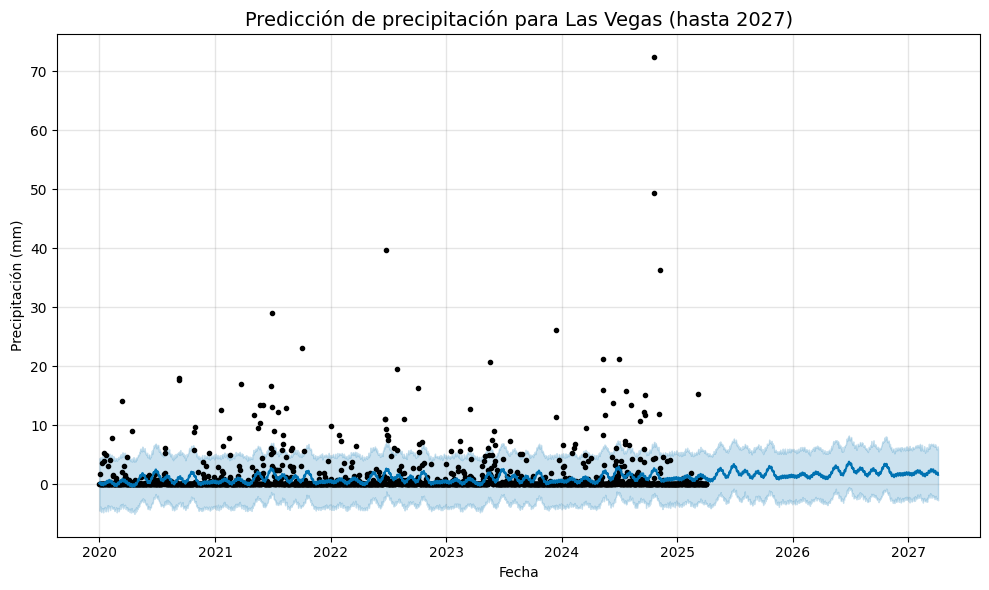

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpljcpx5kz/xc_u2kd9.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpljcpx5kz/_80i2i1a.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=36262', 'data', 'file=/tmp/tmpljcpx5kz/xc_u2kd9.json', 'init=/tmp/tmpljcpx5kz/_80i2i1a.json', 'output', 'file=/tmp/tmpljcpx5kz/prophet_modelyzr41xpo/prophet_model-20250430192143.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
19:21:43 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
19:21:43 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing



===== Minsk =====


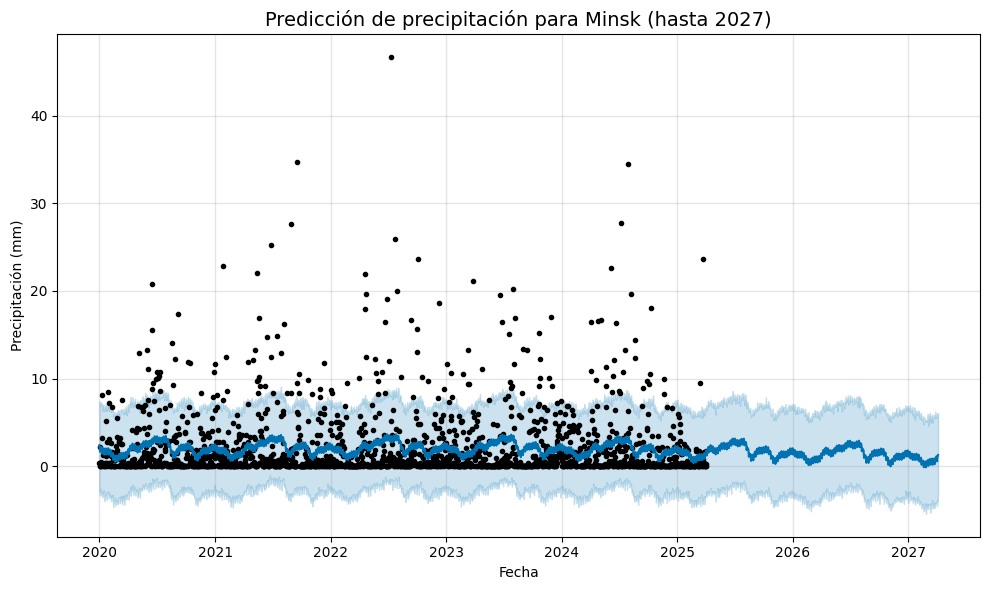

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpljcpx5kz/8_x8ipj7.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpljcpx5kz/gfq8ka58.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=36720', 'data', 'file=/tmp/tmpljcpx5kz/8_x8ipj7.json', 'init=/tmp/tmpljcpx5kz/gfq8ka58.json', 'output', 'file=/tmp/tmpljcpx5kz/prophet_model3lenx9z8/prophet_model-20250430192144.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
19:21:44 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing



===== Montreal =====


19:21:44 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


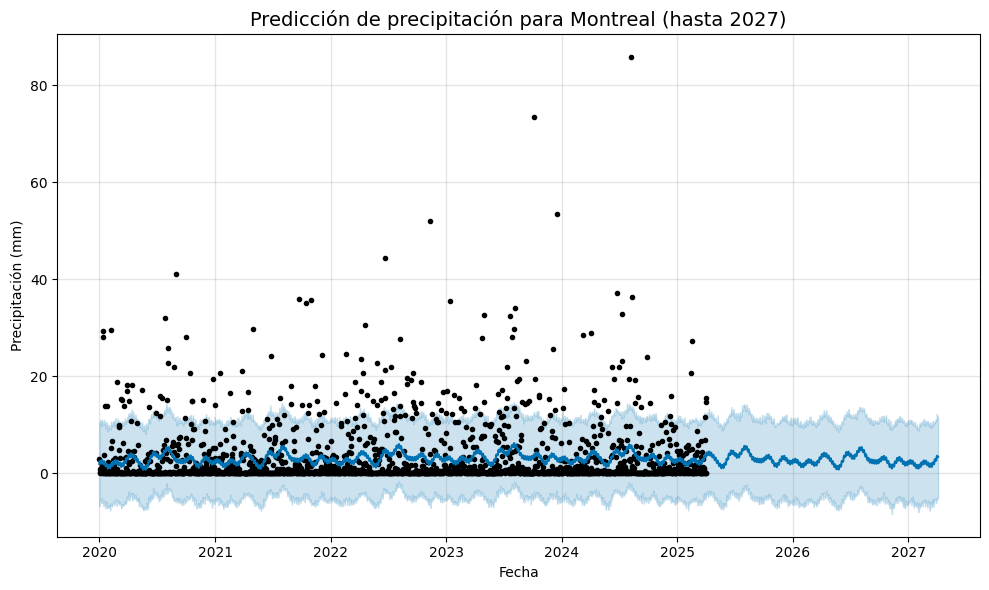

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpljcpx5kz/xjq24jq9.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpljcpx5kz/0d0yrngb.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=99065', 'data', 'file=/tmp/tmpljcpx5kz/xjq24jq9.json', 'init=/tmp/tmpljcpx5kz/0d0yrngb.json', 'output', 'file=/tmp/tmpljcpx5kz/prophet_model91c9s0tn/prophet_model-20250430192145.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
19:21:45 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
19:21:45 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing



===== Oslo =====


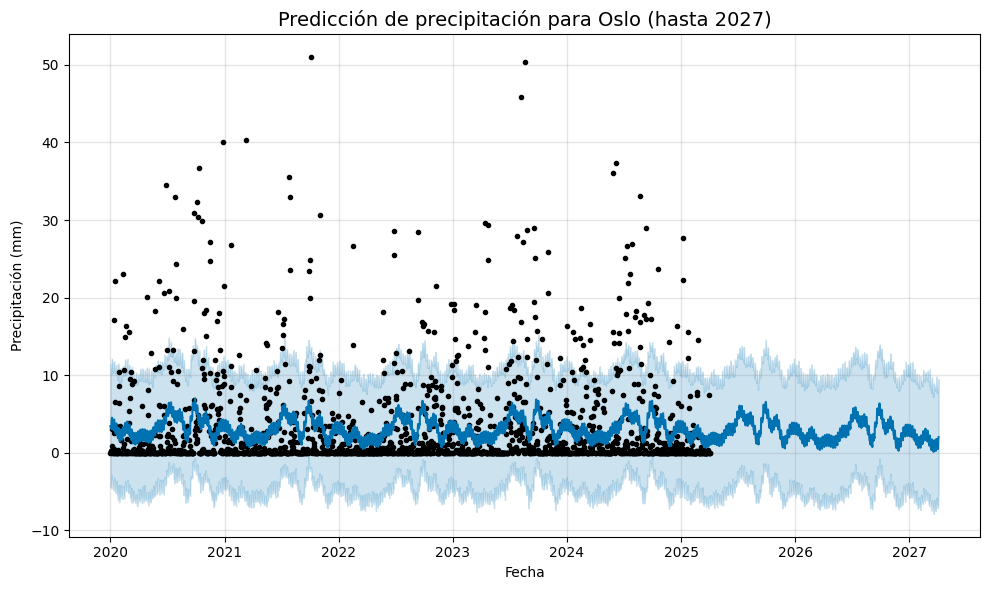

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpljcpx5kz/yrmb9ain.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpljcpx5kz/vlgknbox.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=3385', 'data', 'file=/tmp/tmpljcpx5kz/yrmb9ain.json', 'init=/tmp/tmpljcpx5kz/vlgknbox.json', 'output', 'file=/tmp/tmpljcpx5kz/prophet_modeld7jw_kh3/prophet_model-20250430192145.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
19:21:45 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing



===== Ottawa =====


19:21:45 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


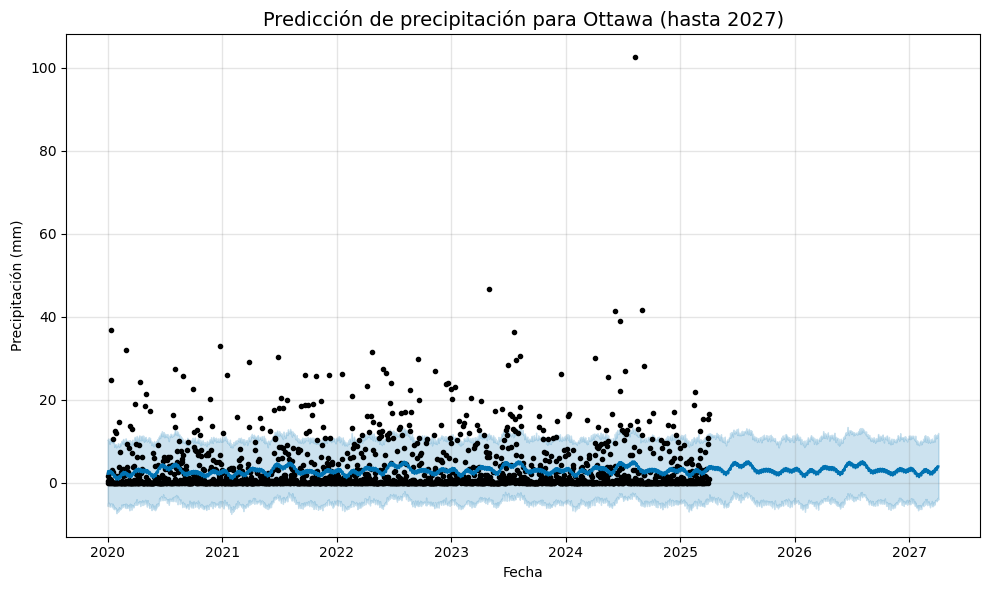

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpljcpx5kz/drxw1dmt.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpljcpx5kz/eunxc52n.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=43823', 'data', 'file=/tmp/tmpljcpx5kz/drxw1dmt.json', 'init=/tmp/tmpljcpx5kz/eunxc52n.json', 'output', 'file=/tmp/tmpljcpx5kz/prophet_model_vilbtjn/prophet_model-20250430192146.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
19:21:46 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing



===== Sapporo =====


19:21:46 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


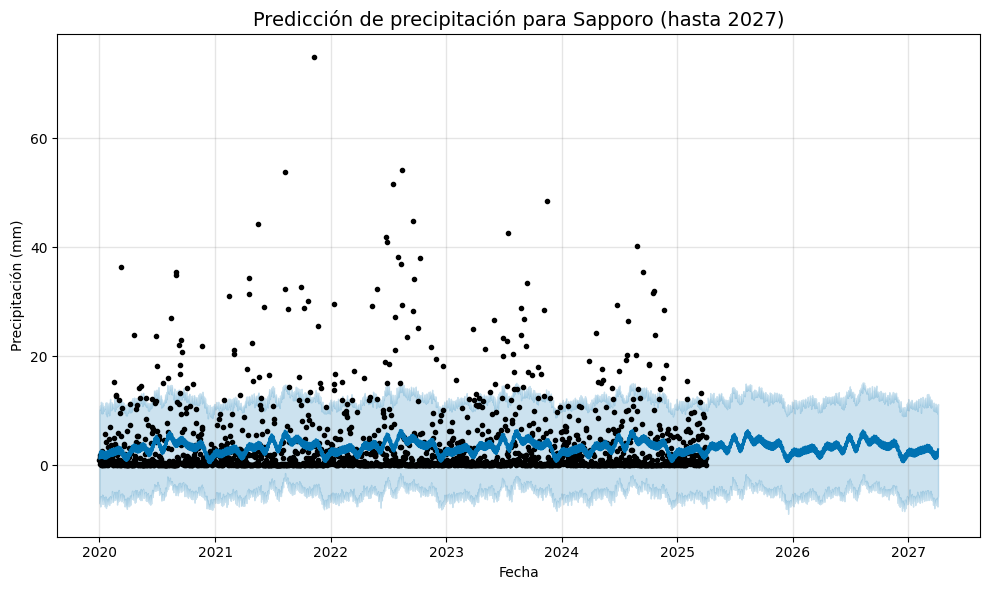

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpljcpx5kz/sc_53xke.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpljcpx5kz/6v5rv040.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=13123', 'data', 'file=/tmp/tmpljcpx5kz/sc_53xke.json', 'init=/tmp/tmpljcpx5kz/6v5rv040.json', 'output', 'file=/tmp/tmpljcpx5kz/prophet_model0fg_e5ei/prophet_model-20250430192147.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
19:21:47 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing



===== Stockholm =====


19:21:47 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


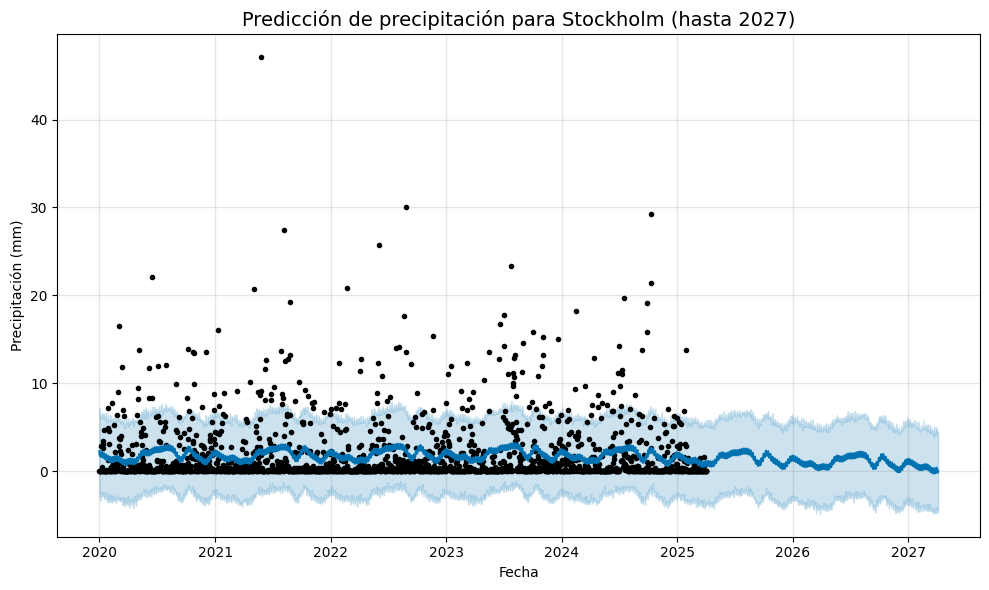

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpljcpx5kz/2ee6rt2b.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpljcpx5kz/8u_5vfcl.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=61595', 'data', 'file=/tmp/tmpljcpx5kz/2ee6rt2b.json', 'init=/tmp/tmpljcpx5kz/8u_5vfcl.json', 'output', 'file=/tmp/tmpljcpx5kz/prophet_model45191yvk/prophet_model-20250430192148.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
19:21:48 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing



===== Toronto =====


19:21:48 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


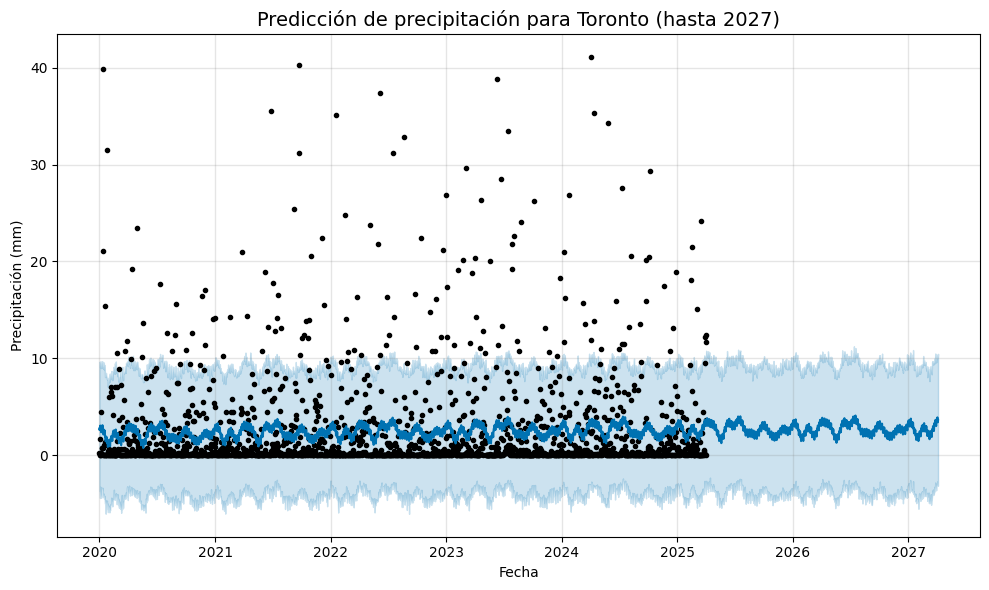

In [112]:
from prophet import Prophet
import matplotlib.pyplot as plt
import pandas as pd

# Asegúrate de que datetime es datetime
df_filtrado_frio['datetime'] = pd.to_datetime(df_filtrado_frio['datetime'])

for city in ciudades_frio:
    print(f"\n===== {city} =====")

    # Filtrar datos hasta 2025 inclusive
    df_ciudad = df_filtrado_frio[
        (df_filtrado_frio['city_name'] == city) &
        (df_filtrado_frio['datetime'].dt.year <= 2025)
    ][['datetime', 'precipitation_sum']].copy()

    # Renombrar columnas para Prophet
    df_ciudad = df_ciudad.rename(columns={'datetime': 'ds', 'precipitation_sum': 'y'})

    # Entrenar el modelo
    modelo = Prophet()
    modelo.fit(df_ciudad)

    # Crear fechas futuras (730 días ≈ 2 años)
    future = modelo.make_future_dataframe(periods=730)
    forecast = modelo.predict(future)

    # Filtrar solo los años futuros para graficar si quieres
    forecast_future = forecast[forecast['ds'].dt.year > 2025]

    # Graficar todo (pasado + futuro)
    fig = modelo.plot(forecast)
    plt.title(f'Predicción de precipitación para {city} (hasta 2027)', fontsize=14)
    plt.xlabel('Fecha')
    plt.ylabel('Precipitación (mm)')
    plt.grid(True)
    plt.tight_layout()
    plt.show()

#Agricultura

In [ ]:

df1 = df1.dropna(subset=[
    'temperature_2m_mean',
    'precipitation_sum',
    'shortwave_radiation_sum',
    'et0_fao_evapotranspiration'
])

Este gráfico muestra cómo varían las principales condiciones agroclimáticas mes a mes en diferentes ciudades. Se busca identificar cuáles regiones tienen condiciones más favorables para la actividad agrícola según el clima.
En este gráfico se representan varias métricas agroclimáticas, tales como:

* Temperatura media: Ideal entre 18 °C y 30 °C para la mayoría de los cultivos.

* Precipitación acumulada: Muestra la cantidad de agua disponible para el riego natural.

* Horas de sol (duración del sol): Influye en la fotosíntesis y productividad de los cultivos.

* Velocidad del viento: Velocidades altas pueden afectar negativamente la agricultura.

* Evapotranspiración (ET₀ FAO): Estima la cantidad de agua que requieren los cultivos.

In [ ]:
# Resumen anual por ciudad
df_resumen = df1.groupby('city_name').agg({
    'temperature_2m_mean': 'mean',  # °C
    'precipitation_sum': 'sum',     # mm
    'shortwave_radiation_sum': 'mean',  # MJ/m²
    'et0_fao_evapotranspiration': 'mean'  # mm
}).reset_index()

# Calcular balance hídrico aproximado (lluvia - demanda hídrica)
df_resumen['balance_hidrico'] = df_resumen['precipitation_sum'] - (df_resumen['et0_fao_evapotranspiration'] * 365)


In [ ]:
df_optimo = df_resumen[
    (df_resumen['temperature_2m_mean'] >= 18) &
    (df_resumen['temperature_2m_mean'] <= 28) &
    (df_resumen['precipitation_sum'] >= 600) &
    (df_resumen['precipitation_sum'] <= 2000) &
    (df_resumen['shortwave_radiation_sum'] >= 14) &  # MJ/m² por día aprox.
    (df_resumen['balance_hidrico'] >= 0)  # más agua disponible que demanda
]


In [ ]:
# Normalización simple (0–1)
df_resumen['score_temp'] = 1 - abs(df_resumen['temperature_2m_mean'] - 23) / 10  # Ideal: 23°C
df_resumen['score_rain'] = df_resumen['precipitation_sum'] / df_resumen['precipitation_sum'].max()
df_resumen['score_radiation'] = df_resumen['shortwave_radiation_sum'] / df_resumen['shortwave_radiation_sum'].max()
df_resumen['score_balance'] = df_resumen['balance_hidrico'] / df_resumen['balance_hidrico'].max()

# Índice ponderado
df_resumen['agro_score'] = (
    0.3 * df_resumen['score_temp'] +
    0.3 * df_resumen['score_rain'] +
    0.2 * df_resumen['score_radiation'] +
    0.2 * df_resumen['score_balance']
)

# Ordenar
df_resumen = df_resumen.sort_values(by='agro_score', ascending=False)


##¿Cuáles son las ciudades con las mejores condiciones agroclimáticas en general, considerando temperatura, precipitación, radiación solar y balance hídrico?

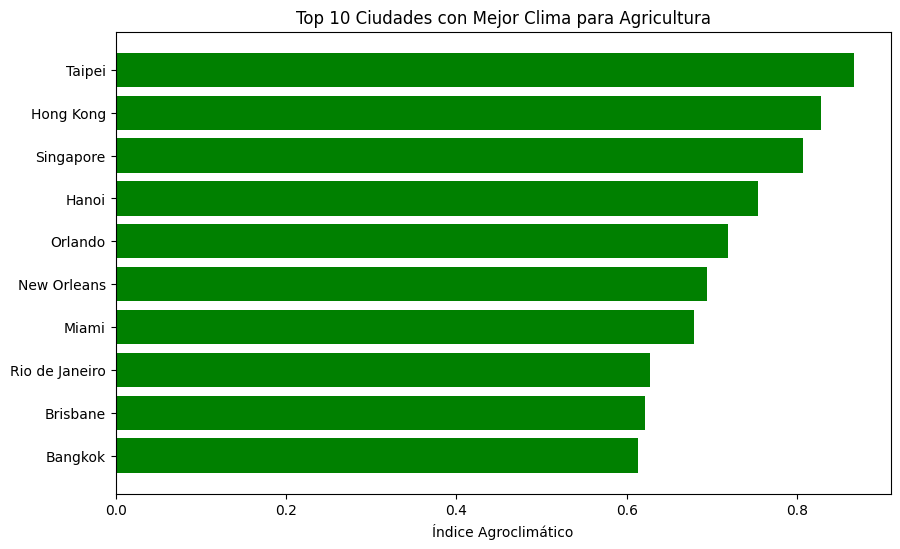

In [ ]:
import matplotlib.pyplot as plt

# Top 10 ciudades con mejor clima agrícola
top_ciudades = df_resumen[['city_name', 'agro_score']].head(10)

plt.figure(figsize=(10, 6))
plt.barh(top_ciudades['city_name'], top_ciudades['agro_score'], color='green')
plt.xlabel('Índice Agroclimático')
plt.title('Top 10 Ciudades con Mejor Clima para Agricultura')
plt.gca().invert_yaxis()  # Para mostrar la mejor ciudad arriba
plt.show()


##¿Cómo varían la temperatura media y la precipitación a lo largo del tiempo en las ciudades con mejor clima para la agricultura?

Queremos ver cómo varían la temperatura media y la precipitación a lo largo del tiempo (mes a mes o semana a semana) para cada ciudad. Este análisis puede ayudar a determinar las temporadas más cálidas o húmedas para las actividades agrícolas.


===== Taipei =====


<Figure size 1200x800 with 0 Axes>

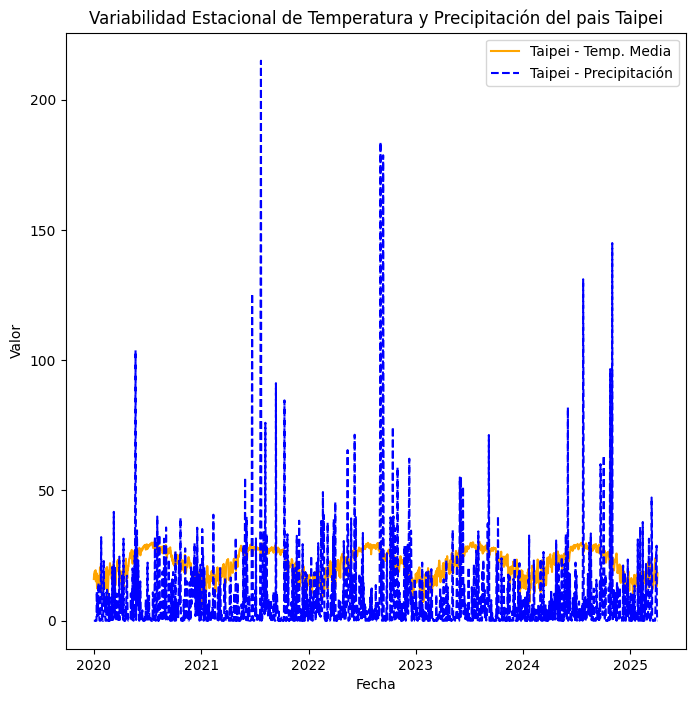


===== Hong Kong =====


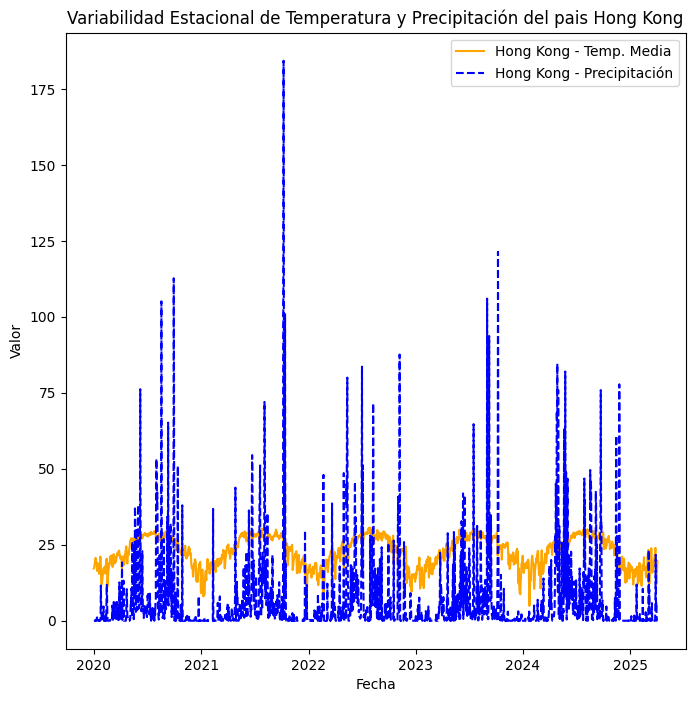


===== Singapore =====


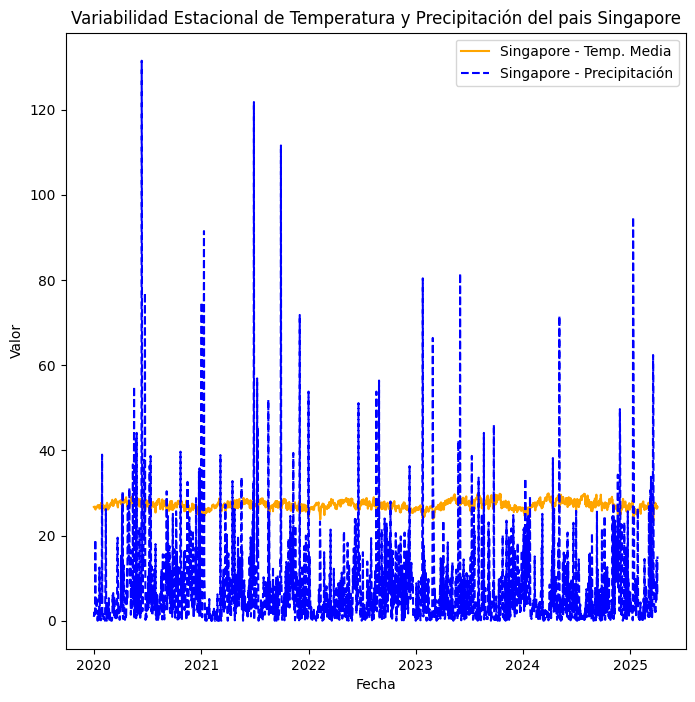


===== Hanoi =====


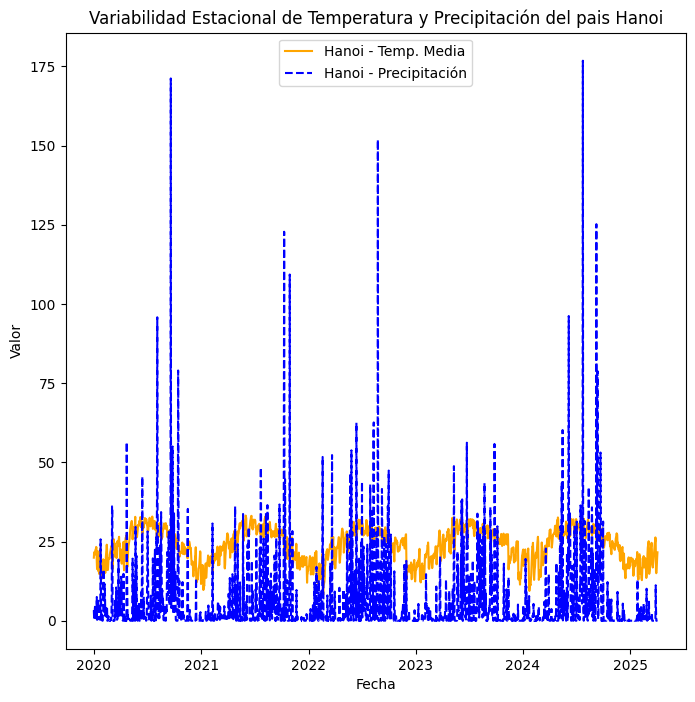


===== Orlando =====


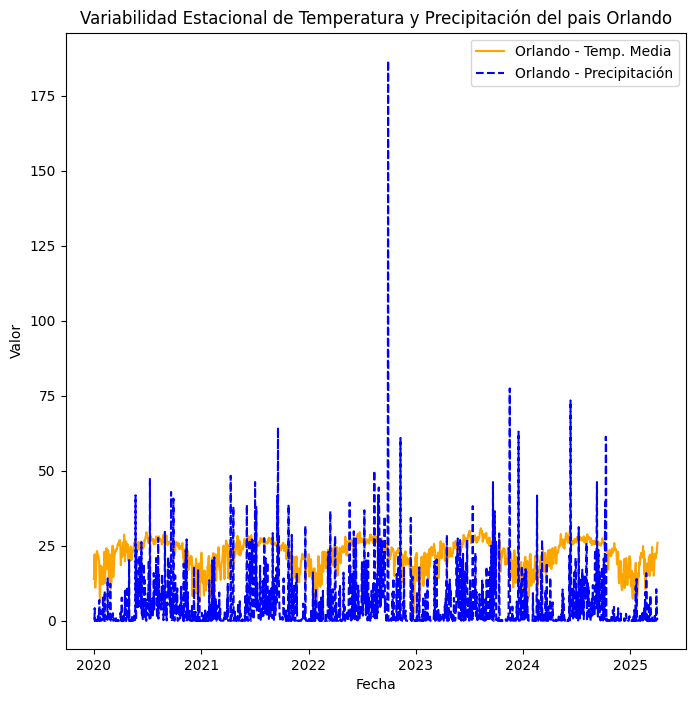


===== New Orleans =====


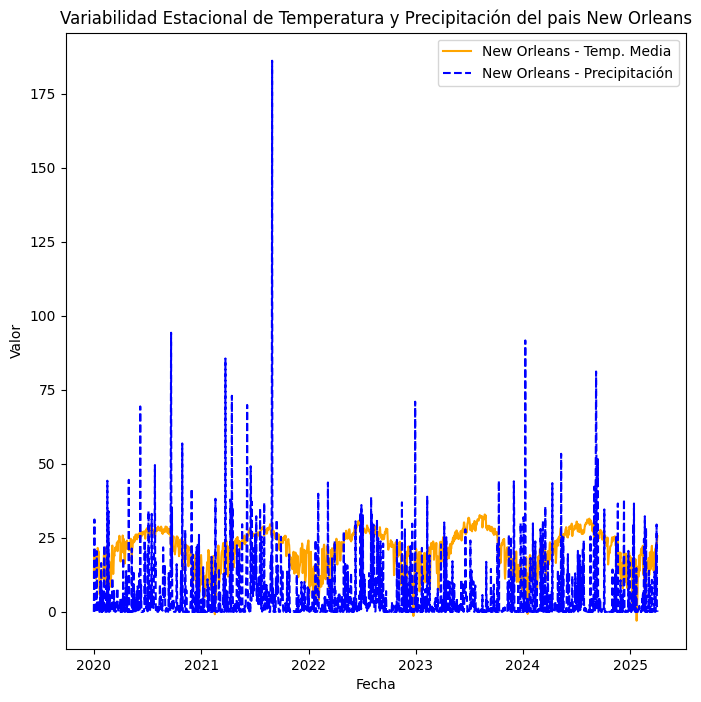


===== Miami =====


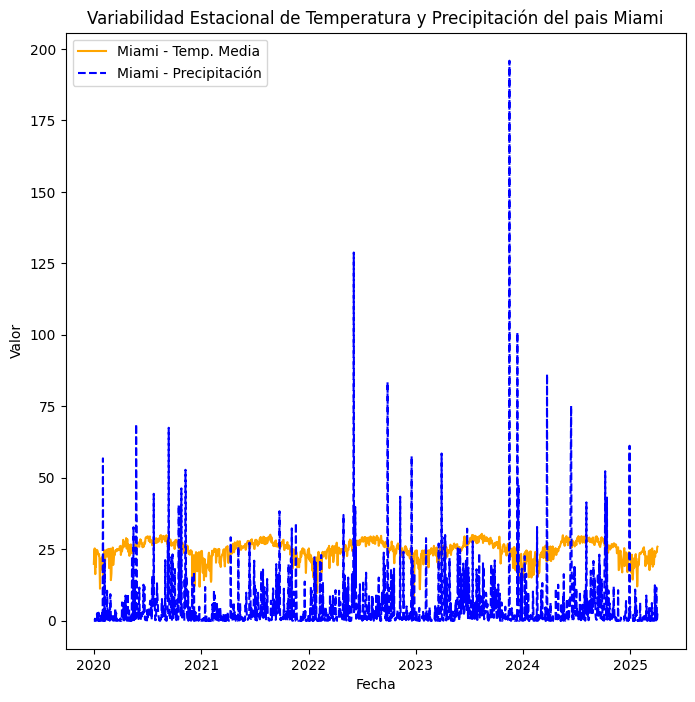


===== Rio de Janeiro =====


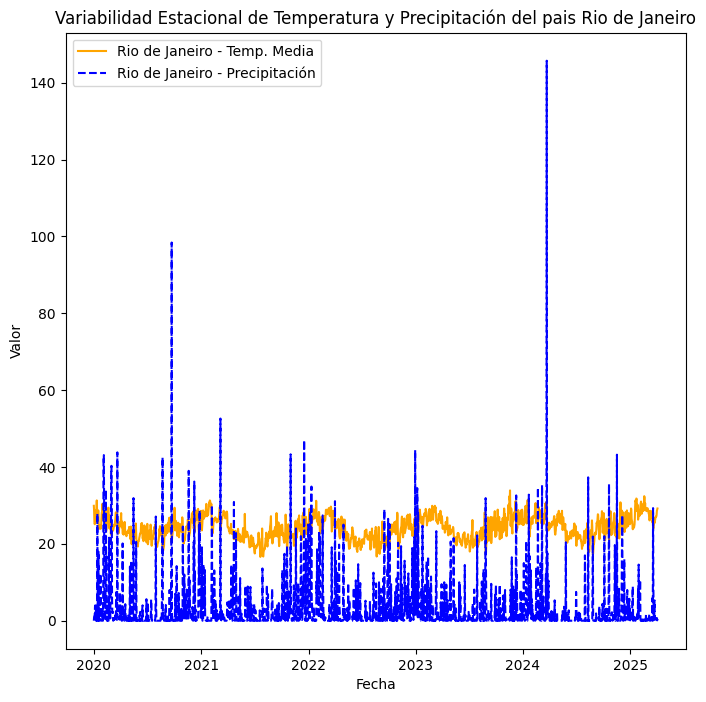


===== Brisbane =====


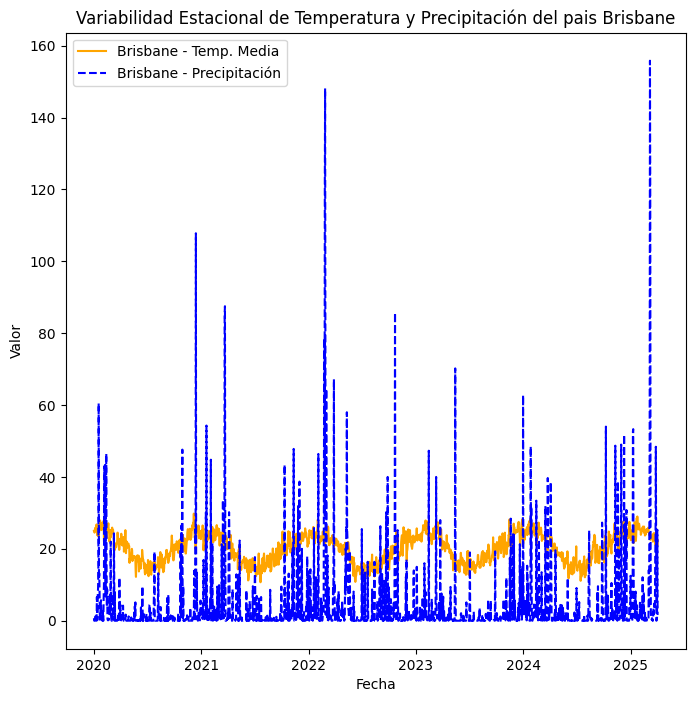


===== Bangkok =====


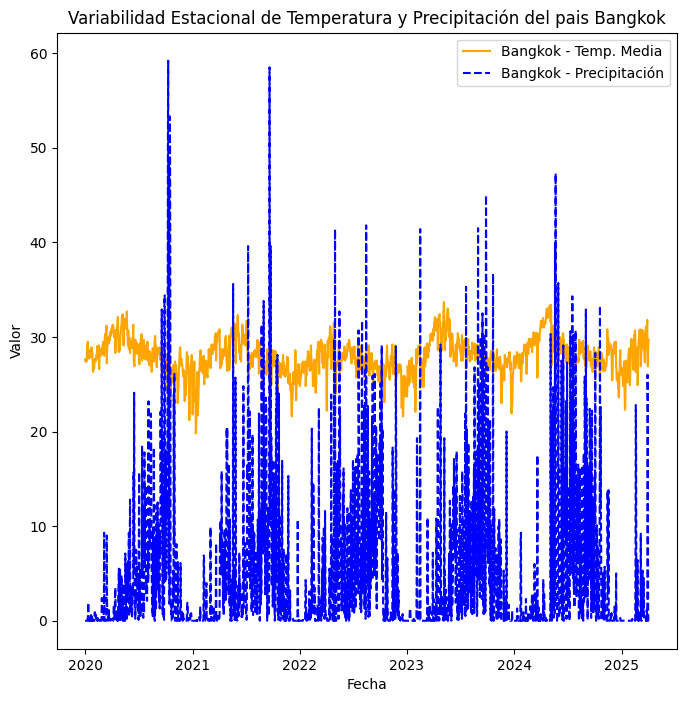

In [ ]:

plt.figure(figsize=(12, 8))

for city in top_ciudades['city_name'].unique():
    print(f"\n===== {city} =====")
    ciudad = df1[df1['city_name'] == city]
    plt.figure(figsize=(8, 8))
    plt.plot(ciudad['datetime'], ciudad['temperature_2m_mean'], label=f'{city} - Temp. Media', linestyle='-', color='orange')
    plt.plot(ciudad['datetime'], ciudad['precipitation_sum'], label=f'{city} - Precipitación', linestyle='--', color='blue')

    plt.title(f'Variabilidad Estacional de Temperatura y Precipitación del pais {city}')
    plt.xlabel('Fecha')
    plt.ylabel('Valor')
    plt.legend()
    plt.show()

#Paises con mejor calidad de climas para turismo


##¿Cuáles son las ciudades con el clima más ideal para el turismo, considerando temperatura, precipitación y horas de sol?

In [ ]:
df1['tourism_score'] = 0

# Temperatura ideal entre 18 y 30
df1['tourism_score'] += df1['temperature_2m_mean'].apply(lambda x: 1 if 18 <= x <= 30 else 0)

# Precipitación baja
df1['tourism_score'] += df1['precipitation_sum'].apply(lambda x: 1 if x < 2 else 0)

# Horas de sol (convertido a horas si estaba en minutos)
df1['sunshine_hours'] = df1['sunshine_duration'] / 60
df1['tourism_score'] += df1['sunshine_hours'].apply(lambda x: 1 if x > 6 else 0)


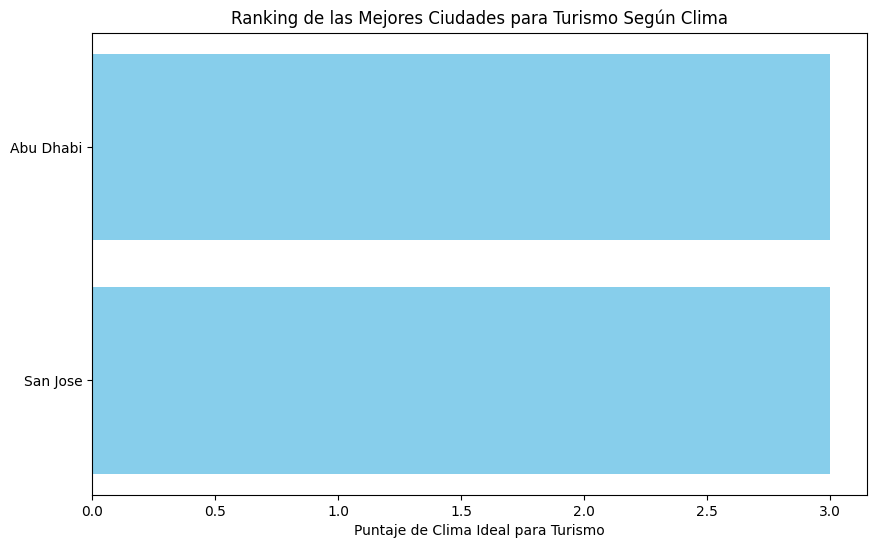

In [ ]:
top_ciudades = df1.sort_values(by='tourism_score', ascending=False).head(10)

plt.figure(figsize=(10, 6))
plt.barh(top_ciudades['city_name'], top_ciudades['tourism_score'], color='skyblue')
plt.xlabel('Puntaje de Clima Ideal para Turismo')
plt.title('Ranking de las Mejores Ciudades para Turismo Según Clima')
plt.gca().invert_yaxis()
plt.show()

##¿Cómo varían la temperatura media y la precipitación a lo largo del tiempo en las ciudades con mejor clima para el turismo?

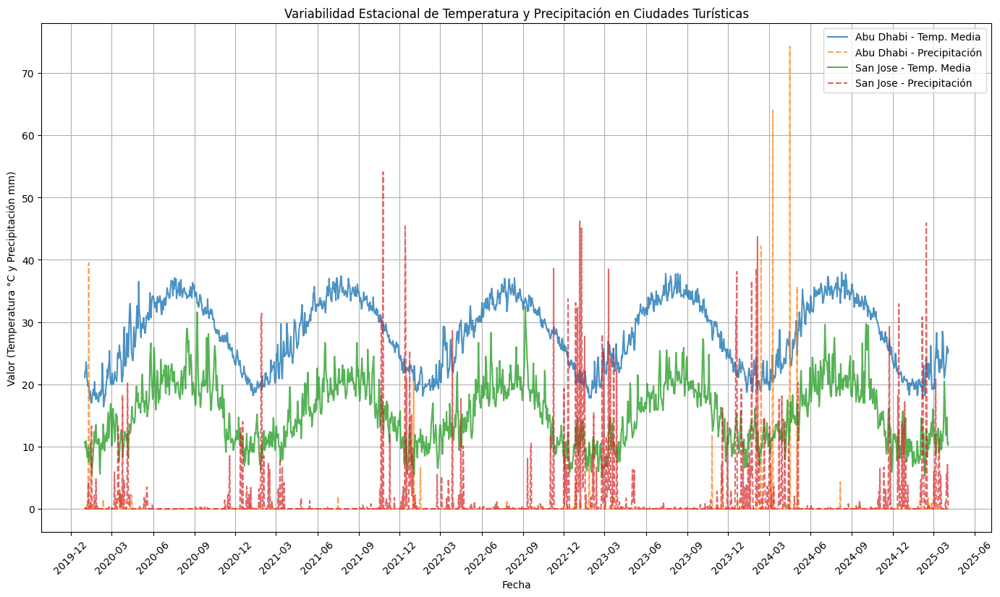

In [ ]:
import matplotlib.pyplot as plt
import matplotlib.dates as mdates

plt.figure(figsize=(14, 8))

# Limita el número de ciudades para no saturar el gráfico
ciudades_a_mostrar = top_ciudades['city_name'].unique()[:5]  # muestra solo las 5 primeras

for ciudad in ciudades_a_mostrar:
    df_ciudad = df1[df1['city_name'] == ciudad].copy()
    df_ciudad['datetime'] = pd.to_datetime(df_ciudad['datetime'])

    # Ordena por fecha para evitar líneas desordenadas
    df_ciudad = df_ciudad.sort_values(by='datetime')

    # Primer eje: temperatura
    plt.plot(df_ciudad['datetime'], df_ciudad['temperature_2m_mean'], label=f'{ciudad} - Temp. Media', linestyle='-', alpha=0.8)

    # Segundo eje: precipitaciones (si quieres mostrarlo junto, escala o separa)
    plt.plot(df_ciudad['datetime'], df_ciudad['precipitation_sum'], label=f'{ciudad} - Precipitación', linestyle='--', alpha=0.7)

# Formato del eje X
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%Y-%m'))
plt.gca().xaxis.set_major_locator(mdates.MonthLocator(interval=3))

plt.title('Variabilidad Estacional de Temperatura y Precipitación en Ciudades Turísticas')
plt.xlabel('Fecha')
plt.ylabel('Valor (Temperatura °C y Precipitación mm)')
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.xticks(rotation=45)
plt.show()



#**Insights**

* **Ciudades calurosas**: Hay algunas ciudades con un promedio de temperatura máxima muy alto durante todo el año (ej. Dubai, Abu Dhabi), mientras que otras tienen veranos muy calurosos, pero inviernos más suaves (ej. Miami, Phoenix).

* **Ciudades frías**: Las ciudades frías muestran una variación considerable en la temperatura a lo largo del año. Algunas tienen temperaturas bajo cero durante el invierno (ej. Toronto, Moscú).

* **Amplitud térmica**: En general, la amplitud térmica tiende a ser mayor en las ciudades calurosas, especialmente en las que están ubicadas en zonas desérticas.
* **Sensación térmica**: La diferencia entre la temperatura real y la sensación térmica es significativa en muchas ciudades, especialmente durante los meses de verano.
* **Probabilidad de lluvia**: La probabilidad de lluvia varía de forma considerable entre las ciudades y a lo largo del año.
* **Agricultura**: Existe un grupo de ciudades con condiciones agroclimáticas muy favorables (temperatura, precipitación, etc.), lo que podría ser un atractivo para la inversión en este sector.
* **Turismo**: Las ciudades con clima ideal para turismo tienen temperaturas agradables durante la mayor parte del año y pocas precipitaciones.


#**Recomendaciones**
##**Para quienes buscan calor y sol:**
* **Dubai o Abu Dhab:**  Si buscas un clima cálido durante todo el año y te gustan las actividades al aire libre, estas ciudades son una excelente opción. Tienen temperaturas muy altas, especialmente en verano, y pocas precipitaciones. Asegúrate de llevar ropa ligera y protector solar. Considera la época de verano (junio a agosto) para disfrutar al máximo del sol, pero ten en cuenta que las temperaturas pueden ser extremas.
* **Miami o Phoenix:**Estas ciudades son ideales para quienes prefieren un clima cálido con veranos calurosos e inviernos más suaves. Ofrecen una gran variedad de actividades, desde playas hasta parques temáticos. Si bien los veranos son calurosos y húmedos, los inviernos son más suaves y agradables. Ten en cuenta la época de huracanes en Miami (junio a noviembre).

## **Para quienes prefieren un clima más templado:**
* **Madrid o Barcelona:**Si prefieres un clima más templado, estas ciudades españolas ofrecen una buena combinación de temperaturas agradables y días soleados. Son ideales para quienes disfrutan de la cultura, la gastronomía y la historia. Los veranos son cálidos y secos, mientras que los inviernos son suaves y húmedos.
* **Roma o Milán:**Si buscas un clima mediterráneo con veranos calurosos e inviernos suaves, estas ciudades italianas son una excelente opción. Ofrecen una gran variedad de atracciones turísticas, desde monumentos históricos hasta tiendas de moda.

## **Para quienes disfrutan del frío:**
* **Toronto o Moscú:**Si te gusta el frío y la nieve, estas ciudades son ideales para ti. Tienen inviernos muy fríos con temperaturas bajo cero, pero también veranos agradables. Asegúrate de llevar ropa abrigada si viajas en invierno. Considera visitar Toronto en otoño para disfrutar de un clima agradable y paisajes coloridos, o Moscú en invierno para vivir una experiencia única en la nieve.

# **Consideraciones adicionales:**
* **Agricultura:** Si te interesa la agricultura, considera visitar países con un clima favorable para la producción de alimentos como por ejemplo Miami. Consulta el índice agroclimático generado en el código para identificar las mejores opciones.
* **Turismo:** Además de las ciudades mencionadas, el código identifica otras ciudades con un buen puntaje de turismo. Ten en cuenta esta información para elegir tu destino.
* **Clima actual:** Recuerda que el código analiza datos históricos. Es recomendable consultar el pronóstico del tiempo antes de tu viaje para conocer las condiciones climáticas actualizadas.